#Bibliotecas/Função de limpeza


In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud
from collections import Counter
import re
import os
import nltk
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
from transformers import BertTokenizer, BertModel
import torch
!pip install pyspellchecker
from spellchecker import SpellChecker


nltk.download('punkt')
nltk.download('stopwords')
nltk.download('punkt_tab') # download the punkt_tab data

from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn import metrics
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.svm import LinearSVC
from sklearn.linear_model import PassiveAggressiveClassifier
from sklearn.metrics import confusion_matrix
from sklearn.feature_extraction.text import TfidfVectorizer
import joblib
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
# Install the gensim library
!pip install gensim
from gensim.models import Word2Vec

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package punkt_tab to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt_tab.zip.


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 27.9/27.9 MB 19.0 MB/s eta 0:00:00


In [4]:
#Função de limpeza de Stopwords
def limpar_texto(texto):
    texto = str(texto).lower()  # Converte para minúsculas
    texto = re.sub(r'http\S+', '', texto)  # Remove links
    texto = re.sub(r'@\w+', '', texto)  # Remove menções (@usuario)
    texto = re.sub(r'#\w+', '', texto)  # Remove hashtags
    texto = re.sub(r'\d+', '', texto)  # Remove números
    texto = re.sub(r'[^\w\s]', '', texto)  # Remove pontuação
    tokens = word_tokenize(texto)  # Tokeniza palavras
    tokens = [word for word in tokens if word not in stopwords.words('portuguese')]  # Remove stopwords em portugues
    return " ".join(tokens)

In [5]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# Fake.BR

In [ ]:
import os
import glob

# Caminho para a pasta onde estão os arquivos .txt
pasta_textos_fake = "/content/drive/MyDrive/Fake.Br/fake/"
pasta_textos_true = "/content/drive/MyDrive/Fake.Br/true/"

# Listar todos os arquivos .txt na pasta
arquivos_txt_fake = glob.glob(os.path.join(pasta_textos_fake, "*.txt"))
arquivos_txt_true = glob.glob(os.path.join(pasta_textos_true, "*.txt"))

print(f"Arquivos encontrados: {arquivos_txt_fake}")

Arquivos encontrados: ['/content/drive/MyDrive/Fake.Br/fake/2179.txt', '/content/drive/MyDrive/Fake.Br/fake/3502.txt', '/content/drive/MyDrive/Fake.Br/fake/3209.txt', '/content/drive/MyDrive/Fake.Br/fake/2906.txt', '/content/drive/MyDrive/Fake.Br/fake/3058.txt', '/content/drive/MyDrive/Fake.Br/fake/263.txt', '/content/drive/MyDrive/Fake.Br/fake/2214.txt', '/content/drive/MyDrive/Fake.Br/fake/2054.txt', '/content/drive/MyDrive/Fake.Br/fake/1191.txt', '/content/drive/MyDrive/Fake.Br/fake/2097.txt', '/content/drive/MyDrive/Fake.Br/fake/3025.txt', '/content/drive/MyDrive/Fake.Br/fake/1361.txt', '/content/drive/MyDrive/Fake.Br/fake/65.txt', '/content/drive/MyDrive/Fake.Br/fake/1185.txt', '/content/drive/MyDrive/Fake.Br/fake/919.txt', '/content/drive/MyDrive/Fake.Br/fake/3334.txt', '/content/drive/MyDrive/Fake.Br/fake/472.txt', '/content/drive/MyDrive/Fake.Br/fake/1013.txt', '/content/drive/MyDrive/Fake.Br/fake/58.txt', '/content/drive/MyDrive/Fake.Br/fake/1926.txt', '/content/drive/MyDrive/

In [ ]:
# Lista para armazenar os dados
dados = []

# Percorrer os arquivos .txt e processar o texto
for idx, arquivo in enumerate(arquivos_txt_fake, start=1):
    with open(arquivo, "r", encoding="utf-8") as f:
        texto_original = f.read()
        texto_processado = limpar_texto(texto_original)
        dados.append([idx, texto_processado, "fake"])

for idx, arquivo in enumerate(arquivos_txt_true, start=1):
    with open(arquivo, "r", encoding="utf-8") as f:
        texto_original = f.read()
        texto_processado = limpar_texto(texto_original)
        dados.append([idx, texto_processado, "true"])

# Criar um DataFrame
df = pd.DataFrame(dados, columns=["id", "texto_processado", "classificação"])

# Exibir as primeiras linhas
print(df.head())

   id                                   texto_processado classificação
0   1  ministro celso mello manda recado políticos ma...          fake
1   2  ei divulga vídeo ameaça frança eua vamos vinga...          fake
2   3  áudio estranho vaza youtube parte financeira n...          fake
3   4  francês le figaro faz matéria sobre dilma exgu...          fake
4   5  planalto pânico stf pode devolver ações envolv...          fake


In [ ]:
df.loc[3600:, 'id'] = df.loc[3600:, 'id'].apply(lambda x: x + 3600)

In [ ]:
print(df[df['classificação'] == 'true'])

        id                                   texto_processado classificação
3600  3601  divirtase celebra centésima edição programas i...          true
3601  3602  pagar sai nada diz envolvido esquema propina l...          true
3602  3603  pais buscam cura doença rara destrói cérebro c...          true
3603  3604  milhões idosos ba segue tendência longevidade ...          true
3604  3605  vício celular chega consultórios preocupa médi...          true
...    ...                                                ...           ...
7195  7196  advogado josé roberto batochio integra defesa ...          true
7196  7197  segundafeira outubro boa noite aqui principais...          true
7197  7198  empresário admite ter comprado terreno r milhõ...          true
7198  7199  empresa consórcio ppp iluminação sp acusada de...          true
7199  7200  associação juízes sugere gilmar mendes renunci...          true

[3600 rows x 3 columns]


In [ ]:
# Salvar o DataFrame em um arquivo .csv
df.to_csv('fakebr_dataset.csv', index=False, encoding='utf-8')

# FakeRecogna

In [ ]:
caminho_arquivo = "/content/drive/MyDrive/FakeRecogna/FakeRecogna.xlsx"

In [ ]:
# Carregar o arquivo Excel em um DataFrame
df = pd.read_excel(caminho_arquivo, engine="openpyxl")

# Exibir as primeiras linhas do DataFrame
print(df.head())

                                              Titulo  \
0  \n\nPapa Francisco foi preso sob acusação de t...   
1  Equador prepara cova coletiva para mortos por ...   
2  Air France voltará a operar voo direto Pequim-...   
3  Marfrig intensifica venda de carne do Brasil a...   
4  As parciais das eleições de 2014 alternaram ma...   

                                           Subtitulo  \
0  Boato – Ocorreu um apagão no Vaticano. O papa ...   
1                                                NaN   
2                                                NaN   
3                                                NaN   
4                                                NaN   

                                             Noticia       Categoria  \
0  apagão vaticano papar presar acusação tráfico ...  entretenimento   
1  o governar equador anunciar preparar cova cole...           saúde   
2  o companhia air france operar voar direto pequ...           saúde   
3  o marfrig global foods retomar vend

In [ ]:
df_novo = df[['Noticia', 'Classe']].copy()
df_novo.rename(columns={'Noticia': 'texto_processado', 'Classe': 'classificação'}, inplace=True)
df_novo['id'] = df_novo.index + 1
df_novo['classificação'] = df_novo['classificação'].apply(lambda x: 'fake' if x == 0 else 'true')
df_novo['texto_processado'] = df_novo['texto_processado'].apply(limpar_texto)
df_novo = df_novo[['id', 'texto_processado', 'classificação']]
print(df_novo.head())

   id                                   texto_processado classificação
0   1  apagão vaticano papar presar acusação tráfico ...          fake
1   2  governar equador anunciar preparar cova coleti...          true
2   3  companhia air france operar voar direto pequim...          true
3   4  marfrig global foods retomar vender carnar bov...          true
4   5  assunto voltar compartilhar rede social julho ...          fake


In [ ]:
# Salvar o DataFrame em um arquivo .csv
df_novo.to_csv('fakerecogna_dataset.csv', index=False, encoding='utf-8')

# Teste Dataset A no B e B no A

In [ ]:
df_fakebr = pd.read_csv('/content/drive/MyDrive/Fake.Br/fakebr_dataset.csv')
df_fakerecogna = pd.read_csv('/content/drive/MyDrive/FakeRecogna/fakerecogna_dataset.csv')
df_fakebr = df_fakebr.drop(columns=['id'])
df_fakerecogna = df_fakerecogna.drop(columns=['id'])

## Fake.br predizendo FakeRecogna

In [ ]:
df_fakebr.head()

,texto_processado,classificação
0,ministro celso mello manda recado políticos ma...,fake
1,ei divulga vídeo ameaça frança eua vamos vinga...,fake
2,áudio estranho vaza youtube parte financeira n...,fake
3,francês le figaro faz matéria sobre dilma exgu...,fake
4,planalto pânico stf pode devolver ações envolv...,fake


In [ ]:
df_fakebr['num_palavras'] = df_fakebr['texto_processado'].astype(str).apply(lambda x: len(x.split()))
print(df_fakebr['num_palavras'].describe())

count    7200.000000
mean      357.779722
std       368.263643
min         5.000000
25%        89.000000
50%       204.000000
75%       514.000000
max      4112.000000
Name: num_palavras, dtype: float64


In [ ]:
palavras = " ".join(df_fakebr['texto_processado'].astype(str)).split()
frequencia = Counter(palavras)
print(frequencia.most_common(10))  # Top 10 palavras mais frequentes

[('lula', 11850), ('presidente', 10581), ('disse', 10383), ('sobre', 9432), ('anos', 9282), ('federal', 8832), ('governo', 8026), ('ainda', 7986), ('r', 7550), ('segundo', 7246)]


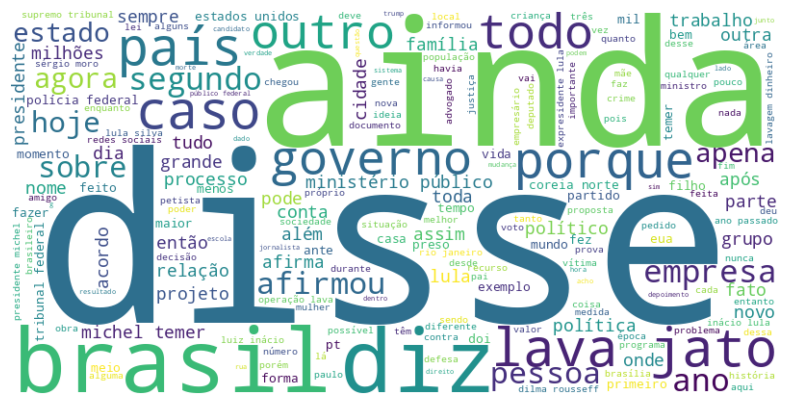

In [ ]:
texto = " ".join(df_fakebr['texto_processado'].astype(str))
wordcloud = WordCloud(width=800, height=400, background_color="white").generate(texto)

plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()

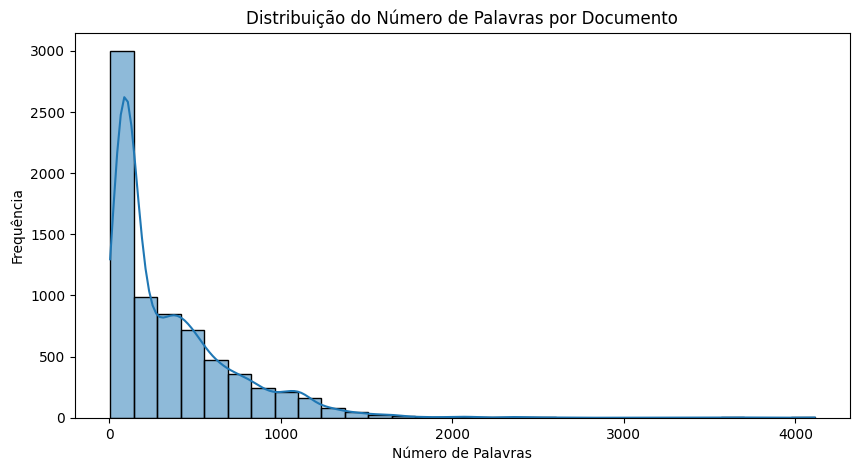

In [ ]:
plt.figure(figsize=(10,5))
sns.histplot(df_fakebr['num_palavras'], bins=30, kde=True)
plt.xlabel("Número de Palavras")
plt.ylabel("Frequência")
plt.title("Distribuição do Número de Palavras por Documento")
plt.show()

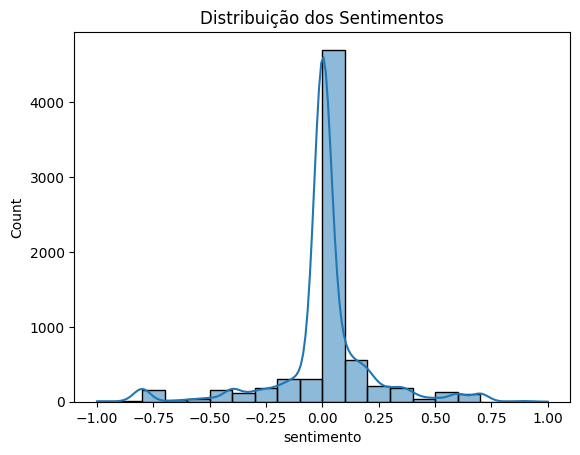

In [ ]:
from textblob import TextBlob

df_fakebr['texto_processado'] = df_fakebr['texto_processado'].astype(str)
df_fakebr['sentimento'] = df_fakebr['texto_processado'].apply(lambda x: TextBlob(x).sentiment.polarity)
sns.histplot(df_fakebr['sentimento'], bins=20, kde=True)
plt.title("Distribuição dos Sentimentos")
plt.show()

###TF-IDF

In [ ]:
vetorizador = TfidfVectorizer()

x_train = vetorizador.fit_transform(df_fakebr['texto_processado'].astype(str))
y_train = df_fakebr['classificação'].apply(lambda x: 1 if 'true' in x else 0)
x_test = vetorizador.transform(df_fakerecogna['texto_processado'].astype(str))
y_test = df_fakerecogna['classificação'].apply(lambda x: 1 if 'true' in x else 0)

#### RFC

In [ ]:
accuracy_RFC = []
precision_RFC = []
recall_RFC = []
f1_RFC = []
score = []
RFC_pred = []
i = 5
while i<41:
  forest=RandomForestClassifier(max_depth = i,random_state=45)
  forest.fit(x_train,y_train)
  prediction=forest.predict(x_test)
  RFC_pred.append(prediction)
  accuracy_RFC.append(metrics.accuracy_score(prediction,y_test))
  precision_RFC.append(metrics.precision_score(prediction,y_test))
  recall_RFC.append(metrics.recall_score(prediction,y_test))
  f1_RFC.append(metrics.f1_score(prediction,y_test))
  i+= 5

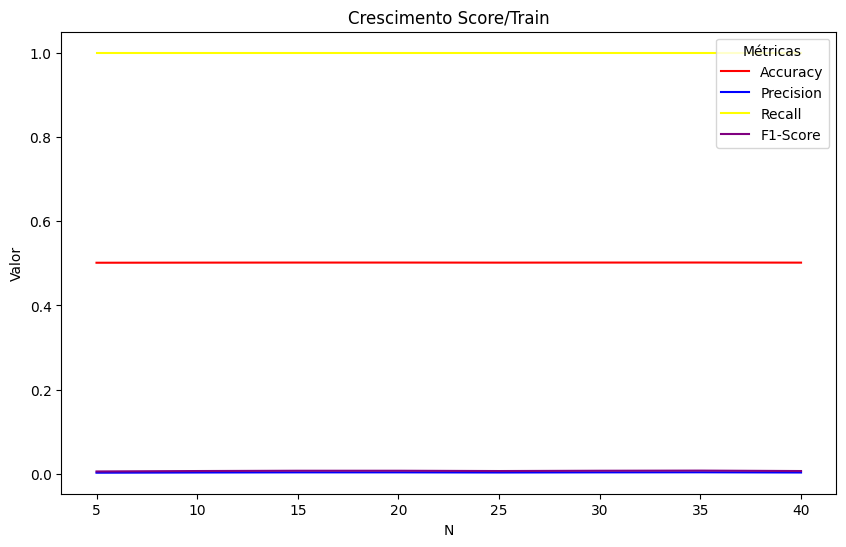

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [5,10,15,20,25,30,35,40]
data_l['accuracy'] = accuracy_RFC
data_l['precision'] = precision_RFC
data_l['recall'] = recall_RFC
data_l['F1-score'] = f1_RFC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.legend(title="Métricas")  # Adiciona legenda com título
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_depth = 40')

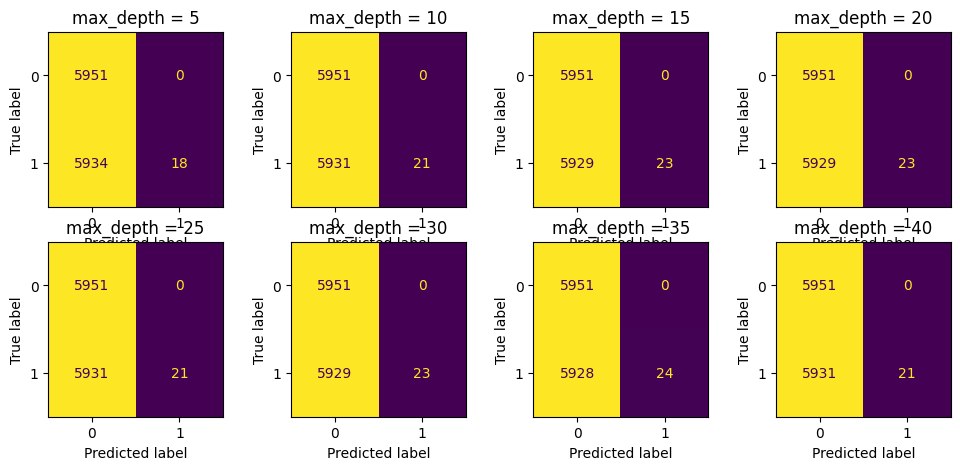

In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

cm_1 = confusion_matrix(y_test, RFC_pred[0])
cm_2 = confusion_matrix(y_test, RFC_pred[1])
cm_3 = confusion_matrix(y_test, RFC_pred[2])
cm_4 = confusion_matrix(y_test, RFC_pred[3])
cm_5 = confusion_matrix(y_test, RFC_pred[4])
cm_6 = confusion_matrix(y_test, RFC_pred[5])
cm_7 = confusion_matrix(y_test, RFC_pred[6])
cm_8 = confusion_matrix(y_test, RFC_pred[7])

fig, axes = plt.subplots(2, 4, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_depth = 5')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_depth = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_depth = 15')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_depth = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_depth = 25')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_depth = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_depth = 35')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_depth = 40')

#### DTC

In [ ]:
accuracy_DTC = []
precision_DTC = []
recall_DTC = []
f1_DTC = []
DTC_pred = []
i = 5
while i<41:
  mod_dt = DecisionTreeClassifier(max_depth = i, random_state = 1)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  DTC_pred.append(prediction)
  accuracy_DTC.append(metrics.accuracy_score(prediction,y_test))
  precision_DTC.append(metrics.precision_score(prediction,y_test))
  recall_DTC.append(metrics.recall_score(prediction,y_test))
  f1_DTC.append(metrics.f1_score(prediction,y_test))
  i+= 5

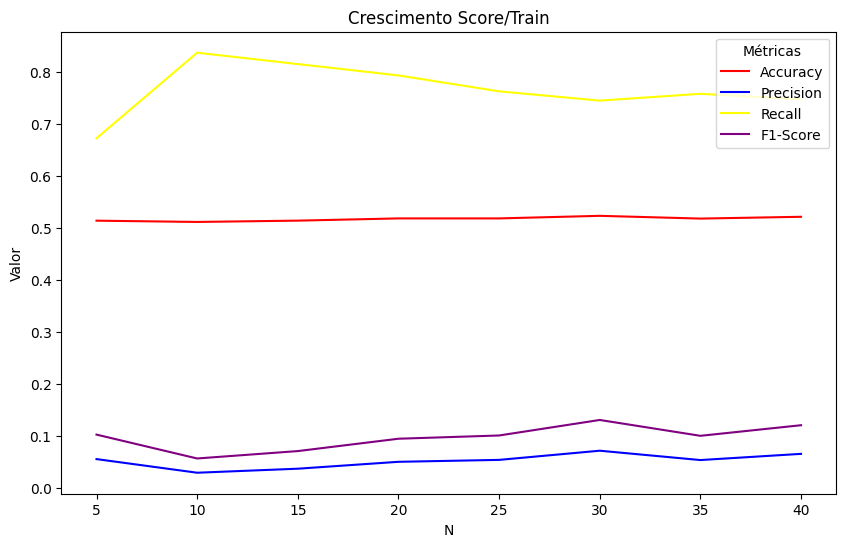

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [5,10,15,20,25,30,35,40]
data_l['accuracy'] = accuracy_DTC
data_l['precision'] = precision_DTC
data_l['recall'] = recall_DTC
data_l['F1-score'] = f1_DTC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_depth = 40')

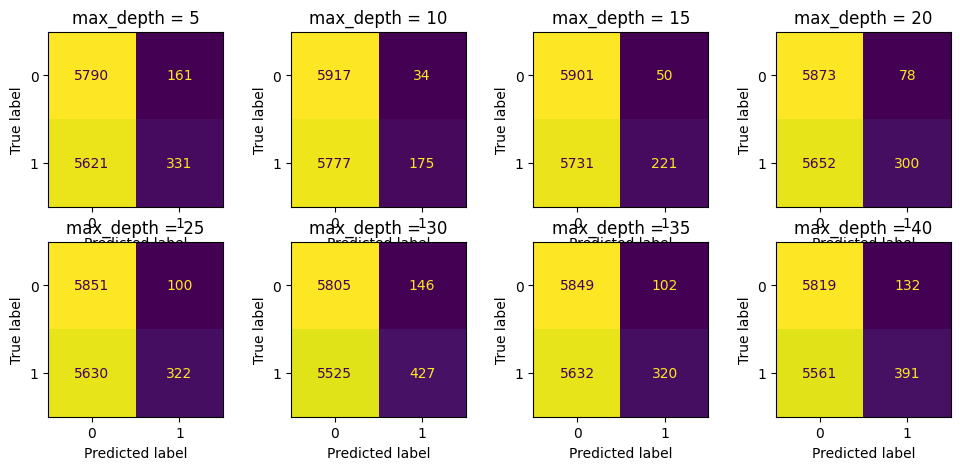

In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

cm_1 = confusion_matrix(y_test, DTC_pred[0])
cm_2 = confusion_matrix(y_test, DTC_pred[1])
cm_3 = confusion_matrix(y_test, DTC_pred[2])
cm_4 = confusion_matrix(y_test, DTC_pred[3])
cm_5 = confusion_matrix(y_test, DTC_pred[4])
cm_6 = confusion_matrix(y_test, DTC_pred[5])
cm_7 = confusion_matrix(y_test, DTC_pred[6])
cm_8 = confusion_matrix(y_test, DTC_pred[7])

fig, axes = plt.subplots(2, 4, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_depth = 5')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_depth = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_depth = 15')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_depth = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_depth = 25')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_depth = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_depth = 35')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_depth = 40')

#### Logistic Regression


In [ ]:
accuracy_LR = []
precision_LR = []
recall_LR = []
f1_LR = []
LR_pred = []
i = 10
while i<151:
  mod_dt = LogisticRegression(max_iter = i, random_state = 1)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  LR_pred.append(prediction)
  accuracy_LR.append(metrics.accuracy_score(prediction,y_test))
  precision_LR.append(metrics.precision_score(prediction,y_test))
  recall_LR.append(metrics.recall_score(prediction,y_test))
  f1_LR.append(metrics.f1_score(prediction,y_test))
  i+= 10

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. OF ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


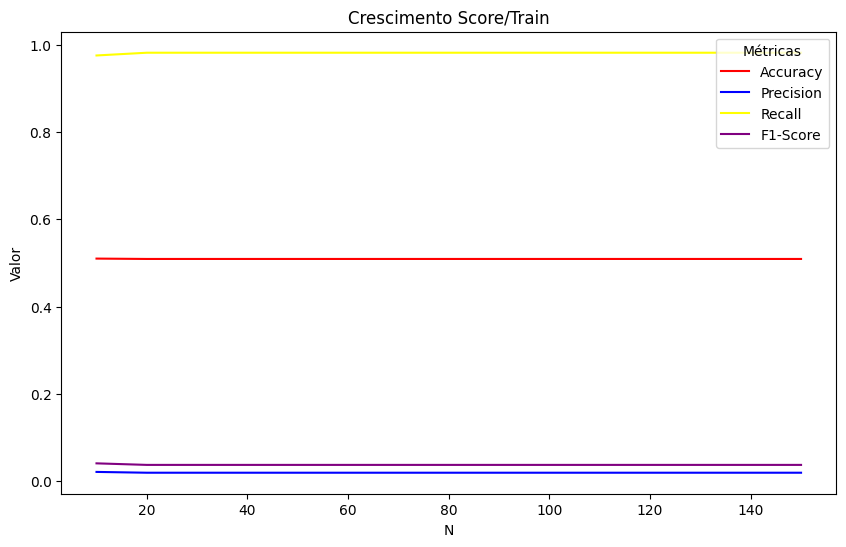

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [10,20,30,40,50,60,70,80,90,100,110,120,130,140,150]
data_l['accuracy'] = accuracy_LR
data_l['precision'] = precision_LR
data_l['recall'] = recall_LR
data_l['F1-score'] = f1_LR
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_iter = 150')

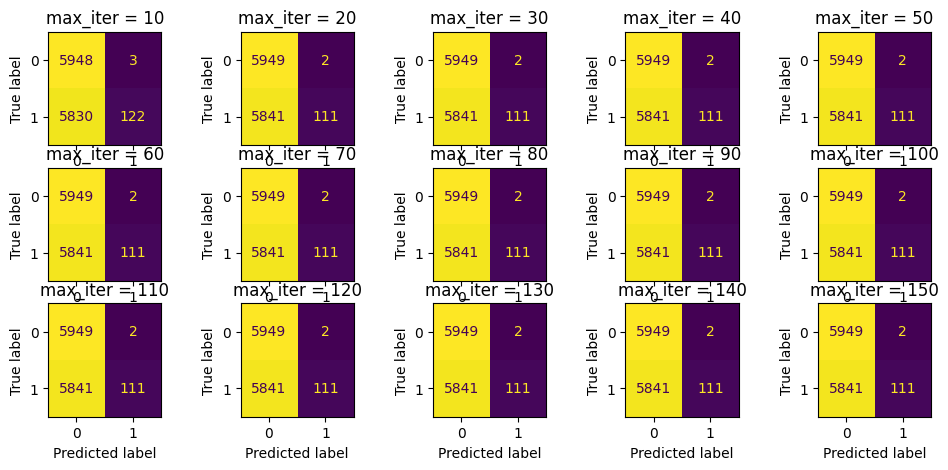

In [ ]:
cm_1 = confusion_matrix(y_test, LR_pred[0])
cm_2 = confusion_matrix(y_test, LR_pred[1])
cm_3 = confusion_matrix(y_test, LR_pred[2])
cm_4 = confusion_matrix(y_test, LR_pred[3])
cm_5 = confusion_matrix(y_test, LR_pred[4])
cm_6 = confusion_matrix(y_test, LR_pred[5])
cm_7 = confusion_matrix(y_test, LR_pred[6])
cm_8 = confusion_matrix(y_test, LR_pred[7])
cm_9 = confusion_matrix(y_test, LR_pred[8])
cm_10 = confusion_matrix(y_test, LR_pred[9])
cm_11 = confusion_matrix(y_test, LR_pred[10])
cm_12 = confusion_matrix(y_test, LR_pred[11])
cm_13 = confusion_matrix(y_test, LR_pred[12])
cm_14 = confusion_matrix(y_test, LR_pred[13])
cm_15 = confusion_matrix(y_test, LR_pred[14])

fig, axes = plt.subplots(3, 5, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_iter = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_iter = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_iter = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_iter = 40')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[0,4], colorbar=False)
axes[0,4].set_title('max_iter = 50')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_iter = 60')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_iter = 70')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_iter = 80')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_9)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_iter = 90')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_10)
disp_rfc.plot(ax=axes[1,4], colorbar=False)
axes[1,4].set_title('max_iter = 100')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_11)
disp_rfc.plot(ax=axes[2,0], colorbar=False)
axes[2,0].set_title('max_iter = 110')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_12)
disp_rfc.plot(ax=axes[2,1], colorbar=False)
axes[2,1].set_title('max_iter = 120')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_13)
disp_rfc.plot(ax=axes[2,2], colorbar=False)
axes[2,2].set_title('max_iter = 130')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_14)
disp_rfc.plot(ax=axes[2,3], colorbar=False)
axes[2,3].set_title('max_iter = 140')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_15)
disp_rfc.plot(ax=axes[2,4], colorbar=False)
axes[2,4].set_title('max_iter = 150')

#### Linear Support Vector Classifier


In [ ]:
accuracy_LSVC = []
precision_LSVC = []
recall_LSVC = []
f1_LSVC = []
LSVC_pred = []
i = 10
while i<151:
  mod_dt = LinearSVC(max_iter = i, random_state = 42)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  LSVC_pred.append(prediction)
  accuracy_LSVC.append(metrics.accuracy_score(prediction,y_test))
  precision_LSVC.append(metrics.precision_score(prediction,y_test))
  recall_LSVC.append(metrics.recall_score(prediction,y_test))
  f1_LSVC.append(metrics.f1_score(prediction,y_test))
  i+= 10

/usr/local/lib/python3.11/dist-packages/sklearn/svm/_base.py:1249: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/svm/_base.py:1249: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/svm/_base.py:1249: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


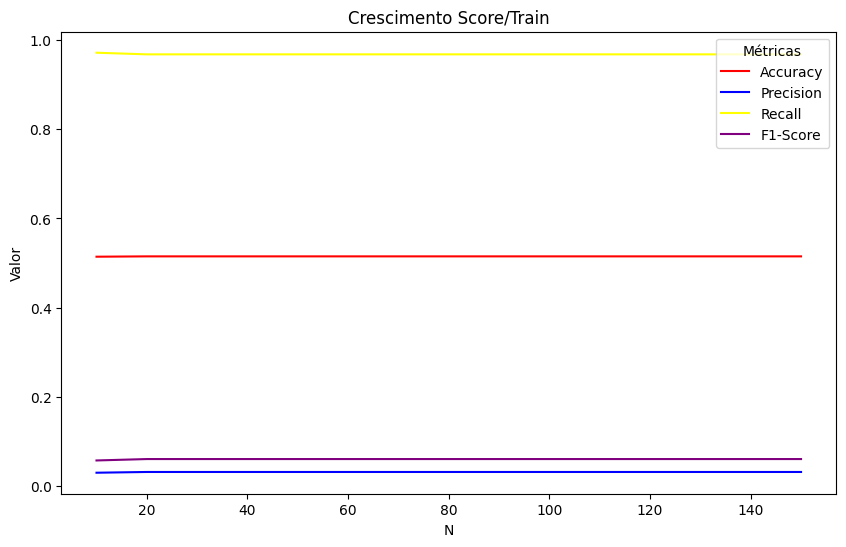

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [10,20,30,40,50,60,70,80,90,100,110,120,130,140,150]
data_l['accuracy'] = accuracy_LSVC
data_l['precision'] = precision_LSVC
data_l['recall'] = recall_LSVC
data_l['F1-score'] = f1_LSVC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_iter = 150')

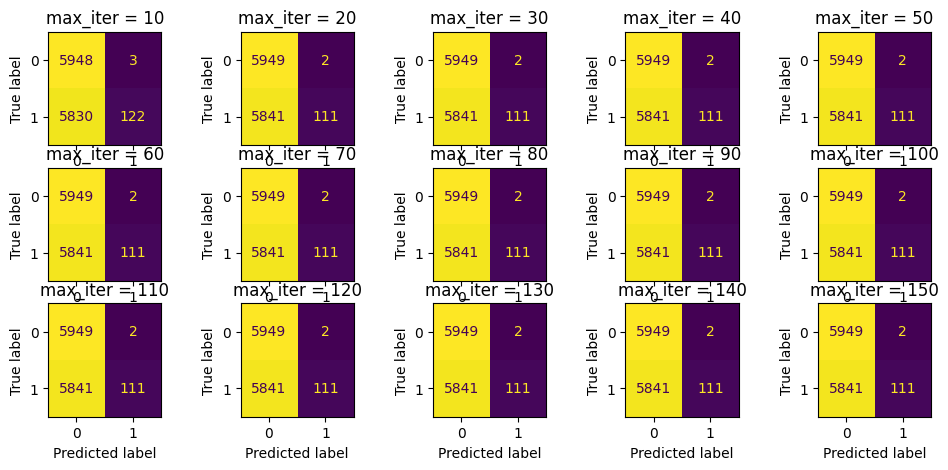

In [ ]:
cm_1 = confusion_matrix(y_test, LR_pred[0])
cm_2 = confusion_matrix(y_test, LR_pred[1])
cm_3 = confusion_matrix(y_test, LR_pred[2])
cm_4 = confusion_matrix(y_test, LR_pred[3])
cm_5 = confusion_matrix(y_test, LR_pred[4])
cm_6 = confusion_matrix(y_test, LR_pred[5])
cm_7 = confusion_matrix(y_test, LR_pred[6])
cm_8 = confusion_matrix(y_test, LR_pred[7])
cm_9 = confusion_matrix(y_test, LR_pred[8])
cm_10 = confusion_matrix(y_test, LR_pred[9])
cm_11 = confusion_matrix(y_test, LR_pred[10])
cm_12 = confusion_matrix(y_test, LR_pred[11])
cm_13 = confusion_matrix(y_test, LR_pred[12])
cm_14 = confusion_matrix(y_test, LR_pred[13])
cm_15 = confusion_matrix(y_test, LR_pred[14])

fig, axes = plt.subplots(3, 5, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_iter = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_iter = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_iter = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_iter = 40')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[0,4], colorbar=False)
axes[0,4].set_title('max_iter = 50')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_iter = 60')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_iter = 70')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_iter = 80')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_9)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_iter = 90')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_10)
disp_rfc.plot(ax=axes[1,4], colorbar=False)
axes[1,4].set_title('max_iter = 100')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_11)
disp_rfc.plot(ax=axes[2,0], colorbar=False)
axes[2,0].set_title('max_iter = 110')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_12)
disp_rfc.plot(ax=axes[2,1], colorbar=False)
axes[2,1].set_title('max_iter = 120')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_13)
disp_rfc.plot(ax=axes[2,2], colorbar=False)
axes[2,2].set_title('max_iter = 130')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_14)
disp_rfc.plot(ax=axes[2,3], colorbar=False)
axes[2,3].set_title('max_iter = 140')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_15)
disp_rfc.plot(ax=axes[2,4], colorbar=False)
axes[2,4].set_title('max_iter = 150')

#### Passive Aggressive Classifier


In [ ]:
accuracy_PAC = []
precision_PAC = []
recall_PAC = []
f1_PAC = []
PAC_pred = []
i = 5
while i<41:
  mod_dt = PassiveAggressiveClassifier(max_iter=i, random_state=42)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  PAC_pred.append(prediction)
  accuracy_PAC.append(metrics.accuracy_score(prediction,y_test))
  precision_PAC.append(metrics.precision_score(prediction,y_test))
  recall_PAC.append(metrics.recall_score(prediction,y_test))
  f1_PAC.append(metrics.f1_score(prediction,y_test))
  i+= 5

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:738: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:738: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(


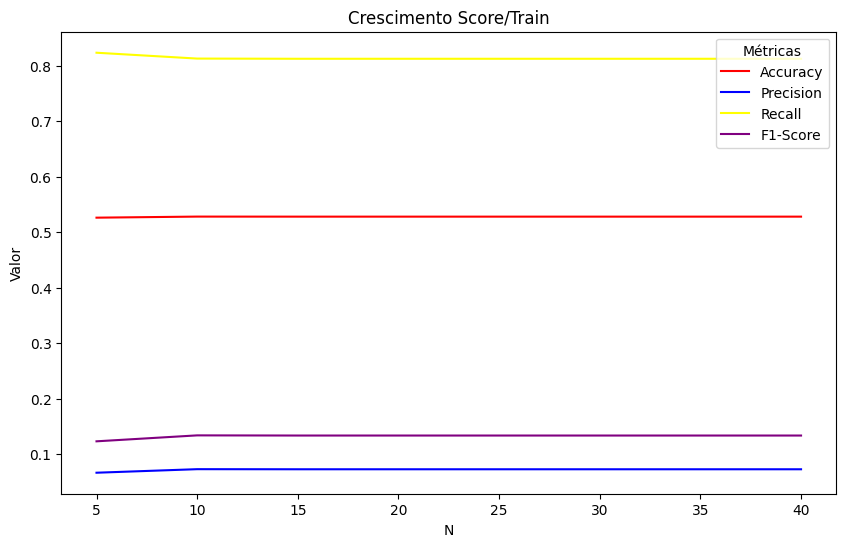

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [5,10,15,20,25,30,35,40]
data_l['accuracy'] = accuracy_PAC
data_l['precision'] = precision_PAC
data_l['recall'] = recall_PAC
data_l['F1-score'] = f1_PAC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_depth = 40')

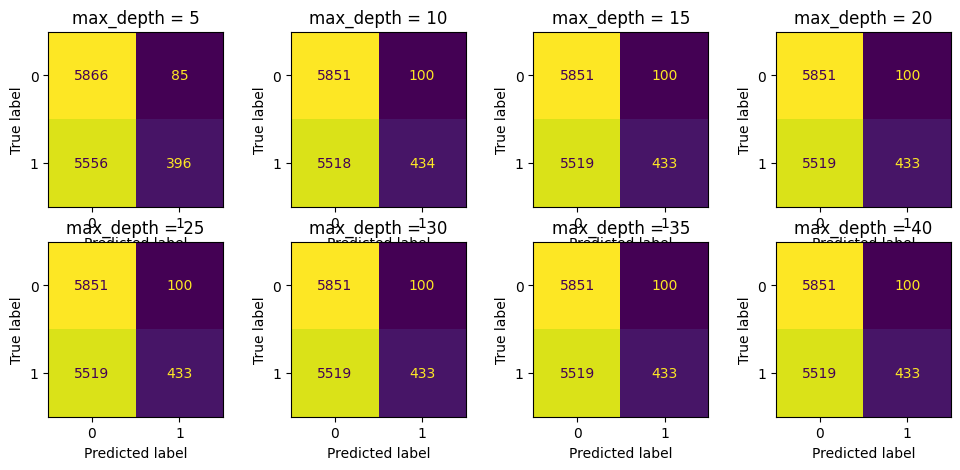

In [ ]:
cm_1 = confusion_matrix(y_test, PAC_pred[0])
cm_2 = confusion_matrix(y_test, PAC_pred[1])
cm_3 = confusion_matrix(y_test, PAC_pred[2])
cm_4 = confusion_matrix(y_test, PAC_pred[3])
cm_5 = confusion_matrix(y_test, PAC_pred[4])
cm_6 = confusion_matrix(y_test, PAC_pred[5])
cm_7 = confusion_matrix(y_test, PAC_pred[6])
cm_8 = confusion_matrix(y_test, PAC_pred[7])

fig, axes = plt.subplots(2, 4, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_depth = 5')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_depth = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_depth = 15')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_depth = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_depth = 25')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_depth = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_depth = 35')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_depth = 40')

###Word2Vec

In [ ]:
# 1. Pré-processamento
fakebr_textos = [str(t).split() for t in df_fakebr['texto_processado']]
fakerecogna_textos = [str(t).split() for t in df_fakerecogna['texto_processado']]

# 2. Treinar Word2Vec SOMENTE com fake.br
w2v_model = Word2Vec(sentences=fakebr_textos, vector_size=100, window=5, min_count=1)

# 3. Função para vetorizar texto
def vetor_medio(texto, modelo):
    vetores = [modelo.wv[word] for word in texto if word in modelo.wv]
    return np.mean(vetores, axis=0) if vetores else np.zeros(modelo.vector_size)

# 4. Vetorização
x_train = np.array([vetor_medio(t, w2v_model) for t in fakebr_textos])
y_train = df_fakebr['classificação'].apply(lambda x: 1 if 'true' in x else 0)

x_test = np.array([vetor_medio(t, w2v_model) for t in fakerecogna_textos])
y_test = df_fakerecogna['classificação'].apply(lambda x: 1 if 'true' in x else 0)

#### RFC

In [ ]:
accuracy_RFC = []
precision_RFC = []
recall_RFC = []
f1_RFC = []
score = []
RFC_pred = []
i = 5
while i<41:
  forest=RandomForestClassifier(max_depth = i,random_state=45)
  forest.fit(x_train,y_train)
  prediction=forest.predict(x_test)
  RFC_pred.append(prediction)
  accuracy_RFC.append(metrics.accuracy_score(prediction,y_test))
  precision_RFC.append(metrics.precision_score(prediction,y_test))
  recall_RFC.append(metrics.recall_score(prediction,y_test))
  f1_RFC.append(metrics.f1_score(prediction,y_test))
  i+= 5

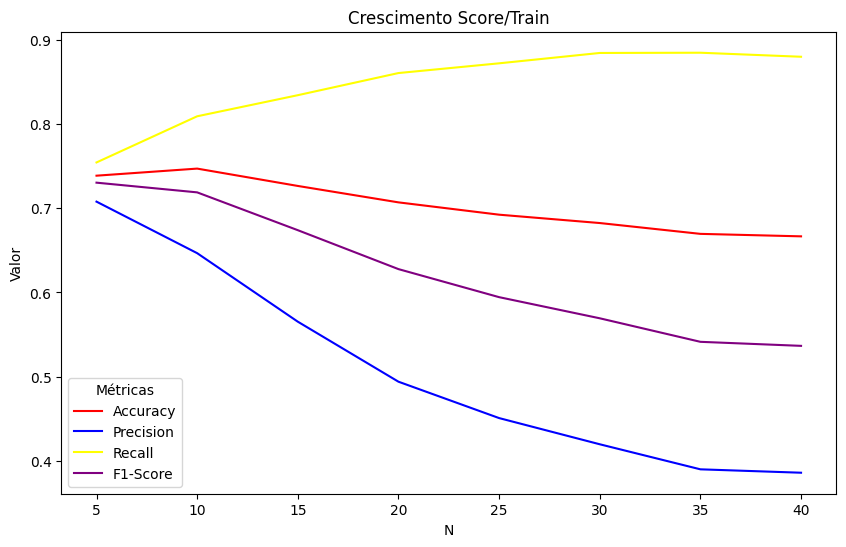

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [5,10,15,20,25,30,35,40]
data_l['accuracy'] = accuracy_RFC
data_l['precision'] = precision_RFC
data_l['recall'] = recall_RFC
data_l['F1-score'] = f1_RFC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_depth = 40')

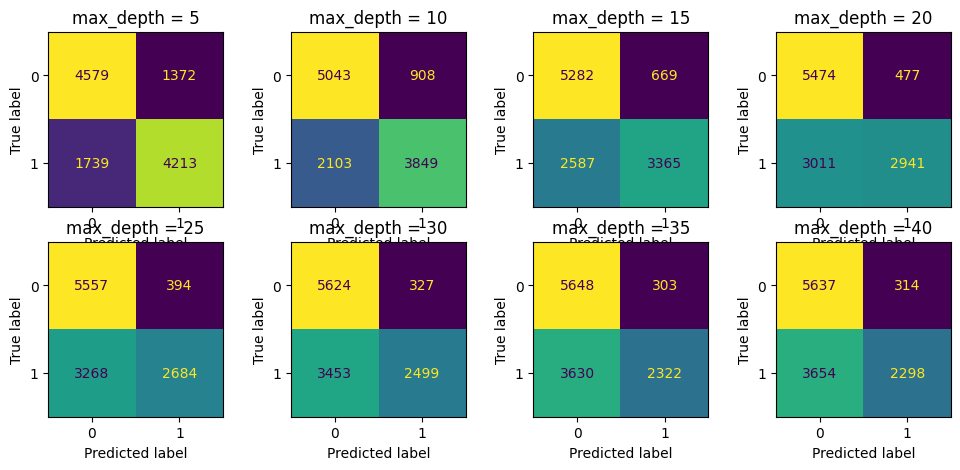

In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

cm_1 = confusion_matrix(y_test, RFC_pred[0])
cm_2 = confusion_matrix(y_test, RFC_pred[1])
cm_3 = confusion_matrix(y_test, RFC_pred[2])
cm_4 = confusion_matrix(y_test, RFC_pred[3])
cm_5 = confusion_matrix(y_test, RFC_pred[4])
cm_6 = confusion_matrix(y_test, RFC_pred[5])
cm_7 = confusion_matrix(y_test, RFC_pred[6])
cm_8 = confusion_matrix(y_test, RFC_pred[7])

fig, axes = plt.subplots(2, 4, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_depth = 5')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_depth = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_depth = 15')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_depth = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_depth = 25')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_depth = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_depth = 35')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_depth = 40')

#### DTC

In [ ]:
accuracy_DTC = []
precision_DTC = []
recall_DTC = []
f1_DTC = []
DTC_pred = []
i = 5
while i<41:
  mod_dt = DecisionTreeClassifier(max_depth = i, random_state = 1)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  DTC_pred.append(prediction)
  accuracy_DTC.append(metrics.accuracy_score(prediction,y_test))
  precision_DTC.append(metrics.precision_score(prediction,y_test))
  recall_DTC.append(metrics.recall_score(prediction,y_test))
  f1_DTC.append(metrics.f1_score(prediction,y_test))
  i+= 5

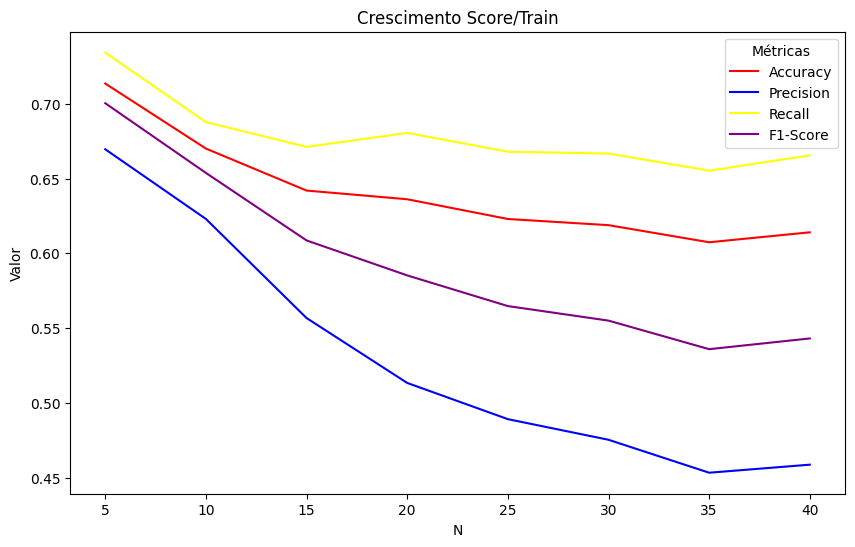

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [5,10,15,20,25,30,35,40]
data_l['accuracy'] = accuracy_DTC
data_l['precision'] = precision_DTC
data_l['recall'] = recall_DTC
data_l['F1-score'] = f1_DTC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_depth = 40')

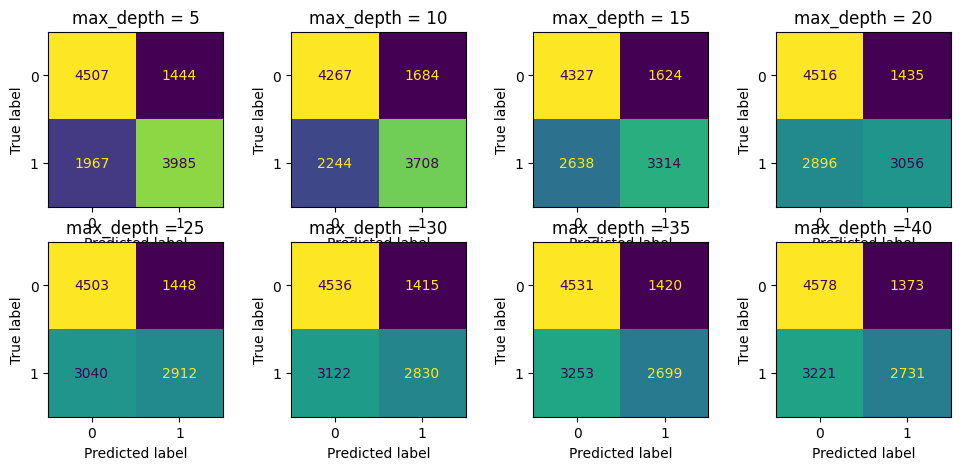

In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

cm_1 = confusion_matrix(y_test, DTC_pred[0])
cm_2 = confusion_matrix(y_test, DTC_pred[1])
cm_3 = confusion_matrix(y_test, DTC_pred[2])
cm_4 = confusion_matrix(y_test, DTC_pred[3])
cm_5 = confusion_matrix(y_test, DTC_pred[4])
cm_6 = confusion_matrix(y_test, DTC_pred[5])
cm_7 = confusion_matrix(y_test, DTC_pred[6])
cm_8 = confusion_matrix(y_test, DTC_pred[7])

fig, axes = plt.subplots(2, 4, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_depth = 5')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_depth = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_depth = 15')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_depth = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_depth = 25')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_depth = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_depth = 35')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_depth = 40')

#### Logistic Regression


In [ ]:
accuracy_LR = []
precision_LR = []
recall_LR = []
f1_LR = []
LR_pred = []
i = 10
while i<151:
  mod_dt = LogisticRegression(max_iter = i, random_state = 1)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  LR_pred.append(prediction)
  accuracy_LR.append(metrics.accuracy_score(prediction,y_test))
  precision_LR.append(metrics.precision_score(prediction,y_test))
  recall_LR.append(metrics.recall_score(prediction,y_test))
  f1_LR.append(metrics.f1_score(prediction,y_test))
  i+= 10

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _c

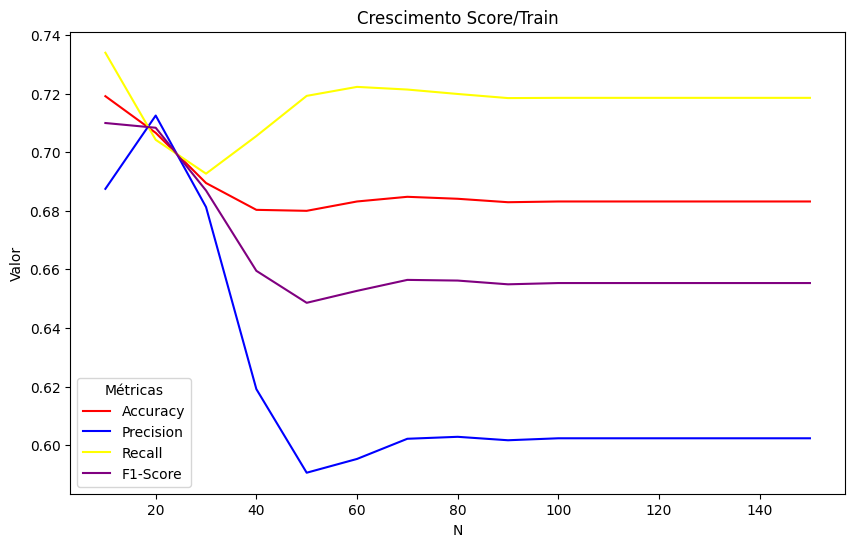

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [10,20,30,40,50,60,70,80,90,100,110,120,130,140,150]
data_l['accuracy'] = accuracy_LR
data_l['precision'] = precision_LR
data_l['recall'] = recall_LR
data_l['F1-score'] = f1_LR
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_iter = 150')

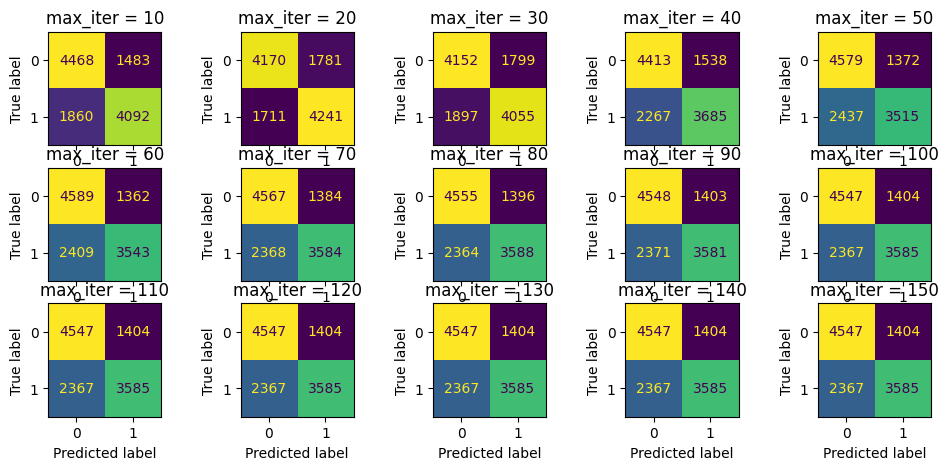

In [ ]:
cm_1 = confusion_matrix(y_test, LR_pred[0])
cm_2 = confusion_matrix(y_test, LR_pred[1])
cm_3 = confusion_matrix(y_test, LR_pred[2])
cm_4 = confusion_matrix(y_test, LR_pred[3])
cm_5 = confusion_matrix(y_test, LR_pred[4])
cm_6 = confusion_matrix(y_test, LR_pred[5])
cm_7 = confusion_matrix(y_test, LR_pred[6])
cm_8 = confusion_matrix(y_test, LR_pred[7])
cm_9 = confusion_matrix(y_test, LR_pred[8])
cm_10 = confusion_matrix(y_test, LR_pred[9])
cm_11 = confusion_matrix(y_test, LR_pred[10])
cm_12 = confusion_matrix(y_test, LR_pred[11])
cm_13 = confusion_matrix(y_test, LR_pred[12])
cm_14 = confusion_matrix(y_test, LR_pred[13])
cm_15 = confusion_matrix(y_test, LR_pred[14])

fig, axes = plt.subplots(3, 5, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_iter = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_iter = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_iter = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_iter = 40')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[0,4], colorbar=False)
axes[0,4].set_title('max_iter = 50')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_iter = 60')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_iter = 70')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_iter = 80')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_9)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_iter = 90')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_10)
disp_rfc.plot(ax=axes[1,4], colorbar=False)
axes[1,4].set_title('max_iter = 100')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_11)
disp_rfc.plot(ax=axes[2,0], colorbar=False)
axes[2,0].set_title('max_iter = 110')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_12)
disp_rfc.plot(ax=axes[2,1], colorbar=False)
axes[2,1].set_title('max_iter = 120')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_13)
disp_rfc.plot(ax=axes[2,2], colorbar=False)
axes[2,2].set_title('max_iter = 130')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_14)
disp_rfc.plot(ax=axes[2,3], colorbar=False)
axes[2,3].set_title('max_iter = 140')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_15)
disp_rfc.plot(ax=axes[2,4], colorbar=False)
axes[2,4].set_title('max_iter = 150')

#### Linear Support Vector Classifier


In [ ]:
accuracy_LSVC = []
precision_LSVC = []
recall_LSVC = []
f1_LSVC = []
LSVC_pred = []
i = 10
while i<151:
  mod_dt = LinearSVC(max_iter = i, random_state = 42)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  LSVC_pred.append(prediction)
  accuracy_LSVC.append(metrics.accuracy_score(prediction,y_test))
  precision_LSVC.append(metrics.precision_score(prediction,y_test))
  recall_LSVC.append(metrics.recall_score(prediction,y_test))
  f1_LSVC.append(metrics.f1_score(prediction,y_test))
  i+= 10

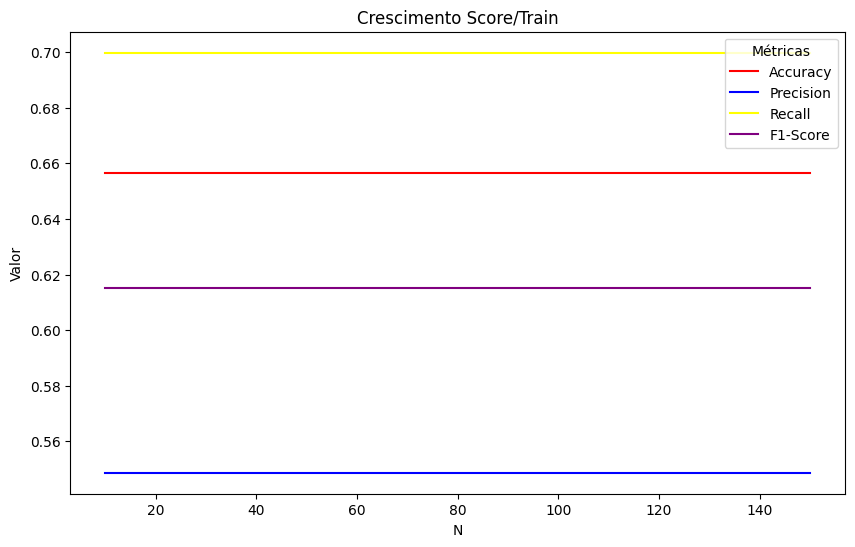

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [10,20,30,40,50,60,70,80,90,100,110,120,130,140,150]
data_l['accuracy'] = accuracy_LSVC
data_l['precision'] = precision_LSVC
data_l['recall'] = recall_LSVC
data_l['F1-score'] = f1_LSVC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_iter = 150')

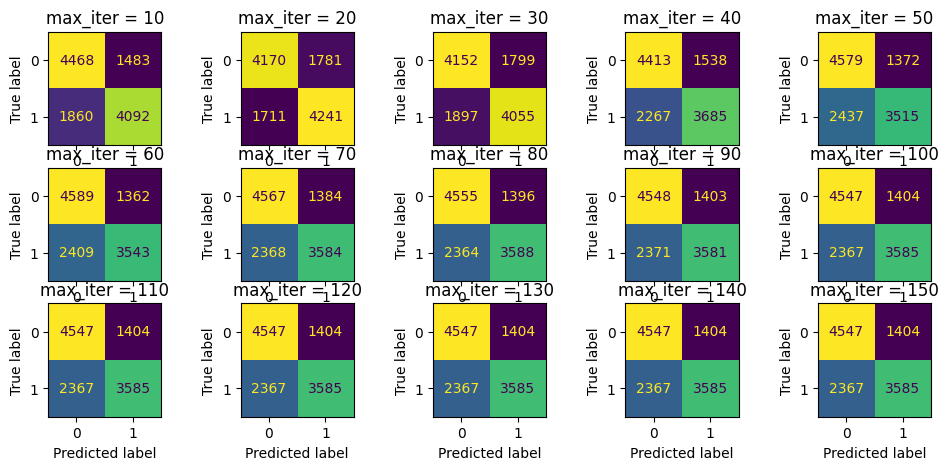

In [ ]:
cm_1 = confusion_matrix(y_test, LR_pred[0])
cm_2 = confusion_matrix(y_test, LR_pred[1])
cm_3 = confusion_matrix(y_test, LR_pred[2])
cm_4 = confusion_matrix(y_test, LR_pred[3])
cm_5 = confusion_matrix(y_test, LR_pred[4])
cm_6 = confusion_matrix(y_test, LR_pred[5])
cm_7 = confusion_matrix(y_test, LR_pred[6])
cm_8 = confusion_matrix(y_test, LR_pred[7])
cm_9 = confusion_matrix(y_test, LR_pred[8])
cm_10 = confusion_matrix(y_test, LR_pred[9])
cm_11 = confusion_matrix(y_test, LR_pred[10])
cm_12 = confusion_matrix(y_test, LR_pred[11])
cm_13 = confusion_matrix(y_test, LR_pred[12])
cm_14 = confusion_matrix(y_test, LR_pred[13])
cm_15 = confusion_matrix(y_test, LR_pred[14])

fig, axes = plt.subplots(3, 5, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_iter = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_iter = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_iter = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_iter = 40')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[0,4], colorbar=False)
axes[0,4].set_title('max_iter = 50')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_iter = 60')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_iter = 70')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_iter = 80')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_9)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_iter = 90')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_10)
disp_rfc.plot(ax=axes[1,4], colorbar=False)
axes[1,4].set_title('max_iter = 100')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_11)
disp_rfc.plot(ax=axes[2,0], colorbar=False)
axes[2,0].set_title('max_iter = 110')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_12)
disp_rfc.plot(ax=axes[2,1], colorbar=False)
axes[2,1].set_title('max_iter = 120')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_13)
disp_rfc.plot(ax=axes[2,2], colorbar=False)
axes[2,2].set_title('max_iter = 130')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_14)
disp_rfc.plot(ax=axes[2,3], colorbar=False)
axes[2,3].set_title('max_iter = 140')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_15)
disp_rfc.plot(ax=axes[2,4], colorbar=False)
axes[2,4].set_title('max_iter = 150')

#### Passive Aggressive Classifier


In [ ]:
accuracy_PAC = []
precision_PAC = []
recall_PAC = []
f1_PAC = []
PAC_pred = []
i = 5
while i<41:
  mod_dt = PassiveAggressiveClassifier(max_iter=i, random_state=42)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  PAC_pred.append(prediction)
  accuracy_PAC.append(metrics.accuracy_score(prediction,y_test))
  precision_PAC.append(metrics.precision_score(prediction,y_test))
  recall_PAC.append(metrics.recall_score(prediction,y_test))
  f1_PAC.append(metrics.f1_score(prediction,y_test))
  i+= 5

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:738: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:738: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:738: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:738: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic

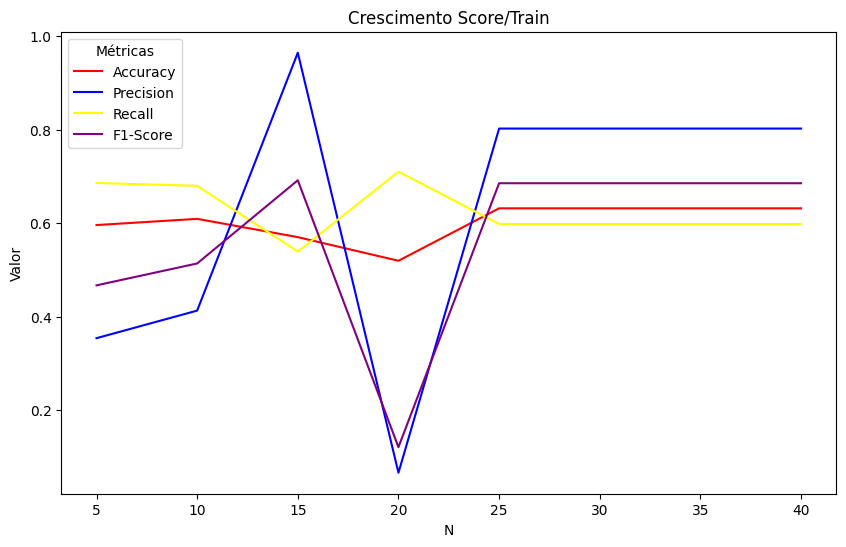

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [5,10,15,20,25,30,35,40]
data_l['accuracy'] = accuracy_PAC
data_l['precision'] = precision_PAC
data_l['recall'] = recall_PAC
data_l['F1-score'] = f1_PAC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_depth = 40')

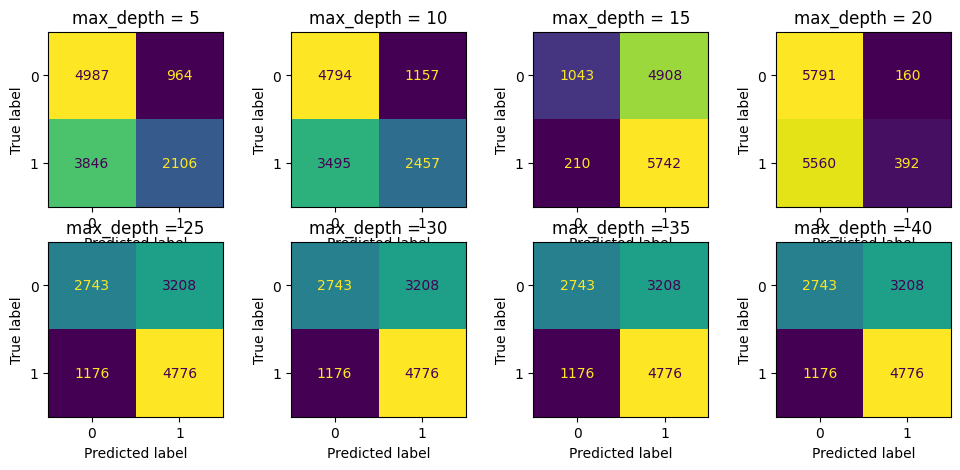

In [ ]:
cm_1 = confusion_matrix(y_test, PAC_pred[0])
cm_2 = confusion_matrix(y_test, PAC_pred[1])
cm_3 = confusion_matrix(y_test, PAC_pred[2])
cm_4 = confusion_matrix(y_test, PAC_pred[3])
cm_5 = confusion_matrix(y_test, PAC_pred[4])
cm_6 = confusion_matrix(y_test, PAC_pred[5])
cm_7 = confusion_matrix(y_test, PAC_pred[6])
cm_8 = confusion_matrix(y_test, PAC_pred[7])

fig, axes = plt.subplots(2, 4, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_depth = 5')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_depth = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_depth = 15')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_depth = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_depth = 25')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_depth = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_depth = 35')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_depth = 40')

###BERT

In [ ]:
# 1. Carregar BERT
tokenizer = BertTokenizer.from_pretrained('neuralmind/bert-base-portuguese-cased')
model = BertModel.from_pretrained('neuralmind/bert-base-portuguese-cased')
model.eval()

# 2. Função para extrair vetor da [CLS]
def get_bert_vector(texto):
    inputs = tokenizer(texto, return_tensors="pt", truncation=True, padding='max_length', max_length=128)
    with torch.no_grad():
        outputs = model(**inputs)
    return outputs.last_hidden_state[:, 0, :].squeeze().numpy()

# 3. Aplicar aos dados
textos_train = df_fakebr['texto_processado'].astype(str)
textos_test = df_fakerecogna['texto_processado'].astype(str)

x_train = np.array([get_bert_vector(t) for t in textos_train])
y_train = df_fakebr['classificação'].apply(lambda x: 1 if 'true' in x else 0)

x_test = np.array([get_bert_vector(t) for t in textos_test])
y_test = df_fakerecogna['classificação'].apply(lambda x: 1 if 'true' in x else 0)

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


tokenizer_config.json:   0%|          | 0.00/43.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/210k [00:00<?, ?B/s]

added_tokens.json:   0%|          | 0.00/2.00 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/112 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/647 [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/438M [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/438M [00:00<?, ?B/s]

#### RFC

In [ ]:
accuracy_RFC = []
precision_RFC = []
recall_RFC = []
f1_RFC = []
score = []
RFC_pred = []
i = 5
while i<41:
  forest=RandomForestClassifier(max_depth = i,random_state=45)
  forest.fit(x_train,y_train)
  prediction=forest.predict(x_test)
  RFC_pred.append(prediction)
  accuracy_RFC.append(metrics.accuracy_score(prediction,y_test))
  precision_RFC.append(metrics.precision_score(prediction,y_test))
  recall_RFC.append(metrics.recall_score(prediction,y_test))
  f1_RFC.append(metrics.f1_score(prediction,y_test))
  i+= 5

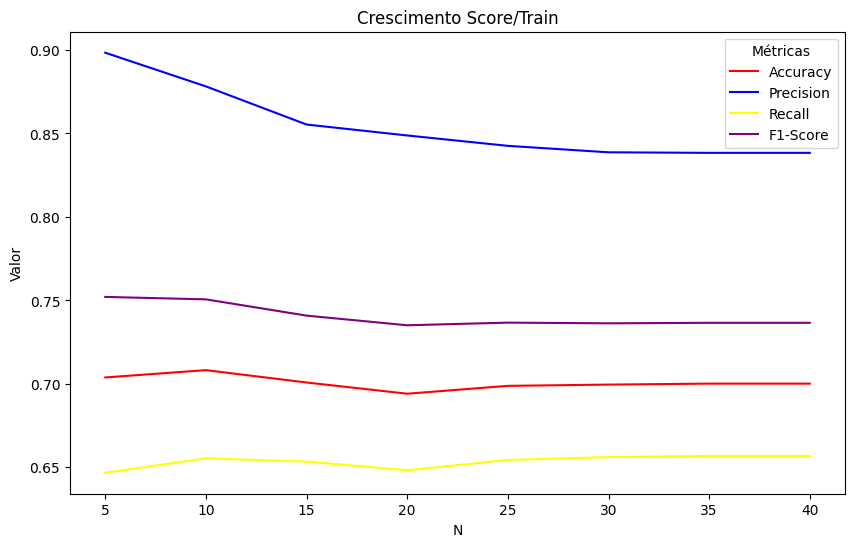

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [5,10,15,20,25,30,35,40]
data_l['accuracy'] = accuracy_RFC
data_l['precision'] = precision_RFC
data_l['recall'] = recall_RFC
data_l['F1-score'] = f1_RFC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_depth = 40')

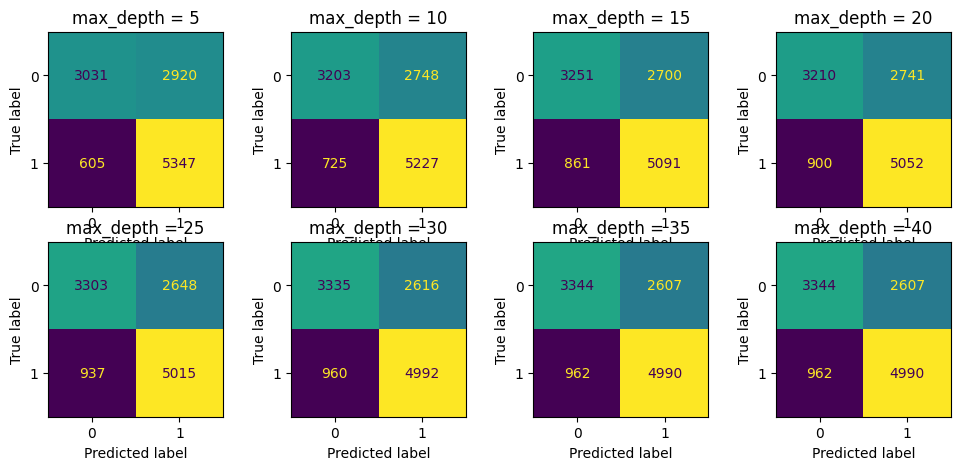

In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

cm_1 = confusion_matrix(y_test, RFC_pred[0])
cm_2 = confusion_matrix(y_test, RFC_pred[1])
cm_3 = confusion_matrix(y_test, RFC_pred[2])
cm_4 = confusion_matrix(y_test, RFC_pred[3])
cm_5 = confusion_matrix(y_test, RFC_pred[4])
cm_6 = confusion_matrix(y_test, RFC_pred[5])
cm_7 = confusion_matrix(y_test, RFC_pred[6])
cm_8 = confusion_matrix(y_test, RFC_pred[7])

fig, axes = plt.subplots(2, 4, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_depth = 5')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_depth = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_depth = 15')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_depth = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_depth = 25')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_depth = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_depth = 35')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_depth = 40')

#### DTC

In [ ]:
accuracy_DTC = []
precision_DTC = []
recall_DTC = []
f1_DTC = []
DTC_pred = []
i = 5
while i<41:
  mod_dt = DecisionTreeClassifier(max_depth = i, random_state = 1)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  DTC_pred.append(prediction)
  accuracy_DTC.append(metrics.accuracy_score(prediction,y_test))
  precision_DTC.append(metrics.precision_score(prediction,y_test))
  recall_DTC.append(metrics.recall_score(prediction,y_test))
  f1_DTC.append(metrics.f1_score(prediction,y_test))
  i+= 5

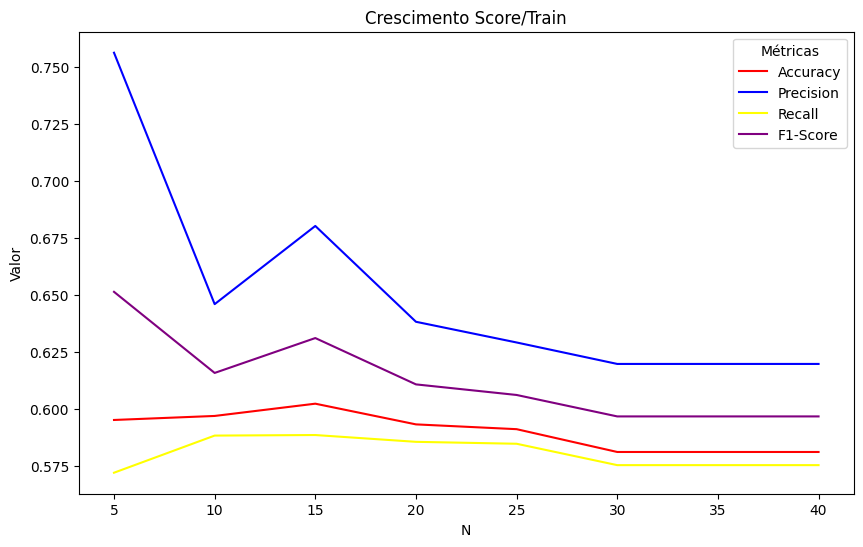

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [5,10,15,20,25,30,35,40]
data_l['accuracy'] = accuracy_DTC
data_l['precision'] = precision_DTC
data_l['recall'] = recall_DTC
data_l['F1-score'] = f1_DTC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_depth = 40')

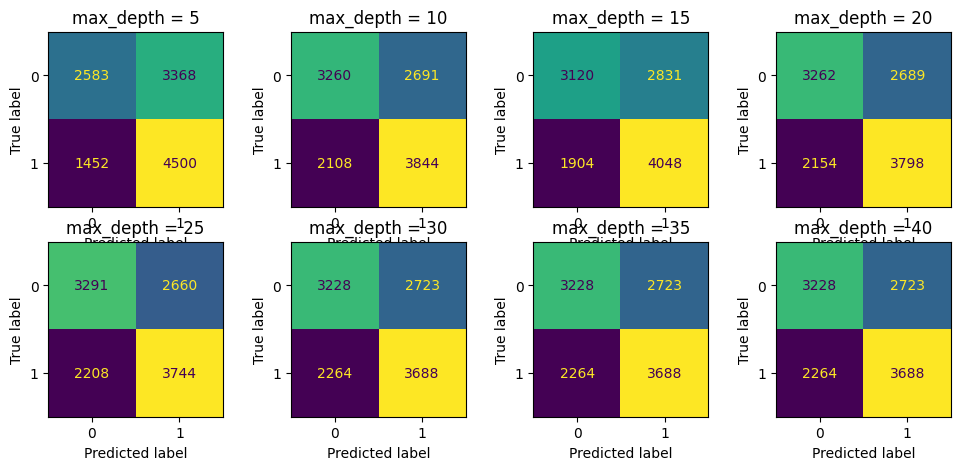

In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

cm_1 = confusion_matrix(y_test, DTC_pred[0])
cm_2 = confusion_matrix(y_test, DTC_pred[1])
cm_3 = confusion_matrix(y_test, DTC_pred[2])
cm_4 = confusion_matrix(y_test, DTC_pred[3])
cm_5 = confusion_matrix(y_test, DTC_pred[4])
cm_6 = confusion_matrix(y_test, DTC_pred[5])
cm_7 = confusion_matrix(y_test, DTC_pred[6])
cm_8 = confusion_matrix(y_test, DTC_pred[7])

fig, axes = plt.subplots(2, 4, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_depth = 5')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_depth = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_depth = 15')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_depth = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_depth = 25')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_depth = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_depth = 35')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_depth = 40')

#### Logistic Regression


In [ ]:
accuracy_LR = []
precision_LR = []
recall_LR = []
f1_LR = []
LR_pred = []
i = 10
while i<151:
  mod_dt = LogisticRegression(max_iter = i, random_state = 1)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  LR_pred.append(prediction)
  accuracy_LR.append(metrics.accuracy_score(prediction,y_test))
  precision_LR.append(metrics.precision_score(prediction,y_test))
  recall_LR.append(metrics.recall_score(prediction,y_test))
  f1_LR.append(metrics.f1_score(prediction,y_test))
  i+= 10

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _c

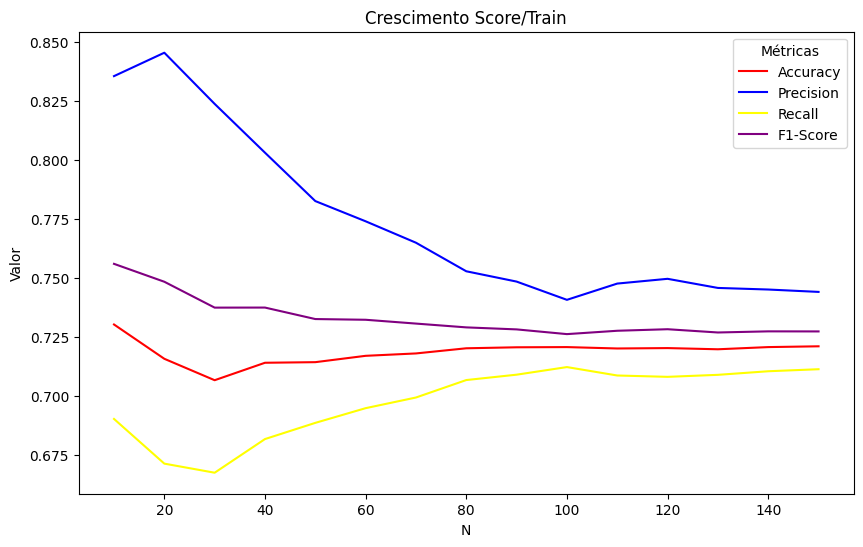

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [10,20,30,40,50,60,70,80,90,100,110,120,130,140,150]
data_l['accuracy'] = accuracy_LR
data_l['precision'] = precision_LR
data_l['recall'] = recall_LR
data_l['F1-score'] = f1_LR
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_iter = 150')

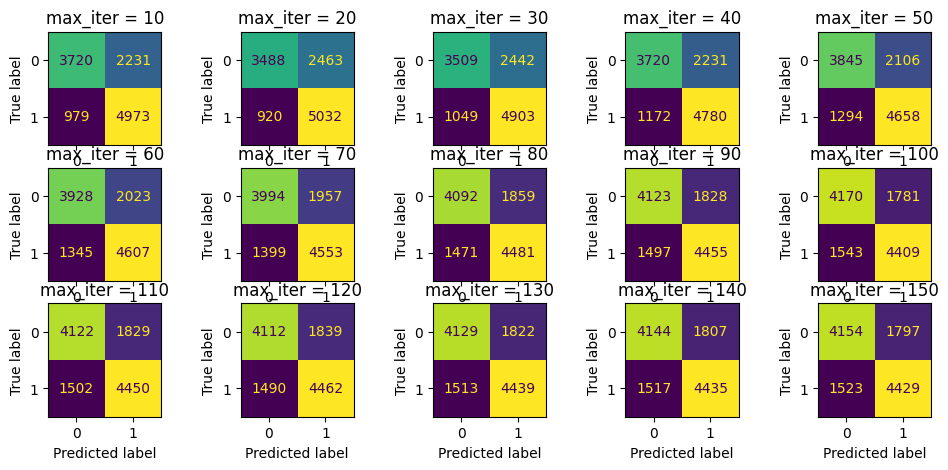

In [ ]:
cm_1 = confusion_matrix(y_test, LR_pred[0])
cm_2 = confusion_matrix(y_test, LR_pred[1])
cm_3 = confusion_matrix(y_test, LR_pred[2])
cm_4 = confusion_matrix(y_test, LR_pred[3])
cm_5 = confusion_matrix(y_test, LR_pred[4])
cm_6 = confusion_matrix(y_test, LR_pred[5])
cm_7 = confusion_matrix(y_test, LR_pred[6])
cm_8 = confusion_matrix(y_test, LR_pred[7])
cm_9 = confusion_matrix(y_test, LR_pred[8])
cm_10 = confusion_matrix(y_test, LR_pred[9])
cm_11 = confusion_matrix(y_test, LR_pred[10])
cm_12 = confusion_matrix(y_test, LR_pred[11])
cm_13 = confusion_matrix(y_test, LR_pred[12])
cm_14 = confusion_matrix(y_test, LR_pred[13])
cm_15 = confusion_matrix(y_test, LR_pred[14])

fig, axes = plt.subplots(3, 5, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_iter = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_iter = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_iter = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_iter = 40')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[0,4], colorbar=False)
axes[0,4].set_title('max_iter = 50')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_iter = 60')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_iter = 70')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_iter = 80')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_9)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_iter = 90')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_10)
disp_rfc.plot(ax=axes[1,4], colorbar=False)
axes[1,4].set_title('max_iter = 100')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_11)
disp_rfc.plot(ax=axes[2,0], colorbar=False)
axes[2,0].set_title('max_iter = 110')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_12)
disp_rfc.plot(ax=axes[2,1], colorbar=False)
axes[2,1].set_title('max_iter = 120')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_13)
disp_rfc.plot(ax=axes[2,2], colorbar=False)
axes[2,2].set_title('max_iter = 130')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_14)
disp_rfc.plot(ax=axes[2,3], colorbar=False)
axes[2,3].set_title('max_iter = 140')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_15)
disp_rfc.plot(ax=axes[2,4], colorbar=False)
axes[2,4].set_title('max_iter = 150')

#### Linear Support Vector Classifier


In [ ]:
accuracy_LSVC = []
precision_LSVC = []
recall_LSVC = []
f1_LSVC = []
LSVC_pred = []
i = 10
while i<151:
  mod_dt = LinearSVC(max_iter = i, random_state = 42)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  LSVC_pred.append(prediction)
  accuracy_LSVC.append(metrics.accuracy_score(prediction,y_test))
  precision_LSVC.append(metrics.precision_score(prediction,y_test))
  recall_LSVC.append(metrics.recall_score(prediction,y_test))
  f1_LSVC.append(metrics.f1_score(prediction,y_test))
  i+= 10

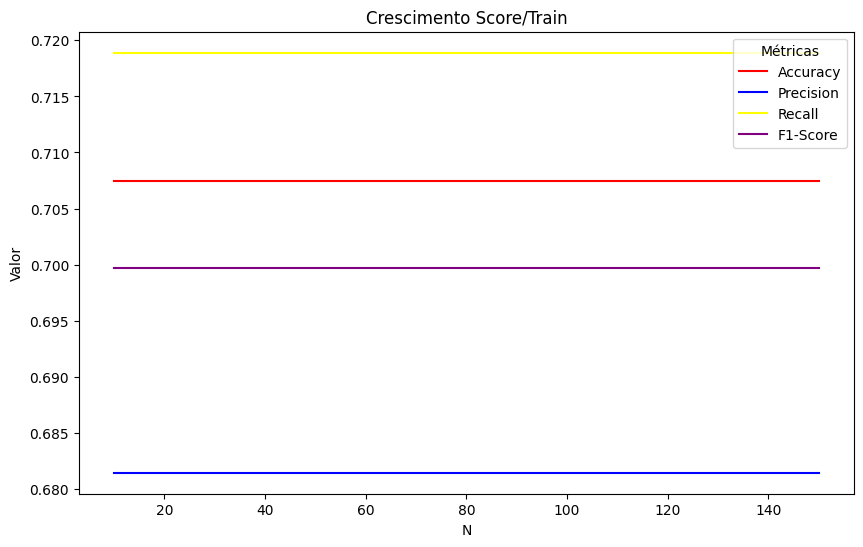

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [10,20,30,40,50,60,70,80,90,100,110,120,130,140,150]
data_l['accuracy'] = accuracy_LSVC
data_l['precision'] = precision_LSVC
data_l['recall'] = recall_LSVC
data_l['F1-score'] = f1_LSVC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_iter = 150')

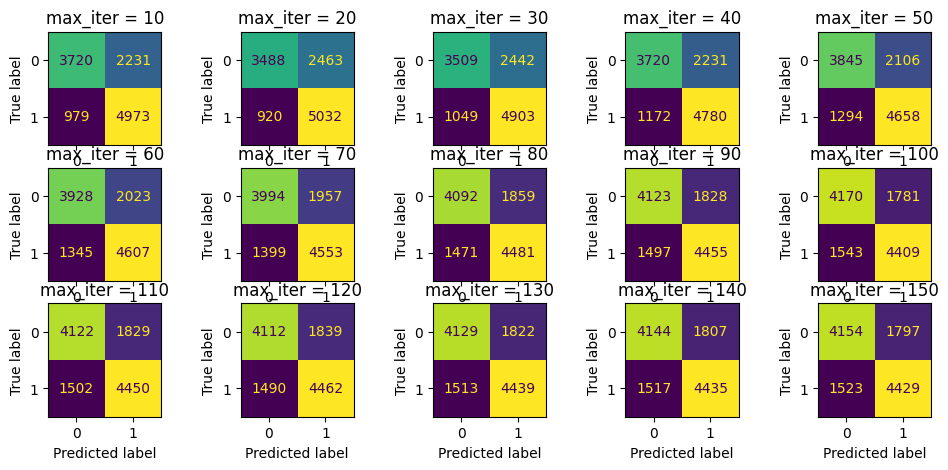

In [ ]:
cm_1 = confusion_matrix(y_test, LR_pred[0])
cm_2 = confusion_matrix(y_test, LR_pred[1])
cm_3 = confusion_matrix(y_test, LR_pred[2])
cm_4 = confusion_matrix(y_test, LR_pred[3])
cm_5 = confusion_matrix(y_test, LR_pred[4])
cm_6 = confusion_matrix(y_test, LR_pred[5])
cm_7 = confusion_matrix(y_test, LR_pred[6])
cm_8 = confusion_matrix(y_test, LR_pred[7])
cm_9 = confusion_matrix(y_test, LR_pred[8])
cm_10 = confusion_matrix(y_test, LR_pred[9])
cm_11 = confusion_matrix(y_test, LR_pred[10])
cm_12 = confusion_matrix(y_test, LR_pred[11])
cm_13 = confusion_matrix(y_test, LR_pred[12])
cm_14 = confusion_matrix(y_test, LR_pred[13])
cm_15 = confusion_matrix(y_test, LR_pred[14])

fig, axes = plt.subplots(3, 5, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_iter = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_iter = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_iter = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_iter = 40')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[0,4], colorbar=False)
axes[0,4].set_title('max_iter = 50')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_iter = 60')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_iter = 70')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_iter = 80')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_9)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_iter = 90')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_10)
disp_rfc.plot(ax=axes[1,4], colorbar=False)
axes[1,4].set_title('max_iter = 100')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_11)
disp_rfc.plot(ax=axes[2,0], colorbar=False)
axes[2,0].set_title('max_iter = 110')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_12)
disp_rfc.plot(ax=axes[2,1], colorbar=False)
axes[2,1].set_title('max_iter = 120')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_13)
disp_rfc.plot(ax=axes[2,2], colorbar=False)
axes[2,2].set_title('max_iter = 130')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_14)
disp_rfc.plot(ax=axes[2,3], colorbar=False)
axes[2,3].set_title('max_iter = 140')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_15)
disp_rfc.plot(ax=axes[2,4], colorbar=False)
axes[2,4].set_title('max_iter = 150')

#### Passive Aggressive Classifier


In [ ]:
accuracy_PAC = []
precision_PAC = []
recall_PAC = []
f1_PAC = []
PAC_pred = []
i = 5
while i<41:
  mod_dt = PassiveAggressiveClassifier(max_iter=i, random_state=42)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  PAC_pred.append(prediction)
  accuracy_PAC.append(metrics.accuracy_score(prediction,y_test))
  precision_PAC.append(metrics.precision_score(prediction,y_test))
  recall_PAC.append(metrics.recall_score(prediction,y_test))
  f1_PAC.append(metrics.f1_score(prediction,y_test))
  i+= 5

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:738: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:738: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:738: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:738: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic

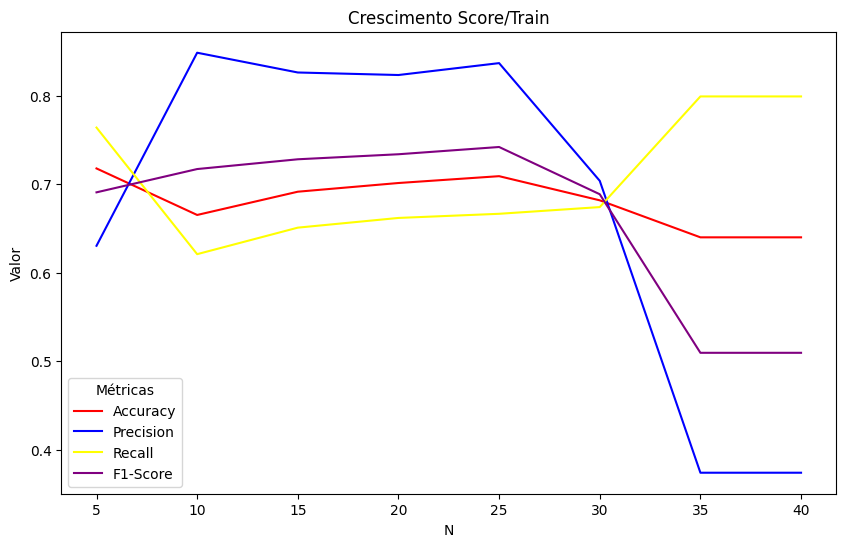

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [5,10,15,20,25,30,35,40]
data_l['accuracy'] = accuracy_PAC
data_l['precision'] = precision_PAC
data_l['recall'] = recall_PAC
data_l['F1-score'] = f1_PAC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_depth = 40')

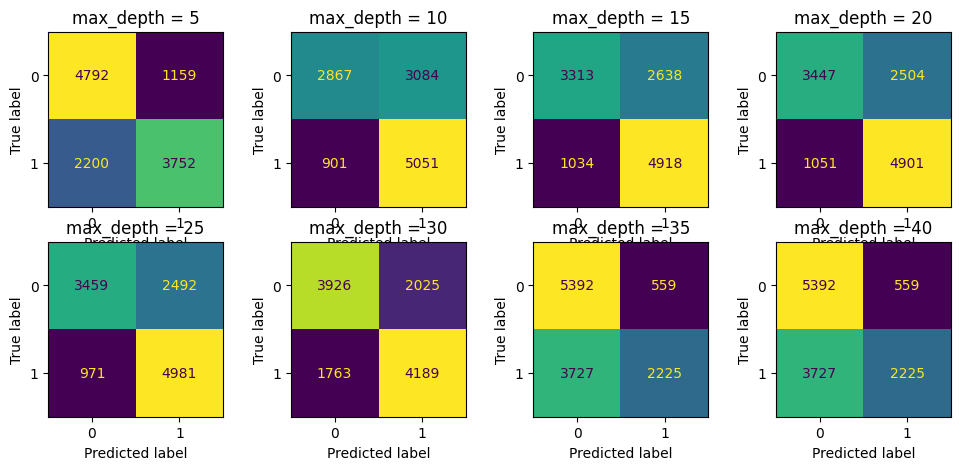

In [ ]:
cm_1 = confusion_matrix(y_test, PAC_pred[0])
cm_2 = confusion_matrix(y_test, PAC_pred[1])
cm_3 = confusion_matrix(y_test, PAC_pred[2])
cm_4 = confusion_matrix(y_test, PAC_pred[3])
cm_5 = confusion_matrix(y_test, PAC_pred[4])
cm_6 = confusion_matrix(y_test, PAC_pred[5])
cm_7 = confusion_matrix(y_test, PAC_pred[6])
cm_8 = confusion_matrix(y_test, PAC_pred[7])

fig, axes = plt.subplots(2, 4, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_depth = 5')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_depth = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_depth = 15')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_depth = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_depth = 25')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_depth = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_depth = 35')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_depth = 40')

## FakeRecogna predizendo Fake.br

In [ ]:
df_fakerecogna.head()

,texto_processado,classificação
0,apagão vaticano papar presar acusação tráfico ...,fake
1,governar equador anunciar preparar cova coleti...,true
2,companhia air france operar voar direto pequim...,true
3,marfrig global foods retomar vender carnar bov...,true
4,assunto voltar compartilhar rede social julho ...,fake


In [ ]:
df_fakerecogna['num_palavras'] = df_fakerecogna['texto_processado'].astype(str).apply(lambda x: len(x.split()))
print(df_fakerecogna['num_palavras'].describe())

count    11903.000000
mean        66.655885
std         50.627468
min          1.000000
25%         42.000000
50%         61.000000
75%         80.000000
max       1140.000000
Name: num_palavras, dtype: float64


In [ ]:
palavras = " ".join(df_fakerecogna['texto_processado'].astype(str)).split()
frequencia = Counter(palavras)
print(frequencia.most_common(10))  # Top 10 palavras mais frequentes

[('covid', 5316), ('dia', 4740), ('presidente', 4430), ('bolsonaro', 4297), ('coronavírus', 4268), ('saudar', 4252), ('d', 4026), ('brasil', 3891), ('n', 3752), ('pessoa', 3701)]


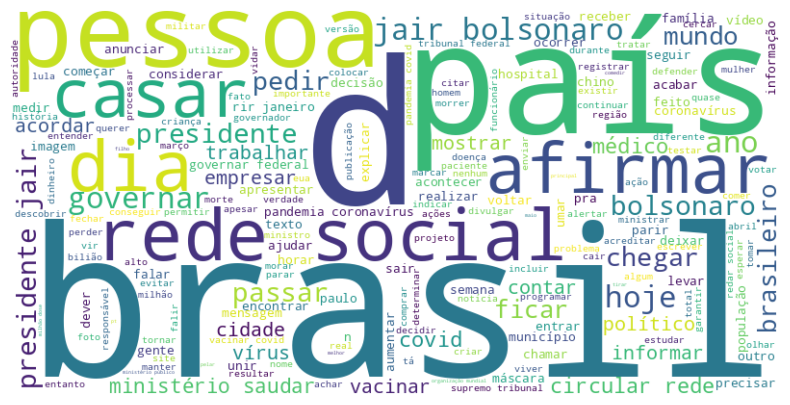

In [ ]:
texto = " ".join(df_fakerecogna['texto_processado'].astype(str))
wordcloud = WordCloud(width=800, height=400, background_color="white").generate(texto)

plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()

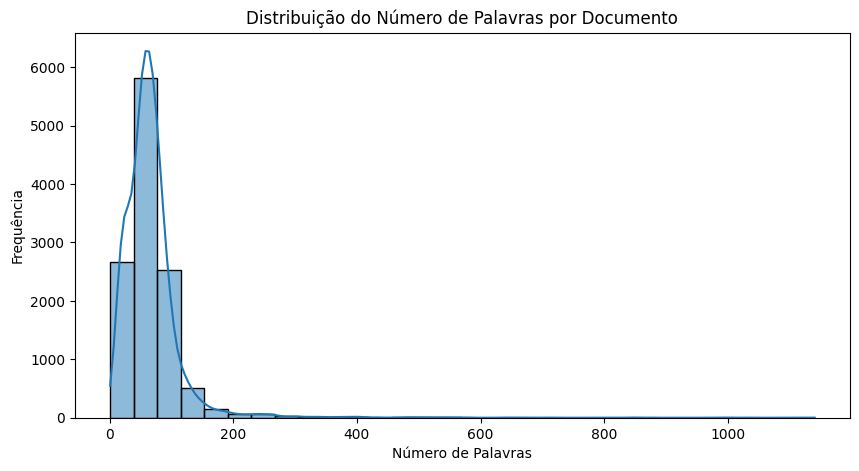

In [ ]:
plt.figure(figsize=(10,5))
sns.histplot(df_fakerecogna['num_palavras'], bins=30, kde=True)
plt.xlabel("Número de Palavras")
plt.ylabel("Frequência")
plt.title("Distribuição do Número de Palavras por Documento")
plt.show()

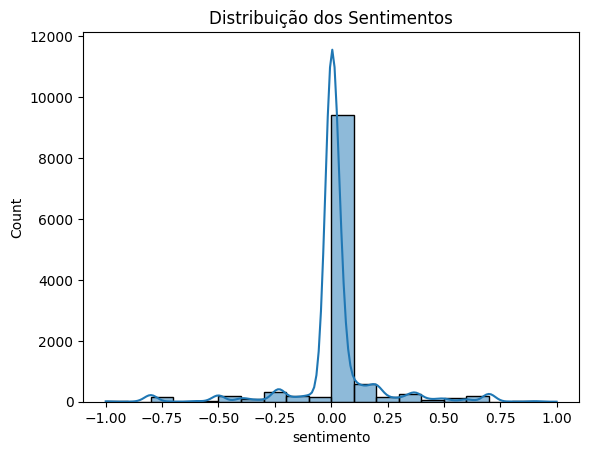

In [ ]:
from textblob import TextBlob

df_fakerecogna['texto_processado'] = df_fakerecogna['texto_processado'].astype(str)
df_fakerecogna['sentimento'] = df_fakerecogna['texto_processado'].apply(lambda x: TextBlob(x).sentiment.polarity)
sns.histplot(df_fakerecogna['sentimento'], bins=20, kde=True)
plt.title("Distribuição dos Sentimentos")
plt.show()

### TF-IDF

In [ ]:
vetorizador = TfidfVectorizer()

x_train = vetorizador.fit_transform(df_fakerecogna['texto_processado'].astype(str))
y_train = df_fakerecogna['classificação'].apply(lambda x: 1 if 'true' in x else 0)
x_test = vetorizador.transform(df_fakebr['texto_processado'].astype(str))
y_test = df_fakebr['classificação'].apply(lambda x: 1 if 'true' in x else 0)

#### RFC

In [ ]:
accuracy_RFC = []
precision_RFC = []
recall_RFC = []
f1_RFC = []
score = []
RFC_pred = []
i = 5
while i<41:
  forest=RandomForestClassifier(max_depth = i,random_state=45)
  forest.fit(x_train,y_train)
  prediction=forest.predict(x_test)
  RFC_pred.append(prediction)
  accuracy_RFC.append(metrics.accuracy_score(prediction,y_test))
  precision_RFC.append(metrics.precision_score(prediction,y_test))
  recall_RFC.append(metrics.recall_score(prediction,y_test))
  f1_RFC.append(metrics.f1_score(prediction,y_test))
  i+= 5

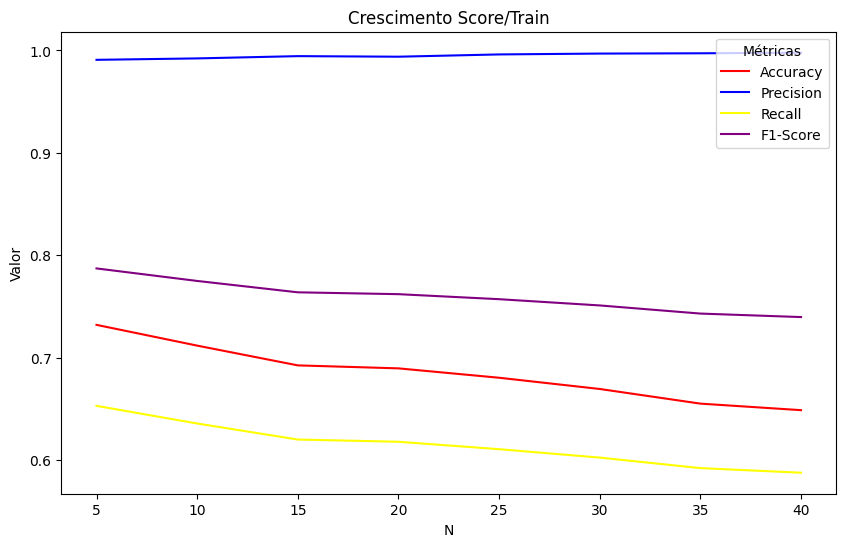

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [5,10,15,20,25,30,35,40]
data_l['accuracy'] = accuracy_RFC
data_l['precision'] = precision_RFC
data_l['recall'] = recall_RFC
data_l['F1-score'] = f1_RFC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_depth = 40')

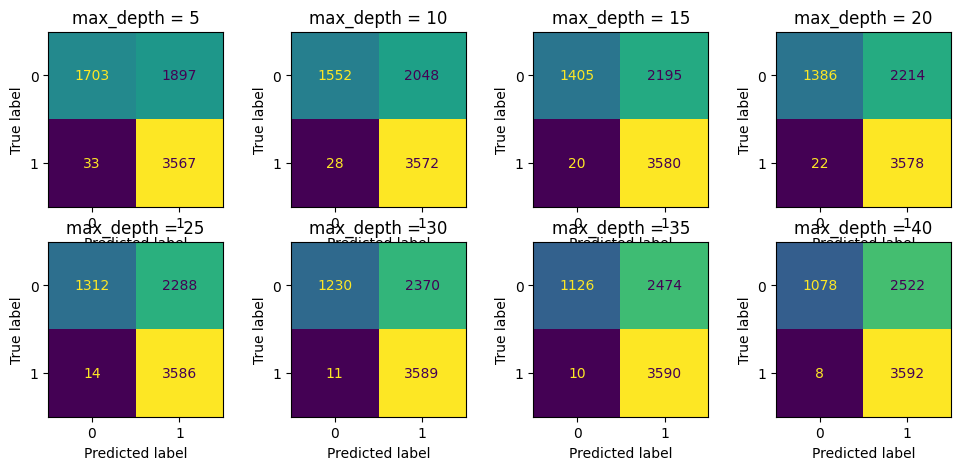

In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

cm_1 = confusion_matrix(y_test, RFC_pred[0])
cm_2 = confusion_matrix(y_test, RFC_pred[1])
cm_3 = confusion_matrix(y_test, RFC_pred[2])
cm_4 = confusion_matrix(y_test, RFC_pred[3])
cm_5 = confusion_matrix(y_test, RFC_pred[4])
cm_6 = confusion_matrix(y_test, RFC_pred[5])
cm_7 = confusion_matrix(y_test, RFC_pred[6])
cm_8 = confusion_matrix(y_test, RFC_pred[7])

fig, axes = plt.subplots(2, 4, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_depth = 5')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_depth = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_depth = 15')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_depth = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_depth = 25')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_depth = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_depth = 35')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_depth = 40')

#### DTC

In [ ]:
accuracy_DTC = []
precision_DTC = []
recall_DTC = []
f1_DTC = []
DTC_pred = []
i = 5
while i<41:
  mod_dt = DecisionTreeClassifier(max_depth = i, random_state = 1)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  DTC_pred.append(prediction)
  accuracy_DTC.append(metrics.accuracy_score(prediction,y_test))
  precision_DTC.append(metrics.precision_score(prediction,y_test))
  recall_DTC.append(metrics.recall_score(prediction,y_test))
  f1_DTC.append(metrics.f1_score(prediction,y_test))
  i+= 5

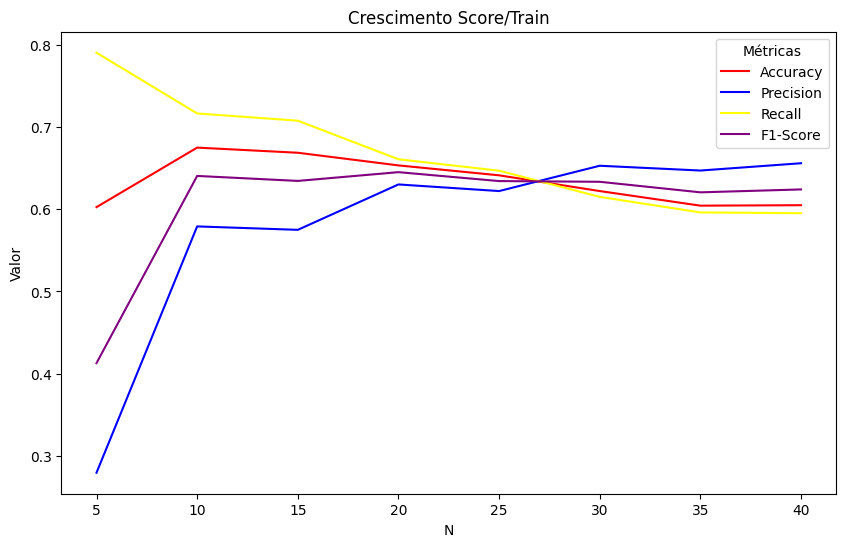

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [5,10,15,20,25,30,35,40]
data_l['accuracy'] = accuracy_DTC
data_l['precision'] = precision_DTC
data_l['recall'] = recall_DTC
data_l['F1-score'] = f1_DTC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_depth = 40')

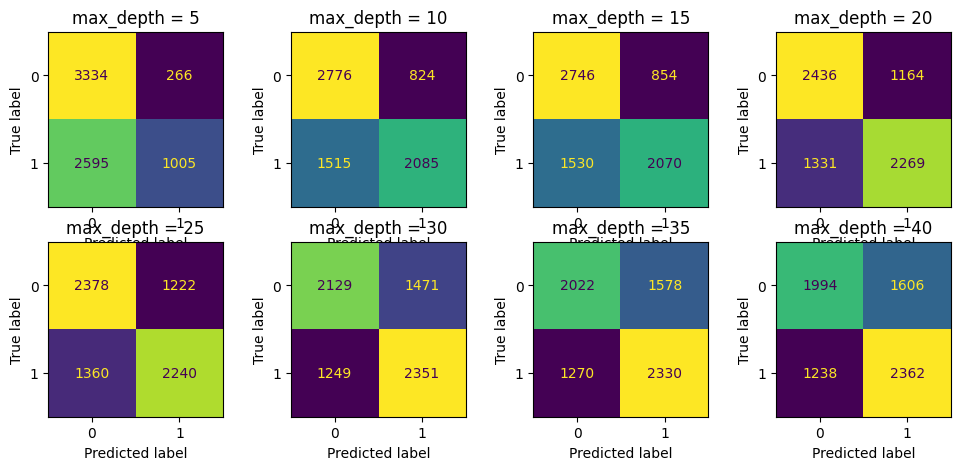

In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

cm_1 = confusion_matrix(y_test, DTC_pred[0])
cm_2 = confusion_matrix(y_test, DTC_pred[1])
cm_3 = confusion_matrix(y_test, DTC_pred[2])
cm_4 = confusion_matrix(y_test, DTC_pred[3])
cm_5 = confusion_matrix(y_test, DTC_pred[4])
cm_6 = confusion_matrix(y_test, DTC_pred[5])
cm_7 = confusion_matrix(y_test, DTC_pred[6])
cm_8 = confusion_matrix(y_test, DTC_pred[7])

fig, axes = plt.subplots(2, 4, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_depth = 5')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_depth = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_depth = 15')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_depth = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_depth = 25')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_depth = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_depth = 35')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_depth = 40')

#### Logistic Regression


In [ ]:
accuracy_LR = []
precision_LR = []
recall_LR = []
f1_LR = []
LR_pred = []
i = 10
while i<151:
  mod_dt = LogisticRegression(max_iter = i, random_state = 1)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  LR_pred.append(prediction)
  accuracy_LR.append(metrics.accuracy_score(prediction,y_test))
  precision_LR.append(metrics.precision_score(prediction,y_test))
  recall_LR.append(metrics.recall_score(prediction,y_test))
  f1_LR.append(metrics.f1_score(prediction,y_test))
  i+= 10

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. OF ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


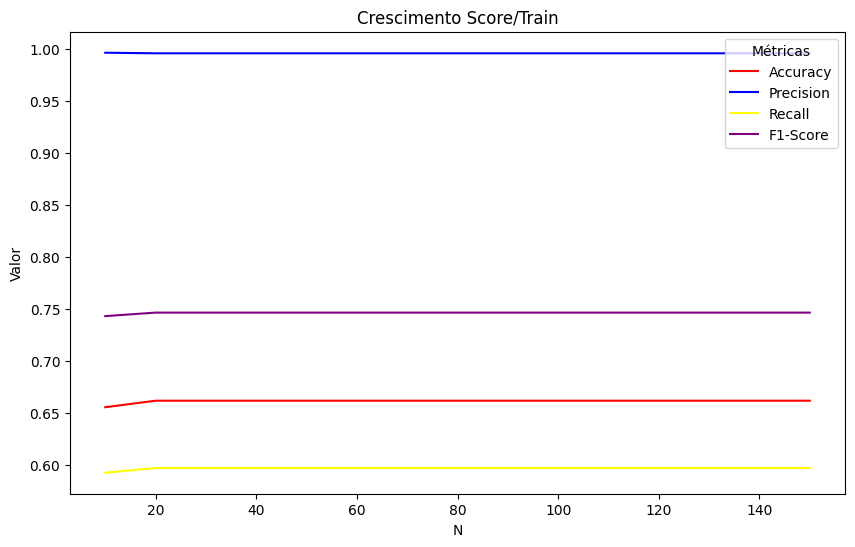

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [10,20,30,40,50,60,70,80,90,100,110,120,130,140,150]
data_l['accuracy'] = accuracy_LR
data_l['precision'] = precision_LR
data_l['recall'] = recall_LR
data_l['F1-score'] = f1_LR
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_iter = 150')

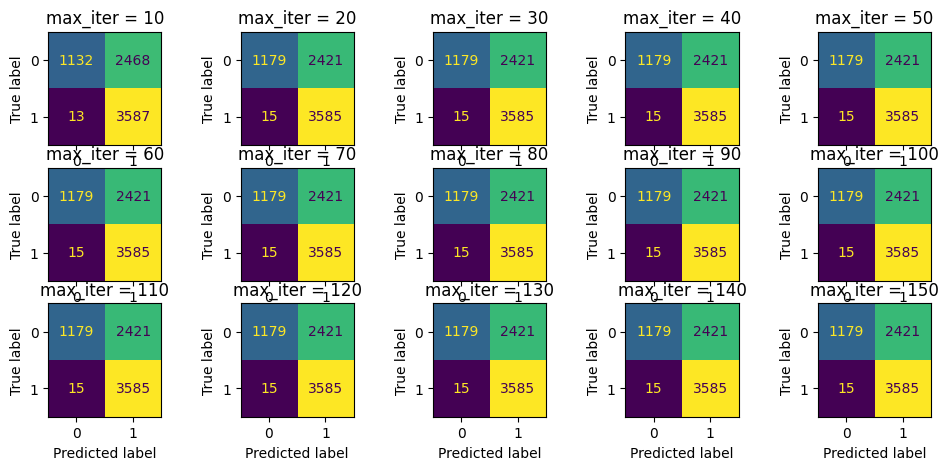

In [ ]:
cm_1 = confusion_matrix(y_test, LR_pred[0])
cm_2 = confusion_matrix(y_test, LR_pred[1])
cm_3 = confusion_matrix(y_test, LR_pred[2])
cm_4 = confusion_matrix(y_test, LR_pred[3])
cm_5 = confusion_matrix(y_test, LR_pred[4])
cm_6 = confusion_matrix(y_test, LR_pred[5])
cm_7 = confusion_matrix(y_test, LR_pred[6])
cm_8 = confusion_matrix(y_test, LR_pred[7])
cm_9 = confusion_matrix(y_test, LR_pred[8])
cm_10 = confusion_matrix(y_test, LR_pred[9])
cm_11 = confusion_matrix(y_test, LR_pred[10])
cm_12 = confusion_matrix(y_test, LR_pred[11])
cm_13 = confusion_matrix(y_test, LR_pred[12])
cm_14 = confusion_matrix(y_test, LR_pred[13])
cm_15 = confusion_matrix(y_test, LR_pred[14])

fig, axes = plt.subplots(3, 5, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_iter = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_iter = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_iter = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_iter = 40')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[0,4], colorbar=False)
axes[0,4].set_title('max_iter = 50')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_iter = 60')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_iter = 70')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_iter = 80')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_9)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_iter = 90')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_10)
disp_rfc.plot(ax=axes[1,4], colorbar=False)
axes[1,4].set_title('max_iter = 100')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_11)
disp_rfc.plot(ax=axes[2,0], colorbar=False)
axes[2,0].set_title('max_iter = 110')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_12)
disp_rfc.plot(ax=axes[2,1], colorbar=False)
axes[2,1].set_title('max_iter = 120')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_13)
disp_rfc.plot(ax=axes[2,2], colorbar=False)
axes[2,2].set_title('max_iter = 130')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_14)
disp_rfc.plot(ax=axes[2,3], colorbar=False)
axes[2,3].set_title('max_iter = 140')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_15)
disp_rfc.plot(ax=axes[2,4], colorbar=False)
axes[2,4].set_title('max_iter = 150')

#### Linear Support Vector Classifier


In [ ]:
accuracy_LSVC = []
precision_LSVC = []
recall_LSVC = []
f1_LSVC = []
LSVC_pred = []
i = 10
while i<151:
  mod_dt = LinearSVC(max_iter = i, random_state = 42)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  LSVC_pred.append(prediction)
  accuracy_LSVC.append(metrics.accuracy_score(prediction,y_test))
  precision_LSVC.append(metrics.precision_score(prediction,y_test))
  recall_LSVC.append(metrics.recall_score(prediction,y_test))
  f1_LSVC.append(metrics.f1_score(prediction,y_test))
  i+= 10

/usr/local/lib/python3.11/dist-packages/sklearn/svm/_base.py:1249: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/svm/_base.py:1249: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/svm/_base.py:1249: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/svm/_base.py:1249: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


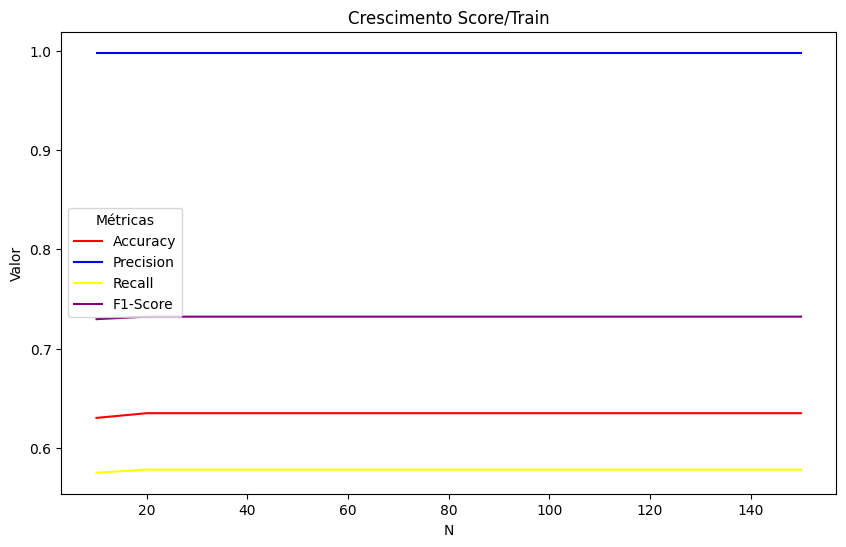

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [10,20,30,40,50,60,70,80,90,100,110,120,130,140,150]
data_l['accuracy'] = accuracy_LSVC
data_l['precision'] = precision_LSVC
data_l['recall'] = recall_LSVC
data_l['F1-score'] = f1_LSVC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_iter = 150')

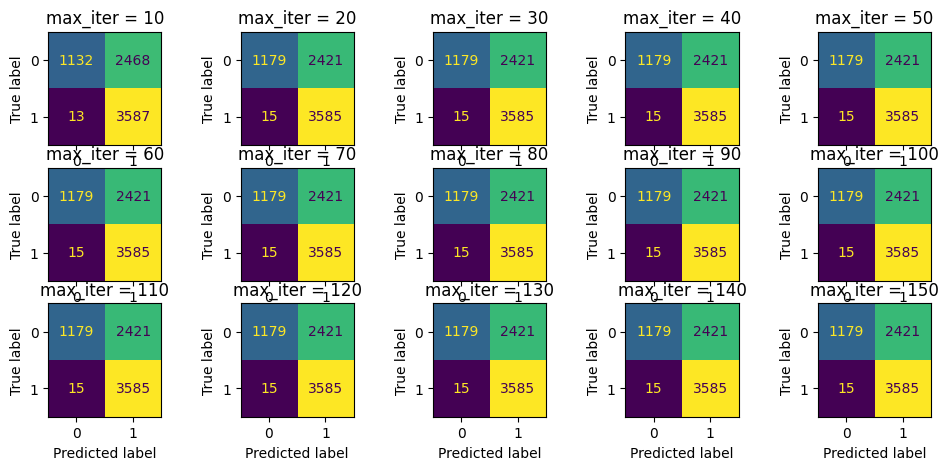

In [ ]:
cm_1 = confusion_matrix(y_test, LR_pred[0])
cm_2 = confusion_matrix(y_test, LR_pred[1])
cm_3 = confusion_matrix(y_test, LR_pred[2])
cm_4 = confusion_matrix(y_test, LR_pred[3])
cm_5 = confusion_matrix(y_test, LR_pred[4])
cm_6 = confusion_matrix(y_test, LR_pred[5])
cm_7 = confusion_matrix(y_test, LR_pred[6])
cm_8 = confusion_matrix(y_test, LR_pred[7])
cm_9 = confusion_matrix(y_test, LR_pred[8])
cm_10 = confusion_matrix(y_test, LR_pred[9])
cm_11 = confusion_matrix(y_test, LR_pred[10])
cm_12 = confusion_matrix(y_test, LR_pred[11])
cm_13 = confusion_matrix(y_test, LR_pred[12])
cm_14 = confusion_matrix(y_test, LR_pred[13])
cm_15 = confusion_matrix(y_test, LR_pred[14])

fig, axes = plt.subplots(3, 5, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_iter = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_iter = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_iter = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_iter = 40')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[0,4], colorbar=False)
axes[0,4].set_title('max_iter = 50')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_iter = 60')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_iter = 70')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_iter = 80')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_9)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_iter = 90')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_10)
disp_rfc.plot(ax=axes[1,4], colorbar=False)
axes[1,4].set_title('max_iter = 100')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_11)
disp_rfc.plot(ax=axes[2,0], colorbar=False)
axes[2,0].set_title('max_iter = 110')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_12)
disp_rfc.plot(ax=axes[2,1], colorbar=False)
axes[2,1].set_title('max_iter = 120')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_13)
disp_rfc.plot(ax=axes[2,2], colorbar=False)
axes[2,2].set_title('max_iter = 130')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_14)
disp_rfc.plot(ax=axes[2,3], colorbar=False)
axes[2,3].set_title('max_iter = 140')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_15)
disp_rfc.plot(ax=axes[2,4], colorbar=False)
axes[2,4].set_title('max_iter = 150')

#### Passive Aggressive Classifier


In [ ]:
accuracy_PAC = []
precision_PAC = []
recall_PAC = []
f1_PAC = []
PAC_pred = []
i = 5
while i<41:
  mod_dt = PassiveAggressiveClassifier(max_iter=i, random_state=42)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  PAC_pred.append(prediction)
  accuracy_PAC.append(metrics.accuracy_score(prediction,y_test))
  precision_PAC.append(metrics.precision_score(prediction,y_test))
  recall_PAC.append(metrics.recall_score(prediction,y_test))
  f1_PAC.append(metrics.f1_score(prediction,y_test))
  i+= 5

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:738: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:738: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:738: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(


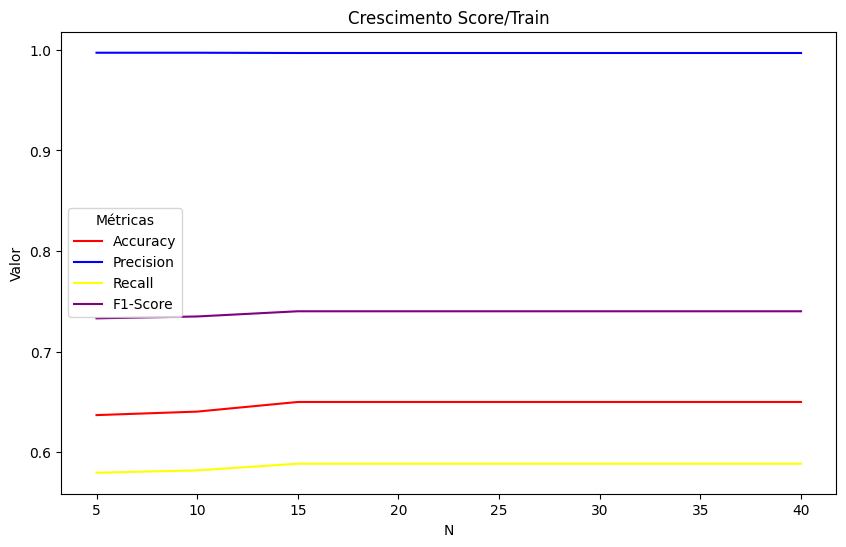

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [5,10,15,20,25,30,35,40]
data_l['accuracy'] = accuracy_PAC
data_l['precision'] = precision_PAC
data_l['recall'] = recall_PAC
data_l['F1-score'] = f1_PAC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_depth = 40')

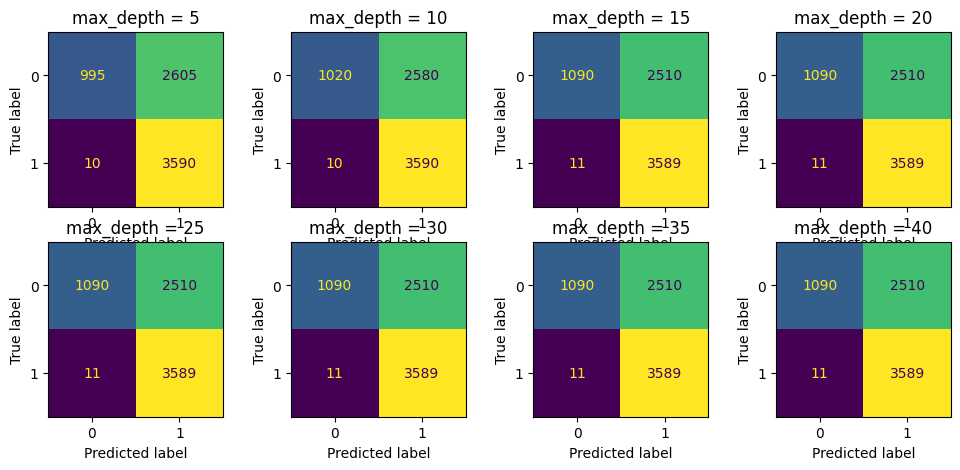

In [ ]:
cm_1 = confusion_matrix(y_test, PAC_pred[0])
cm_2 = confusion_matrix(y_test, PAC_pred[1])
cm_3 = confusion_matrix(y_test, PAC_pred[2])
cm_4 = confusion_matrix(y_test, PAC_pred[3])
cm_5 = confusion_matrix(y_test, PAC_pred[4])
cm_6 = confusion_matrix(y_test, PAC_pred[5])
cm_7 = confusion_matrix(y_test, PAC_pred[6])
cm_8 = confusion_matrix(y_test, PAC_pred[7])

fig, axes = plt.subplots(2, 4, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_depth = 5')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_depth = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_depth = 15')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_depth = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_depth = 25')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_depth = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_depth = 35')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_depth = 40')

###Word2Vec

In [ ]:
# 1. Pré-processamento
fakebr_textos = [str(t).split() for t in df_fakebr['texto_processado']]
fakerecogna_textos = [str(t).split() for t in df_fakerecogna['texto_processado']]

# 2. Treinar Word2Vec SOMENTE com fakerecogna
w2v_model = Word2Vec(sentences=fakerecogna_textos, vector_size=100, window=5, min_count=1)

# 3. Função para vetorizar texto
def vetor_medio(texto, modelo):
    vetores = [modelo.wv[word] for word in texto if word in modelo.wv]
    return np.mean(vetores, axis=0) if vetores else np.zeros(modelo.vector_size)

# 4. Vetorização
x_train = np.array([vetor_medio(t, w2v_model) for t in fakerecogna_textos])
y_train = df_fakerecogna['classificação'].apply(lambda x: 1 if 'true' in x else 0)

x_test = np.array([vetor_medio(t, w2v_model) for t in fakebr_textos])
y_test = df_fakebr['classificação'].apply(lambda x: 1 if 'true' in x else 0)

#### RFC

In [ ]:
accuracy_RFC = []
precision_RFC = []
recall_RFC = []
f1_RFC = []
score = []
RFC_pred = []
i = 5
while i<41:
  forest=RandomForestClassifier(max_depth = i,random_state=45)
  forest.fit(x_train,y_train)
  prediction=forest.predict(x_test)
  RFC_pred.append(prediction)
  accuracy_RFC.append(metrics.accuracy_score(prediction,y_test))
  precision_RFC.append(metrics.precision_score(prediction,y_test))
  recall_RFC.append(metrics.recall_score(prediction,y_test))
  f1_RFC.append(metrics.f1_score(prediction,y_test))
  i+= 5

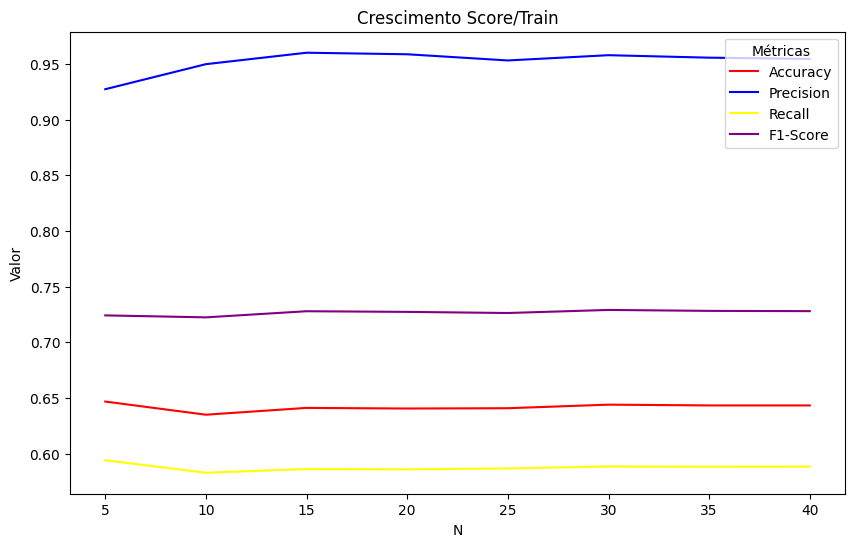

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [5,10,15,20,25,30,35,40]
data_l['accuracy'] = accuracy_RFC
data_l['precision'] = precision_RFC
data_l['recall'] = recall_RFC
data_l['F1-score'] = f1_RFC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_depth = 40')

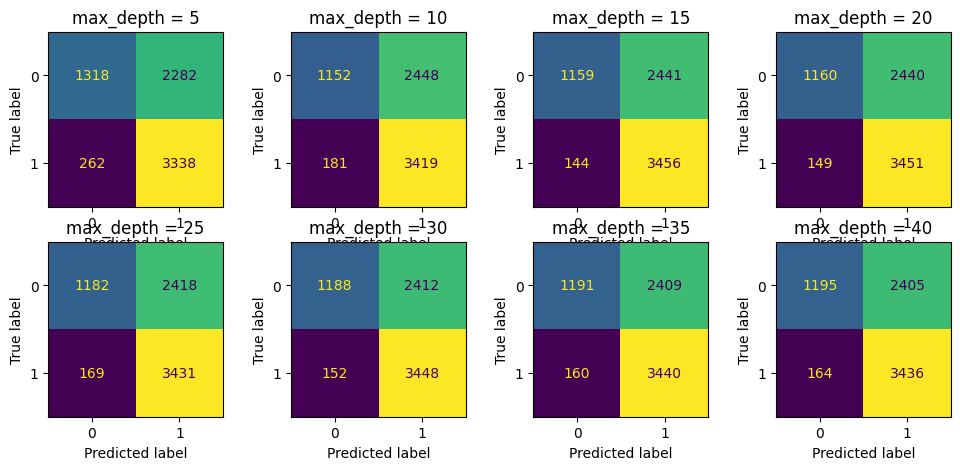

In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

cm_1 = confusion_matrix(y_test, RFC_pred[0])
cm_2 = confusion_matrix(y_test, RFC_pred[1])
cm_3 = confusion_matrix(y_test, RFC_pred[2])
cm_4 = confusion_matrix(y_test, RFC_pred[3])
cm_5 = confusion_matrix(y_test, RFC_pred[4])
cm_6 = confusion_matrix(y_test, RFC_pred[5])
cm_7 = confusion_matrix(y_test, RFC_pred[6])
cm_8 = confusion_matrix(y_test, RFC_pred[7])

fig, axes = plt.subplots(2, 4, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_depth = 5')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_depth = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_depth = 15')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_depth = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_depth = 25')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_depth = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_depth = 35')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_depth = 40')

#### DTC

In [ ]:
accuracy_DTC = []
precision_DTC = []
recall_DTC = []
f1_DTC = []
DTC_pred = []
i = 5
while i<41:
  mod_dt = DecisionTreeClassifier(max_depth = i, random_state = 1)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  DTC_pred.append(prediction)
  accuracy_DTC.append(metrics.accuracy_score(prediction,y_test))
  precision_DTC.append(metrics.precision_score(prediction,y_test))
  recall_DTC.append(metrics.recall_score(prediction,y_test))
  f1_DTC.append(metrics.f1_score(prediction,y_test))
  i+= 5

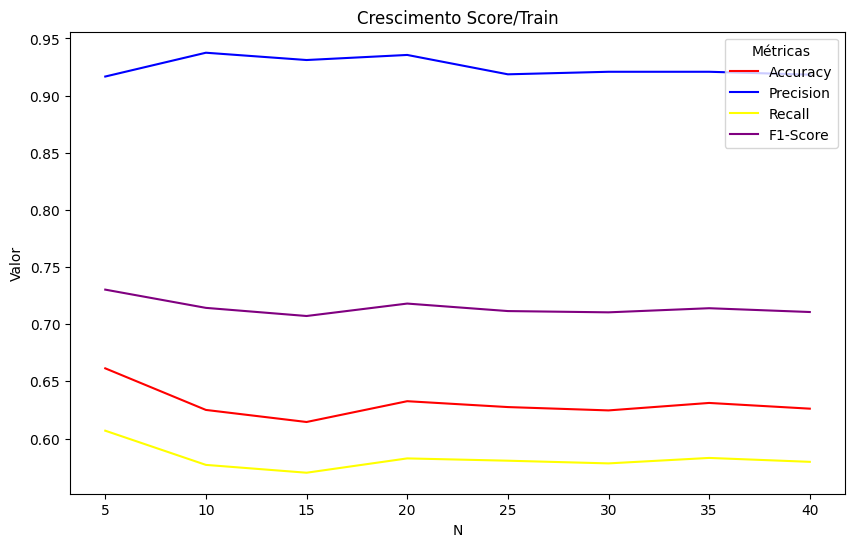

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [5,10,15,20,25,30,35,40]
data_l['accuracy'] = accuracy_DTC
data_l['precision'] = precision_DTC
data_l['recall'] = recall_DTC
data_l['F1-score'] = f1_DTC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_depth = 40')

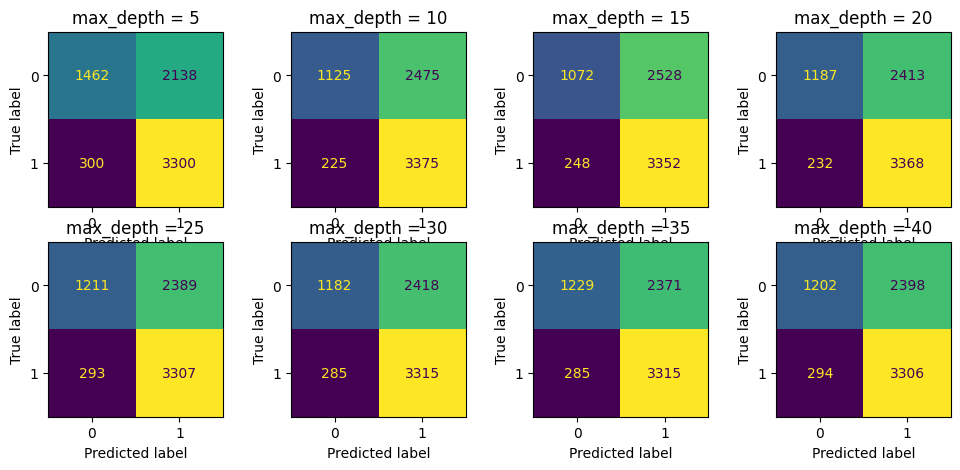

In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

cm_1 = confusion_matrix(y_test, DTC_pred[0])
cm_2 = confusion_matrix(y_test, DTC_pred[1])
cm_3 = confusion_matrix(y_test, DTC_pred[2])
cm_4 = confusion_matrix(y_test, DTC_pred[3])
cm_5 = confusion_matrix(y_test, DTC_pred[4])
cm_6 = confusion_matrix(y_test, DTC_pred[5])
cm_7 = confusion_matrix(y_test, DTC_pred[6])
cm_8 = confusion_matrix(y_test, DTC_pred[7])

fig, axes = plt.subplots(2, 4, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_depth = 5')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_depth = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_depth = 15')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_depth = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_depth = 25')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_depth = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_depth = 35')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_depth = 40')

#### Logistic Regression


In [ ]:
accuracy_LR = []
precision_LR = []
recall_LR = []
f1_LR = []
LR_pred = []
i = 10
while i<151:
  mod_dt = LogisticRegression(max_iter = i, random_state = 1)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  LR_pred.append(prediction)
  accuracy_LR.append(metrics.accuracy_score(prediction,y_test))
  precision_LR.append(metrics.precision_score(prediction,y_test))
  recall_LR.append(metrics.recall_score(prediction,y_test))
  f1_LR.append(metrics.f1_score(prediction,y_test))
  i+= 10

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _c

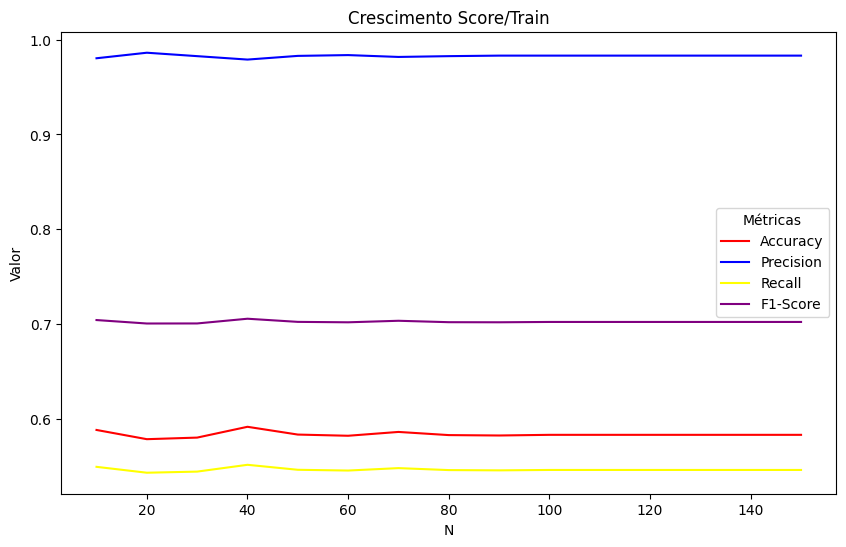

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [10,20,30,40,50,60,70,80,90,100,110,120,130,140,150]
data_l['accuracy'] = accuracy_LR
data_l['precision'] = precision_LR
data_l['recall'] = recall_LR
data_l['F1-score'] = f1_LR
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_iter = 150')

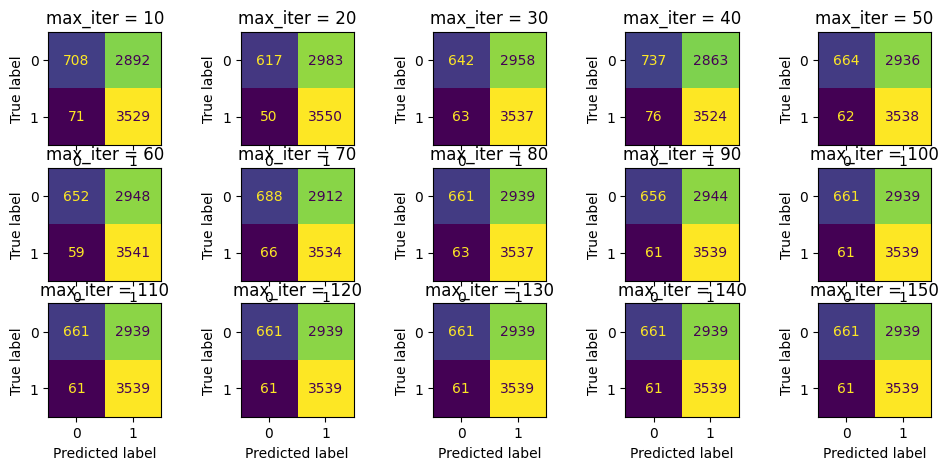

In [ ]:
cm_1 = confusion_matrix(y_test, LR_pred[0])
cm_2 = confusion_matrix(y_test, LR_pred[1])
cm_3 = confusion_matrix(y_test, LR_pred[2])
cm_4 = confusion_matrix(y_test, LR_pred[3])
cm_5 = confusion_matrix(y_test, LR_pred[4])
cm_6 = confusion_matrix(y_test, LR_pred[5])
cm_7 = confusion_matrix(y_test, LR_pred[6])
cm_8 = confusion_matrix(y_test, LR_pred[7])
cm_9 = confusion_matrix(y_test, LR_pred[8])
cm_10 = confusion_matrix(y_test, LR_pred[9])
cm_11 = confusion_matrix(y_test, LR_pred[10])
cm_12 = confusion_matrix(y_test, LR_pred[11])
cm_13 = confusion_matrix(y_test, LR_pred[12])
cm_14 = confusion_matrix(y_test, LR_pred[13])
cm_15 = confusion_matrix(y_test, LR_pred[14])

fig, axes = plt.subplots(3, 5, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_iter = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_iter = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_iter = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_iter = 40')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[0,4], colorbar=False)
axes[0,4].set_title('max_iter = 50')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_iter = 60')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_iter = 70')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_iter = 80')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_9)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_iter = 90')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_10)
disp_rfc.plot(ax=axes[1,4], colorbar=False)
axes[1,4].set_title('max_iter = 100')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_11)
disp_rfc.plot(ax=axes[2,0], colorbar=False)
axes[2,0].set_title('max_iter = 110')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_12)
disp_rfc.plot(ax=axes[2,1], colorbar=False)
axes[2,1].set_title('max_iter = 120')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_13)
disp_rfc.plot(ax=axes[2,2], colorbar=False)
axes[2,2].set_title('max_iter = 130')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_14)
disp_rfc.plot(ax=axes[2,3], colorbar=False)
axes[2,3].set_title('max_iter = 140')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_15)
disp_rfc.plot(ax=axes[2,4], colorbar=False)
axes[2,4].set_title('max_iter = 150')

#### Linear Support Vector Classifier


In [ ]:
accuracy_LSVC = []
precision_LSVC = []
recall_LSVC = []
f1_LSVC = []
LSVC_pred = []
i = 10
while i<151:
  mod_dt = LinearSVC(max_iter = i, random_state = 42)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  LSVC_pred.append(prediction)
  accuracy_LSVC.append(metrics.accuracy_score(prediction,y_test))
  precision_LSVC.append(metrics.precision_score(prediction,y_test))
  recall_LSVC.append(metrics.recall_score(prediction,y_test))
  f1_LSVC.append(metrics.f1_score(prediction,y_test))
  i+= 10

/usr/local/lib/python3.11/dist-packages/sklearn/svm/_base.py:1249: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


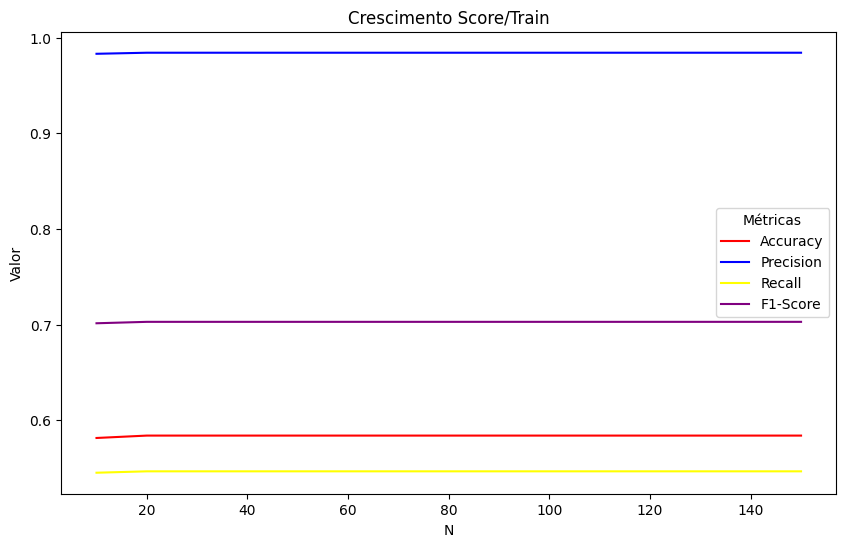

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [10,20,30,40,50,60,70,80,90,100,110,120,130,140,150]
data_l['accuracy'] = accuracy_LSVC
data_l['precision'] = precision_LSVC
data_l['recall'] = recall_LSVC
data_l['F1-score'] = f1_LSVC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_iter = 150')

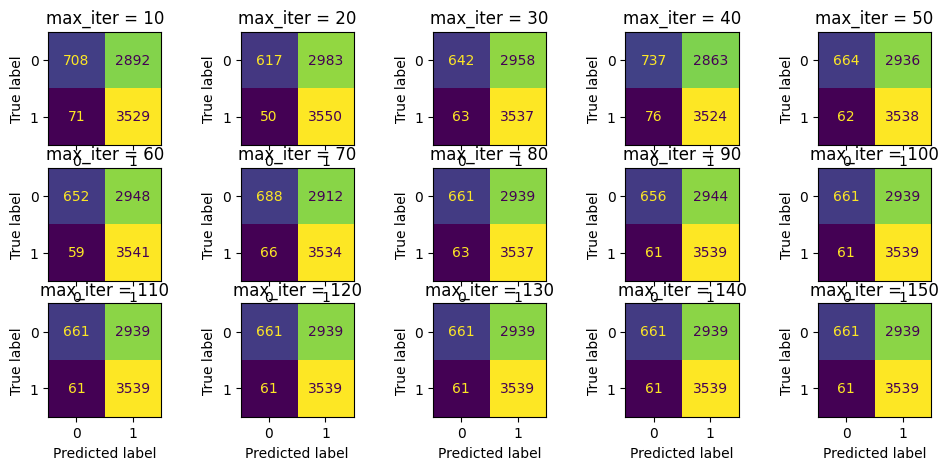

In [ ]:
cm_1 = confusion_matrix(y_test, LR_pred[0])
cm_2 = confusion_matrix(y_test, LR_pred[1])
cm_3 = confusion_matrix(y_test, LR_pred[2])
cm_4 = confusion_matrix(y_test, LR_pred[3])
cm_5 = confusion_matrix(y_test, LR_pred[4])
cm_6 = confusion_matrix(y_test, LR_pred[5])
cm_7 = confusion_matrix(y_test, LR_pred[6])
cm_8 = confusion_matrix(y_test, LR_pred[7])
cm_9 = confusion_matrix(y_test, LR_pred[8])
cm_10 = confusion_matrix(y_test, LR_pred[9])
cm_11 = confusion_matrix(y_test, LR_pred[10])
cm_12 = confusion_matrix(y_test, LR_pred[11])
cm_13 = confusion_matrix(y_test, LR_pred[12])
cm_14 = confusion_matrix(y_test, LR_pred[13])
cm_15 = confusion_matrix(y_test, LR_pred[14])

fig, axes = plt.subplots(3, 5, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_iter = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_iter = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_iter = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_iter = 40')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[0,4], colorbar=False)
axes[0,4].set_title('max_iter = 50')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_iter = 60')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_iter = 70')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_iter = 80')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_9)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_iter = 90')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_10)
disp_rfc.plot(ax=axes[1,4], colorbar=False)
axes[1,4].set_title('max_iter = 100')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_11)
disp_rfc.plot(ax=axes[2,0], colorbar=False)
axes[2,0].set_title('max_iter = 110')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_12)
disp_rfc.plot(ax=axes[2,1], colorbar=False)
axes[2,1].set_title('max_iter = 120')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_13)
disp_rfc.plot(ax=axes[2,2], colorbar=False)
axes[2,2].set_title('max_iter = 130')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_14)
disp_rfc.plot(ax=axes[2,3], colorbar=False)
axes[2,3].set_title('max_iter = 140')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_15)
disp_rfc.plot(ax=axes[2,4], colorbar=False)
axes[2,4].set_title('max_iter = 150')

#### Passive Aggressive Classifier


In [ ]:
accuracy_PAC = []
precision_PAC = []
recall_PAC = []
f1_PAC = []
PAC_pred = []
i = 5
while i<41:
  mod_dt = PassiveAggressiveClassifier(max_iter=i, random_state=42)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  PAC_pred.append(prediction)
  accuracy_PAC.append(metrics.accuracy_score(prediction,y_test))
  precision_PAC.append(metrics.precision_score(prediction,y_test))
  recall_PAC.append(metrics.recall_score(prediction,y_test))
  f1_PAC.append(metrics.f1_score(prediction,y_test))
  i+= 5

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:738: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:738: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:738: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(


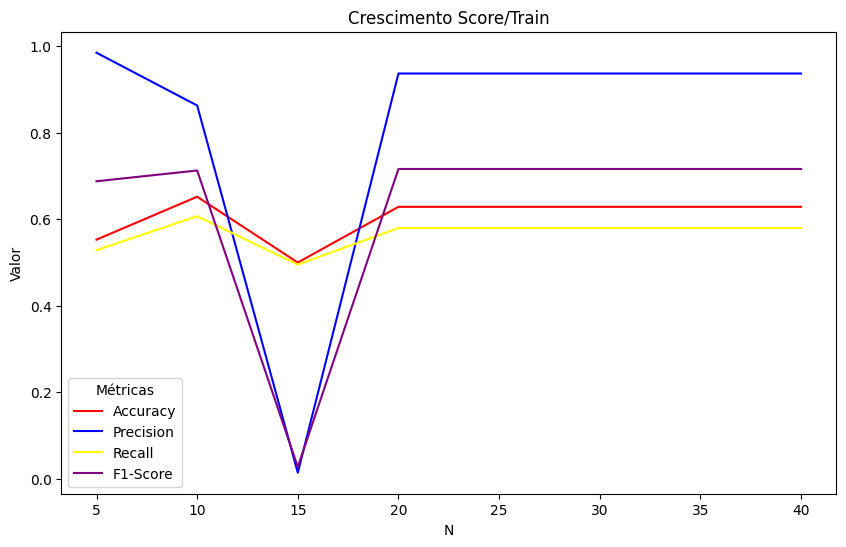

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [5,10,15,20,25,30,35,40]
data_l['accuracy'] = accuracy_PAC
data_l['precision'] = precision_PAC
data_l['recall'] = recall_PAC
data_l['F1-score'] = f1_PAC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_depth = 40')

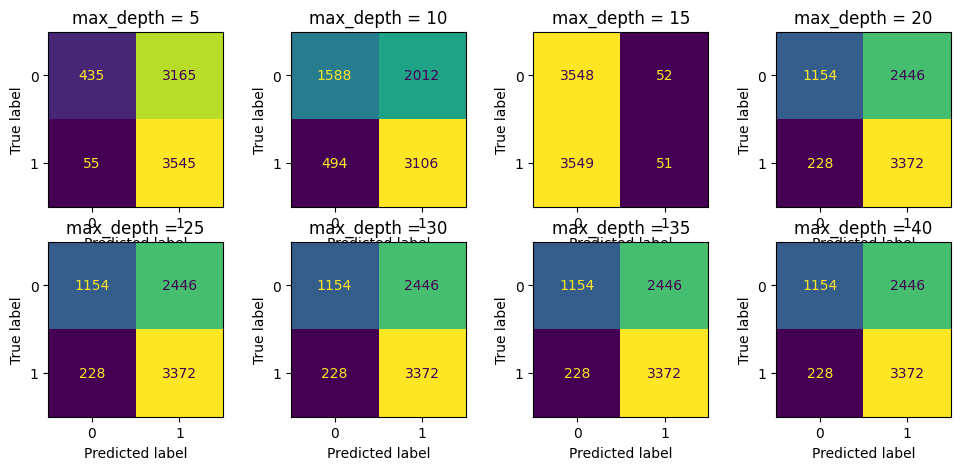

In [ ]:
cm_1 = confusion_matrix(y_test, PAC_pred[0])
cm_2 = confusion_matrix(y_test, PAC_pred[1])
cm_3 = confusion_matrix(y_test, PAC_pred[2])
cm_4 = confusion_matrix(y_test, PAC_pred[3])
cm_5 = confusion_matrix(y_test, PAC_pred[4])
cm_6 = confusion_matrix(y_test, PAC_pred[5])
cm_7 = confusion_matrix(y_test, PAC_pred[6])
cm_8 = confusion_matrix(y_test, PAC_pred[7])

fig, axes = plt.subplots(2, 4, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_depth = 5')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_depth = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_depth = 15')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_depth = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_depth = 25')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_depth = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_depth = 35')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_depth = 40')

###BERT

In [ ]:
# 1. Carregar BERT
tokenizer = BertTokenizer.from_pretrained('neuralmind/bert-base-portuguese-cased')
model = BertModel.from_pretrained('neuralmind/bert-base-portuguese-cased')
model.eval()

# 2. Função para extrair vetor da [CLS]
def get_bert_vector(texto):
    inputs = tokenizer(texto, return_tensors="pt", truncation=True, padding='max_length', max_length=128)
    with torch.no_grad():
        outputs = model(**inputs)
    return outputs.last_hidden_state[:, 0, :].squeeze().numpy()

# 3. Aplicar aos dados
textos_train = df_fakerecogna['texto_processado'].astype(str)
textos_test = df_fakebr['texto_processado'].astype(str)

x_train = np.array([get_bert_vector(t) for t in textos_train])
y_train = df_fakerecogna['classificação'].apply(lambda x: 1 if 'true' in x else 0)

x_test = np.array([get_bert_vector(t) for t in textos_test])
y_test = df_fakebr['classificação'].apply(lambda x: 1 if 'true' in x else 0)

#### RFC

In [ ]:
accuracy_RFC = []
precision_RFC = []
recall_RFC = []
f1_RFC = []
score = []
RFC_pred = []
i = 5
while i<41:
  forest=RandomForestClassifier(max_depth = i,random_state=45)
  forest.fit(x_train,y_train)
  prediction=forest.predict(x_test)
  RFC_pred.append(prediction)
  accuracy_RFC.append(metrics.accuracy_score(prediction,y_test))
  precision_RFC.append(metrics.precision_score(prediction,y_test))
  recall_RFC.append(metrics.recall_score(prediction,y_test))
  f1_RFC.append(metrics.f1_score(prediction,y_test))
  i+= 5

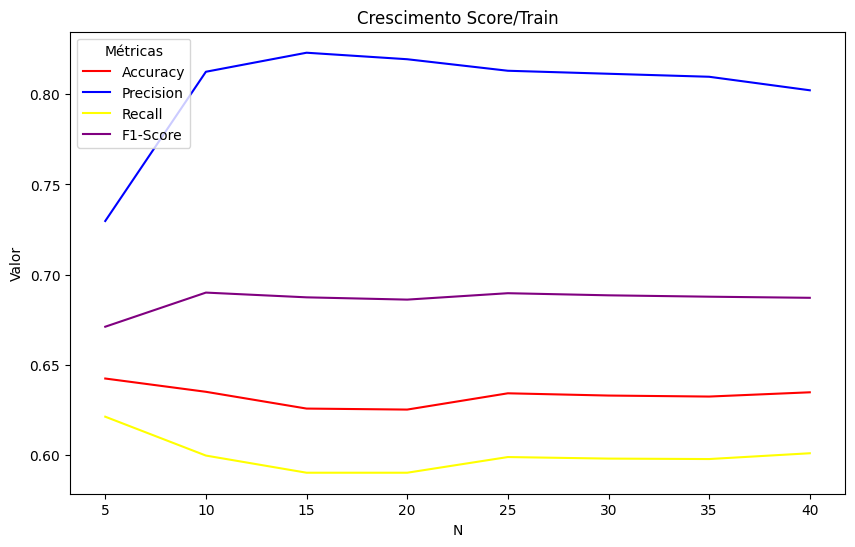

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [5,10,15,20,25,30,35,40]
data_l['accuracy'] = accuracy_RFC
data_l['precision'] = precision_RFC
data_l['recall'] = recall_RFC
data_l['F1-score'] = f1_RFC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_depth = 40')

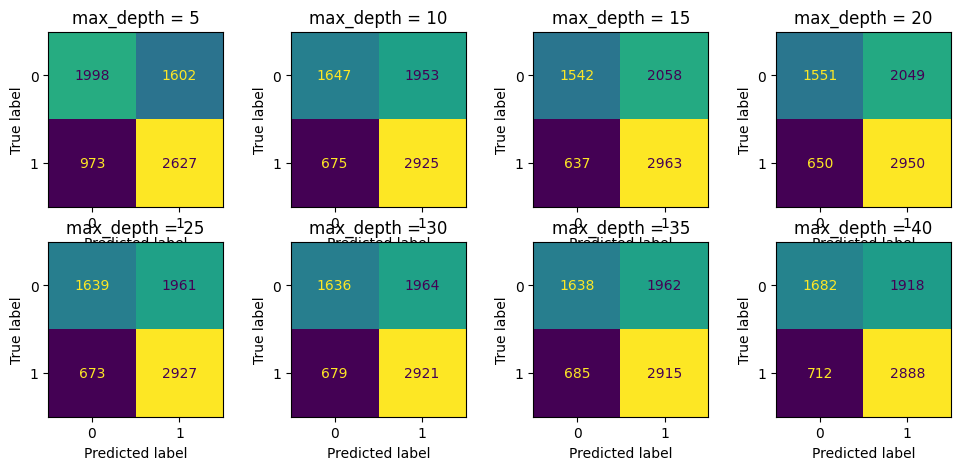

In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

cm_1 = confusion_matrix(y_test, RFC_pred[0])
cm_2 = confusion_matrix(y_test, RFC_pred[1])
cm_3 = confusion_matrix(y_test, RFC_pred[2])
cm_4 = confusion_matrix(y_test, RFC_pred[3])
cm_5 = confusion_matrix(y_test, RFC_pred[4])
cm_6 = confusion_matrix(y_test, RFC_pred[5])
cm_7 = confusion_matrix(y_test, RFC_pred[6])
cm_8 = confusion_matrix(y_test, RFC_pred[7])

fig, axes = plt.subplots(2, 4, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_depth = 5')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_depth = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_depth = 15')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_depth = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_depth = 25')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_depth = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_depth = 35')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_depth = 40')

#### DTC

In [ ]:
accuracy_DTC = []
precision_DTC = []
recall_DTC = []
f1_DTC = []
DTC_pred = []
i = 5
while i<41:
  mod_dt = DecisionTreeClassifier(max_depth = i, random_state = 1)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  DTC_pred.append(prediction)
  accuracy_DTC.append(metrics.accuracy_score(prediction,y_test))
  precision_DTC.append(metrics.precision_score(prediction,y_test))
  recall_DTC.append(metrics.recall_score(prediction,y_test))
  f1_DTC.append(metrics.f1_score(prediction,y_test))
  i+= 5

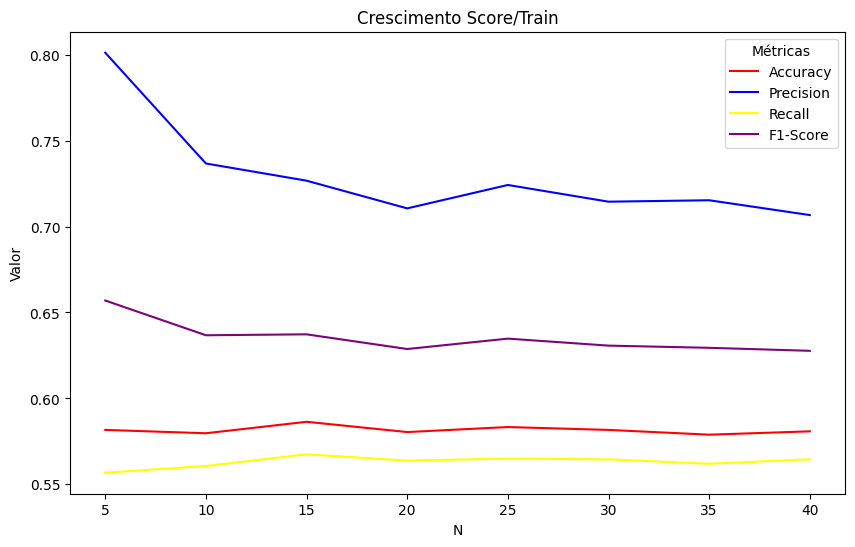

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [5,10,15,20,25,30,35,40]
data_l['accuracy'] = accuracy_DTC
data_l['precision'] = precision_DTC
data_l['recall'] = recall_DTC
data_l['F1-score'] = f1_DTC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_depth = 40')

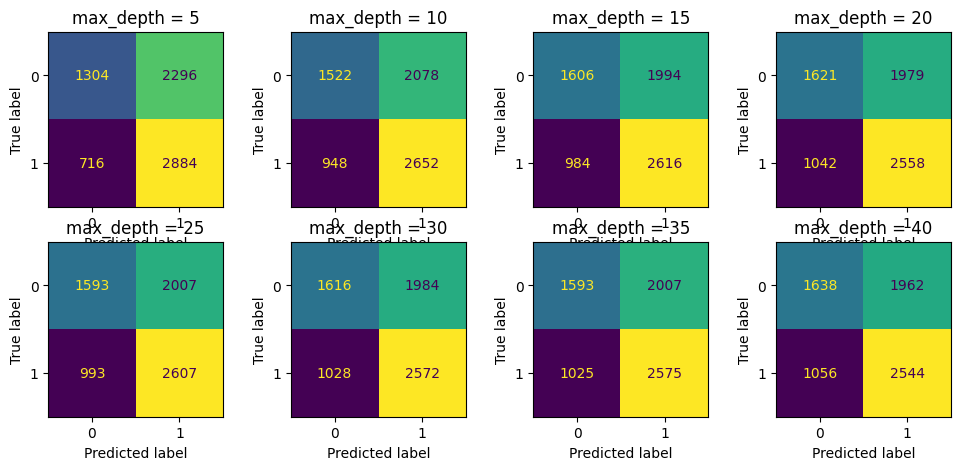

In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

cm_1 = confusion_matrix(y_test, DTC_pred[0])
cm_2 = confusion_matrix(y_test, DTC_pred[1])
cm_3 = confusion_matrix(y_test, DTC_pred[2])
cm_4 = confusion_matrix(y_test, DTC_pred[3])
cm_5 = confusion_matrix(y_test, DTC_pred[4])
cm_6 = confusion_matrix(y_test, DTC_pred[5])
cm_7 = confusion_matrix(y_test, DTC_pred[6])
cm_8 = confusion_matrix(y_test, DTC_pred[7])

fig, axes = plt.subplots(2, 4, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_depth = 5')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_depth = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_depth = 15')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_depth = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_depth = 25')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_depth = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_depth = 35')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_depth = 40')

#### Logistic Regression


In [ ]:
accuracy_LR = []
precision_LR = []
recall_LR = []
f1_LR = []
LR_pred = []
i = 10
while i<151:
  mod_dt = LogisticRegression(max_iter = i, random_state = 1)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  LR_pred.append(prediction)
  accuracy_LR.append(metrics.accuracy_score(prediction,y_test))
  precision_LR.append(metrics.precision_score(prediction,y_test))
  recall_LR.append(metrics.recall_score(prediction,y_test))
  f1_LR.append(metrics.f1_score(prediction,y_test))
  i+= 10

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _c

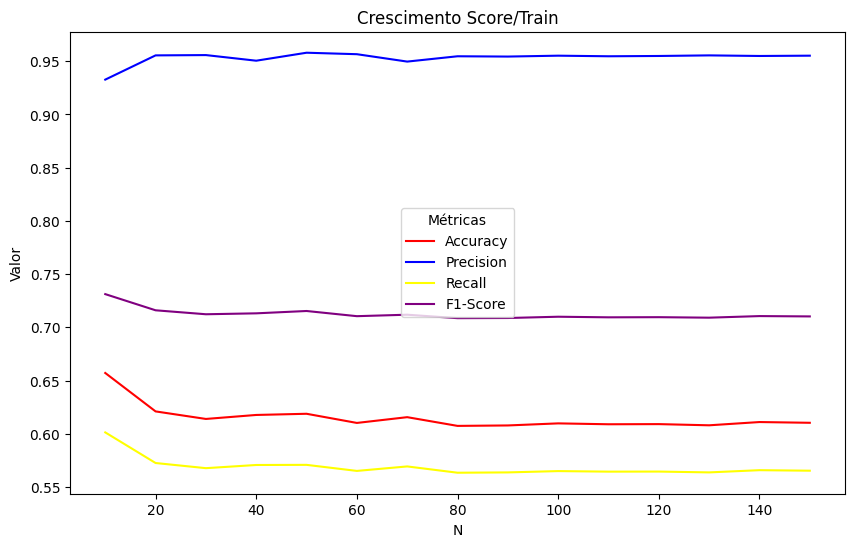

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [10,20,30,40,50,60,70,80,90,100,110,120,130,140,150]
data_l['accuracy'] = accuracy_LR
data_l['precision'] = precision_LR
data_l['recall'] = recall_LR
data_l['F1-score'] = f1_LR
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_iter = 150')

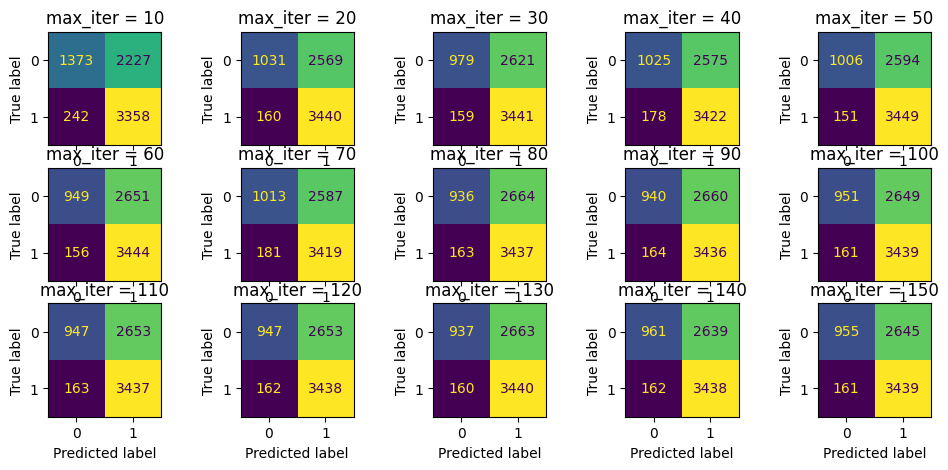

In [ ]:
cm_1 = confusion_matrix(y_test, LR_pred[0])
cm_2 = confusion_matrix(y_test, LR_pred[1])
cm_3 = confusion_matrix(y_test, LR_pred[2])
cm_4 = confusion_matrix(y_test, LR_pred[3])
cm_5 = confusion_matrix(y_test, LR_pred[4])
cm_6 = confusion_matrix(y_test, LR_pred[5])
cm_7 = confusion_matrix(y_test, LR_pred[6])
cm_8 = confusion_matrix(y_test, LR_pred[7])
cm_9 = confusion_matrix(y_test, LR_pred[8])
cm_10 = confusion_matrix(y_test, LR_pred[9])
cm_11 = confusion_matrix(y_test, LR_pred[10])
cm_12 = confusion_matrix(y_test, LR_pred[11])
cm_13 = confusion_matrix(y_test, LR_pred[12])
cm_14 = confusion_matrix(y_test, LR_pred[13])
cm_15 = confusion_matrix(y_test, LR_pred[14])

fig, axes = plt.subplots(3, 5, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_iter = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_iter = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_iter = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_iter = 40')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[0,4], colorbar=False)
axes[0,4].set_title('max_iter = 50')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_iter = 60')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_iter = 70')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_iter = 80')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_9)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_iter = 90')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_10)
disp_rfc.plot(ax=axes[1,4], colorbar=False)
axes[1,4].set_title('max_iter = 100')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_11)
disp_rfc.plot(ax=axes[2,0], colorbar=False)
axes[2,0].set_title('max_iter = 110')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_12)
disp_rfc.plot(ax=axes[2,1], colorbar=False)
axes[2,1].set_title('max_iter = 120')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_13)
disp_rfc.plot(ax=axes[2,2], colorbar=False)
axes[2,2].set_title('max_iter = 130')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_14)
disp_rfc.plot(ax=axes[2,3], colorbar=False)
axes[2,3].set_title('max_iter = 140')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_15)
disp_rfc.plot(ax=axes[2,4], colorbar=False)
axes[2,4].set_title('max_iter = 150')

#### Linear Support Vector Classifier


In [ ]:
accuracy_LSVC = []
precision_LSVC = []
recall_LSVC = []
f1_LSVC = []
LSVC_pred = []
i = 10
while i<151:
  mod_dt = LinearSVC(max_iter = i, random_state = 42)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  LSVC_pred.append(prediction)
  accuracy_LSVC.append(metrics.accuracy_score(prediction,y_test))
  precision_LSVC.append(metrics.precision_score(prediction,y_test))
  recall_LSVC.append(metrics.recall_score(prediction,y_test))
  f1_LSVC.append(metrics.f1_score(prediction,y_test))
  i+= 10

/usr/local/lib/python3.11/dist-packages/sklearn/svm/_base.py:1249: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


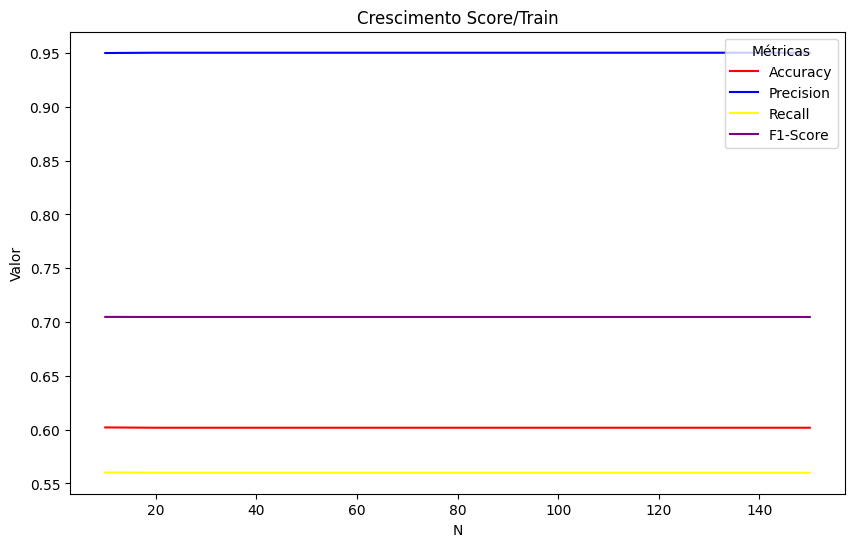

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [10,20,30,40,50,60,70,80,90,100,110,120,130,140,150]
data_l['accuracy'] = accuracy_LSVC
data_l['precision'] = precision_LSVC
data_l['recall'] = recall_LSVC
data_l['F1-score'] = f1_LSVC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_iter = 150')

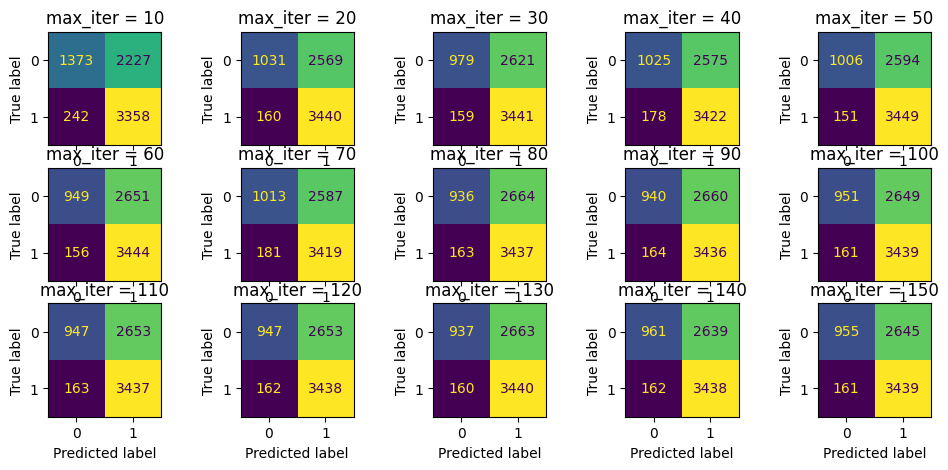

In [ ]:
cm_1 = confusion_matrix(y_test, LR_pred[0])
cm_2 = confusion_matrix(y_test, LR_pred[1])
cm_3 = confusion_matrix(y_test, LR_pred[2])
cm_4 = confusion_matrix(y_test, LR_pred[3])
cm_5 = confusion_matrix(y_test, LR_pred[4])
cm_6 = confusion_matrix(y_test, LR_pred[5])
cm_7 = confusion_matrix(y_test, LR_pred[6])
cm_8 = confusion_matrix(y_test, LR_pred[7])
cm_9 = confusion_matrix(y_test, LR_pred[8])
cm_10 = confusion_matrix(y_test, LR_pred[9])
cm_11 = confusion_matrix(y_test, LR_pred[10])
cm_12 = confusion_matrix(y_test, LR_pred[11])
cm_13 = confusion_matrix(y_test, LR_pred[12])
cm_14 = confusion_matrix(y_test, LR_pred[13])
cm_15 = confusion_matrix(y_test, LR_pred[14])

fig, axes = plt.subplots(3, 5, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_iter = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_iter = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_iter = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_iter = 40')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[0,4], colorbar=False)
axes[0,4].set_title('max_iter = 50')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_iter = 60')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_iter = 70')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_iter = 80')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_9)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_iter = 90')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_10)
disp_rfc.plot(ax=axes[1,4], colorbar=False)
axes[1,4].set_title('max_iter = 100')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_11)
disp_rfc.plot(ax=axes[2,0], colorbar=False)
axes[2,0].set_title('max_iter = 110')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_12)
disp_rfc.plot(ax=axes[2,1], colorbar=False)
axes[2,1].set_title('max_iter = 120')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_13)
disp_rfc.plot(ax=axes[2,2], colorbar=False)
axes[2,2].set_title('max_iter = 130')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_14)
disp_rfc.plot(ax=axes[2,3], colorbar=False)
axes[2,3].set_title('max_iter = 140')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_15)
disp_rfc.plot(ax=axes[2,4], colorbar=False)
axes[2,4].set_title('max_iter = 150')

#### Passive Aggressive Classifier


In [ ]:
accuracy_PAC = []
precision_PAC = []
recall_PAC = []
f1_PAC = []
PAC_pred = []
i = 5
while i<41:
  mod_dt = PassiveAggressiveClassifier(max_iter=i, random_state=42)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  PAC_pred.append(prediction)
  accuracy_PAC.append(metrics.accuracy_score(prediction,y_test))
  precision_PAC.append(metrics.precision_score(prediction,y_test))
  recall_PAC.append(metrics.recall_score(prediction,y_test))
  f1_PAC.append(metrics.f1_score(prediction,y_test))
  i+= 5

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:738: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:738: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:738: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:738: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(


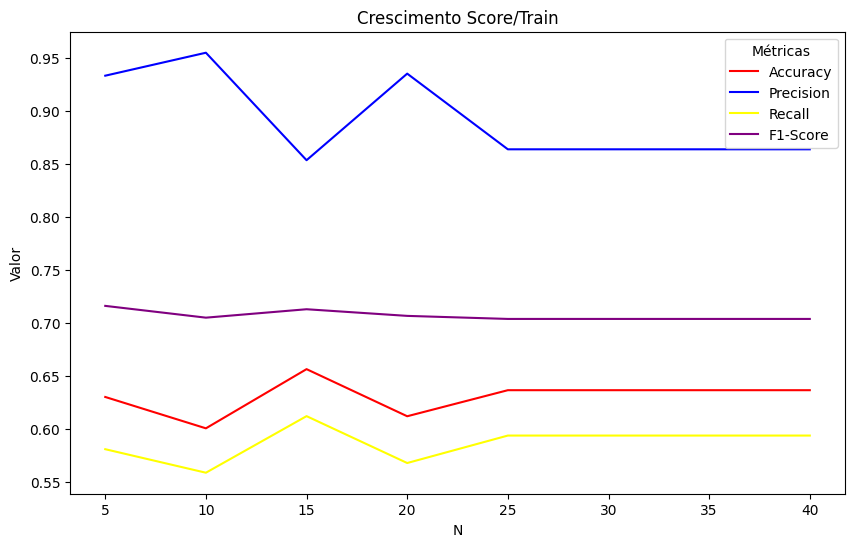

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [5,10,15,20,25,30,35,40]
data_l['accuracy'] = accuracy_PAC
data_l['precision'] = precision_PAC
data_l['recall'] = recall_PAC
data_l['F1-score'] = f1_PAC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_depth = 40')

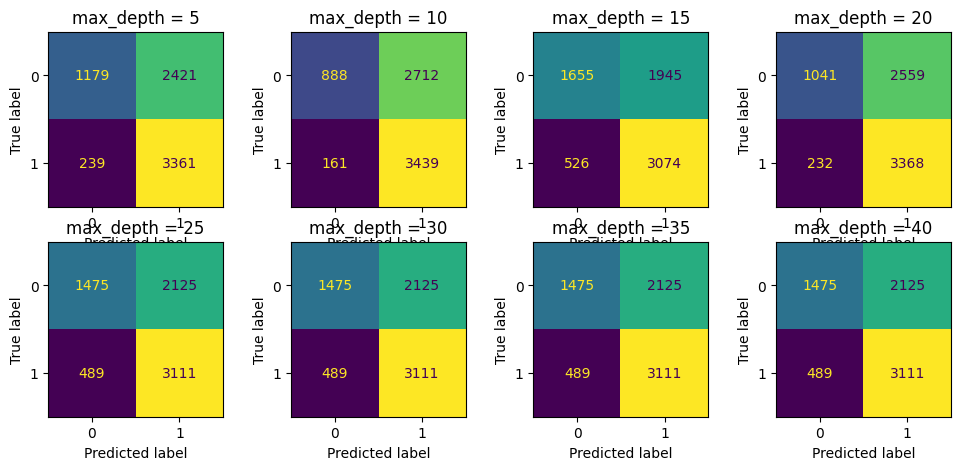

In [ ]:
cm_1 = confusion_matrix(y_test, PAC_pred[0])
cm_2 = confusion_matrix(y_test, PAC_pred[1])
cm_3 = confusion_matrix(y_test, PAC_pred[2])
cm_4 = confusion_matrix(y_test, PAC_pred[3])
cm_5 = confusion_matrix(y_test, PAC_pred[4])
cm_6 = confusion_matrix(y_test, PAC_pred[5])
cm_7 = confusion_matrix(y_test, PAC_pred[6])
cm_8 = confusion_matrix(y_test, PAC_pred[7])

fig, axes = plt.subplots(2, 4, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_depth = 5')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_depth = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_depth = 15')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_depth = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_depth = 25')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_depth = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_depth = 35')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_depth = 40')

## Verificação de palavras iguais nas bases

In [ ]:
def extrair_palavras_df(df, nome_coluna):
    palavras = set()
    for texto in df[nome_coluna].dropna():  # Ignora valores nulos
        for palavra in str(texto).lower().split():
            palavras.add(palavra.strip(",.!?;:()[]{}\"'"))
    return palavras

coluna = 'texto_processado'

palavras_df1 = extrair_palavras_df(df_fakebr, coluna)
palavras_df2 = extrair_palavras_df(df_fakerecogna, coluna)

# Comparações
comuns = palavras_df1 & palavras_df2
so_df1 = palavras_df1 - palavras_df2
so_df2 = palavras_df2 - palavras_df1

# Resultados
print("Palavras comuns:", comuns)
print("Só no df1:", so_df1)
print("Só no df2:", so_df2)

Palavras comuns: {'levante', 'produziram', 'dispor', 'bombar', 'famosa', 'arquivadas', 'laos', 'centrar', 'leverger', 'contrapeso', 'intubado', 'deteriorar', 'guaçu', 'alugar', 'criar', 'terceirizar', 'nágua', 'casé', 'decifrar', 'retomado', 'criança', 'residual', 'onu', 'roupa', 'adição', 'atacou', 'slide', 'creche', 'middleton', 'josefa', 'inviolabilidade', 'empurrão', 'validado', 'leigo', 'english', 'karina', 'reerguer', 'preços', 'gouvêa', 'visconde', 'afirmaram', 'exibir', 'deliberar', 'incorporação', 'préescolas', 'bilateral', 'disparate', 'engano', 'estilo', 'dobro', 'caviar', 'classificação', 'cer', 'lapinha', 'trabalhassem', 'bielorússia', 'imitação', 'reconfortante', 'aids', 'dupla', 'marshall', 'assange', 'curadoria', 'ter', 'prorrogar', 'regularizar', 'cervejaria', 'judicializado', 'cogitou', 'rangel', 'econômica', 'assessora', 'surgir', 'escorar', 'lúcifer', 'exclusão', 'imobilizar', 'chagar', 'lembremonos', 'reputação', 'aceitar', 'nascituro', 'estirpe', 'infusão', 'diret

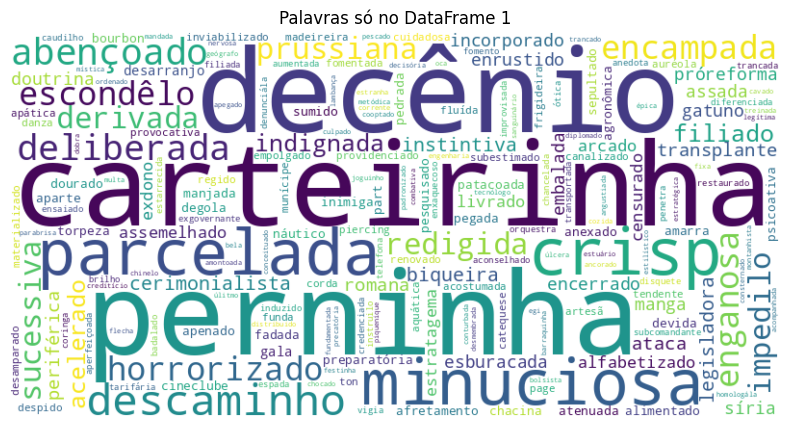

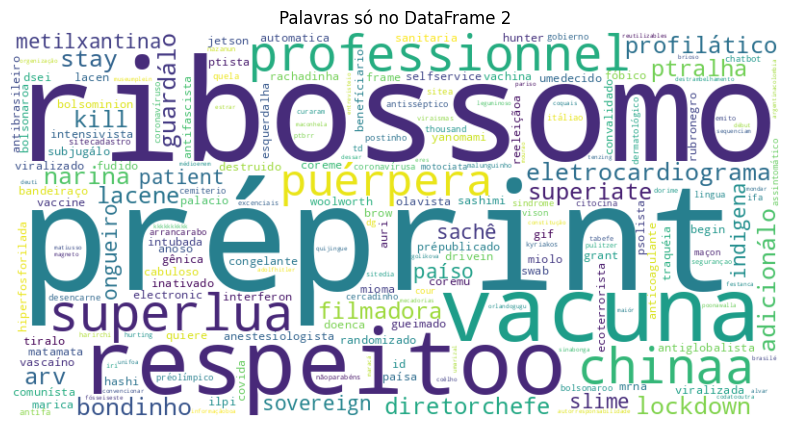

In [ ]:
def gerar_wordcloud(palavras_set, titulo):
    texto = " ".join(palavras_set)
    wc = WordCloud(width=800, height=400, background_color="white").generate(texto)
    plt.figure(figsize=(10, 5))
    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    plt.title(titulo)
    plt.show()

# Gerar WordClouds
gerar_wordcloud(so_df1, "Palavras só no DataFrame 1")
gerar_wordcloud(so_df2, "Palavras só no DataFrame 2")

In [ ]:
# Inicializar verificador ortográfico
spell = SpellChecker(language='pt')

# Verificar se palavras existem na língua portuguesa
def filtrar_palavras_validas(palavras_set):
    return spell.unknown(palavras_set)

# Filtrar palavras válidas de cada conjunto
invalidas_df1 = filtrar_palavras_validas(so_df1)
invalidas_df2 = filtrar_palavras_validas(so_df2)

# Exibir resultados
print("Palavras NÃO reconhecidas no DataFrame 1:", invalidas_df1)
print("Palavras NÃO reconhecidas no DataFrame 2:", invalidas_df2)
print("Total de palavras NÃO reconhecidas no DataFrame 1:", len(invalidas_df1))
print("Total de palavras NÃO reconhecidas no DataFrame 2:", len(invalidas_df2))

Palavras NÃO reconhecidas no DataFrame 1: {'carteirinha', 'perninha', 'gilber', 'cic', 'fenabrave', 'anosjornalismo', 'azarias', 'icm', 'olvidados', 'eas', 'ware', 'decênio', 'apresseime', 'alcançálo', 'burgman', 'benko', 'caffé', 'crisp', 'permitase', 'cohan', 'exitosos', 'spirito', 'finale', 'lazari', 'saboya', 'parcelada', 'arracando', 'loubet', 'massificado', 'pantanowitz', 'maluccelli', 'fiscalizaçãosolicitando', 'tivessemos', 'lindinha', 'tirinhas', 'vicediretorexecutivo', 'inárritu', 'encceja', 'cortarseão', 'supervisões', 'carrière', 'aramis', 'vangloriase', 'jonun', 'cetenco', 'marciane', 'alright', 'suicidarse', 'joaquin', 'vaquejadas', 'biônico', 'libidinosa', 'esleys', 'somandose', 'villacrez', 'sdpa', 'ravikant', 'pesoas', 'geralrelacionamento', 'isaurina', 'indepentende', 'natanael', 'coturno', 'pmdbpa', 'atômicos', 'telegrafistas', 'mikami', 'factcheck', 'devon', 'escondêlo', 'vaneau', 'thaise', 'charbeau', 'moranez', 'placefunding', 'hellinger', 'cleiciane', 'registre',

# Junção dos Datasets

In [ ]:
df_fakebr = pd.read_csv('/content/drive/MyDrive/Fake.Br/fakebr_dataset.csv')
df_fakerecogna = pd.read_csv('/content/drive/MyDrive/FakeRecogna/fakerecogna_dataset.csv')
df_fakebr = df_fakebr.drop(columns=['id'])
df_fakerecogna = df_fakerecogna.drop(columns=['id'])
juncao_df = pd.concat([df_fakebr, df_fakerecogna], ignore_index=True)
print(juncao_df.head())
juncao_df.to_csv('uniao_dataset.csv', index=False, encoding='utf-8')

                                    texto_processado classificação
0  ministro celso mello manda recado políticos ma...          fake
1  ei divulga vídeo ameaça frança eua vamos vinga...          fake
2  áudio estranho vaza youtube parte financeira n...          fake
3  francês le figaro faz matéria sobre dilma exgu...          fake
4  planalto pânico stf pode devolver ações envolv...          fake


In [ ]:
df_juncao = pd.read_csv('/content/drive/MyDrive/DatasetTCC/uniao_dataset.csv')
print(df_juncao.head())

                                    texto_processado classificação
0  ministro celso mello manda recado políticos ma...          fake
1  ei divulga vídeo ameaça frança eua vamos vinga...          fake
2  áudio estranho vaza youtube parte financeira n...          fake
3  francês le figaro faz matéria sobre dilma exgu...          fake
4  planalto pânico stf pode devolver ações envolv...          fake


In [ ]:
df_juncao['num_palavras'] = df_juncao['texto_processado'].astype(str).apply(lambda x: len(x.split()))
print(df_juncao['num_palavras'].describe())

count    19103.000000
mean       176.381668
std        269.467479
min          1.000000
25%         52.000000
50%         75.000000
75%        136.500000
max       4112.000000
Name: num_palavras, dtype: float64


In [ ]:
palavras = " ".join(df_juncao['texto_processado'].astype(str)).split()
frequencia = Counter(palavras)
print(frequencia.most_common(10))  # Top 10 palavras mais frequentes

[('presidente', 15011), ('lula', 12835), ('federal', 11514), ('brasil', 11030), ('disse', 10544), ('dia', 10194), ('sobre', 9610), ('país', 9383), ('anos', 9368), ('r', 9250)]


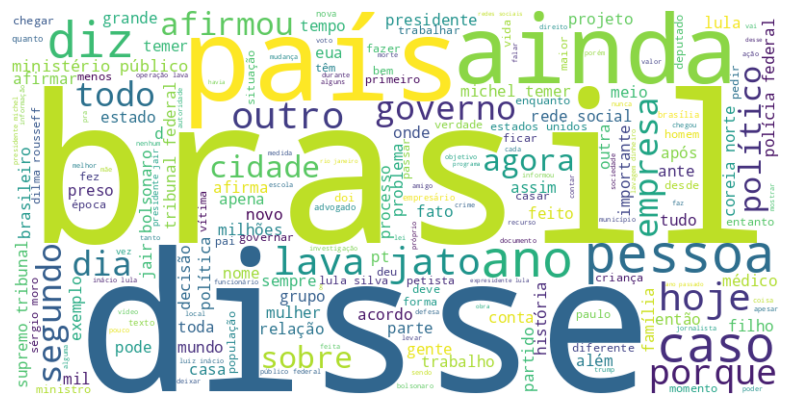

In [ ]:
texto = " ".join(df_juncao['texto_processado'].astype(str))
wordcloud = WordCloud(width=800, height=400, background_color="white").generate(texto)

plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()

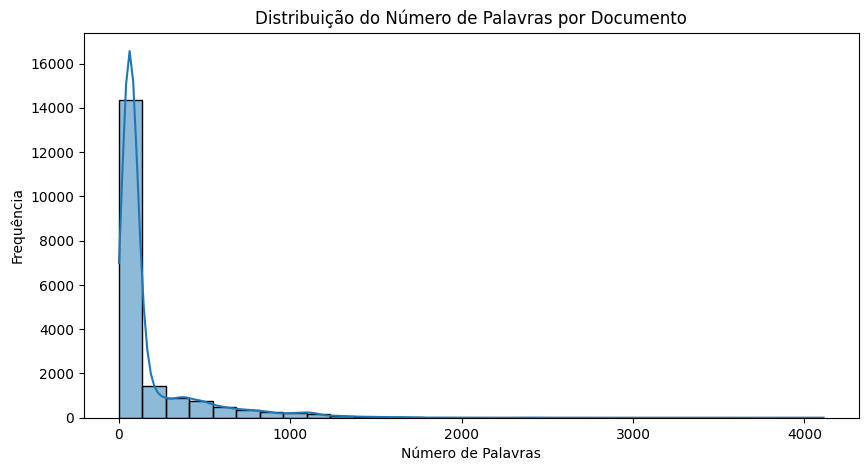

In [ ]:
plt.figure(figsize=(10,5))
sns.histplot(df_juncao['num_palavras'], bins=30, kde=True)
plt.xlabel("Número de Palavras")
plt.ylabel("Frequência")
plt.title("Distribuição do Número de Palavras por Documento")
plt.show()

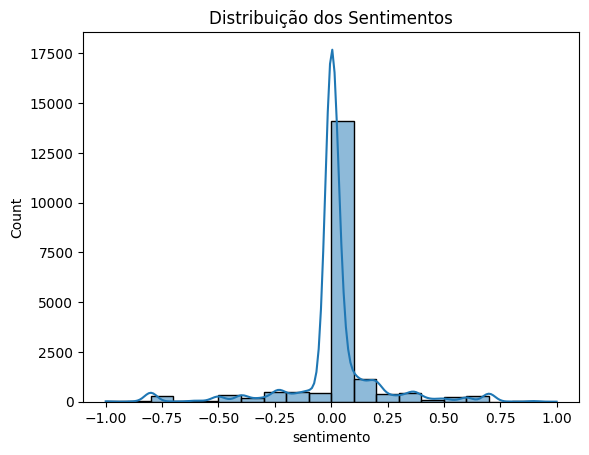

In [ ]:
from textblob import TextBlob

df_juncao['texto_processado'] = df_juncao['texto_processado'].astype(str)
df_juncao['sentimento'] = df_juncao['texto_processado'].apply(lambda x: TextBlob(x).sentiment.polarity)
sns.histplot(df_juncao['sentimento'], bins=20, kde=True)
plt.title("Distribuição dos Sentimentos")
plt.show()

##Criação do Modelo Preditivo

In [ ]:
df_juncao = pd.read_csv('/content/drive/MyDrive/DatasetTCC/uniao_dataset.csv')
print(df_juncao.head())

                                    texto_processado classificação
0  ministro celso mello manda recado políticos ma...          fake
1  ei divulga vídeo ameaça frança eua vamos vinga...          fake
2  áudio estranho vaza youtube parte financeira n...          fake
3  francês le figaro faz matéria sobre dilma exgu...          fake
4  planalto pânico stf pode devolver ações envolv...          fake


## TF-IDF


In [ ]:
vetorizador = TfidfVectorizer()

x = vetorizador.fit_transform(df_juncao['texto_processado'].astype(str))
y = df_juncao['classificação'].apply(lambda x: 1 if 'true' in x else 0)

In [ ]:
x_train,x_test,y_train,y_test=train_test_split(x,y,random_state=9856,test_size=0.5)

### Random Forest Classifier

In [ ]:
accuracy_RFC = []
precision_RFC = []
recall_RFC = []
f1_RFC = []
score = []
RFC_pred = []
i = 5
while i<41:
  forest=RandomForestClassifier(max_depth = i,random_state=45)
  forest.fit(x_train,y_train)
  prediction=forest.predict(x_test)
  RFC_pred.append(prediction)
  accuracy_RFC.append(metrics.accuracy_score(prediction,y_test))
  precision_RFC.append(metrics.precision_score(prediction,y_test))
  recall_RFC.append(metrics.recall_score(prediction,y_test))
  f1_RFC.append(metrics.f1_score(prediction,y_test))
  i+= 5

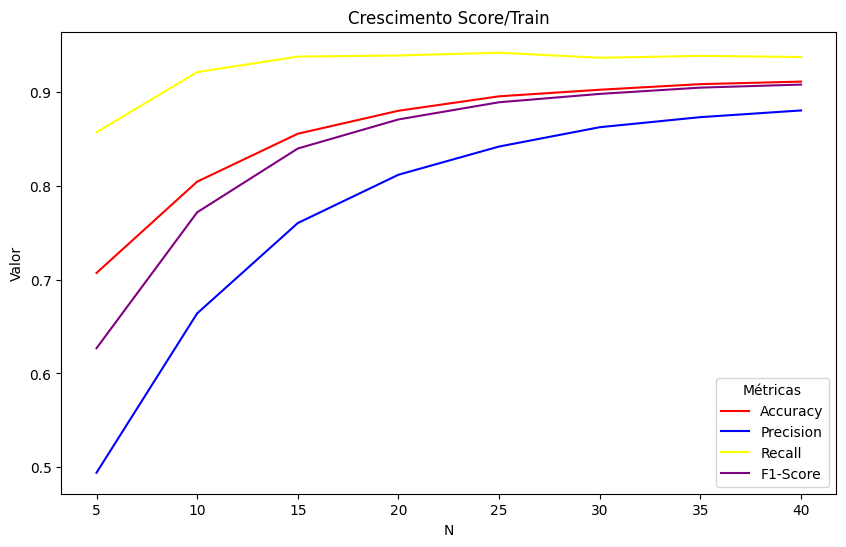

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [5,10,15,20,25,30,35,40]
data_l['accuracy'] = accuracy_RFC
data_l['precision'] = precision_RFC
data_l['recall'] = recall_RFC
data_l['F1-score'] = f1_RFC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_depth = 40')

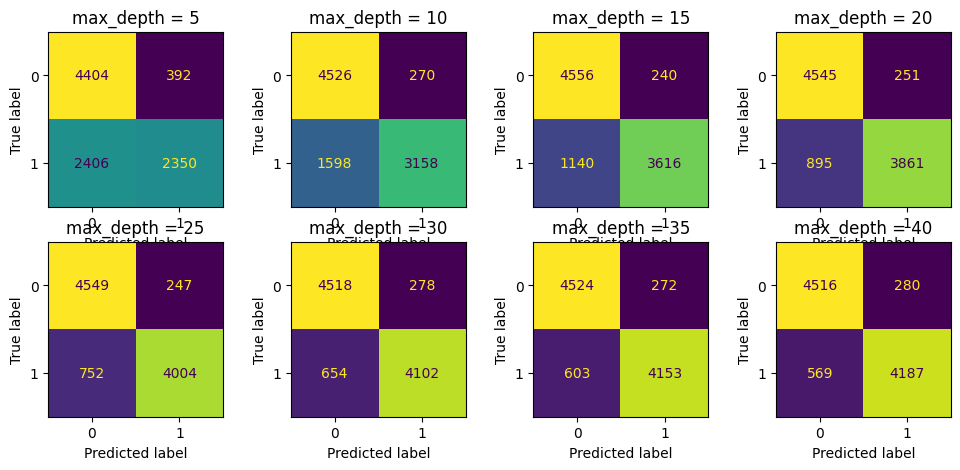

In [ ]:
cm_1 = confusion_matrix(y_test, RFC_pred[0])
cm_2 = confusion_matrix(y_test, RFC_pred[1])
cm_3 = confusion_matrix(y_test, RFC_pred[2])
cm_4 = confusion_matrix(y_test, RFC_pred[3])
cm_5 = confusion_matrix(y_test, RFC_pred[4])
cm_6 = confusion_matrix(y_test, RFC_pred[5])
cm_7 = confusion_matrix(y_test, RFC_pred[6])
cm_8 = confusion_matrix(y_test, RFC_pred[7])

fig, axes = plt.subplots(2, 4, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_depth = 5')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_depth = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_depth = 15')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_depth = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_depth = 25')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_depth = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_depth = 35')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_depth = 40')

### Decision Tree Classifier

In [ ]:
accuracy_DTC = []
precision_DTC = []
recall_DTC = []
f1_DTC = []
DTC_pred = []
i = 5
while i<41:
  mod_dt = DecisionTreeClassifier(max_depth = i, random_state = 1)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  DTC_pred.append(prediction)
  accuracy_DTC.append(metrics.accuracy_score(prediction,y_test))
  precision_DTC.append(metrics.precision_score(prediction,y_test))
  recall_DTC.append(metrics.recall_score(prediction,y_test))
  f1_DTC.append(metrics.f1_score(prediction,y_test))
  i+= 5

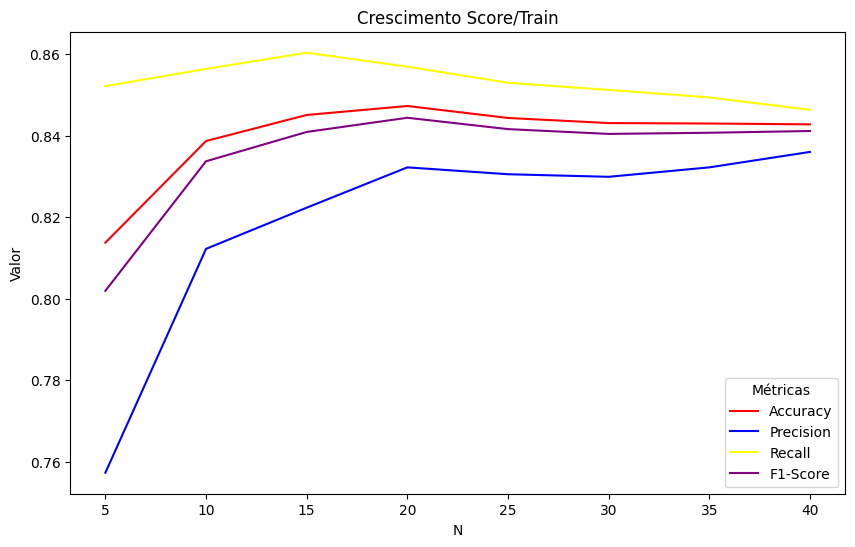

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [5,10,15,20,25,30,35,40]
data_l['accuracy'] = accuracy_DTC
data_l['precision'] = precision_DTC
data_l['recall'] = recall_DTC
data_l['F1-score'] = f1_DTC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_depth = 40')

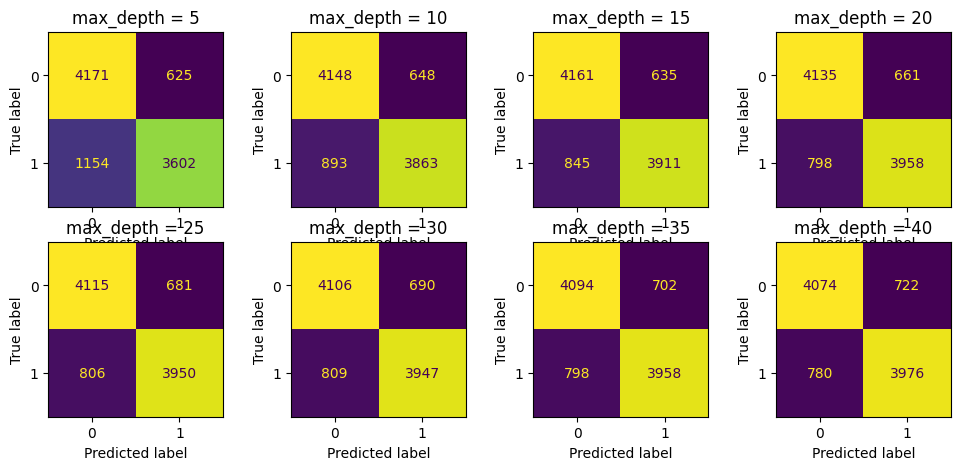

In [ ]:
cm_1 = confusion_matrix(y_test, DTC_pred[0])
cm_2 = confusion_matrix(y_test, DTC_pred[1])
cm_3 = confusion_matrix(y_test, DTC_pred[2])
cm_4 = confusion_matrix(y_test, DTC_pred[3])
cm_5 = confusion_matrix(y_test, DTC_pred[4])
cm_6 = confusion_matrix(y_test, DTC_pred[5])
cm_7 = confusion_matrix(y_test, DTC_pred[6])
cm_8 = confusion_matrix(y_test, DTC_pred[7])

fig, axes = plt.subplots(2, 4, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_depth = 5')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_depth = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_depth = 15')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_depth = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_depth = 25')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_depth = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_depth = 35')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_depth = 40')

### Logistic Regression


In [ ]:
accuracy_LR = []
precision_LR = []
recall_LR = []
f1_LR = []
LR_pred = []
i = 10
while i<151:
  mod_dt = LogisticRegression(max_iter = i, random_state = 1)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  LR_pred.append(prediction)
  accuracy_LR.append(metrics.accuracy_score(prediction,y_test))
  precision_LR.append(metrics.precision_score(prediction,y_test))
  recall_LR.append(metrics.recall_score(prediction,y_test))
  f1_LR.append(metrics.f1_score(prediction,y_test))
  i+= 10

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. OF ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. OF ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _c

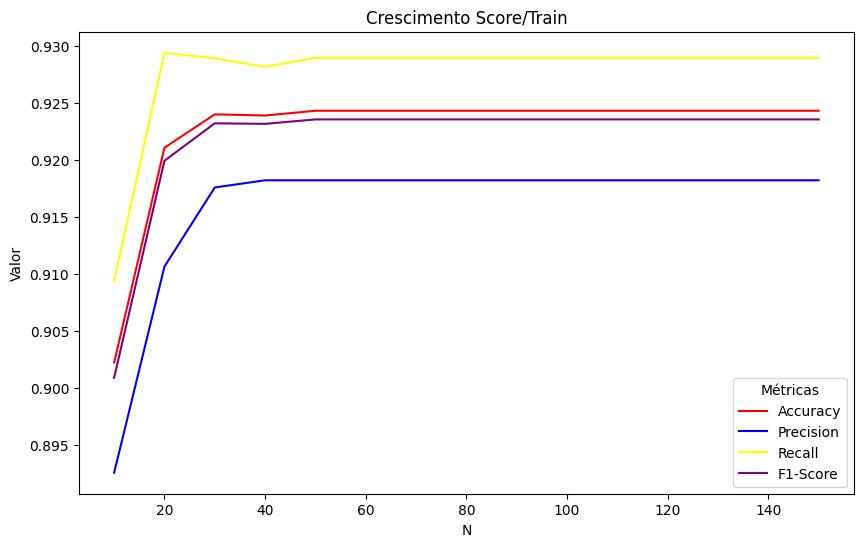

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [10,20,30,40,50,60,70,80,90,100,110,120,130,140,150]
data_l['accuracy'] = accuracy_LR
data_l['precision'] = precision_LR
data_l['recall'] = recall_LR
data_l['F1-score'] = f1_LR
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_iter = 150')

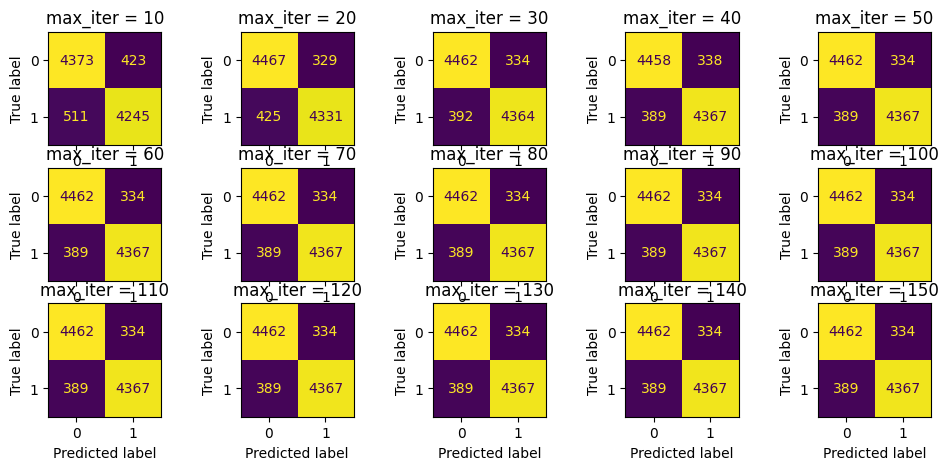

In [ ]:
cm_1 = confusion_matrix(y_test, LR_pred[0])
cm_2 = confusion_matrix(y_test, LR_pred[1])
cm_3 = confusion_matrix(y_test, LR_pred[2])
cm_4 = confusion_matrix(y_test, LR_pred[3])
cm_5 = confusion_matrix(y_test, LR_pred[4])
cm_6 = confusion_matrix(y_test, LR_pred[5])
cm_7 = confusion_matrix(y_test, LR_pred[6])
cm_8 = confusion_matrix(y_test, LR_pred[7])
cm_9 = confusion_matrix(y_test, LR_pred[8])
cm_10 = confusion_matrix(y_test, LR_pred[9])
cm_11 = confusion_matrix(y_test, LR_pred[10])
cm_12 = confusion_matrix(y_test, LR_pred[11])
cm_13 = confusion_matrix(y_test, LR_pred[12])
cm_14 = confusion_matrix(y_test, LR_pred[13])
cm_15 = confusion_matrix(y_test, LR_pred[14])

fig, axes = plt.subplots(3, 5, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_iter = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_iter = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_iter = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_iter = 40')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[0,4], colorbar=False)
axes[0,4].set_title('max_iter = 50')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_iter = 60')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_iter = 70')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_iter = 80')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_9)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_iter = 90')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_10)
disp_rfc.plot(ax=axes[1,4], colorbar=False)
axes[1,4].set_title('max_iter = 100')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_11)
disp_rfc.plot(ax=axes[2,0], colorbar=False)
axes[2,0].set_title('max_iter = 110')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_12)
disp_rfc.plot(ax=axes[2,1], colorbar=False)
axes[2,1].set_title('max_iter = 120')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_13)
disp_rfc.plot(ax=axes[2,2], colorbar=False)
axes[2,2].set_title('max_iter = 130')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_14)
disp_rfc.plot(ax=axes[2,3], colorbar=False)
axes[2,3].set_title('max_iter = 140')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_15)
disp_rfc.plot(ax=axes[2,4], colorbar=False)
axes[2,4].set_title('max_iter = 150')

### Linear Support Vector Classifier


In [ ]:
accuracy_LSVC = []
precision_LSVC = []
recall_LSVC = []
f1_LSVC = []
LSVC_pred = []
i = 10
while i<151:
  mod_dt = LinearSVC(max_iter = i, random_state = 42)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  LSVC_pred.append(prediction)
  accuracy_LSVC.append(metrics.accuracy_score(prediction,y_test))
  precision_LSVC.append(metrics.precision_score(prediction,y_test))
  recall_LSVC.append(metrics.recall_score(prediction,y_test))
  f1_LSVC.append(metrics.f1_score(prediction,y_test))
  i+= 10

/usr/local/lib/python3.11/dist-packages/sklearn/svm/_base.py:1249: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/svm/_base.py:1249: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/svm/_base.py:1249: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


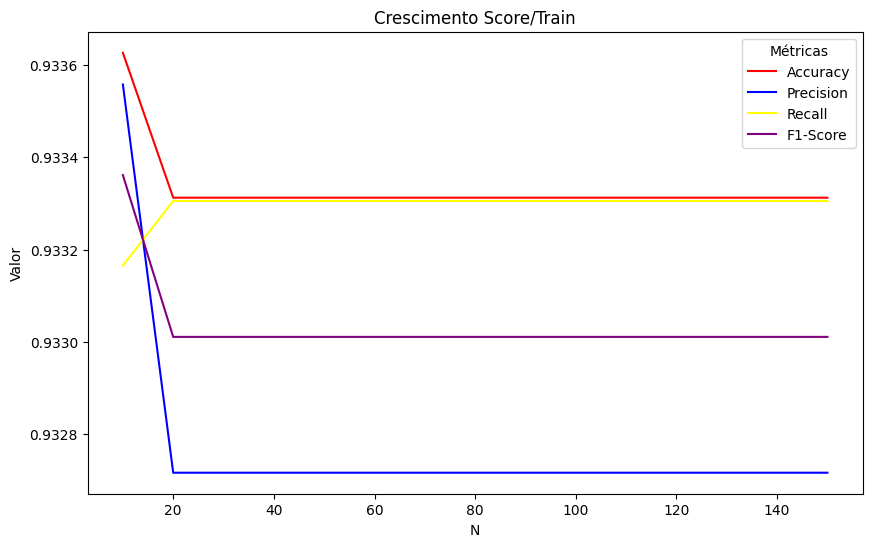

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [10,20,30,40,50,60,70,80,90,100,110,120,130,140,150]
data_l['accuracy'] = accuracy_LSVC
data_l['precision'] = precision_LSVC
data_l['recall'] = recall_LSVC
data_l['F1-score'] = f1_LSVC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_iter = 150')

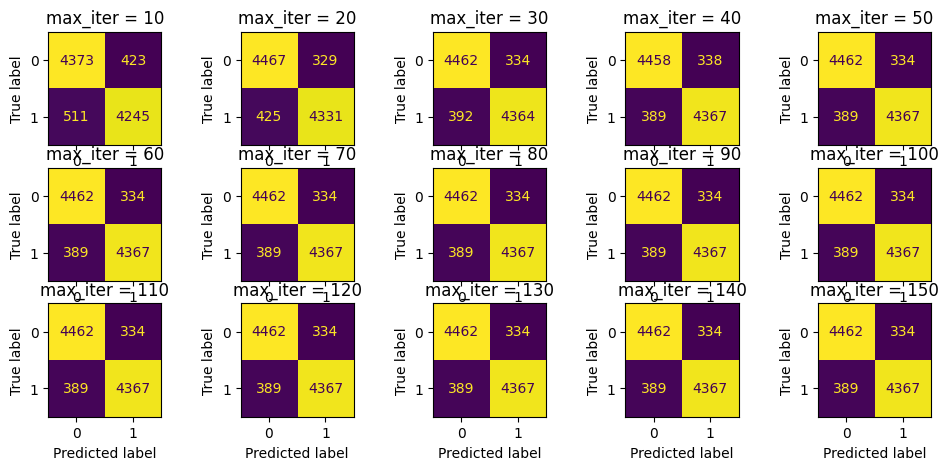

In [ ]:
cm_1 = confusion_matrix(y_test, LR_pred[0])
cm_2 = confusion_matrix(y_test, LR_pred[1])
cm_3 = confusion_matrix(y_test, LR_pred[2])
cm_4 = confusion_matrix(y_test, LR_pred[3])
cm_5 = confusion_matrix(y_test, LR_pred[4])
cm_6 = confusion_matrix(y_test, LR_pred[5])
cm_7 = confusion_matrix(y_test, LR_pred[6])
cm_8 = confusion_matrix(y_test, LR_pred[7])
cm_9 = confusion_matrix(y_test, LR_pred[8])
cm_10 = confusion_matrix(y_test, LR_pred[9])
cm_11 = confusion_matrix(y_test, LR_pred[10])
cm_12 = confusion_matrix(y_test, LR_pred[11])
cm_13 = confusion_matrix(y_test, LR_pred[12])
cm_14 = confusion_matrix(y_test, LR_pred[13])
cm_15 = confusion_matrix(y_test, LR_pred[14])

fig, axes = plt.subplots(3, 5, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_iter = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_iter = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_iter = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_iter = 40')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[0,4], colorbar=False)
axes[0,4].set_title('max_iter = 50')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_iter = 60')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_iter = 70')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_iter = 80')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_9)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_iter = 90')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_10)
disp_rfc.plot(ax=axes[1,4], colorbar=False)
axes[1,4].set_title('max_iter = 100')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_11)
disp_rfc.plot(ax=axes[2,0], colorbar=False)
axes[2,0].set_title('max_iter = 110')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_12)
disp_rfc.plot(ax=axes[2,1], colorbar=False)
axes[2,1].set_title('max_iter = 120')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_13)
disp_rfc.plot(ax=axes[2,2], colorbar=False)
axes[2,2].set_title('max_iter = 130')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_14)
disp_rfc.plot(ax=axes[2,3], colorbar=False)
axes[2,3].set_title('max_iter = 140')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_15)
disp_rfc.plot(ax=axes[2,4], colorbar=False)
axes[2,4].set_title('max_iter = 150')

### Passive Aggressive Classifier


In [ ]:
accuracy_PAC = []
precision_PAC = []
recall_PAC = []
f1_PAC = []
PAC_pred = []
i = 5
while i<41:
  mod_dt = PassiveAggressiveClassifier(max_iter=i, random_state=42)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  PAC_pred.append(prediction)
  accuracy_PAC.append(metrics.accuracy_score(prediction,y_test))
  precision_PAC.append(metrics.precision_score(prediction,y_test))
  recall_PAC.append(metrics.recall_score(prediction,y_test))
  f1_PAC.append(metrics.f1_score(prediction,y_test))
  i+= 5

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:738: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:738: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(


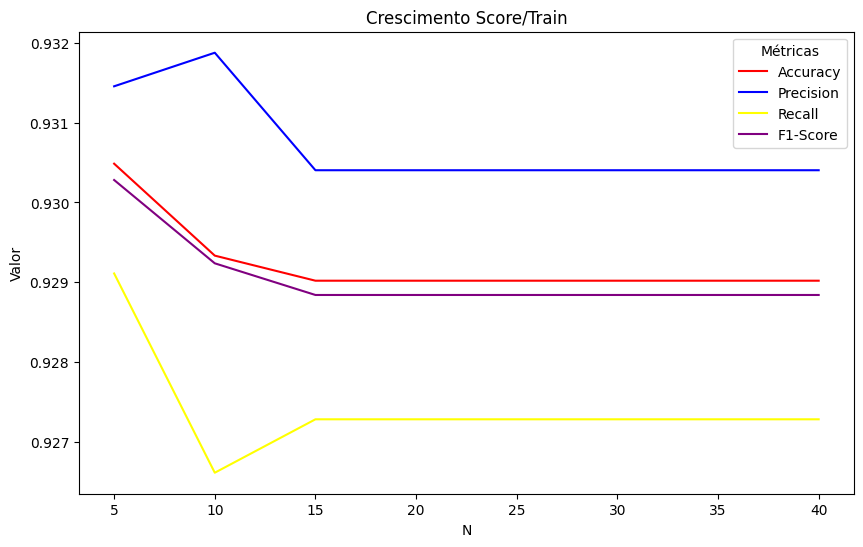

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [5,10,15,20,25,30,35,40]
data_l['accuracy'] = accuracy_PAC
data_l['precision'] = precision_PAC
data_l['recall'] = recall_PAC
data_l['F1-score'] = f1_PAC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_depth = 40')

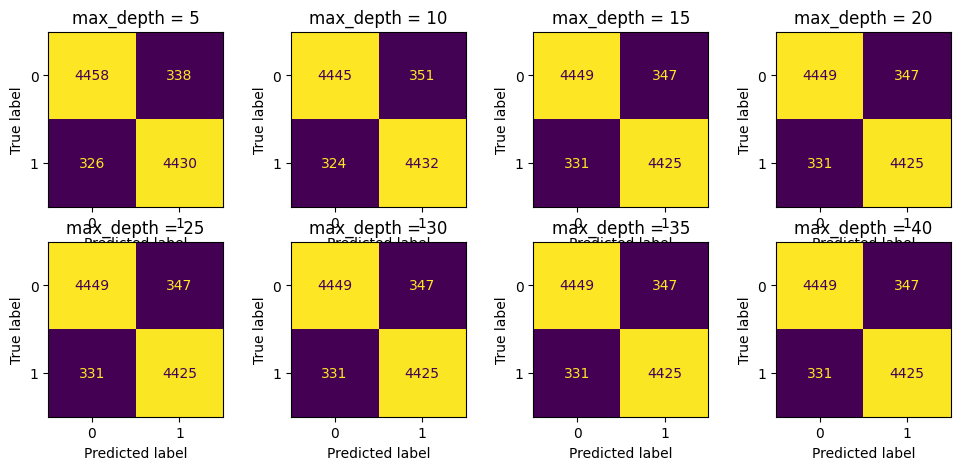

In [ ]:
cm_1 = confusion_matrix(y_test, PAC_pred[0])
cm_2 = confusion_matrix(y_test, PAC_pred[1])
cm_3 = confusion_matrix(y_test, PAC_pred[2])
cm_4 = confusion_matrix(y_test, PAC_pred[3])
cm_5 = confusion_matrix(y_test, PAC_pred[4])
cm_6 = confusion_matrix(y_test, PAC_pred[5])
cm_7 = confusion_matrix(y_test, PAC_pred[6])
cm_8 = confusion_matrix(y_test, PAC_pred[7])

fig, axes = plt.subplots(2, 4, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_depth = 5')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_depth = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_depth = 15')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_depth = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_depth = 25')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_depth = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_depth = 35')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_depth = 40')

## Word2Vec

In [ ]:
# 1. Tokenize os textos
textos_tokenizados = [str(texto).split() for texto in df_juncao['texto_processado']]

# 2. Treine o modelo Word2Vec (ou carregue um pronto)
w2v_model = Word2Vec(sentences=textos_tokenizados, vector_size=100, window=5, min_count=1)

# 3. Função que transforma um texto em vetor médio
def vetor_medio(texto, modelo):
    vetores = [modelo.wv[word] for word in texto if word in modelo.wv]
    return np.mean(vetores, axis=0) if vetores else np.zeros(modelo.vector_size)

# 4. Criar o conjunto de vetores
X_w2v = np.array([vetor_medio(texto, w2v_model) for texto in textos_tokenizados])
y = df_juncao['classificação'].apply(lambda x: 1 if 'true' in x else 0)  # Rótulo

In [ ]:
x_train, x_test, y_train, y_test = train_test_split(X_w2v, y, test_size=0.5, random_state=42)

### Random Forest Classifier

In [ ]:
accuracy_RFC = []
precision_RFC = []
recall_RFC = []
f1_RFC = []
score = []
RFC_pred = []
i = 5
while i<41:
  forest=RandomForestClassifier(max_depth = i,random_state=45)
  forest.fit(x_train,y_train)
  prediction=forest.predict(x_test)
  RFC_pred.append(prediction)
  accuracy_RFC.append(metrics.accuracy_score(prediction,y_test))
  precision_RFC.append(metrics.precision_score(prediction,y_test))
  recall_RFC.append(metrics.recall_score(prediction,y_test))
  f1_RFC.append(metrics.f1_score(prediction,y_test))
  i+= 5

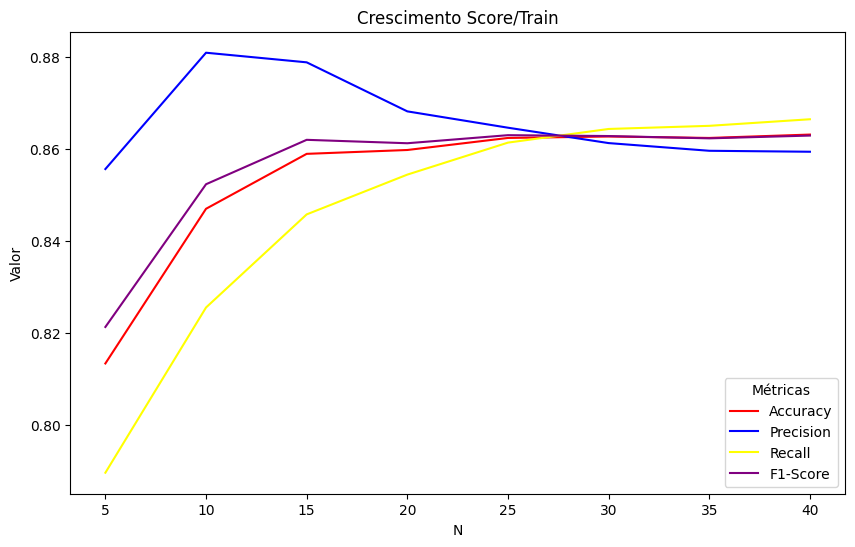

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [5,10,15,20,25,30,35,40]
data_l['accuracy'] = accuracy_RFC
data_l['precision'] = precision_RFC
data_l['recall'] = recall_RFC
data_l['F1-score'] = f1_RFC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_depth = 40')

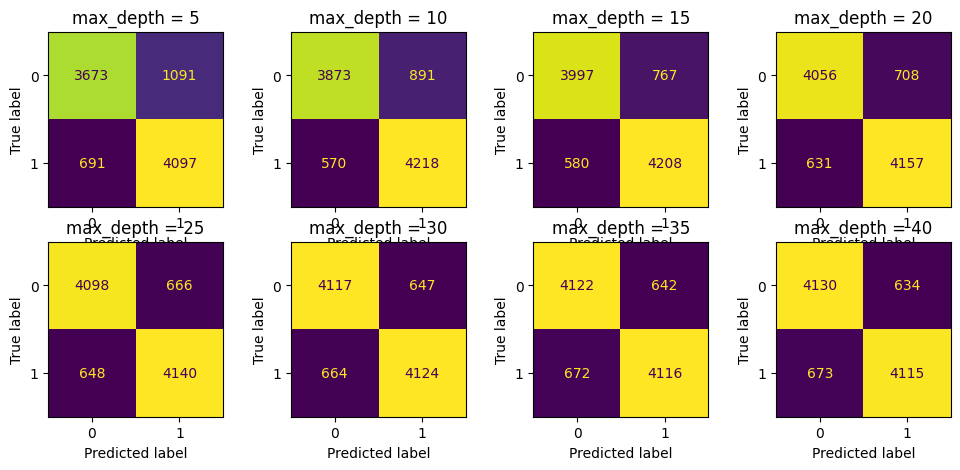

In [ ]:
cm_1 = confusion_matrix(y_test, RFC_pred[0])
cm_2 = confusion_matrix(y_test, RFC_pred[1])
cm_3 = confusion_matrix(y_test, RFC_pred[2])
cm_4 = confusion_matrix(y_test, RFC_pred[3])
cm_5 = confusion_matrix(y_test, RFC_pred[4])
cm_6 = confusion_matrix(y_test, RFC_pred[5])
cm_7 = confusion_matrix(y_test, RFC_pred[6])
cm_8 = confusion_matrix(y_test, RFC_pred[7])

fig, axes = plt.subplots(2, 4, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_depth = 5')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_depth = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_depth = 15')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_depth = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_depth = 25')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_depth = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_depth = 35')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_depth = 40')

### Decision Tree Classifier

In [ ]:
accuracy_DTC = []
precision_DTC = []
recall_DTC = []
f1_DTC = []
DTC_pred = []
i = 5
while i<41:
  mod_dt = DecisionTreeClassifier(max_depth = i, random_state = 1)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  DTC_pred.append(prediction)
  accuracy_DTC.append(metrics.accuracy_score(prediction,y_test))
  precision_DTC.append(metrics.precision_score(prediction,y_test))
  recall_DTC.append(metrics.recall_score(prediction,y_test))
  f1_DTC.append(metrics.f1_score(prediction,y_test))
  i+= 5

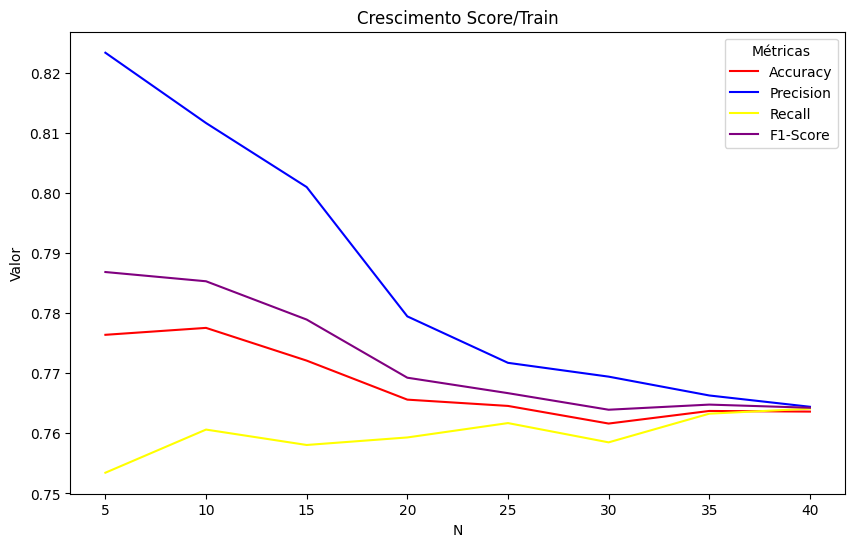

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [5,10,15,20,25,30,35,40]
data_l['accuracy'] = accuracy_DTC
data_l['precision'] = precision_DTC
data_l['recall'] = recall_DTC
data_l['F1-score'] = f1_DTC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_depth = 40')

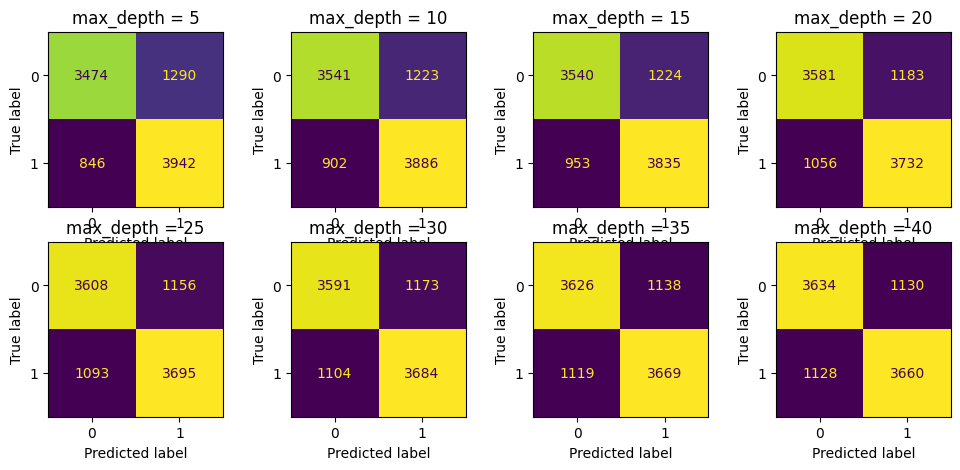

In [ ]:
cm_1 = confusion_matrix(y_test, DTC_pred[0])
cm_2 = confusion_matrix(y_test, DTC_pred[1])
cm_3 = confusion_matrix(y_test, DTC_pred[2])
cm_4 = confusion_matrix(y_test, DTC_pred[3])
cm_5 = confusion_matrix(y_test, DTC_pred[4])
cm_6 = confusion_matrix(y_test, DTC_pred[5])
cm_7 = confusion_matrix(y_test, DTC_pred[6])
cm_8 = confusion_matrix(y_test, DTC_pred[7])

fig, axes = plt.subplots(2, 4, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_depth = 5')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_depth = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_depth = 15')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_depth = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_depth = 25')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_depth = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_depth = 35')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_depth = 40')

### Logistic Regression


In [ ]:
accuracy_LR = []
precision_LR = []
recall_LR = []
f1_LR = []
LR_pred = []
i = 10
while i<151:
  mod_dt = LogisticRegression(max_iter = i, random_state = 1)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  LR_pred.append(prediction)
  accuracy_LR.append(metrics.accuracy_score(prediction,y_test))
  precision_LR.append(metrics.precision_score(prediction,y_test))
  recall_LR.append(metrics.recall_score(prediction,y_test))
  f1_LR.append(metrics.f1_score(prediction,y_test))
  i+= 10

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _c

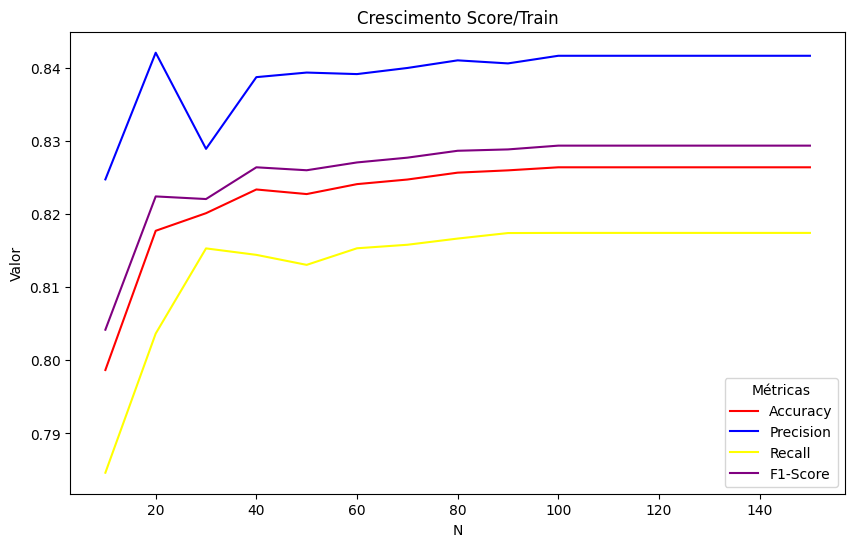

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [10,20,30,40,50,60,70,80,90,100,110,120,130,140,150]
data_l['accuracy'] = accuracy_LR
data_l['precision'] = precision_LR
data_l['recall'] = recall_LR
data_l['F1-score'] = f1_LR
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_iter = 150')

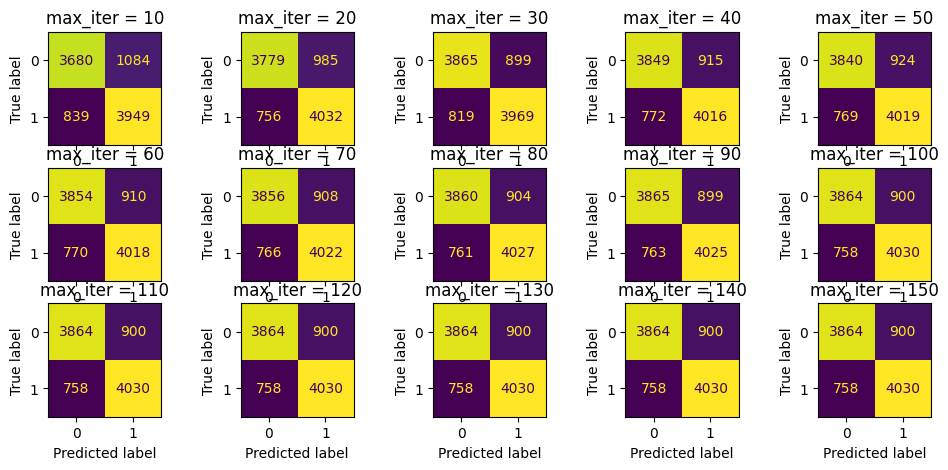

In [ ]:
cm_1 = confusion_matrix(y_test, LR_pred[0])
cm_2 = confusion_matrix(y_test, LR_pred[1])
cm_3 = confusion_matrix(y_test, LR_pred[2])
cm_4 = confusion_matrix(y_test, LR_pred[3])
cm_5 = confusion_matrix(y_test, LR_pred[4])
cm_6 = confusion_matrix(y_test, LR_pred[5])
cm_7 = confusion_matrix(y_test, LR_pred[6])
cm_8 = confusion_matrix(y_test, LR_pred[7])
cm_9 = confusion_matrix(y_test, LR_pred[8])
cm_10 = confusion_matrix(y_test, LR_pred[9])
cm_11 = confusion_matrix(y_test, LR_pred[10])
cm_12 = confusion_matrix(y_test, LR_pred[11])
cm_13 = confusion_matrix(y_test, LR_pred[12])
cm_14 = confusion_matrix(y_test, LR_pred[13])
cm_15 = confusion_matrix(y_test, LR_pred[14])

fig, axes = plt.subplots(3, 5, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_iter = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_iter = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_iter = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_iter = 40')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[0,4], colorbar=False)
axes[0,4].set_title('max_iter = 50')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_iter = 60')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_iter = 70')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_iter = 80')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_9)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_iter = 90')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_10)
disp_rfc.plot(ax=axes[1,4], colorbar=False)
axes[1,4].set_title('max_iter = 100')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_11)
disp_rfc.plot(ax=axes[2,0], colorbar=False)
axes[2,0].set_title('max_iter = 110')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_12)
disp_rfc.plot(ax=axes[2,1], colorbar=False)
axes[2,1].set_title('max_iter = 120')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_13)
disp_rfc.plot(ax=axes[2,2], colorbar=False)
axes[2,2].set_title('max_iter = 130')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_14)
disp_rfc.plot(ax=axes[2,3], colorbar=False)
axes[2,3].set_title('max_iter = 140')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_15)
disp_rfc.plot(ax=axes[2,4], colorbar=False)
axes[2,4].set_title('max_iter = 150')

### Linear Support Vector Classifier


In [ ]:
accuracy_LSVC = []
precision_LSVC = []
recall_LSVC = []
f1_LSVC = []
LSVC_pred = []
i = 10
while i<151:
  mod_dt = LinearSVC(max_iter = i, random_state = 42)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  LSVC_pred.append(prediction)
  accuracy_LSVC.append(metrics.accuracy_score(prediction,y_test))
  precision_LSVC.append(metrics.precision_score(prediction,y_test))
  recall_LSVC.append(metrics.recall_score(prediction,y_test))
  f1_LSVC.append(metrics.f1_score(prediction,y_test))
  i+= 10

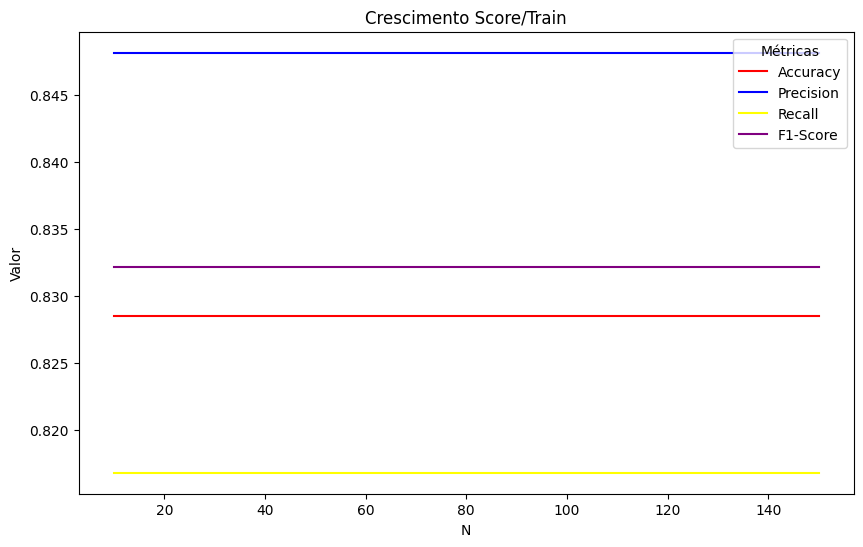

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [10,20,30,40,50,60,70,80,90,100,110,120,130,140,150]
data_l['accuracy'] = accuracy_LSVC
data_l['precision'] = precision_LSVC
data_l['recall'] = recall_LSVC
data_l['F1-score'] = f1_LSVC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_iter = 150')

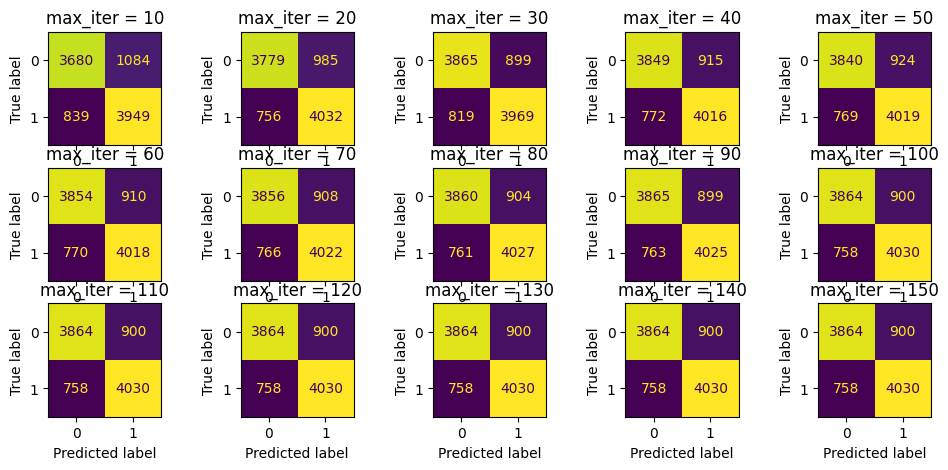

In [ ]:
cm_1 = confusion_matrix(y_test, LR_pred[0])
cm_2 = confusion_matrix(y_test, LR_pred[1])
cm_3 = confusion_matrix(y_test, LR_pred[2])
cm_4 = confusion_matrix(y_test, LR_pred[3])
cm_5 = confusion_matrix(y_test, LR_pred[4])
cm_6 = confusion_matrix(y_test, LR_pred[5])
cm_7 = confusion_matrix(y_test, LR_pred[6])
cm_8 = confusion_matrix(y_test, LR_pred[7])
cm_9 = confusion_matrix(y_test, LR_pred[8])
cm_10 = confusion_matrix(y_test, LR_pred[9])
cm_11 = confusion_matrix(y_test, LR_pred[10])
cm_12 = confusion_matrix(y_test, LR_pred[11])
cm_13 = confusion_matrix(y_test, LR_pred[12])
cm_14 = confusion_matrix(y_test, LR_pred[13])
cm_15 = confusion_matrix(y_test, LR_pred[14])

fig, axes = plt.subplots(3, 5, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_iter = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_iter = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_iter = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_iter = 40')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[0,4], colorbar=False)
axes[0,4].set_title('max_iter = 50')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_iter = 60')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_iter = 70')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_iter = 80')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_9)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_iter = 90')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_10)
disp_rfc.plot(ax=axes[1,4], colorbar=False)
axes[1,4].set_title('max_iter = 100')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_11)
disp_rfc.plot(ax=axes[2,0], colorbar=False)
axes[2,0].set_title('max_iter = 110')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_12)
disp_rfc.plot(ax=axes[2,1], colorbar=False)
axes[2,1].set_title('max_iter = 120')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_13)
disp_rfc.plot(ax=axes[2,2], colorbar=False)
axes[2,2].set_title('max_iter = 130')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_14)
disp_rfc.plot(ax=axes[2,3], colorbar=False)
axes[2,3].set_title('max_iter = 140')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_15)
disp_rfc.plot(ax=axes[2,4], colorbar=False)
axes[2,4].set_title('max_iter = 150')

### Passive Aggressive Classifier


In [ ]:
accuracy_PAC = []
precision_PAC = []
recall_PAC = []
f1_PAC = []
PAC_pred = []
i = 5
while i<41:
  mod_dt = PassiveAggressiveClassifier(max_iter=i, random_state=42)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  PAC_pred.append(prediction)
  accuracy_PAC.append(metrics.accuracy_score(prediction,y_test))
  precision_PAC.append(metrics.precision_score(prediction,y_test))
  recall_PAC.append(metrics.recall_score(prediction,y_test))
  f1_PAC.append(metrics.f1_score(prediction,y_test))
  i+= 5

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:738: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:738: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(


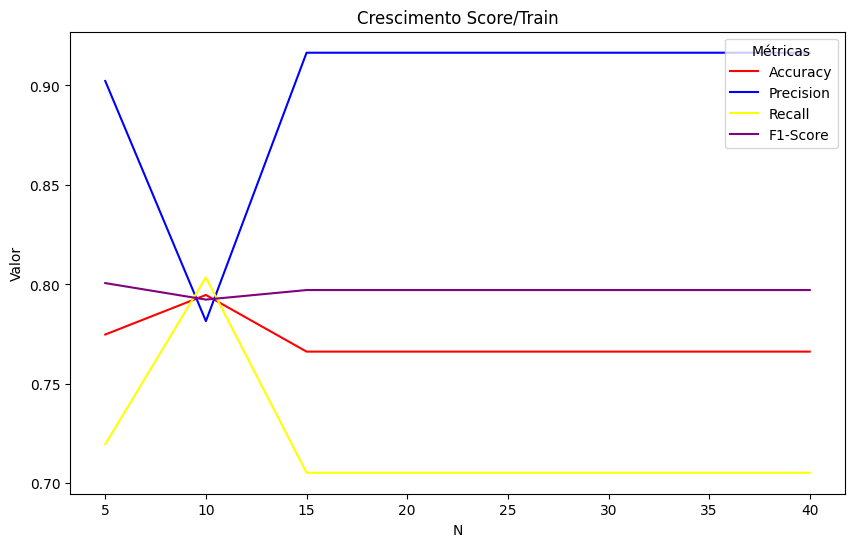

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [5,10,15,20,25,30,35,40]
data_l['accuracy'] = accuracy_PAC
data_l['precision'] = precision_PAC
data_l['recall'] = recall_PAC
data_l['F1-score'] = f1_PAC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_depth = 40')

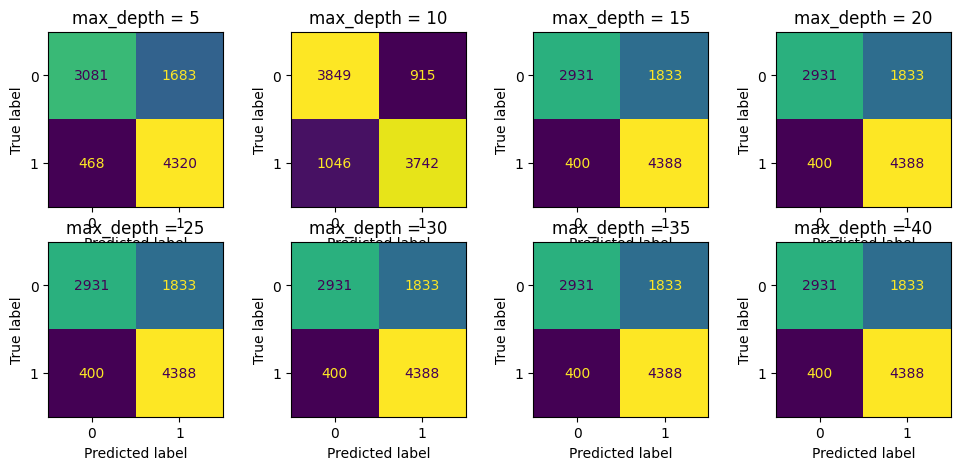

In [ ]:
cm_1 = confusion_matrix(y_test, PAC_pred[0])
cm_2 = confusion_matrix(y_test, PAC_pred[1])
cm_3 = confusion_matrix(y_test, PAC_pred[2])
cm_4 = confusion_matrix(y_test, PAC_pred[3])
cm_5 = confusion_matrix(y_test, PAC_pred[4])
cm_6 = confusion_matrix(y_test, PAC_pred[5])
cm_7 = confusion_matrix(y_test, PAC_pred[6])
cm_8 = confusion_matrix(y_test, PAC_pred[7])

fig, axes = plt.subplots(2, 4, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_depth = 5')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_depth = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_depth = 15')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_depth = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_depth = 25')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_depth = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_depth = 35')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_depth = 40')

## BERT

In [ ]:
# 1. Carregar BERT pré-treinado para português
tokenizer = BertTokenizer.from_pretrained('neuralmind/bert-base-portuguese-cased')
bert_model = BertModel.from_pretrained('neuralmind/bert-base-portuguese-cased')
bert_model.eval()

# 2. Função para vetorizar um texto
def get_bert_vector(texto):
    inputs = tokenizer(texto, return_tensors="pt", truncation=True, padding='max_length', max_length=128)
    with torch.no_grad():
        outputs = bert_model(**inputs)
    return outputs.last_hidden_state[:, 0, :].squeeze().numpy()  # vetor da token [CLS]

# 3. Aplicar a função para todos os textos
textos = df_juncao['texto_processado'].astype(str)
X_bert = np.array([get_bert_vector(t) for t in textos])
y = df_juncao['classificação'].apply(lambda x: 1 if 'true' in x else 0)


/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


In [ ]:
x_train, x_test, y_train, y_test = train_test_split(X_bert, y, test_size=0.5, random_state=42)

### Random Forest Classifier

In [ ]:
accuracy_RFC = []
precision_RFC = []
recall_RFC = []
f1_RFC = []
score = []
RFC_pred = []
i = 5
while i<41:
  forest=RandomForestClassifier(max_depth = i,random_state=45)
  forest.fit(x_train,y_train)
  prediction=forest.predict(x_test)
  RFC_pred.append(prediction)
  accuracy_RFC.append(metrics.accuracy_score(prediction,y_test))
  precision_RFC.append(metrics.precision_score(prediction,y_test))
  recall_RFC.append(metrics.recall_score(prediction,y_test))
  f1_RFC.append(metrics.f1_score(prediction,y_test))
  i+= 5

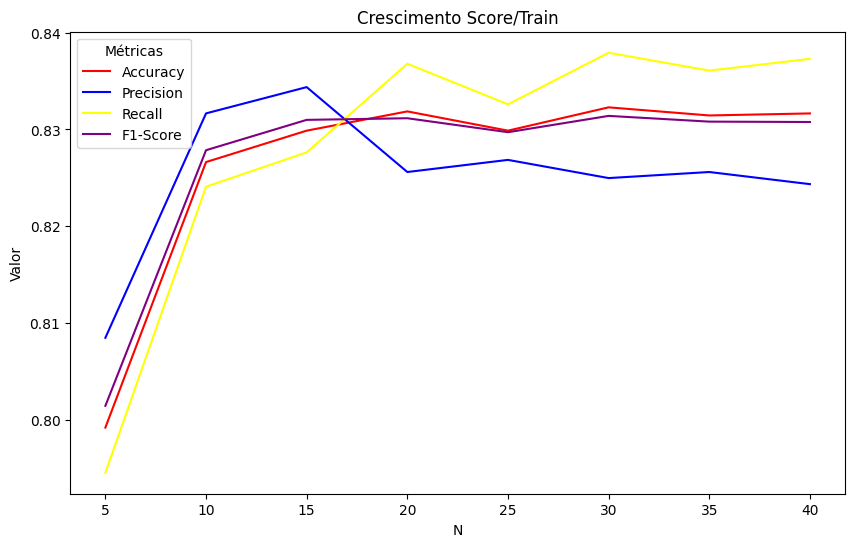

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [5,10,15,20,25,30,35,40]
data_l['accuracy'] = accuracy_RFC
data_l['precision'] = precision_RFC
data_l['recall'] = recall_RFC
data_l['F1-score'] = f1_RFC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_depth = 40')

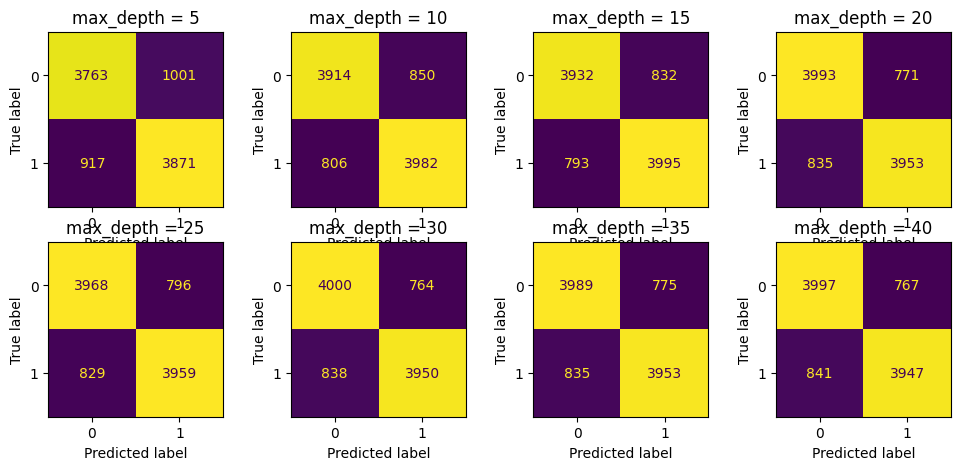

In [ ]:
cm_1 = confusion_matrix(y_test, RFC_pred[0])
cm_2 = confusion_matrix(y_test, RFC_pred[1])
cm_3 = confusion_matrix(y_test, RFC_pred[2])
cm_4 = confusion_matrix(y_test, RFC_pred[3])
cm_5 = confusion_matrix(y_test, RFC_pred[4])
cm_6 = confusion_matrix(y_test, RFC_pred[5])
cm_7 = confusion_matrix(y_test, RFC_pred[6])
cm_8 = confusion_matrix(y_test, RFC_pred[7])

fig, axes = plt.subplots(2, 4, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_depth = 5')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_depth = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_depth = 15')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_depth = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_depth = 25')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_depth = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_depth = 35')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_depth = 40')

### Decision Tree Classifier

In [ ]:
accuracy_DTC = []
precision_DTC = []
recall_DTC = []
f1_DTC = []
DTC_pred = []
i = 5
while i<41:
  mod_dt = DecisionTreeClassifier(max_depth = i, random_state = 1)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  DTC_pred.append(prediction)
  accuracy_DTC.append(metrics.accuracy_score(prediction,y_test))
  precision_DTC.append(metrics.precision_score(prediction,y_test))
  recall_DTC.append(metrics.recall_score(prediction,y_test))
  f1_DTC.append(metrics.f1_score(prediction,y_test))
  i+= 5

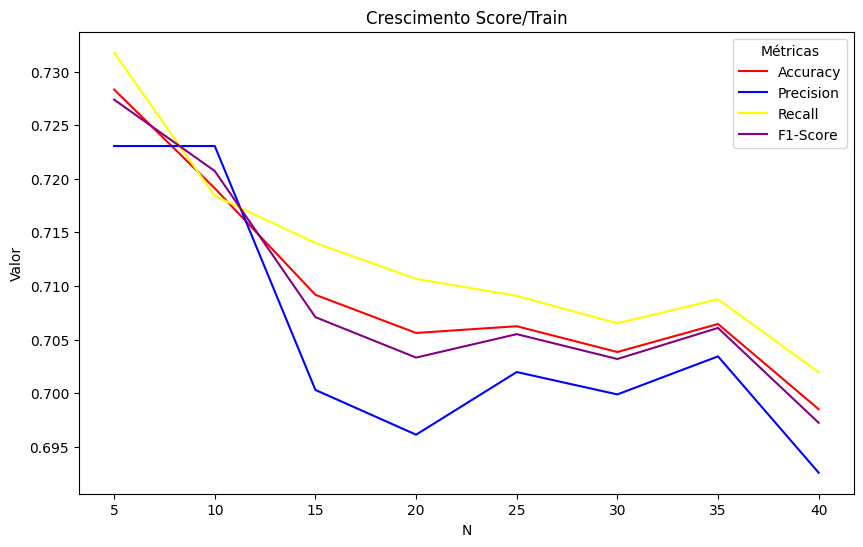

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [5,10,15,20,25,30,35,40]
data_l['accuracy'] = accuracy_DTC
data_l['precision'] = precision_DTC
data_l['recall'] = recall_DTC
data_l['F1-score'] = f1_DTC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_depth = 40')

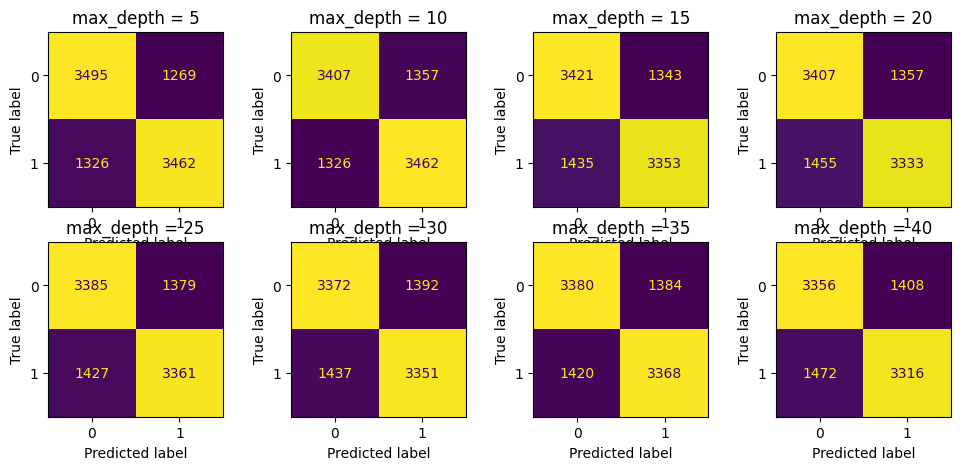

In [ ]:
cm_1 = confusion_matrix(y_test, DTC_pred[0])
cm_2 = confusion_matrix(y_test, DTC_pred[1])
cm_3 = confusion_matrix(y_test, DTC_pred[2])
cm_4 = confusion_matrix(y_test, DTC_pred[3])
cm_5 = confusion_matrix(y_test, DTC_pred[4])
cm_6 = confusion_matrix(y_test, DTC_pred[5])
cm_7 = confusion_matrix(y_test, DTC_pred[6])
cm_8 = confusion_matrix(y_test, DTC_pred[7])

fig, axes = plt.subplots(2, 4, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_depth = 5')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_depth = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_depth = 15')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_depth = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_depth = 25')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_depth = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_depth = 35')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_depth = 40')

### Logistic Regression


In [ ]:
accuracy_LR = []
precision_LR = []
recall_LR = []
f1_LR = []
LR_pred = []
i = 10
while i<151:
  mod_dt = LogisticRegression(max_iter = i, random_state = 1)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  LR_pred.append(prediction)
  accuracy_LR.append(metrics.accuracy_score(prediction,y_test))
  precision_LR.append(metrics.precision_score(prediction,y_test))
  recall_LR.append(metrics.recall_score(prediction,y_test))
  f1_LR.append(metrics.f1_score(prediction,y_test))
  i+= 10

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _c

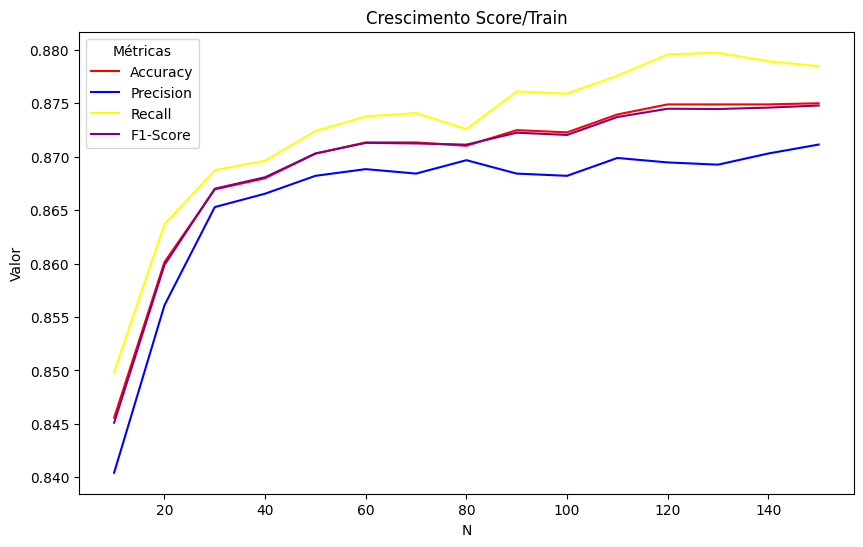

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [10,20,30,40,50,60,70,80,90,100,110,120,130,140,150]
data_l['accuracy'] = accuracy_LR
data_l['precision'] = precision_LR
data_l['recall'] = recall_LR
data_l['F1-score'] = f1_LR
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_iter = 150')

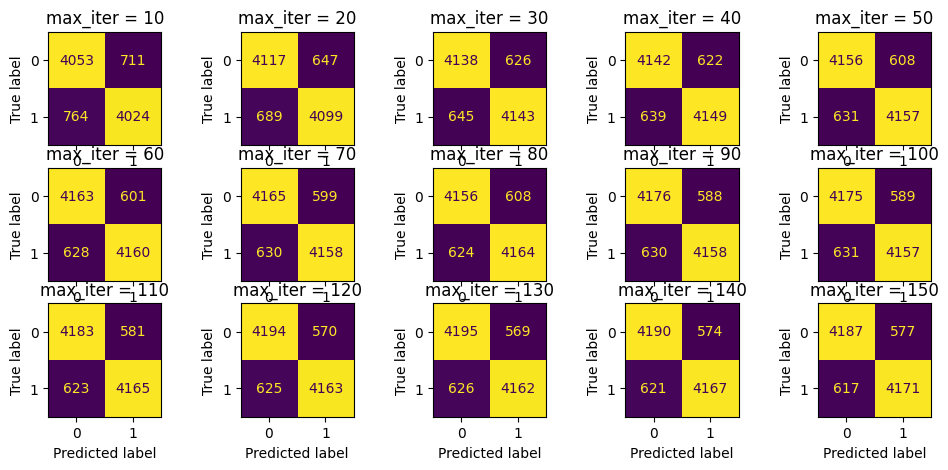

In [ ]:
cm_1 = confusion_matrix(y_test, LR_pred[0])
cm_2 = confusion_matrix(y_test, LR_pred[1])
cm_3 = confusion_matrix(y_test, LR_pred[2])
cm_4 = confusion_matrix(y_test, LR_pred[3])
cm_5 = confusion_matrix(y_test, LR_pred[4])
cm_6 = confusion_matrix(y_test, LR_pred[5])
cm_7 = confusion_matrix(y_test, LR_pred[6])
cm_8 = confusion_matrix(y_test, LR_pred[7])
cm_9 = confusion_matrix(y_test, LR_pred[8])
cm_10 = confusion_matrix(y_test, LR_pred[9])
cm_11 = confusion_matrix(y_test, LR_pred[10])
cm_12 = confusion_matrix(y_test, LR_pred[11])
cm_13 = confusion_matrix(y_test, LR_pred[12])
cm_14 = confusion_matrix(y_test, LR_pred[13])
cm_15 = confusion_matrix(y_test, LR_pred[14])

fig, axes = plt.subplots(3, 5, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_iter = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_iter = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_iter = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_iter = 40')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[0,4], colorbar=False)
axes[0,4].set_title('max_iter = 50')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_iter = 60')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_iter = 70')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_iter = 80')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_9)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_iter = 90')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_10)
disp_rfc.plot(ax=axes[1,4], colorbar=False)
axes[1,4].set_title('max_iter = 100')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_11)
disp_rfc.plot(ax=axes[2,0], colorbar=False)
axes[2,0].set_title('max_iter = 110')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_12)
disp_rfc.plot(ax=axes[2,1], colorbar=False)
axes[2,1].set_title('max_iter = 120')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_13)
disp_rfc.plot(ax=axes[2,2], colorbar=False)
axes[2,2].set_title('max_iter = 130')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_14)
disp_rfc.plot(ax=axes[2,3], colorbar=False)
axes[2,3].set_title('max_iter = 140')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_15)
disp_rfc.plot(ax=axes[2,4], colorbar=False)
axes[2,4].set_title('max_iter = 150')

### Linear Support Vector Classifier


In [ ]:
accuracy_LSVC = []
precision_LSVC = []
recall_LSVC = []
f1_LSVC = []
LSVC_pred = []
i = 10
while i<151:
  mod_dt = LinearSVC(max_iter = i, random_state = 42)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  LSVC_pred.append(prediction)
  accuracy_LSVC.append(metrics.accuracy_score(prediction,y_test))
  precision_LSVC.append(metrics.precision_score(prediction,y_test))
  recall_LSVC.append(metrics.recall_score(prediction,y_test))
  f1_LSVC.append(metrics.f1_score(prediction,y_test))
  i+= 10

/usr/local/lib/python3.11/dist-packages/sklearn/svm/_base.py:1249: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


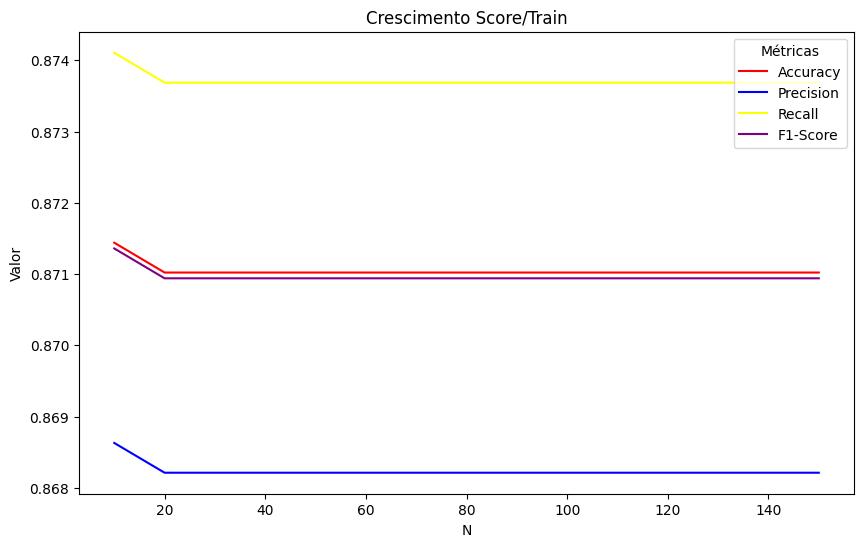

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [10,20,30,40,50,60,70,80,90,100,110,120,130,140,150]
data_l['accuracy'] = accuracy_LSVC
data_l['precision'] = precision_LSVC
data_l['recall'] = recall_LSVC
data_l['F1-score'] = f1_LSVC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_iter = 150')

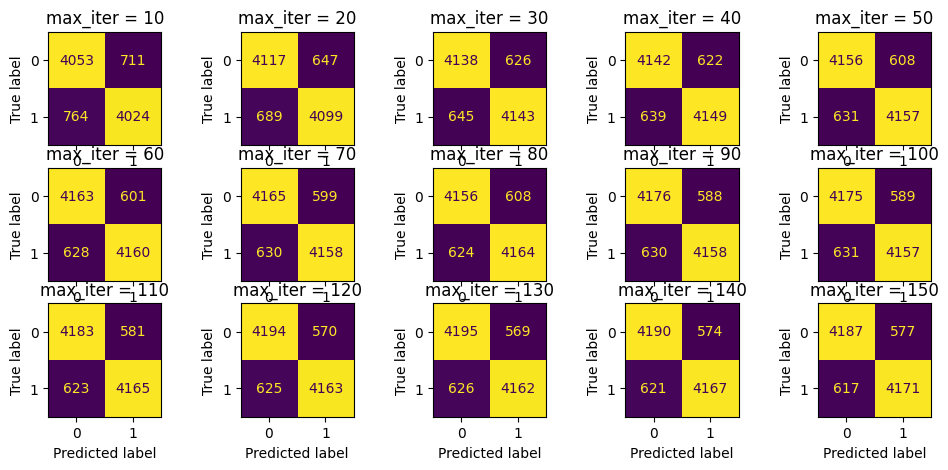

In [ ]:
cm_1 = confusion_matrix(y_test, LR_pred[0])
cm_2 = confusion_matrix(y_test, LR_pred[1])
cm_3 = confusion_matrix(y_test, LR_pred[2])
cm_4 = confusion_matrix(y_test, LR_pred[3])
cm_5 = confusion_matrix(y_test, LR_pred[4])
cm_6 = confusion_matrix(y_test, LR_pred[5])
cm_7 = confusion_matrix(y_test, LR_pred[6])
cm_8 = confusion_matrix(y_test, LR_pred[7])
cm_9 = confusion_matrix(y_test, LR_pred[8])
cm_10 = confusion_matrix(y_test, LR_pred[9])
cm_11 = confusion_matrix(y_test, LR_pred[10])
cm_12 = confusion_matrix(y_test, LR_pred[11])
cm_13 = confusion_matrix(y_test, LR_pred[12])
cm_14 = confusion_matrix(y_test, LR_pred[13])
cm_15 = confusion_matrix(y_test, LR_pred[14])

fig, axes = plt.subplots(3, 5, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_iter = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_iter = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_iter = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_iter = 40')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[0,4], colorbar=False)
axes[0,4].set_title('max_iter = 50')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_iter = 60')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_iter = 70')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_iter = 80')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_9)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_iter = 90')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_10)
disp_rfc.plot(ax=axes[1,4], colorbar=False)
axes[1,4].set_title('max_iter = 100')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_11)
disp_rfc.plot(ax=axes[2,0], colorbar=False)
axes[2,0].set_title('max_iter = 110')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_12)
disp_rfc.plot(ax=axes[2,1], colorbar=False)
axes[2,1].set_title('max_iter = 120')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_13)
disp_rfc.plot(ax=axes[2,2], colorbar=False)
axes[2,2].set_title('max_iter = 130')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_14)
disp_rfc.plot(ax=axes[2,3], colorbar=False)
axes[2,3].set_title('max_iter = 140')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_15)
disp_rfc.plot(ax=axes[2,4], colorbar=False)
axes[2,4].set_title('max_iter = 150')

### Passive Aggressive Classifier


In [ ]:
accuracy_PAC = []
precision_PAC = []
recall_PAC = []
f1_PAC = []
PAC_pred = []
i = 5
while i<41:
  mod_dt = PassiveAggressiveClassifier(max_iter=i, random_state=42)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  PAC_pred.append(prediction)
  accuracy_PAC.append(metrics.accuracy_score(prediction,y_test))
  precision_PAC.append(metrics.precision_score(prediction,y_test))
  recall_PAC.append(metrics.recall_score(prediction,y_test))
  f1_PAC.append(metrics.f1_score(prediction,y_test))
  i+= 5

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:738: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:738: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:738: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:738: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic

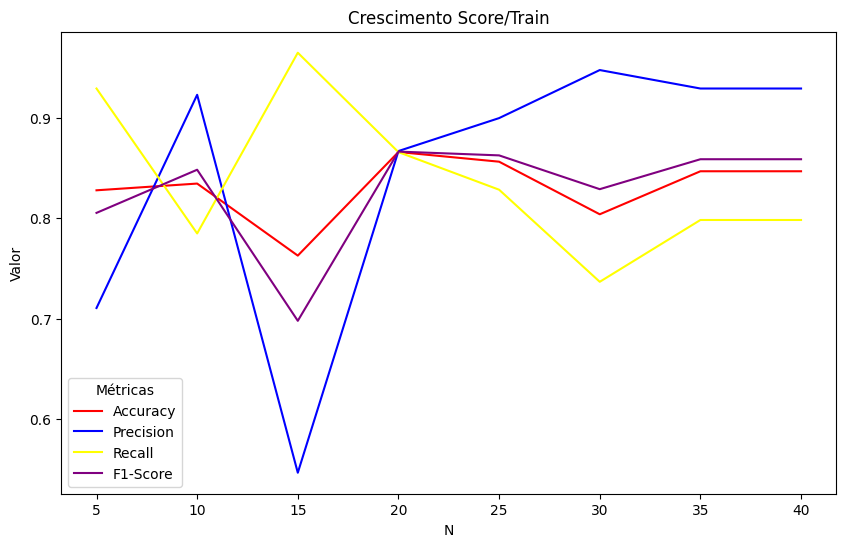

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [5,10,15,20,25,30,35,40]
data_l['accuracy'] = accuracy_PAC
data_l['precision'] = precision_PAC
data_l['recall'] = recall_PAC
data_l['F1-score'] = f1_PAC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_depth = 40')

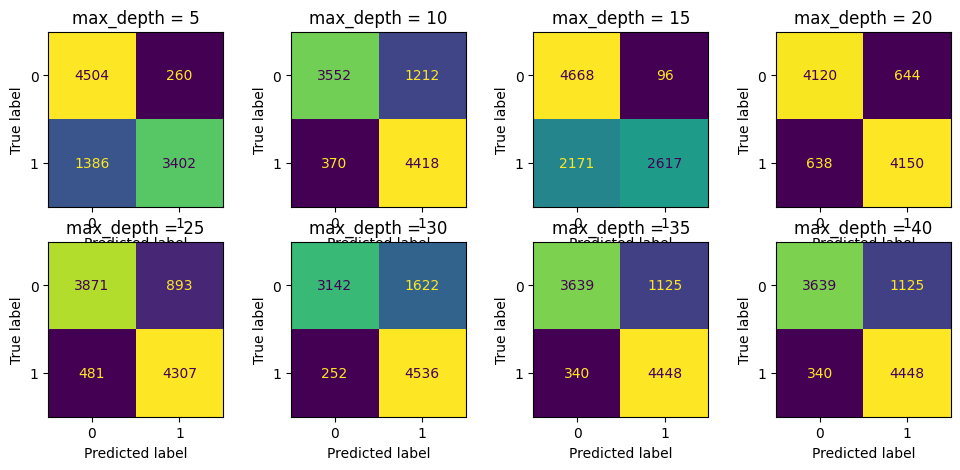

In [ ]:
cm_1 = confusion_matrix(y_test, PAC_pred[0])
cm_2 = confusion_matrix(y_test, PAC_pred[1])
cm_3 = confusion_matrix(y_test, PAC_pred[2])
cm_4 = confusion_matrix(y_test, PAC_pred[3])
cm_5 = confusion_matrix(y_test, PAC_pred[4])
cm_6 = confusion_matrix(y_test, PAC_pred[5])
cm_7 = confusion_matrix(y_test, PAC_pred[6])
cm_8 = confusion_matrix(y_test, PAC_pred[7])

fig, axes = plt.subplots(2, 4, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_depth = 5')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_depth = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_depth = 15')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_depth = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_depth = 25')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_depth = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_depth = 35')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_depth = 40')

# Datasets Corrigidos pelo ChatGPT-4o

In [ ]:
df_fakebr_c = pd.read_csv('/content/drive/MyDrive/DatasetTCC/fakebr_dataset_corrigido.csv')
df_fakebr_c = df_fakebr_c.drop(columns=['id'])
print(df_fakebr_c.head())

print('-------------------------------------------------------------------------------------------------')
df_fakerecogna_c = pd.read_csv('/content/drive/MyDrive/DatasetTCC/fakerecogna_dataset_corrigido.csv')
df_fakerecogna_c = df_fakerecogna_c.drop(columns=['id'])
print(df_fakerecogna_c.head())

print('-------------------------------------------------------------------------------------------------')
df_uniao_c = pd.read_csv('/content/drive/MyDrive/DatasetTCC/uniao_dataset_corrigido.csv')
print(df_uniao_c.head())

  classificação                                    texto_corrigido
0          fake  ministro celso melão manda recado políticos ma...
1          fake  e divulga vídeo ameaça frança eua vamos vingar...
2          fake  áudio estranho vaza youtube parte financeira n...
3          fake  francês de figuro faz matéria sobre dilema exg...
4          fake  planalto pânico sef pode devolver ações envolv...
-------------------------------------------------------------------------------------------------
  classificação                                    texto_corrigido
0          fake  apago vaticano papar presar acusação tráfico c...
1          true  governar equador anunciar preparar cova coleti...
2          true  companhia ir franco operar voar direto pequim ...
3          true  marfim global todos retomar vender carnal bovi...
4          fake  assunto voltar compartilhar rede social julho ...
-------------------------------------------------------------------------------------------------


## Dataset Fake.Br Corrigido:

In [ ]:
df_fakebr_c.head()

,classificação,texto_corrigido
0,fake,ministro celso melão manda recado políticos ma...
1,fake,e divulga vídeo ameaça frança eua vamos vingar...
2,fake,áudio estranho vaza youtube parte financeira n...
3,fake,francês de figuro faz matéria sobre dilema exg...
4,fake,planalto pânico sef pode devolver ações envolv...


In [ ]:
df_fakebr_c['num_palavras'] = df_fakebr_c['texto_corrigido'].astype(str).apply(lambda x: len(x.split()))
print(df_fakebr_c['num_palavras'].describe())

count    7200.000000
mean      357.779722
std       368.263643
min         5.000000
25%        89.000000
50%       204.000000
75%       514.000000
max      4112.000000
Name: num_palavras, dtype: float64


In [ ]:
palavras = " ".join(df_fakebr_c['texto_corrigido'].astype(str)).split()
frequencia = Counter(palavras)
print(frequencia.most_common(10))  # Top 10 palavras mais frequentes

[('presidente', 16215), ('a', 13429), ('lula', 11861), ('disse', 10426), ('sobre', 9464), ('anos', 9389), ('federal', 8834), ('governo', 8031), ('ainda', 7998), ('segundo', 7247)]


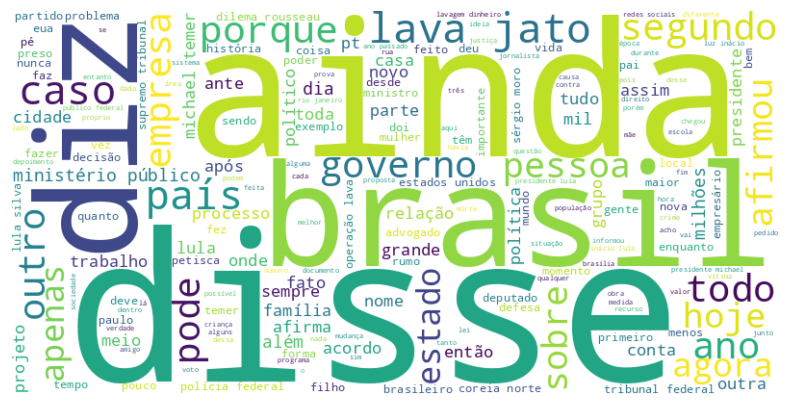

In [ ]:
texto = " ".join(df_fakebr_c['texto_corrigido'].astype(str))
wordcloud = WordCloud(width=800, height=400, background_color="white").generate(texto)

plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()

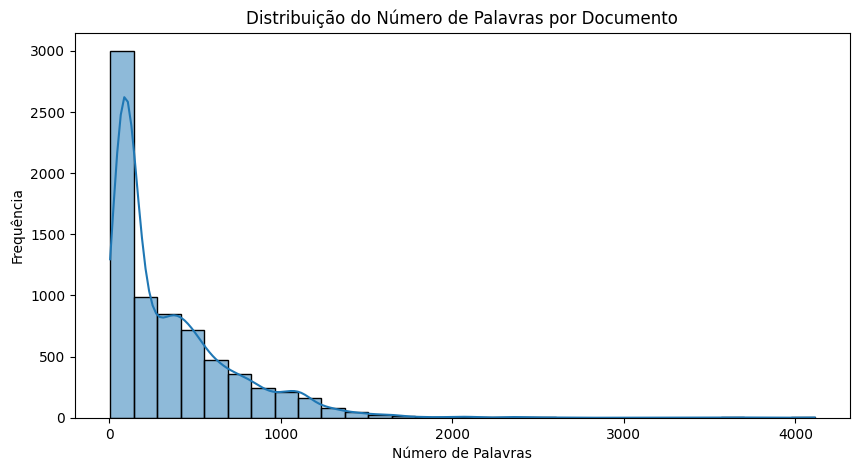

In [ ]:
plt.figure(figsize=(10,5))
sns.histplot(df_fakebr_c['num_palavras'], bins=30, kde=True)
plt.xlabel("Número de Palavras")
plt.ylabel("Frequência")
plt.title("Distribuição do Número de Palavras por Documento")
plt.show()

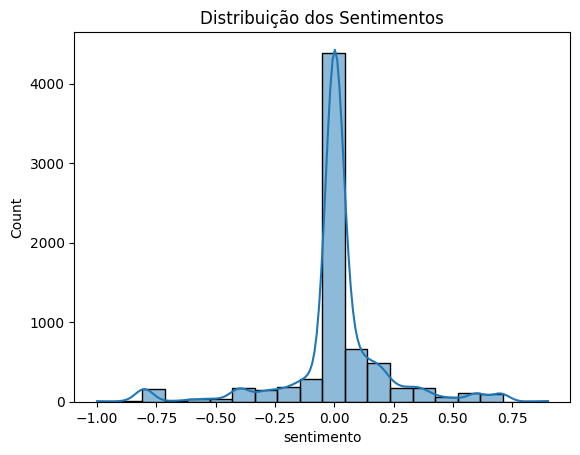

In [ ]:
from textblob import TextBlob

df_fakebr_c['texto_corrigido'] = df_fakebr_c['texto_corrigido'].astype(str)
df_fakebr_c['sentimento'] = df_fakebr_c['texto_corrigido'].apply(lambda x: TextBlob(x).sentiment.polarity)
sns.histplot(df_fakebr_c['sentimento'], bins=20, kde=True)
plt.title("Distribuição dos Sentimentos")
plt.show()

### TF-IDF

In [ ]:
vetorizador = TfidfVectorizer()

x_train = vetorizador.fit_transform(df_fakebr_c['texto_corrigido'].astype(str))
y_train = df_fakebr_c['classificação'].apply(lambda x: 1 if 'true' in x else 0)
x_test = vetorizador.transform(df_fakerecogna_c['texto_corrigido'].astype(str))
y_test = df_fakerecogna_c['classificação'].apply(lambda x: 1 if 'true' in x else 0)

#### RFC

In [ ]:
accuracy_RFC = []
precision_RFC = []
recall_RFC = []
f1_RFC = []
score = []
RFC_pred = []
i = 5
while i<41:
  forest=RandomForestClassifier(max_depth = i,random_state=45)
  forest.fit(x_train,y_train)
  prediction=forest.predict(x_test)
  RFC_pred.append(prediction)
  accuracy_RFC.append(metrics.accuracy_score(prediction,y_test))
  precision_RFC.append(metrics.precision_score(prediction,y_test))
  recall_RFC.append(metrics.recall_score(prediction,y_test))
  f1_RFC.append(metrics.f1_score(prediction,y_test))
  i+= 5

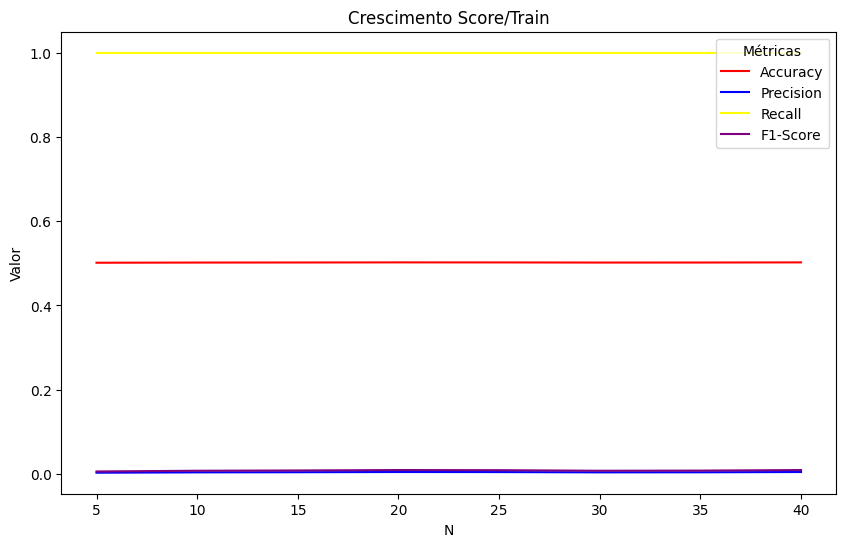

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [5,10,15,20,25,30,35,40]
data_l['accuracy'] = accuracy_RFC
data_l['precision'] = precision_RFC
data_l['recall'] = recall_RFC
data_l['F1-score'] = f1_RFC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_depth = 40')

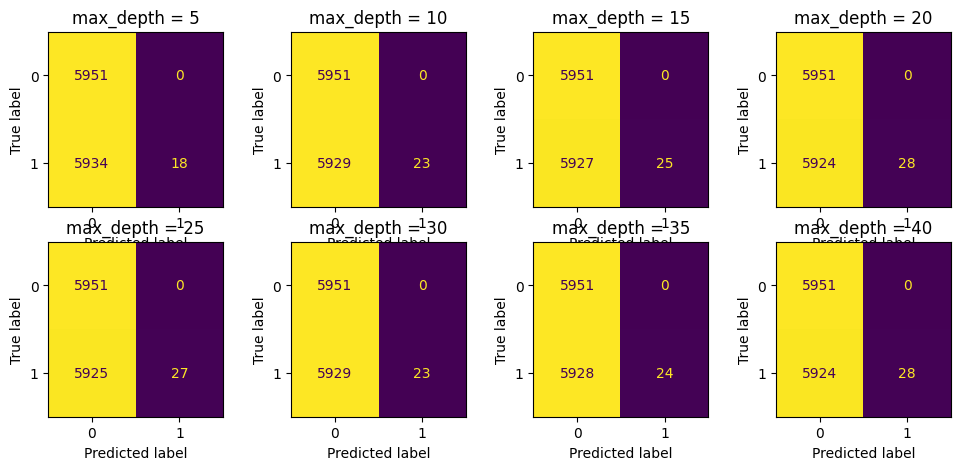

In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

cm_1 = confusion_matrix(y_test, RFC_pred[0])
cm_2 = confusion_matrix(y_test, RFC_pred[1])
cm_3 = confusion_matrix(y_test, RFC_pred[2])
cm_4 = confusion_matrix(y_test, RFC_pred[3])
cm_5 = confusion_matrix(y_test, RFC_pred[4])
cm_6 = confusion_matrix(y_test, RFC_pred[5])
cm_7 = confusion_matrix(y_test, RFC_pred[6])
cm_8 = confusion_matrix(y_test, RFC_pred[7])

fig, axes = plt.subplots(2, 4, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_depth = 5')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_depth = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_depth = 15')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_depth = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_depth = 25')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_depth = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_depth = 35')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_depth = 40')

#### DTC

In [ ]:
accuracy_DTC = []
precision_DTC = []
recall_DTC = []
f1_DTC = []
DTC_pred = []
i = 5
while i<41:
  mod_dt = DecisionTreeClassifier(max_depth = i, random_state = 1)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  DTC_pred.append(prediction)
  accuracy_DTC.append(metrics.accuracy_score(prediction,y_test))
  precision_DTC.append(metrics.precision_score(prediction,y_test))
  recall_DTC.append(metrics.recall_score(prediction,y_test))
  f1_DTC.append(metrics.f1_score(prediction,y_test))
  i+= 5

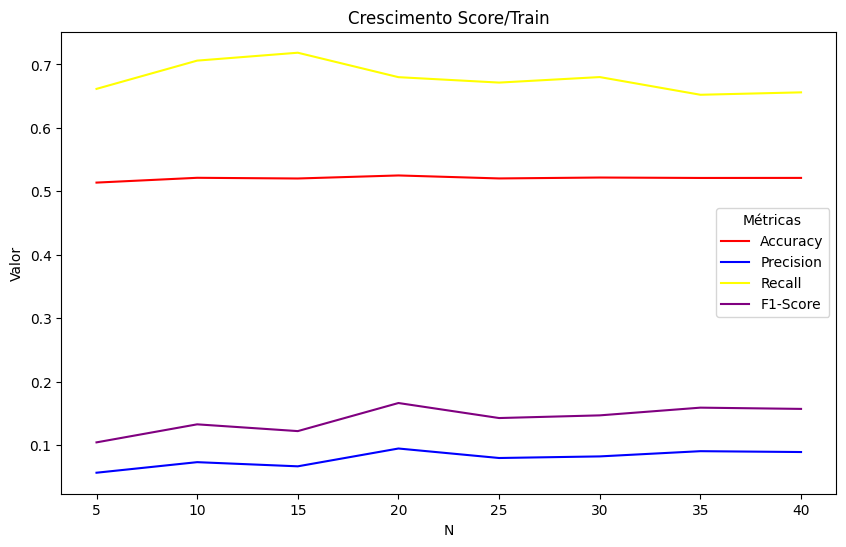

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [5,10,15,20,25,30,35,40]
data_l['accuracy'] = accuracy_DTC
data_l['precision'] = precision_DTC
data_l['recall'] = recall_DTC
data_l['F1-score'] = f1_DTC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_depth = 40')

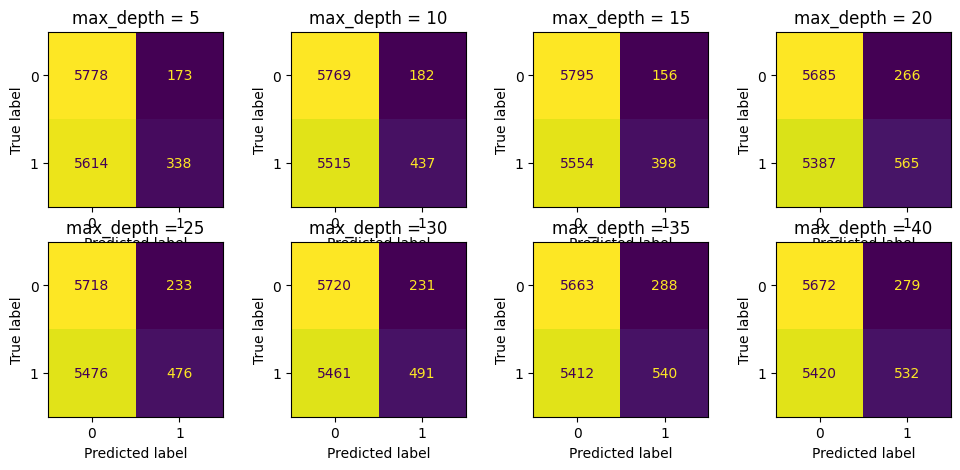

In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

cm_1 = confusion_matrix(y_test, DTC_pred[0])
cm_2 = confusion_matrix(y_test, DTC_pred[1])
cm_3 = confusion_matrix(y_test, DTC_pred[2])
cm_4 = confusion_matrix(y_test, DTC_pred[3])
cm_5 = confusion_matrix(y_test, DTC_pred[4])
cm_6 = confusion_matrix(y_test, DTC_pred[5])
cm_7 = confusion_matrix(y_test, DTC_pred[6])
cm_8 = confusion_matrix(y_test, DTC_pred[7])

fig, axes = plt.subplots(2, 4, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_depth = 5')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_depth = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_depth = 15')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_depth = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_depth = 25')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_depth = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_depth = 35')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_depth = 40')

####Logistic Regression

In [ ]:
accuracy_LR = []
precision_LR = []
recall_LR = []
f1_LR = []
LR_pred = []
i = 10
while i<151:
  mod_dt = LogisticRegression(max_iter = i, random_state = 1)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  LR_pred.append(prediction)
  accuracy_LR.append(metrics.accuracy_score(prediction,y_test))
  precision_LR.append(metrics.precision_score(prediction,y_test))
  recall_LR.append(metrics.recall_score(prediction,y_test))
  f1_LR.append(metrics.f1_score(prediction,y_test))
  i+= 10

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. OF ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. OF ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _c

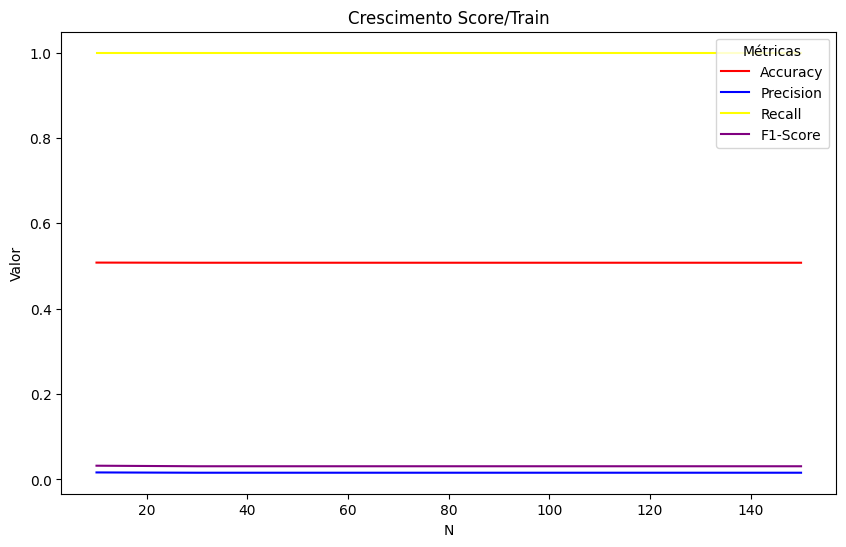

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [10,20,30,40,50,60,70,80,90,100,110,120,130,140,150]
data_l['accuracy'] = accuracy_LR
data_l['precision'] = precision_LR
data_l['recall'] = recall_LR
data_l['F1-score'] = f1_LR
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_iter = 150')

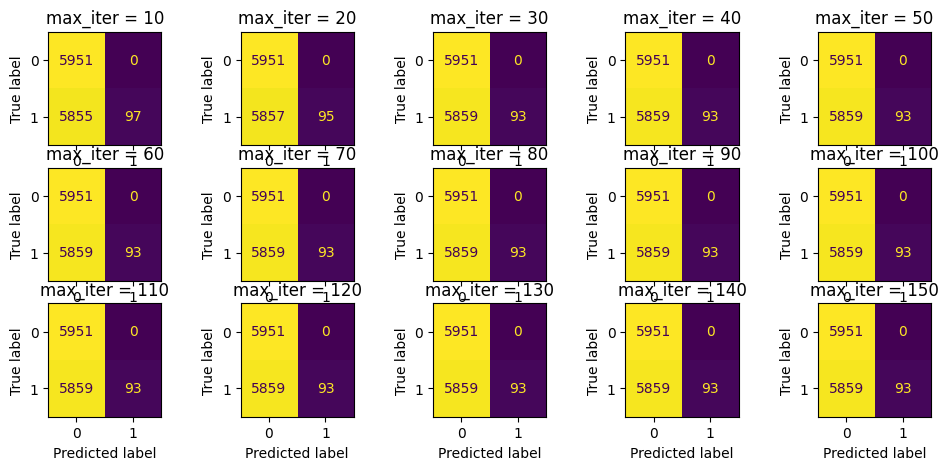

In [ ]:
cm_1 = confusion_matrix(y_test, LR_pred[0])
cm_2 = confusion_matrix(y_test, LR_pred[1])
cm_3 = confusion_matrix(y_test, LR_pred[2])
cm_4 = confusion_matrix(y_test, LR_pred[3])
cm_5 = confusion_matrix(y_test, LR_pred[4])
cm_6 = confusion_matrix(y_test, LR_pred[5])
cm_7 = confusion_matrix(y_test, LR_pred[6])
cm_8 = confusion_matrix(y_test, LR_pred[7])
cm_9 = confusion_matrix(y_test, LR_pred[8])
cm_10 = confusion_matrix(y_test, LR_pred[9])
cm_11 = confusion_matrix(y_test, LR_pred[10])
cm_12 = confusion_matrix(y_test, LR_pred[11])
cm_13 = confusion_matrix(y_test, LR_pred[12])
cm_14 = confusion_matrix(y_test, LR_pred[13])
cm_15 = confusion_matrix(y_test, LR_pred[14])

fig, axes = plt.subplots(3, 5, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_iter = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_iter = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_iter = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_iter = 40')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[0,4], colorbar=False)
axes[0,4].set_title('max_iter = 50')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_iter = 60')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_iter = 70')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_iter = 80')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_9)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_iter = 90')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_10)
disp_rfc.plot(ax=axes[1,4], colorbar=False)
axes[1,4].set_title('max_iter = 100')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_11)
disp_rfc.plot(ax=axes[2,0], colorbar=False)
axes[2,0].set_title('max_iter = 110')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_12)
disp_rfc.plot(ax=axes[2,1], colorbar=False)
axes[2,1].set_title('max_iter = 120')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_13)
disp_rfc.plot(ax=axes[2,2], colorbar=False)
axes[2,2].set_title('max_iter = 130')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_14)
disp_rfc.plot(ax=axes[2,3], colorbar=False)
axes[2,3].set_title('max_iter = 140')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_15)
disp_rfc.plot(ax=axes[2,4], colorbar=False)
axes[2,4].set_title('max_iter = 150')

####Linear Support Vector Classifier

In [ ]:
accuracy_LSVC = []
precision_LSVC = []
recall_LSVC = []
f1_LSVC = []
LSVC_pred = []
i = 10
while i<151:
  mod_dt = LinearSVC(max_iter = i, random_state = 42)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  LSVC_pred.append(prediction)
  accuracy_LSVC.append(metrics.accuracy_score(prediction,y_test))
  precision_LSVC.append(metrics.precision_score(prediction,y_test))
  recall_LSVC.append(metrics.recall_score(prediction,y_test))
  f1_LSVC.append(metrics.f1_score(prediction,y_test))
  i+= 10

/usr/local/lib/python3.11/dist-packages/sklearn/svm/_base.py:1249: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/svm/_base.py:1249: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/svm/_base.py:1249: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


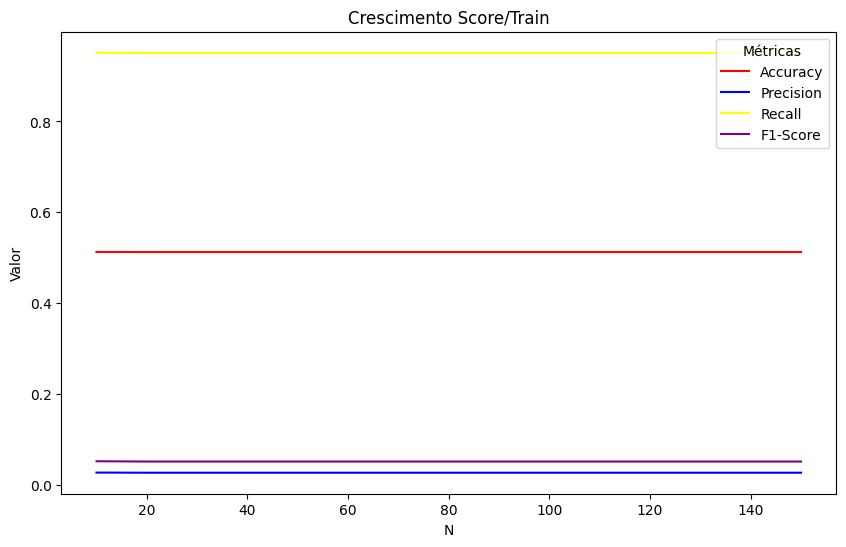

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [10,20,30,40,50,60,70,80,90,100,110,120,130,140,150]
data_l['accuracy'] = accuracy_LSVC
data_l['precision'] = precision_LSVC
data_l['recall'] = recall_LSVC
data_l['F1-score'] = f1_LSVC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_iter = 150')

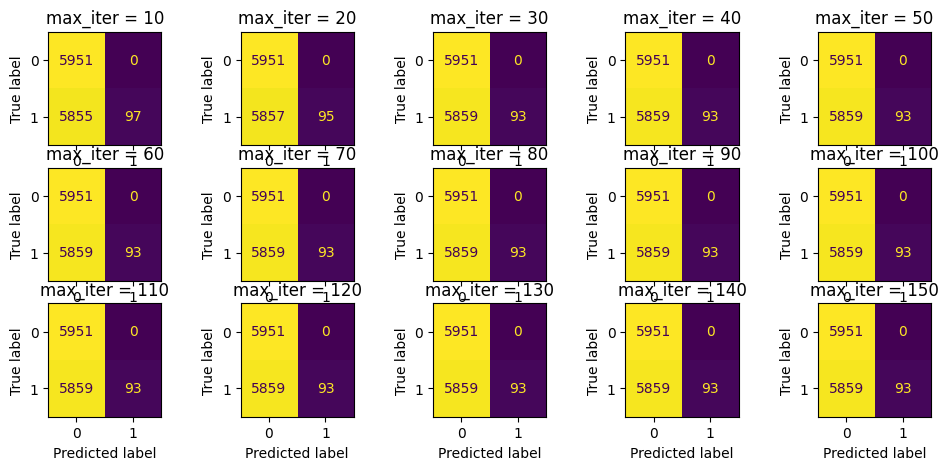

In [ ]:
cm_1 = confusion_matrix(y_test, LR_pred[0])
cm_2 = confusion_matrix(y_test, LR_pred[1])
cm_3 = confusion_matrix(y_test, LR_pred[2])
cm_4 = confusion_matrix(y_test, LR_pred[3])
cm_5 = confusion_matrix(y_test, LR_pred[4])
cm_6 = confusion_matrix(y_test, LR_pred[5])
cm_7 = confusion_matrix(y_test, LR_pred[6])
cm_8 = confusion_matrix(y_test, LR_pred[7])
cm_9 = confusion_matrix(y_test, LR_pred[8])
cm_10 = confusion_matrix(y_test, LR_pred[9])
cm_11 = confusion_matrix(y_test, LR_pred[10])
cm_12 = confusion_matrix(y_test, LR_pred[11])
cm_13 = confusion_matrix(y_test, LR_pred[12])
cm_14 = confusion_matrix(y_test, LR_pred[13])
cm_15 = confusion_matrix(y_test, LR_pred[14])

fig, axes = plt.subplots(3, 5, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_iter = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_iter = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_iter = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_iter = 40')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[0,4], colorbar=False)
axes[0,4].set_title('max_iter = 50')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_iter = 60')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_iter = 70')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_iter = 80')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_9)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_iter = 90')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_10)
disp_rfc.plot(ax=axes[1,4], colorbar=False)
axes[1,4].set_title('max_iter = 100')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_11)
disp_rfc.plot(ax=axes[2,0], colorbar=False)
axes[2,0].set_title('max_iter = 110')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_12)
disp_rfc.plot(ax=axes[2,1], colorbar=False)
axes[2,1].set_title('max_iter = 120')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_13)
disp_rfc.plot(ax=axes[2,2], colorbar=False)
axes[2,2].set_title('max_iter = 130')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_14)
disp_rfc.plot(ax=axes[2,3], colorbar=False)
axes[2,3].set_title('max_iter = 140')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_15)
disp_rfc.plot(ax=axes[2,4], colorbar=False)
axes[2,4].set_title('max_iter = 150')

#### Passive Agressive Classifier

In [ ]:
accuracy_PAC = []
precision_PAC = []
recall_PAC = []
f1_PAC = []
PAC_pred = []
i = 5
while i<41:
  mod_dt = PassiveAggressiveClassifier(max_iter=i, random_state=42)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  PAC_pred.append(prediction)
  accuracy_PAC.append(metrics.accuracy_score(prediction,y_test))
  precision_PAC.append(metrics.precision_score(prediction,y_test))
  recall_PAC.append(metrics.recall_score(prediction,y_test))
  f1_PAC.append(metrics.f1_score(prediction,y_test))
  i+= 5

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:738: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:738: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(


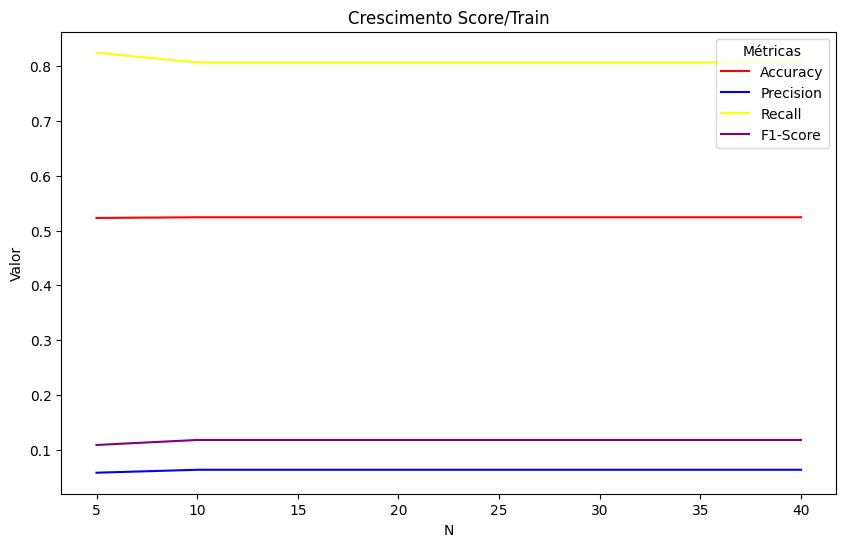

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [5,10,15,20,25,30,35,40]
data_l['accuracy'] = accuracy_PAC
data_l['precision'] = precision_PAC
data_l['recall'] = recall_PAC
data_l['F1-score'] = f1_PAC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_depth = 40')

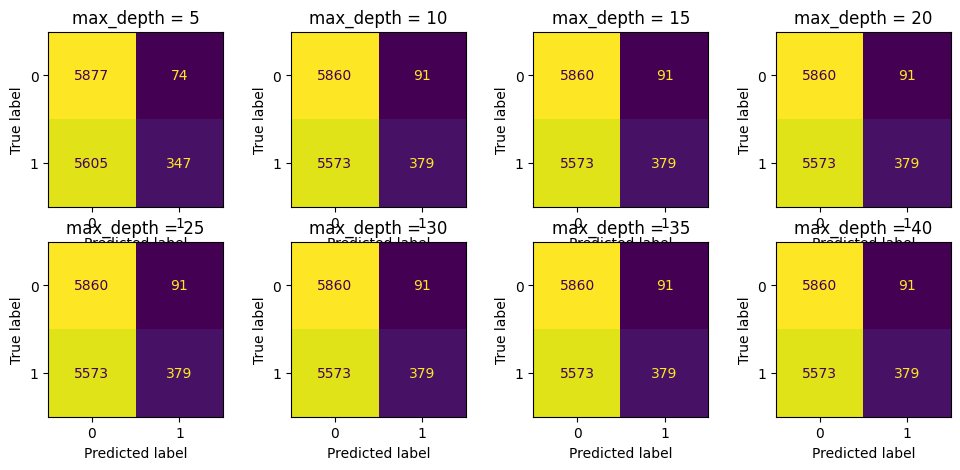

In [ ]:
cm_1 = confusion_matrix(y_test, PAC_pred[0])
cm_2 = confusion_matrix(y_test, PAC_pred[1])
cm_3 = confusion_matrix(y_test, PAC_pred[2])
cm_4 = confusion_matrix(y_test, PAC_pred[3])
cm_5 = confusion_matrix(y_test, PAC_pred[4])
cm_6 = confusion_matrix(y_test, PAC_pred[5])
cm_7 = confusion_matrix(y_test, PAC_pred[6])
cm_8 = confusion_matrix(y_test, PAC_pred[7])

fig, axes = plt.subplots(2, 4, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_depth = 5')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_depth = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_depth = 15')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_depth = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_depth = 25')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_depth = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_depth = 35')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_depth = 40')

###Word2Vec

In [ ]:
# 1. Pré-processamento
fakebr_textos = [str(t).split() for t in df_fakebr_c['texto_corrigido']]
fakerecogna_textos = [str(t).split() for t in df_fakerecogna_c['texto_corrigido']]

# 2. Treinar Word2Vec SOMENTE com fake.br
w2v_model = Word2Vec(sentences=fakebr_textos, vector_size=100, window=5, min_count=1)

# 3. Função para vetorizar texto
def vetor_medio(texto, modelo):
    vetores = [modelo.wv[word] for word in texto if word in modelo.wv]
    return np.mean(vetores, axis=0) if vetores else np.zeros(modelo.vector_size)

# 4. Vetorização
x_train = np.array([vetor_medio(t, w2v_model) for t in fakebr_textos])
y_train = df_fakebr_c['classificação'].apply(lambda x: 1 if 'true' in x else 0)

x_test = np.array([vetor_medio(t, w2v_model) for t in fakerecogna_textos])
y_test = df_fakerecogna_c['classificação'].apply(lambda x: 1 if 'true' in x else 0)

#### RFC

In [ ]:
accuracy_RFC = []
precision_RFC = []
recall_RFC = []
f1_RFC = []
score = []
RFC_pred = []
i = 5
while i<41:
  forest=RandomForestClassifier(max_depth = i,random_state=45)
  forest.fit(x_train,y_train)
  prediction=forest.predict(x_test)
  RFC_pred.append(prediction)
  accuracy_RFC.append(metrics.accuracy_score(prediction,y_test))
  precision_RFC.append(metrics.precision_score(prediction,y_test))
  recall_RFC.append(metrics.recall_score(prediction,y_test))
  f1_RFC.append(metrics.f1_score(prediction,y_test))
  i+= 5

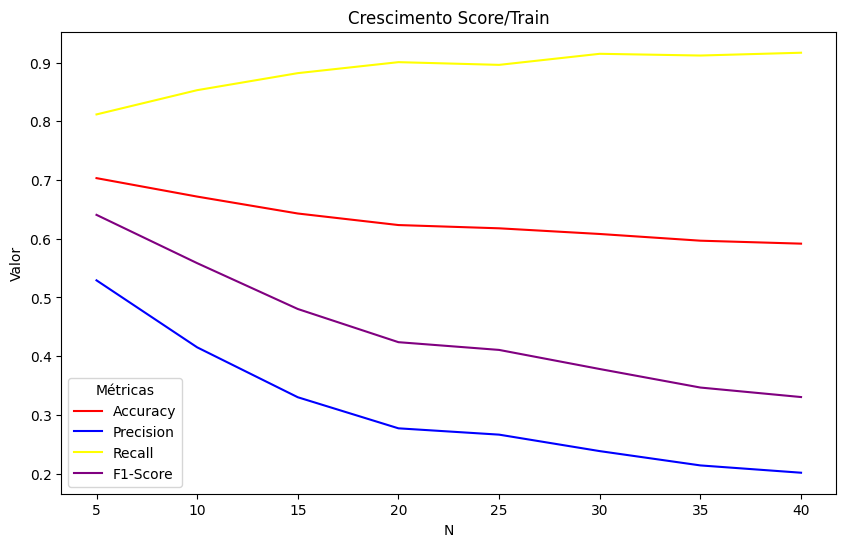

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [5,10,15,20,25,30,35,40]
data_l['accuracy'] = accuracy_RFC
data_l['precision'] = precision_RFC
data_l['recall'] = recall_RFC
data_l['F1-score'] = f1_RFC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_depth = 40')

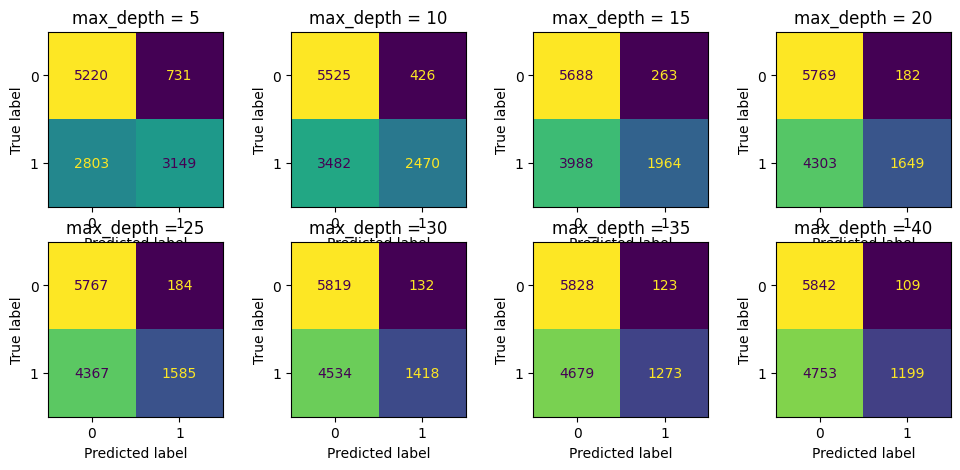

In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

cm_1 = confusion_matrix(y_test, RFC_pred[0])
cm_2 = confusion_matrix(y_test, RFC_pred[1])
cm_3 = confusion_matrix(y_test, RFC_pred[2])
cm_4 = confusion_matrix(y_test, RFC_pred[3])
cm_5 = confusion_matrix(y_test, RFC_pred[4])
cm_6 = confusion_matrix(y_test, RFC_pred[5])
cm_7 = confusion_matrix(y_test, RFC_pred[6])
cm_8 = confusion_matrix(y_test, RFC_pred[7])

fig, axes = plt.subplots(2, 4, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_depth = 5')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_depth = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_depth = 15')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_depth = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_depth = 25')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_depth = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_depth = 35')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_depth = 40')

#### DTC

In [ ]:
accuracy_DTC = []
precision_DTC = []
recall_DTC = []
f1_DTC = []
DTC_pred = []
i = 5
while i<41:
  mod_dt = DecisionTreeClassifier(max_depth = i, random_state = 1)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  DTC_pred.append(prediction)
  accuracy_DTC.append(metrics.accuracy_score(prediction,y_test))
  precision_DTC.append(metrics.precision_score(prediction,y_test))
  recall_DTC.append(metrics.recall_score(prediction,y_test))
  f1_DTC.append(metrics.f1_score(prediction,y_test))
  i+= 5

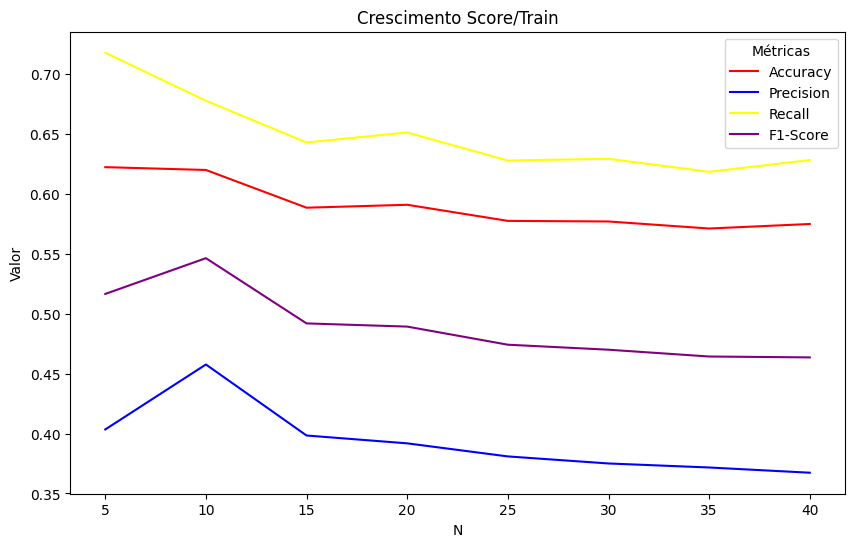

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [5,10,15,20,25,30,35,40]
data_l['accuracy'] = accuracy_DTC
data_l['precision'] = precision_DTC
data_l['recall'] = recall_DTC
data_l['F1-score'] = f1_DTC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_depth = 40')

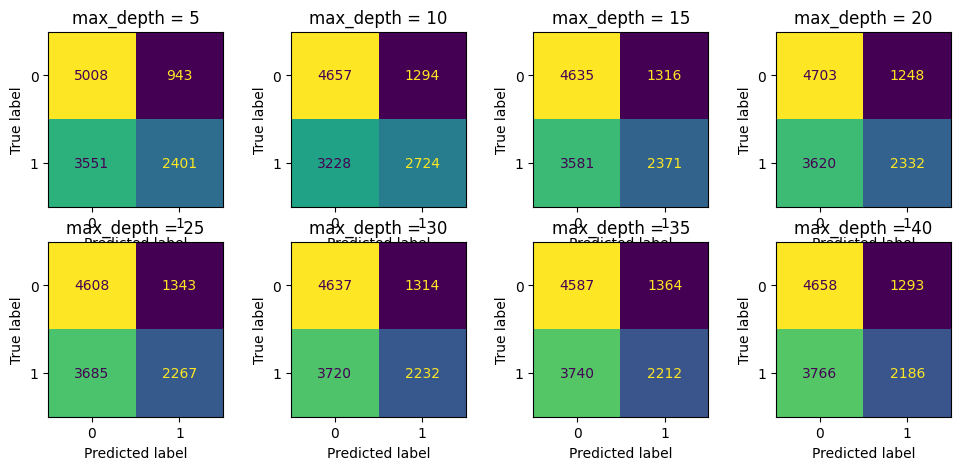

In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

cm_1 = confusion_matrix(y_test, DTC_pred[0])
cm_2 = confusion_matrix(y_test, DTC_pred[1])
cm_3 = confusion_matrix(y_test, DTC_pred[2])
cm_4 = confusion_matrix(y_test, DTC_pred[3])
cm_5 = confusion_matrix(y_test, DTC_pred[4])
cm_6 = confusion_matrix(y_test, DTC_pred[5])
cm_7 = confusion_matrix(y_test, DTC_pred[6])
cm_8 = confusion_matrix(y_test, DTC_pred[7])

fig, axes = plt.subplots(2, 4, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_depth = 5')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_depth = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_depth = 15')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_depth = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_depth = 25')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_depth = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_depth = 35')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_depth = 40')

#### Logistic Regression


In [ ]:
accuracy_LR = []
precision_LR = []
recall_LR = []
f1_LR = []
LR_pred = []
i = 10
while i<151:
  mod_dt = LogisticRegression(max_iter = i, random_state = 1)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  LR_pred.append(prediction)
  accuracy_LR.append(metrics.accuracy_score(prediction,y_test))
  precision_LR.append(metrics.precision_score(prediction,y_test))
  recall_LR.append(metrics.recall_score(prediction,y_test))
  f1_LR.append(metrics.f1_score(prediction,y_test))
  i+= 10

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _c

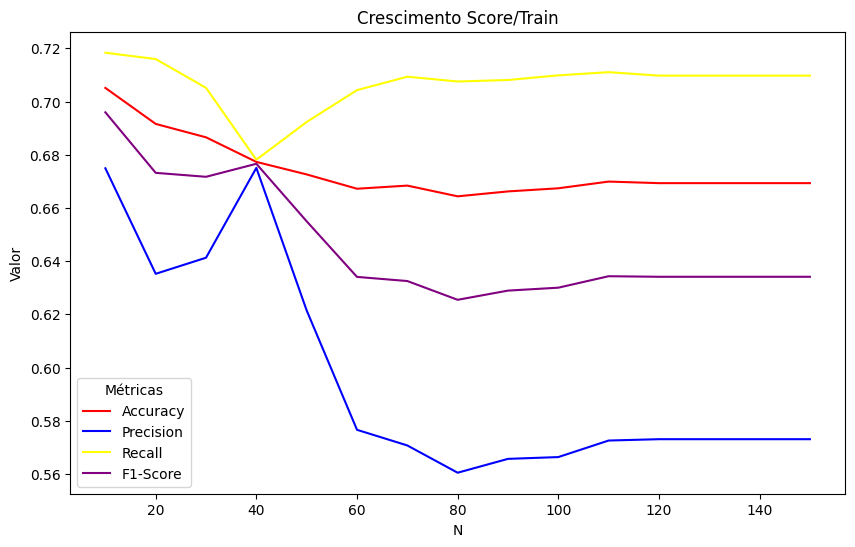

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [10,20,30,40,50,60,70,80,90,100,110,120,130,140,150]
data_l['accuracy'] = accuracy_LR
data_l['precision'] = precision_LR
data_l['recall'] = recall_LR
data_l['F1-score'] = f1_LR
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_iter = 150')

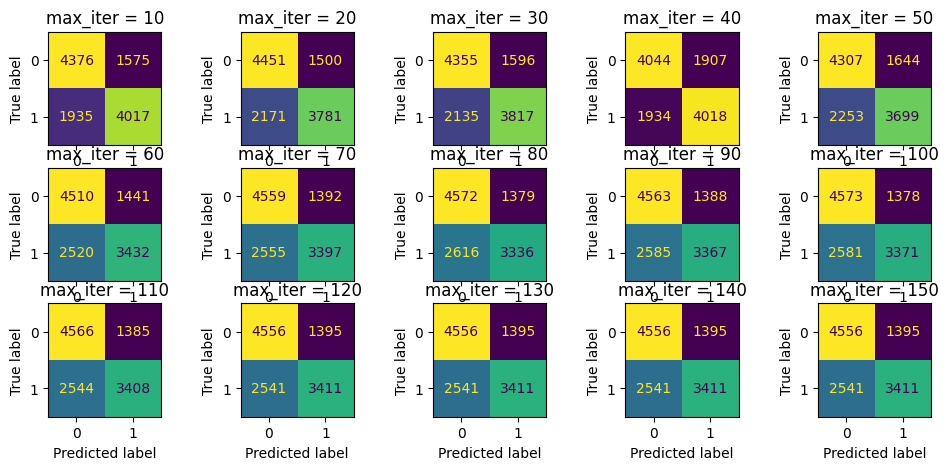

In [ ]:
cm_1 = confusion_matrix(y_test, LR_pred[0])
cm_2 = confusion_matrix(y_test, LR_pred[1])
cm_3 = confusion_matrix(y_test, LR_pred[2])
cm_4 = confusion_matrix(y_test, LR_pred[3])
cm_5 = confusion_matrix(y_test, LR_pred[4])
cm_6 = confusion_matrix(y_test, LR_pred[5])
cm_7 = confusion_matrix(y_test, LR_pred[6])
cm_8 = confusion_matrix(y_test, LR_pred[7])
cm_9 = confusion_matrix(y_test, LR_pred[8])
cm_10 = confusion_matrix(y_test, LR_pred[9])
cm_11 = confusion_matrix(y_test, LR_pred[10])
cm_12 = confusion_matrix(y_test, LR_pred[11])
cm_13 = confusion_matrix(y_test, LR_pred[12])
cm_14 = confusion_matrix(y_test, LR_pred[13])
cm_15 = confusion_matrix(y_test, LR_pred[14])

fig, axes = plt.subplots(3, 5, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_iter = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_iter = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_iter = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_iter = 40')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[0,4], colorbar=False)
axes[0,4].set_title('max_iter = 50')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_iter = 60')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_iter = 70')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_iter = 80')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_9)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_iter = 90')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_10)
disp_rfc.plot(ax=axes[1,4], colorbar=False)
axes[1,4].set_title('max_iter = 100')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_11)
disp_rfc.plot(ax=axes[2,0], colorbar=False)
axes[2,0].set_title('max_iter = 110')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_12)
disp_rfc.plot(ax=axes[2,1], colorbar=False)
axes[2,1].set_title('max_iter = 120')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_13)
disp_rfc.plot(ax=axes[2,2], colorbar=False)
axes[2,2].set_title('max_iter = 130')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_14)
disp_rfc.plot(ax=axes[2,3], colorbar=False)
axes[2,3].set_title('max_iter = 140')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_15)
disp_rfc.plot(ax=axes[2,4], colorbar=False)
axes[2,4].set_title('max_iter = 150')

#### Linear Support Vector Classifier


In [ ]:
accuracy_LSVC = []
precision_LSVC = []
recall_LSVC = []
f1_LSVC = []
LSVC_pred = []
i = 10
while i<151:
  mod_dt = LinearSVC(max_iter = i, random_state = 42)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  LSVC_pred.append(prediction)
  accuracy_LSVC.append(metrics.accuracy_score(prediction,y_test))
  precision_LSVC.append(metrics.precision_score(prediction,y_test))
  recall_LSVC.append(metrics.recall_score(prediction,y_test))
  f1_LSVC.append(metrics.f1_score(prediction,y_test))
  i+= 10

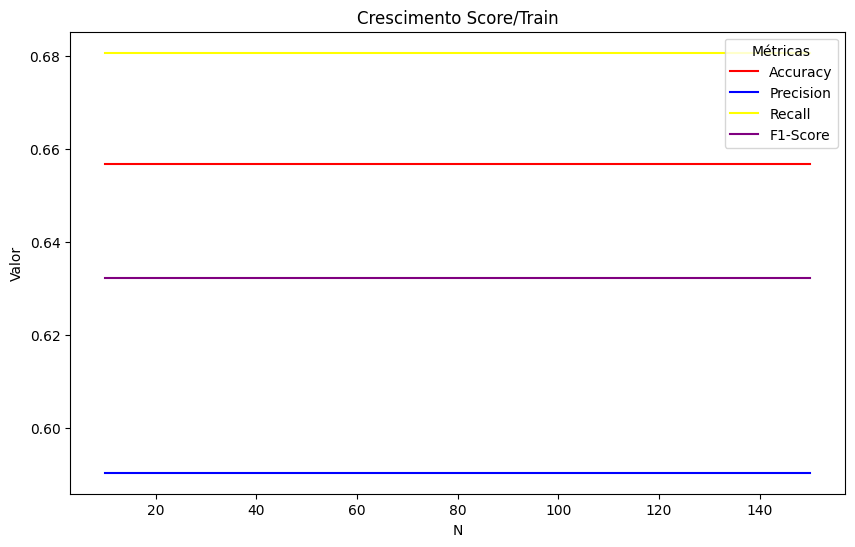

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [10,20,30,40,50,60,70,80,90,100,110,120,130,140,150]
data_l['accuracy'] = accuracy_LSVC
data_l['precision'] = precision_LSVC
data_l['recall'] = recall_LSVC
data_l['F1-score'] = f1_LSVC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_iter = 150')

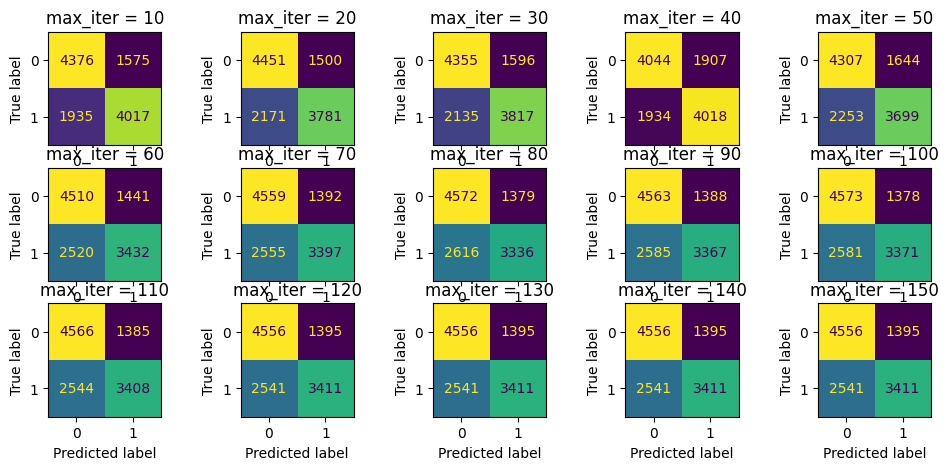

In [ ]:
cm_1 = confusion_matrix(y_test, LR_pred[0])
cm_2 = confusion_matrix(y_test, LR_pred[1])
cm_3 = confusion_matrix(y_test, LR_pred[2])
cm_4 = confusion_matrix(y_test, LR_pred[3])
cm_5 = confusion_matrix(y_test, LR_pred[4])
cm_6 = confusion_matrix(y_test, LR_pred[5])
cm_7 = confusion_matrix(y_test, LR_pred[6])
cm_8 = confusion_matrix(y_test, LR_pred[7])
cm_9 = confusion_matrix(y_test, LR_pred[8])
cm_10 = confusion_matrix(y_test, LR_pred[9])
cm_11 = confusion_matrix(y_test, LR_pred[10])
cm_12 = confusion_matrix(y_test, LR_pred[11])
cm_13 = confusion_matrix(y_test, LR_pred[12])
cm_14 = confusion_matrix(y_test, LR_pred[13])
cm_15 = confusion_matrix(y_test, LR_pred[14])

fig, axes = plt.subplots(3, 5, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_iter = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_iter = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_iter = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_iter = 40')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[0,4], colorbar=False)
axes[0,4].set_title('max_iter = 50')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_iter = 60')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_iter = 70')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_iter = 80')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_9)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_iter = 90')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_10)
disp_rfc.plot(ax=axes[1,4], colorbar=False)
axes[1,4].set_title('max_iter = 100')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_11)
disp_rfc.plot(ax=axes[2,0], colorbar=False)
axes[2,0].set_title('max_iter = 110')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_12)
disp_rfc.plot(ax=axes[2,1], colorbar=False)
axes[2,1].set_title('max_iter = 120')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_13)
disp_rfc.plot(ax=axes[2,2], colorbar=False)
axes[2,2].set_title('max_iter = 130')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_14)
disp_rfc.plot(ax=axes[2,3], colorbar=False)
axes[2,3].set_title('max_iter = 140')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_15)
disp_rfc.plot(ax=axes[2,4], colorbar=False)
axes[2,4].set_title('max_iter = 150')

#### Passive Aggressive Classifier


In [ ]:
accuracy_PAC = []
precision_PAC = []
recall_PAC = []
f1_PAC = []
PAC_pred = []
i = 5
while i<41:
  mod_dt = PassiveAggressiveClassifier(max_iter=i, random_state=42)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  PAC_pred.append(prediction)
  accuracy_PAC.append(metrics.accuracy_score(prediction,y_test))
  precision_PAC.append(metrics.precision_score(prediction,y_test))
  recall_PAC.append(metrics.recall_score(prediction,y_test))
  f1_PAC.append(metrics.f1_score(prediction,y_test))
  i+= 5

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:738: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:738: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:738: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(


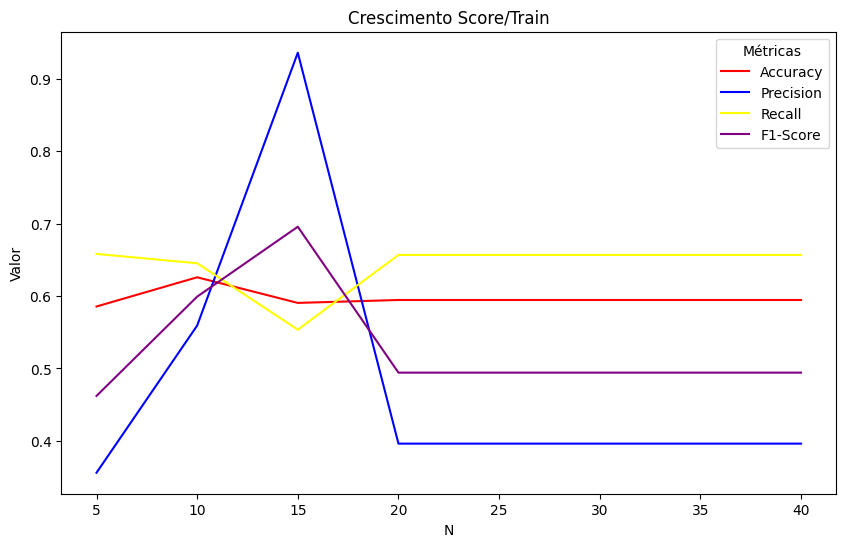

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [5,10,15,20,25,30,35,40]
data_l['accuracy'] = accuracy_PAC
data_l['precision'] = precision_PAC
data_l['recall'] = recall_PAC
data_l['F1-score'] = f1_PAC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_depth = 40')

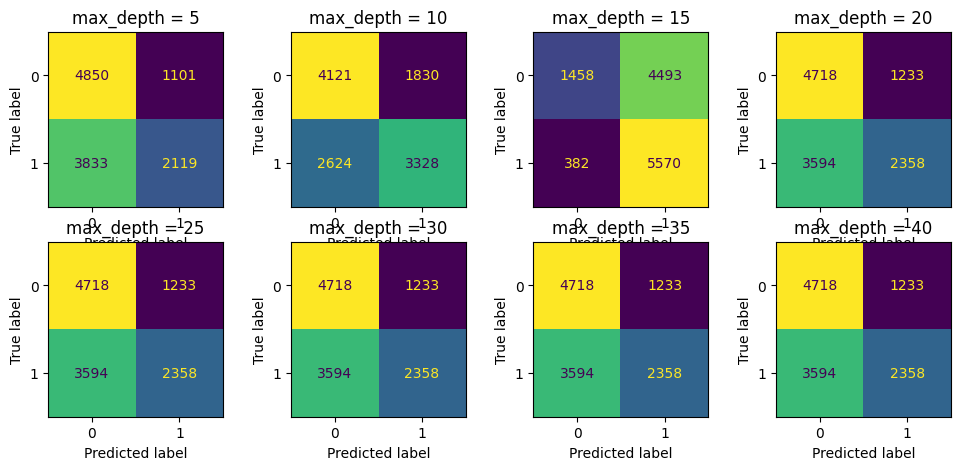

In [ ]:
cm_1 = confusion_matrix(y_test, PAC_pred[0])
cm_2 = confusion_matrix(y_test, PAC_pred[1])
cm_3 = confusion_matrix(y_test, PAC_pred[2])
cm_4 = confusion_matrix(y_test, PAC_pred[3])
cm_5 = confusion_matrix(y_test, PAC_pred[4])
cm_6 = confusion_matrix(y_test, PAC_pred[5])
cm_7 = confusion_matrix(y_test, PAC_pred[6])
cm_8 = confusion_matrix(y_test, PAC_pred[7])

fig, axes = plt.subplots(2, 4, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_depth = 5')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_depth = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_depth = 15')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_depth = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_depth = 25')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_depth = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_depth = 35')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_depth = 40')

###BERT

In [ ]:
from transformers import BertTokenizer, BertModel
import torch
import numpy as np
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report

# 1. Carregar BERT
tokenizer = BertTokenizer.from_pretrained('neuralmind/bert-base-portuguese-cased')
model = BertModel.from_pretrained('neuralmind/bert-base-portuguese-cased')
model.eval()

# 2. Função para extrair vetor da [CLS]
def get_bert_vector(texto):
    inputs = tokenizer(texto, return_tensors="pt", truncation=True, padding='max_length', max_length=128)
    with torch.no_grad():
        outputs = model(**inputs)
    return outputs.last_hidden_state[:, 0, :].squeeze().numpy()

# 3. Aplicar aos dados
textos_train = df_fakebr_c['texto_corrigido'].astype(str)
textos_test = df_fakerecogna_c['texto_corrigido'].astype(str)

x_train = np.array([get_bert_vector(t) for t in textos_train])
y_train = df_fakebr_c['classificação'].apply(lambda x: 1 if 'true' in x else 0)

x_test = np.array([get_bert_vector(t) for t in textos_test])
y_test = df_fakerecogna_c['classificação'].apply(lambda x: 1 if 'true' in x else 0)

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


tokenizer_config.json:   0%|          | 0.00/43.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/210k [00:00<?, ?B/s]

added_tokens.json:   0%|          | 0.00/2.00 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/112 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/647 [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/438M [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/438M [00:00<?, ?B/s]

#### RFC

In [ ]:
accuracy_RFC = []
precision_RFC = []
recall_RFC = []
f1_RFC = []
score = []
RFC_pred = []
i = 5
while i<41:
  forest=RandomForestClassifier(max_depth = i,random_state=45)
  forest.fit(x_train,y_train)
  prediction=forest.predict(x_test)
  RFC_pred.append(prediction)
  accuracy_RFC.append(metrics.accuracy_score(prediction,y_test))
  precision_RFC.append(metrics.precision_score(prediction,y_test))
  recall_RFC.append(metrics.recall_score(prediction,y_test))
  f1_RFC.append(metrics.f1_score(prediction,y_test))
  i+= 5

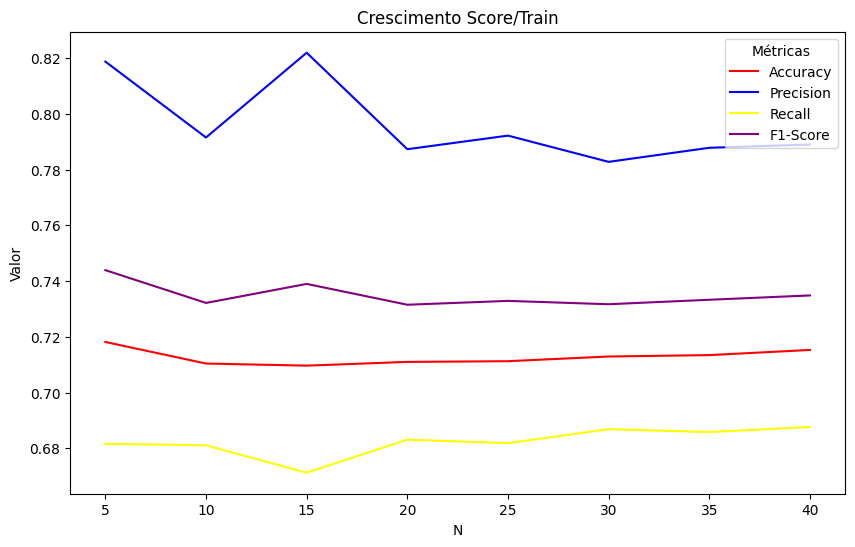

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [5,10,15,20,25,30,35,40]
data_l['accuracy'] = accuracy_RFC
data_l['precision'] = precision_RFC
data_l['recall'] = recall_RFC
data_l['F1-score'] = f1_RFC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_depth = 40')

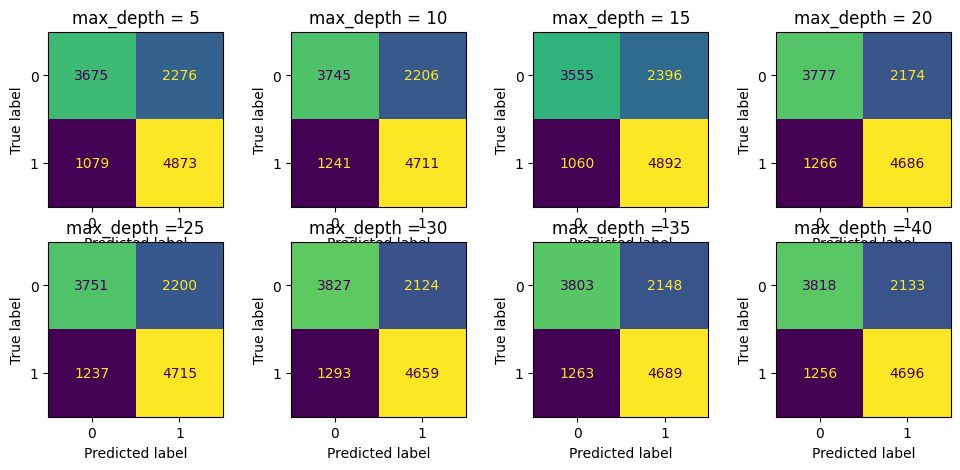

In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

cm_1 = confusion_matrix(y_test, RFC_pred[0])
cm_2 = confusion_matrix(y_test, RFC_pred[1])
cm_3 = confusion_matrix(y_test, RFC_pred[2])
cm_4 = confusion_matrix(y_test, RFC_pred[3])
cm_5 = confusion_matrix(y_test, RFC_pred[4])
cm_6 = confusion_matrix(y_test, RFC_pred[5])
cm_7 = confusion_matrix(y_test, RFC_pred[6])
cm_8 = confusion_matrix(y_test, RFC_pred[7])

fig, axes = plt.subplots(2, 4, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_depth = 5')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_depth = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_depth = 15')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_depth = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_depth = 25')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_depth = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_depth = 35')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_depth = 40')

#### DTC

In [ ]:
accuracy_DTC = []
precision_DTC = []
recall_DTC = []
f1_DTC = []
DTC_pred = []
i = 5
while i<41:
  mod_dt = DecisionTreeClassifier(max_depth = i, random_state = 1)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  DTC_pred.append(prediction)
  accuracy_DTC.append(metrics.accuracy_score(prediction,y_test))
  precision_DTC.append(metrics.precision_score(prediction,y_test))
  recall_DTC.append(metrics.recall_score(prediction,y_test))
  f1_DTC.append(metrics.f1_score(prediction,y_test))
  i+= 5

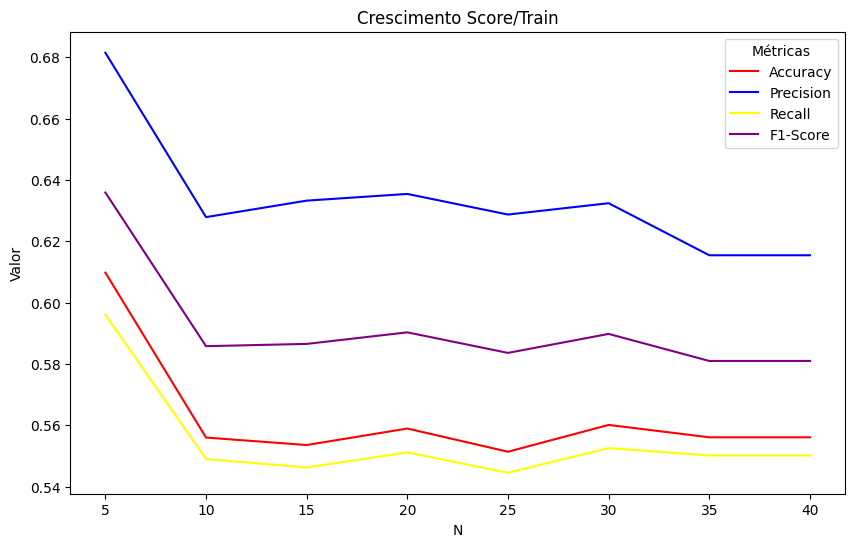

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [5,10,15,20,25,30,35,40]
data_l['accuracy'] = accuracy_DTC
data_l['precision'] = precision_DTC
data_l['recall'] = recall_DTC
data_l['F1-score'] = f1_DTC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_depth = 40')

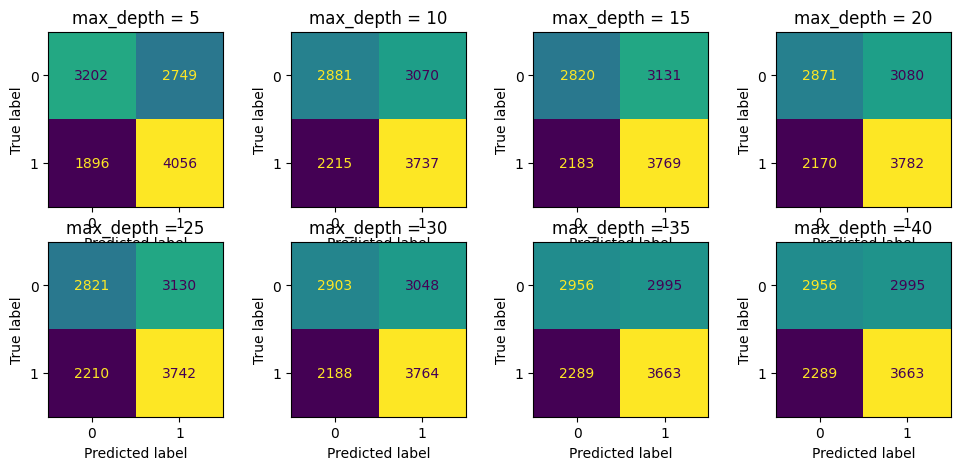

In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

cm_1 = confusion_matrix(y_test, DTC_pred[0])
cm_2 = confusion_matrix(y_test, DTC_pred[1])
cm_3 = confusion_matrix(y_test, DTC_pred[2])
cm_4 = confusion_matrix(y_test, DTC_pred[3])
cm_5 = confusion_matrix(y_test, DTC_pred[4])
cm_6 = confusion_matrix(y_test, DTC_pred[5])
cm_7 = confusion_matrix(y_test, DTC_pred[6])
cm_8 = confusion_matrix(y_test, DTC_pred[7])

fig, axes = plt.subplots(2, 4, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_depth = 5')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_depth = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_depth = 15')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_depth = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_depth = 25')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_depth = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_depth = 35')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_depth = 40')

#### Logistic Regression


In [ ]:
accuracy_LR = []
precision_LR = []
recall_LR = []
f1_LR = []
LR_pred = []
i = 10
while i<151:
  mod_dt = LogisticRegression(max_iter = i, random_state = 1)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  LR_pred.append(prediction)
  accuracy_LR.append(metrics.accuracy_score(prediction,y_test))
  precision_LR.append(metrics.precision_score(prediction,y_test))
  recall_LR.append(metrics.recall_score(prediction,y_test))
  f1_LR.append(metrics.f1_score(prediction,y_test))
  i+= 10

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _c

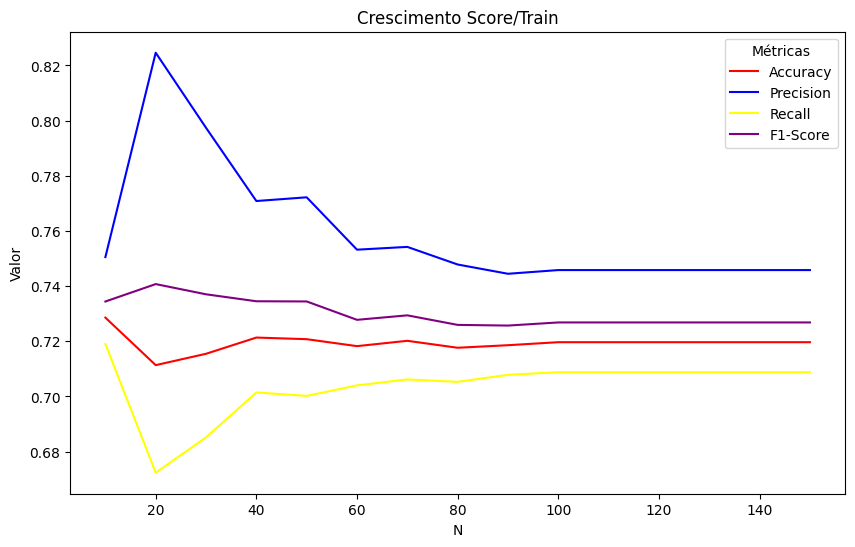

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [10,20,30,40,50,60,70,80,90,100,110,120,130,140,150]
data_l['accuracy'] = accuracy_LR
data_l['precision'] = precision_LR
data_l['recall'] = recall_LR
data_l['F1-score'] = f1_LR
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_iter = 150')

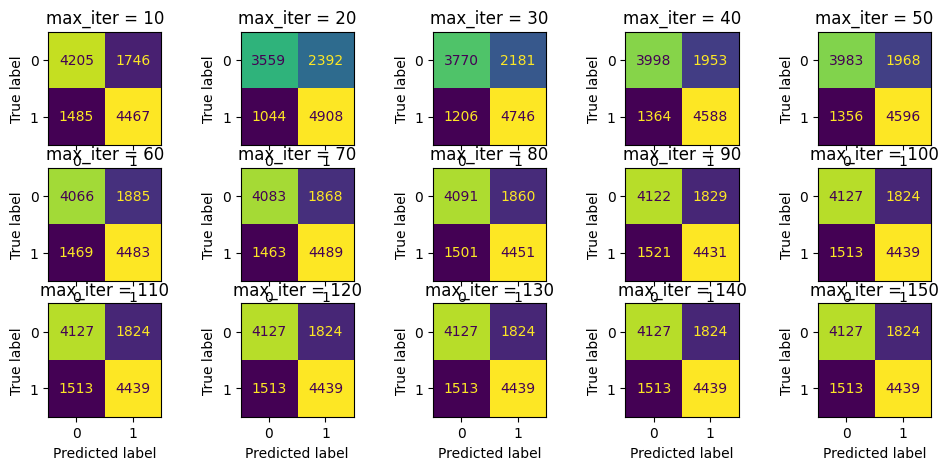

In [ ]:
cm_1 = confusion_matrix(y_test, LR_pred[0])
cm_2 = confusion_matrix(y_test, LR_pred[1])
cm_3 = confusion_matrix(y_test, LR_pred[2])
cm_4 = confusion_matrix(y_test, LR_pred[3])
cm_5 = confusion_matrix(y_test, LR_pred[4])
cm_6 = confusion_matrix(y_test, LR_pred[5])
cm_7 = confusion_matrix(y_test, LR_pred[6])
cm_8 = confusion_matrix(y_test, LR_pred[7])
cm_9 = confusion_matrix(y_test, LR_pred[8])
cm_10 = confusion_matrix(y_test, LR_pred[9])
cm_11 = confusion_matrix(y_test, LR_pred[10])
cm_12 = confusion_matrix(y_test, LR_pred[11])
cm_13 = confusion_matrix(y_test, LR_pred[12])
cm_14 = confusion_matrix(y_test, LR_pred[13])
cm_15 = confusion_matrix(y_test, LR_pred[14])

fig, axes = plt.subplots(3, 5, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_iter = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_iter = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_iter = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_iter = 40')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[0,4], colorbar=False)
axes[0,4].set_title('max_iter = 50')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_iter = 60')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_iter = 70')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_iter = 80')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_9)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_iter = 90')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_10)
disp_rfc.plot(ax=axes[1,4], colorbar=False)
axes[1,4].set_title('max_iter = 100')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_11)
disp_rfc.plot(ax=axes[2,0], colorbar=False)
axes[2,0].set_title('max_iter = 110')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_12)
disp_rfc.plot(ax=axes[2,1], colorbar=False)
axes[2,1].set_title('max_iter = 120')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_13)
disp_rfc.plot(ax=axes[2,2], colorbar=False)
axes[2,2].set_title('max_iter = 130')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_14)
disp_rfc.plot(ax=axes[2,3], colorbar=False)
axes[2,3].set_title('max_iter = 140')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_15)
disp_rfc.plot(ax=axes[2,4], colorbar=False)
axes[2,4].set_title('max_iter = 150')

#### Linear Support Vector Classifier


In [ ]:
accuracy_LSVC = []
precision_LSVC = []
recall_LSVC = []
f1_LSVC = []
LSVC_pred = []
i = 10
while i<151:
  mod_dt = LinearSVC(max_iter = i, random_state = 42)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  LSVC_pred.append(prediction)
  accuracy_LSVC.append(metrics.accuracy_score(prediction,y_test))
  precision_LSVC.append(metrics.precision_score(prediction,y_test))
  recall_LSVC.append(metrics.recall_score(prediction,y_test))
  f1_LSVC.append(metrics.f1_score(prediction,y_test))
  i+= 10

/usr/local/lib/python3.11/dist-packages/sklearn/svm/_base.py:1249: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


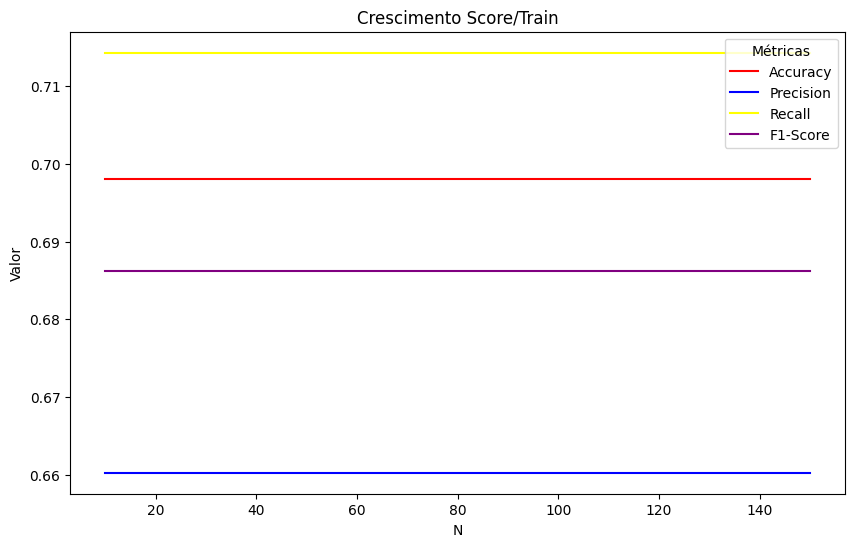

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [10,20,30,40,50,60,70,80,90,100,110,120,130,140,150]
data_l['accuracy'] = accuracy_LSVC
data_l['precision'] = precision_LSVC
data_l['recall'] = recall_LSVC
data_l['F1-score'] = f1_LSVC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_iter = 150')

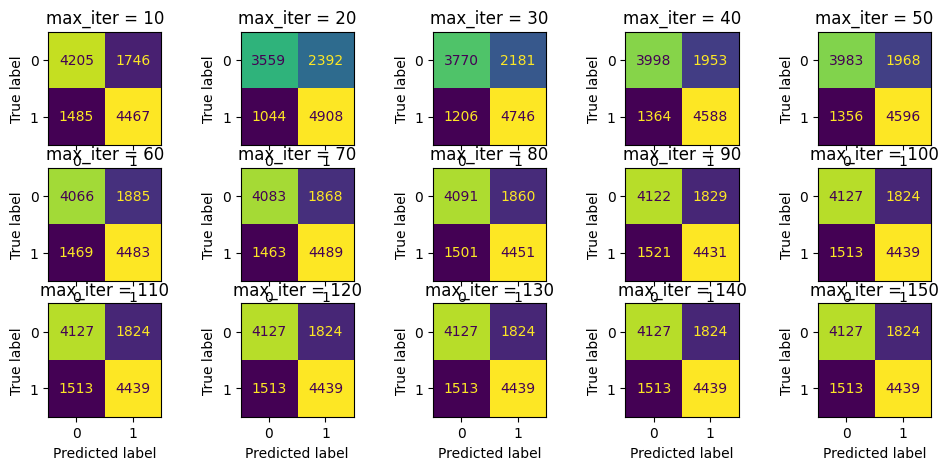

In [ ]:
cm_1 = confusion_matrix(y_test, LR_pred[0])
cm_2 = confusion_matrix(y_test, LR_pred[1])
cm_3 = confusion_matrix(y_test, LR_pred[2])
cm_4 = confusion_matrix(y_test, LR_pred[3])
cm_5 = confusion_matrix(y_test, LR_pred[4])
cm_6 = confusion_matrix(y_test, LR_pred[5])
cm_7 = confusion_matrix(y_test, LR_pred[6])
cm_8 = confusion_matrix(y_test, LR_pred[7])
cm_9 = confusion_matrix(y_test, LR_pred[8])
cm_10 = confusion_matrix(y_test, LR_pred[9])
cm_11 = confusion_matrix(y_test, LR_pred[10])
cm_12 = confusion_matrix(y_test, LR_pred[11])
cm_13 = confusion_matrix(y_test, LR_pred[12])
cm_14 = confusion_matrix(y_test, LR_pred[13])
cm_15 = confusion_matrix(y_test, LR_pred[14])

fig, axes = plt.subplots(3, 5, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_iter = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_iter = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_iter = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_iter = 40')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[0,4], colorbar=False)
axes[0,4].set_title('max_iter = 50')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_iter = 60')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_iter = 70')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_iter = 80')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_9)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_iter = 90')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_10)
disp_rfc.plot(ax=axes[1,4], colorbar=False)
axes[1,4].set_title('max_iter = 100')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_11)
disp_rfc.plot(ax=axes[2,0], colorbar=False)
axes[2,0].set_title('max_iter = 110')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_12)
disp_rfc.plot(ax=axes[2,1], colorbar=False)
axes[2,1].set_title('max_iter = 120')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_13)
disp_rfc.plot(ax=axes[2,2], colorbar=False)
axes[2,2].set_title('max_iter = 130')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_14)
disp_rfc.plot(ax=axes[2,3], colorbar=False)
axes[2,3].set_title('max_iter = 140')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_15)
disp_rfc.plot(ax=axes[2,4], colorbar=False)
axes[2,4].set_title('max_iter = 150')

#### Passive Aggressive Classifier


In [ ]:
accuracy_PAC = []
precision_PAC = []
recall_PAC = []
f1_PAC = []
PAC_pred = []
i = 5
while i<41:
  mod_dt = PassiveAggressiveClassifier(max_iter=i, random_state=42)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  PAC_pred.append(prediction)
  accuracy_PAC.append(metrics.accuracy_score(prediction,y_test))
  precision_PAC.append(metrics.precision_score(prediction,y_test))
  recall_PAC.append(metrics.recall_score(prediction,y_test))
  f1_PAC.append(metrics.f1_score(prediction,y_test))
  i+= 5

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:738: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:738: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:738: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:738: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic

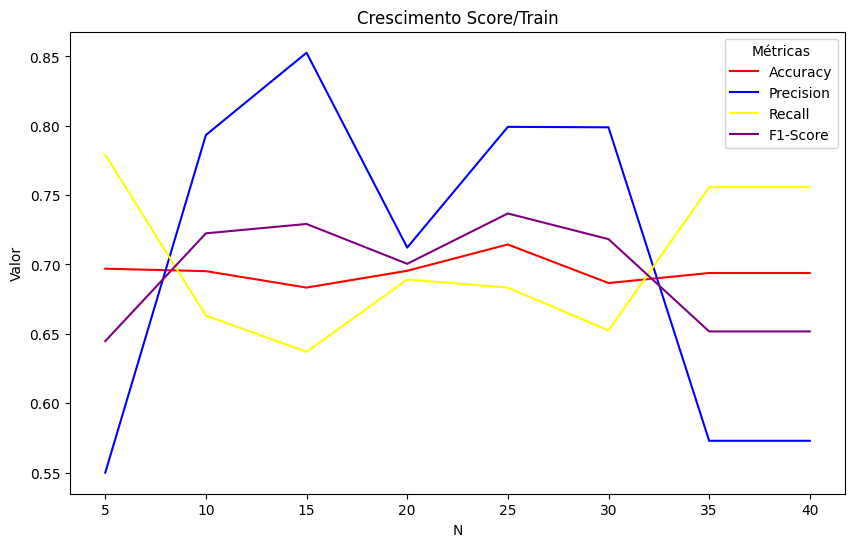

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [5,10,15,20,25,30,35,40]
data_l['accuracy'] = accuracy_PAC
data_l['precision'] = precision_PAC
data_l['recall'] = recall_PAC
data_l['F1-score'] = f1_PAC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_depth = 40')

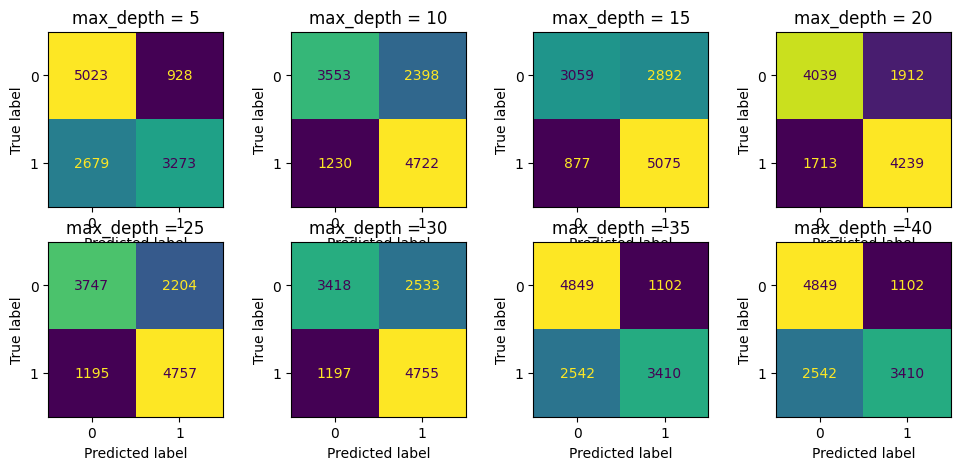

In [ ]:
cm_1 = confusion_matrix(y_test, PAC_pred[0])
cm_2 = confusion_matrix(y_test, PAC_pred[1])
cm_3 = confusion_matrix(y_test, PAC_pred[2])
cm_4 = confusion_matrix(y_test, PAC_pred[3])
cm_5 = confusion_matrix(y_test, PAC_pred[4])
cm_6 = confusion_matrix(y_test, PAC_pred[5])
cm_7 = confusion_matrix(y_test, PAC_pred[6])
cm_8 = confusion_matrix(y_test, PAC_pred[7])

fig, axes = plt.subplots(2, 4, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_depth = 5')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_depth = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_depth = 15')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_depth = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_depth = 25')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_depth = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_depth = 35')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_depth = 40')

## Dataset FakeRecogna Corrigido:

In [ ]:
df_fakerecogna_c.head()

,classificação,texto_corrigido
0,fake,apago vaticano papar presar acusação tráfico c...
1,true,governar equador anunciar preparar cova coleti...
2,true,companhia ir franco operar voar direto pequim ...
3,true,marfim global todos retomar vender carnal bovi...
4,fake,assunto voltar compartilhar rede social julho ...


In [ ]:
df_fakerecogna_c['num_palavras'] = df_fakerecogna_c['texto_corrigido'].astype(str).apply(lambda x: len(x.split()))
print(df_fakerecogna_c['num_palavras'].describe())

count    11903.000000
mean        66.655885
std         50.627468
min          1.000000
25%         42.000000
50%         61.000000
75%         80.000000
max       1140.000000
Name: num_palavras, dtype: float64


In [ ]:
palavras = " ".join(df_fakerecogna_c['texto_corrigido'].astype(str)).split()
frequencia = Counter(palavras)
print(frequencia.most_common(10))  # Top 10 palavras mais frequentes

[('a', 9116), ('covil', 5317), ('presidente', 4834), ('dia', 4801), ('bolsonaro', 4297), ('coronavírus', 4268), ('saudar', 4252), ('d', 4026), ('brasil', 3908), ('pessoa', 3703)]


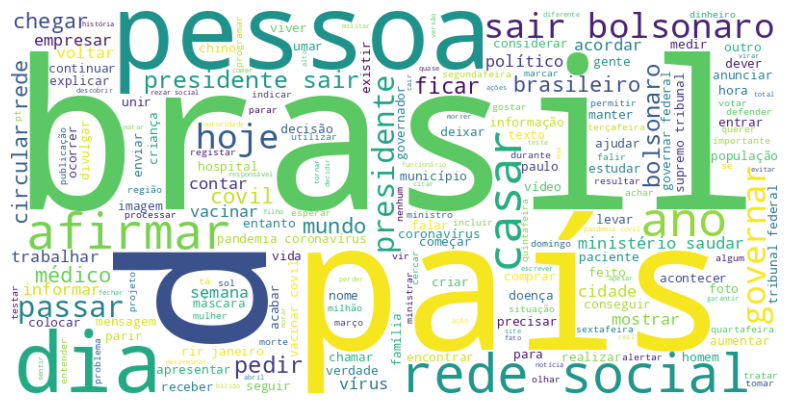

In [ ]:
texto = " ".join(df_fakerecogna_c['texto_corrigido'].astype(str))
wordcloud = WordCloud(width=800, height=400, background_color="white").generate(texto)

plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()

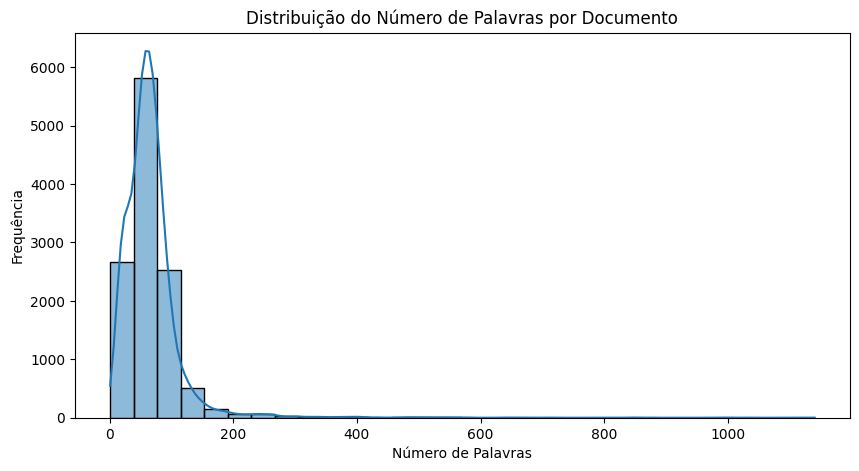

In [ ]:
plt.figure(figsize=(10,5))
sns.histplot(df_fakerecogna_c['num_palavras'], bins=30, kde=True)
plt.xlabel("Número de Palavras")
plt.ylabel("Frequência")
plt.title("Distribuição do Número de Palavras por Documento")
plt.show()

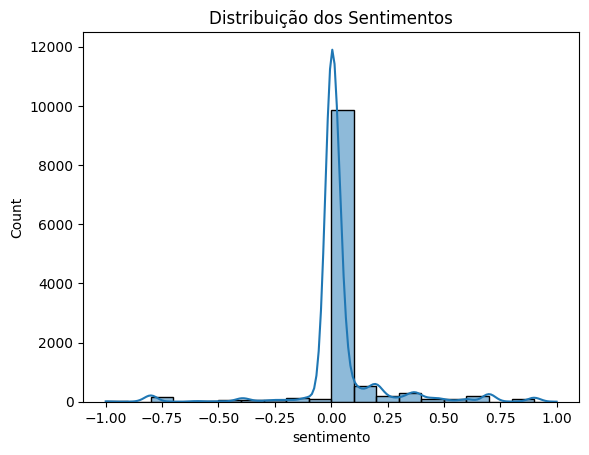

In [ ]:
from textblob import TextBlob

df_fakerecogna_c['texto_corrigido'] = df_fakerecogna_c['texto_corrigido'].astype(str)
df_fakerecogna_c['sentimento'] = df_fakerecogna_c['texto_corrigido'].apply(lambda x: TextBlob(x).sentiment.polarity)
sns.histplot(df_fakerecogna_c['sentimento'], bins=20, kde=True)
plt.title("Distribuição dos Sentimentos")
plt.show()

### TF-IDF

In [ ]:
vetorizador = TfidfVectorizer()

x_train = vetorizador.fit_transform(df_fakerecogna_c['texto_corrigido'].astype(str))
y_train = df_fakerecogna_c['classificação'].apply(lambda x: 1 if 'true' in x else 0)
x_test = vetorizador.transform(df_fakebr_c['texto_corrigido'].astype(str))
y_test = df_fakebr_c['classificação'].apply(lambda x: 1 if 'true' in x else 0)

#### RFC

In [ ]:
accuracy_RFC = []
precision_RFC = []
recall_RFC = []
f1_RFC = []
score = []
RFC_pred = []
i = 5
while i<41:
  forest=RandomForestClassifier(max_depth = i,random_state=45)
  forest.fit(x_train,y_train)
  prediction=forest.predict(x_test)
  RFC_pred.append(prediction)
  accuracy_RFC.append(metrics.accuracy_score(prediction,y_test))
  precision_RFC.append(metrics.precision_score(prediction,y_test))
  recall_RFC.append(metrics.recall_score(prediction,y_test))
  f1_RFC.append(metrics.f1_score(prediction,y_test))
  i+= 5

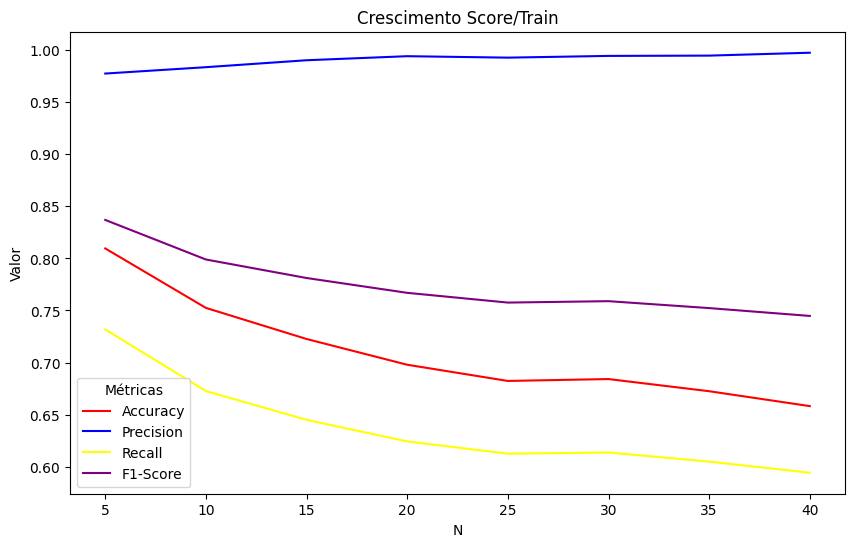

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [5,10,15,20,25,30,35,40]
data_l['accuracy'] = accuracy_RFC
data_l['precision'] = precision_RFC
data_l['recall'] = recall_RFC
data_l['F1-score'] = f1_RFC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_depth = 40')

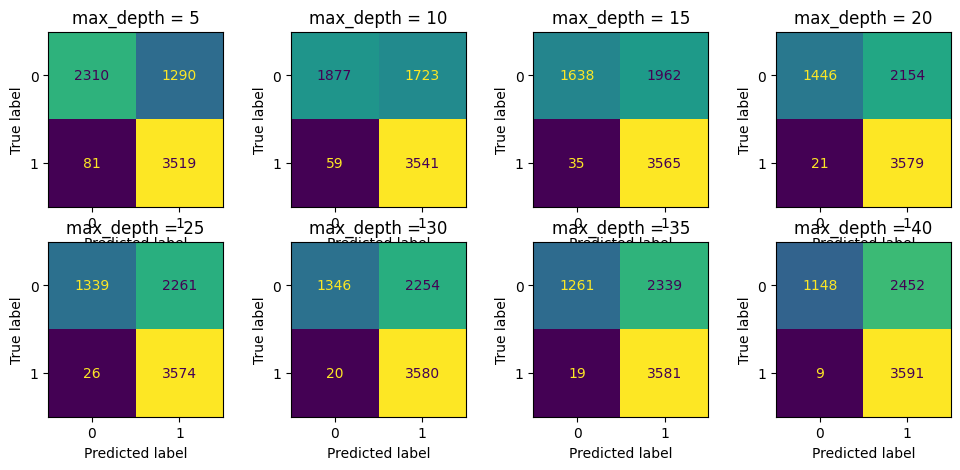

In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

cm_1 = confusion_matrix(y_test, RFC_pred[0])
cm_2 = confusion_matrix(y_test, RFC_pred[1])
cm_3 = confusion_matrix(y_test, RFC_pred[2])
cm_4 = confusion_matrix(y_test, RFC_pred[3])
cm_5 = confusion_matrix(y_test, RFC_pred[4])
cm_6 = confusion_matrix(y_test, RFC_pred[5])
cm_7 = confusion_matrix(y_test, RFC_pred[6])
cm_8 = confusion_matrix(y_test, RFC_pred[7])

fig, axes = plt.subplots(2, 4, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_depth = 5')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_depth = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_depth = 15')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_depth = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_depth = 25')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_depth = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_depth = 35')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_depth = 40')

#### DTC

In [ ]:
accuracy_DTC = []
precision_DTC = []
recall_DTC = []
f1_DTC = []
DTC_pred = []
i = 5
while i<41:
  mod_dt = DecisionTreeClassifier(max_depth = i, random_state = 1)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  DTC_pred.append(prediction)
  accuracy_DTC.append(metrics.accuracy_score(prediction,y_test))
  precision_DTC.append(metrics.precision_score(prediction,y_test))
  recall_DTC.append(metrics.recall_score(prediction,y_test))
  f1_DTC.append(metrics.f1_score(prediction,y_test))
  i+= 5

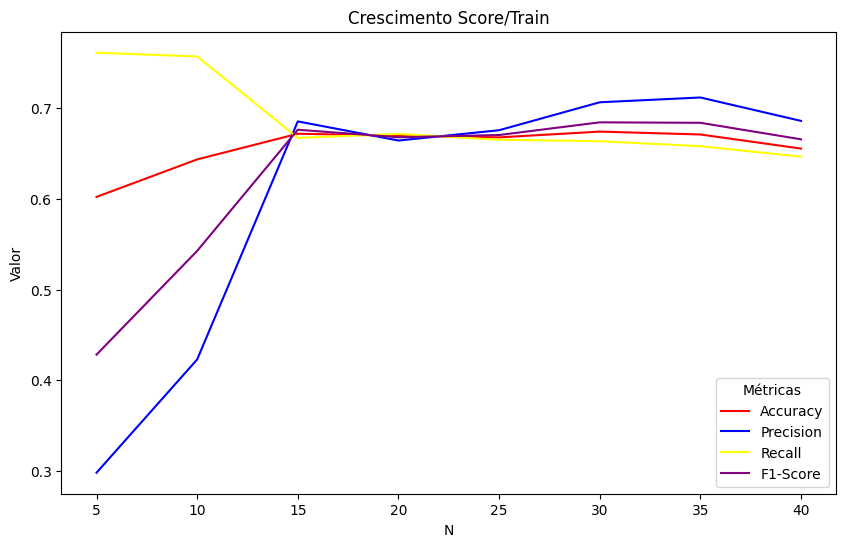

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [5,10,15,20,25,30,35,40]
data_l['accuracy'] = accuracy_DTC
data_l['precision'] = precision_DTC
data_l['recall'] = recall_DTC
data_l['F1-score'] = f1_DTC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_depth = 40')

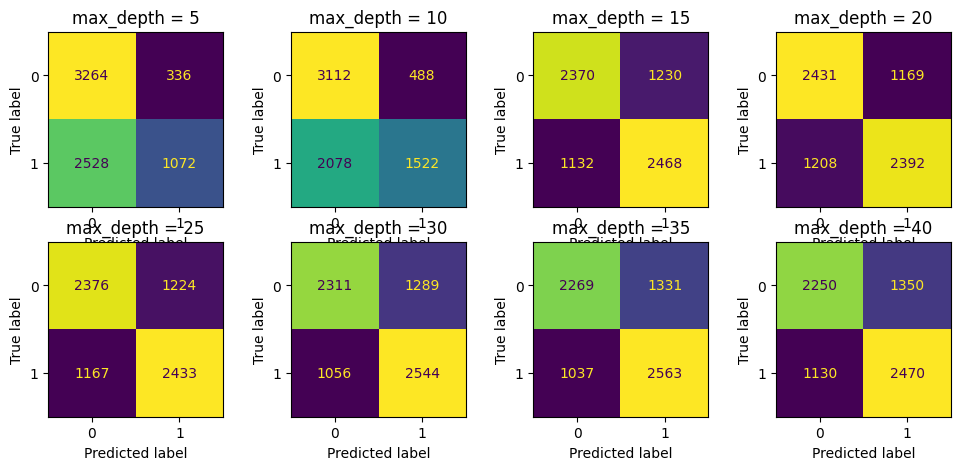

In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

cm_1 = confusion_matrix(y_test, DTC_pred[0])
cm_2 = confusion_matrix(y_test, DTC_pred[1])
cm_3 = confusion_matrix(y_test, DTC_pred[2])
cm_4 = confusion_matrix(y_test, DTC_pred[3])
cm_5 = confusion_matrix(y_test, DTC_pred[4])
cm_6 = confusion_matrix(y_test, DTC_pred[5])
cm_7 = confusion_matrix(y_test, DTC_pred[6])
cm_8 = confusion_matrix(y_test, DTC_pred[7])

fig, axes = plt.subplots(2, 4, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_depth = 5')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_depth = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_depth = 15')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_depth = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_depth = 25')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_depth = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_depth = 35')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_depth = 40')

#### Logistic Regression


In [ ]:
accuracy_LR = []
precision_LR = []
recall_LR = []
f1_LR = []
LR_pred = []
i = 10
while i<151:
  mod_dt = LogisticRegression(max_iter = i, random_state = 1)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  LR_pred.append(prediction)
  accuracy_LR.append(metrics.accuracy_score(prediction,y_test))
  precision_LR.append(metrics.precision_score(prediction,y_test))
  recall_LR.append(metrics.recall_score(prediction,y_test))
  f1_LR.append(metrics.f1_score(prediction,y_test))
  i+= 10

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. OF ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


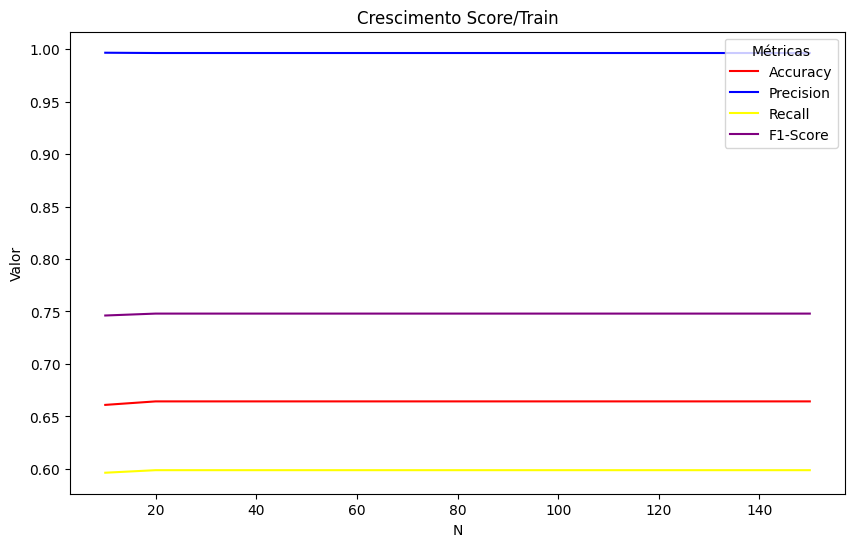

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [10,20,30,40,50,60,70,80,90,100,110,120,130,140,150]
data_l['accuracy'] = accuracy_LR
data_l['precision'] = precision_LR
data_l['recall'] = recall_LR
data_l['F1-score'] = f1_LR
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_iter = 150')

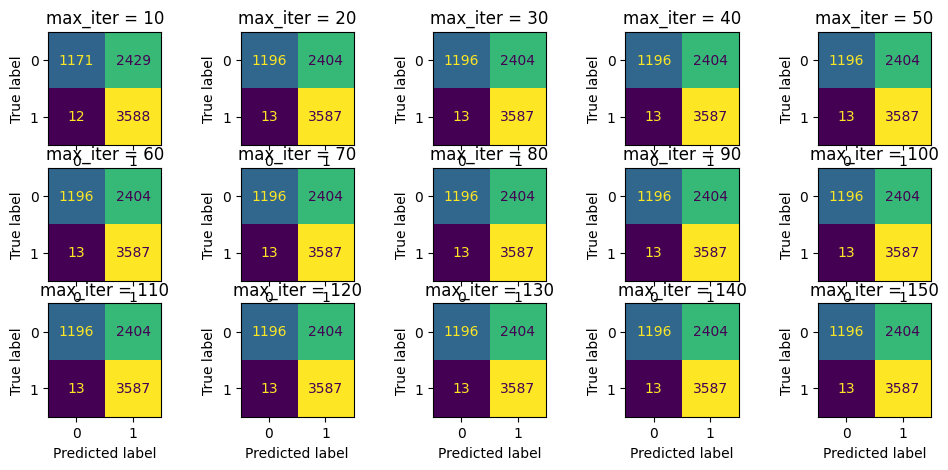

In [ ]:
cm_1 = confusion_matrix(y_test, LR_pred[0])
cm_2 = confusion_matrix(y_test, LR_pred[1])
cm_3 = confusion_matrix(y_test, LR_pred[2])
cm_4 = confusion_matrix(y_test, LR_pred[3])
cm_5 = confusion_matrix(y_test, LR_pred[4])
cm_6 = confusion_matrix(y_test, LR_pred[5])
cm_7 = confusion_matrix(y_test, LR_pred[6])
cm_8 = confusion_matrix(y_test, LR_pred[7])
cm_9 = confusion_matrix(y_test, LR_pred[8])
cm_10 = confusion_matrix(y_test, LR_pred[9])
cm_11 = confusion_matrix(y_test, LR_pred[10])
cm_12 = confusion_matrix(y_test, LR_pred[11])
cm_13 = confusion_matrix(y_test, LR_pred[12])
cm_14 = confusion_matrix(y_test, LR_pred[13])
cm_15 = confusion_matrix(y_test, LR_pred[14])

fig, axes = plt.subplots(3, 5, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_iter = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_iter = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_iter = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_iter = 40')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[0,4], colorbar=False)
axes[0,4].set_title('max_iter = 50')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_iter = 60')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_iter = 70')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_iter = 80')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_9)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_iter = 90')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_10)
disp_rfc.plot(ax=axes[1,4], colorbar=False)
axes[1,4].set_title('max_iter = 100')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_11)
disp_rfc.plot(ax=axes[2,0], colorbar=False)
axes[2,0].set_title('max_iter = 110')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_12)
disp_rfc.plot(ax=axes[2,1], colorbar=False)
axes[2,1].set_title('max_iter = 120')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_13)
disp_rfc.plot(ax=axes[2,2], colorbar=False)
axes[2,2].set_title('max_iter = 130')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_14)
disp_rfc.plot(ax=axes[2,3], colorbar=False)
axes[2,3].set_title('max_iter = 140')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_15)
disp_rfc.plot(ax=axes[2,4], colorbar=False)
axes[2,4].set_title('max_iter = 150')

#### Linear Support Vector Classifier


In [ ]:
accuracy_LSVC = []
precision_LSVC = []
recall_LSVC = []
f1_LSVC = []
LSVC_pred = []
i = 10
while i<151:
  mod_dt = LinearSVC(max_iter = i, random_state = 42)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  LSVC_pred.append(prediction)
  accuracy_LSVC.append(metrics.accuracy_score(prediction,y_test))
  precision_LSVC.append(metrics.precision_score(prediction,y_test))
  recall_LSVC.append(metrics.recall_score(prediction,y_test))
  f1_LSVC.append(metrics.f1_score(prediction,y_test))
  i+= 10

/usr/local/lib/python3.11/dist-packages/sklearn/svm/_base.py:1249: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/svm/_base.py:1249: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/svm/_base.py:1249: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/svm/_base.py:1249: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


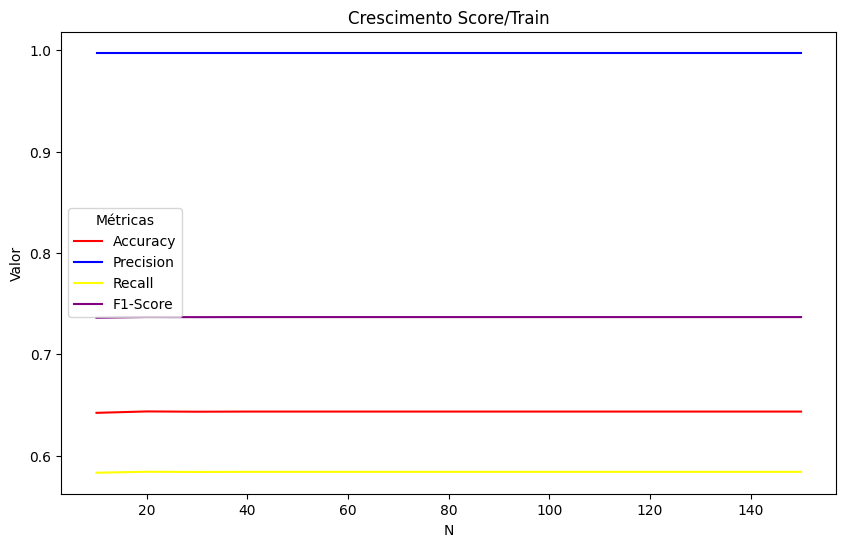

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [10,20,30,40,50,60,70,80,90,100,110,120,130,140,150]
data_l['accuracy'] = accuracy_LSVC
data_l['precision'] = precision_LSVC
data_l['recall'] = recall_LSVC
data_l['F1-score'] = f1_LSVC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_iter = 150')

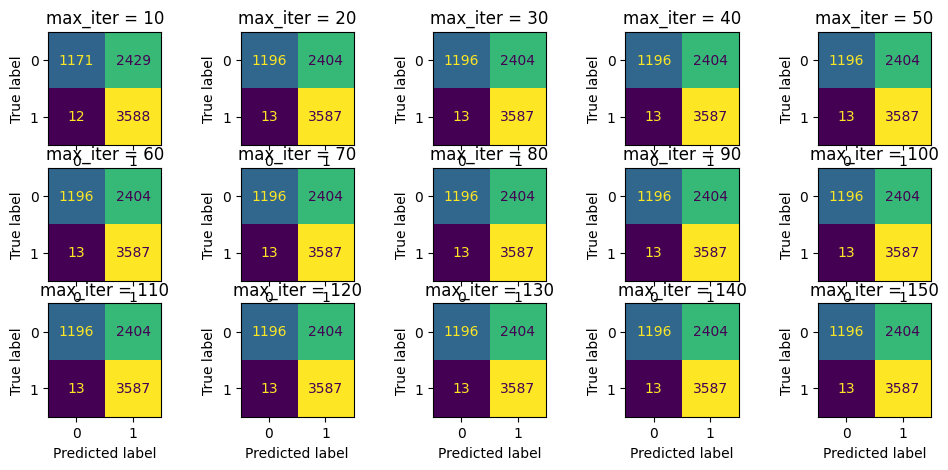

In [ ]:
cm_1 = confusion_matrix(y_test, LR_pred[0])
cm_2 = confusion_matrix(y_test, LR_pred[1])
cm_3 = confusion_matrix(y_test, LR_pred[2])
cm_4 = confusion_matrix(y_test, LR_pred[3])
cm_5 = confusion_matrix(y_test, LR_pred[4])
cm_6 = confusion_matrix(y_test, LR_pred[5])
cm_7 = confusion_matrix(y_test, LR_pred[6])
cm_8 = confusion_matrix(y_test, LR_pred[7])
cm_9 = confusion_matrix(y_test, LR_pred[8])
cm_10 = confusion_matrix(y_test, LR_pred[9])
cm_11 = confusion_matrix(y_test, LR_pred[10])
cm_12 = confusion_matrix(y_test, LR_pred[11])
cm_13 = confusion_matrix(y_test, LR_pred[12])
cm_14 = confusion_matrix(y_test, LR_pred[13])
cm_15 = confusion_matrix(y_test, LR_pred[14])

fig, axes = plt.subplots(3, 5, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_iter = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_iter = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_iter = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_iter = 40')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[0,4], colorbar=False)
axes[0,4].set_title('max_iter = 50')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_iter = 60')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_iter = 70')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_iter = 80')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_9)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_iter = 90')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_10)
disp_rfc.plot(ax=axes[1,4], colorbar=False)
axes[1,4].set_title('max_iter = 100')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_11)
disp_rfc.plot(ax=axes[2,0], colorbar=False)
axes[2,0].set_title('max_iter = 110')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_12)
disp_rfc.plot(ax=axes[2,1], colorbar=False)
axes[2,1].set_title('max_iter = 120')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_13)
disp_rfc.plot(ax=axes[2,2], colorbar=False)
axes[2,2].set_title('max_iter = 130')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_14)
disp_rfc.plot(ax=axes[2,3], colorbar=False)
axes[2,3].set_title('max_iter = 140')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_15)
disp_rfc.plot(ax=axes[2,4], colorbar=False)
axes[2,4].set_title('max_iter = 150')

#### Passive Aggressive Classifier


In [ ]:
accuracy_PAC = []
precision_PAC = []
recall_PAC = []
f1_PAC = []
PAC_pred = []
i = 5
while i<41:
  mod_dt = PassiveAggressiveClassifier(max_iter=i, random_state=42)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  PAC_pred.append(prediction)
  accuracy_PAC.append(metrics.accuracy_score(prediction,y_test))
  precision_PAC.append(metrics.precision_score(prediction,y_test))
  recall_PAC.append(metrics.recall_score(prediction,y_test))
  f1_PAC.append(metrics.f1_score(prediction,y_test))
  i+= 5

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:738: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:738: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:738: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(


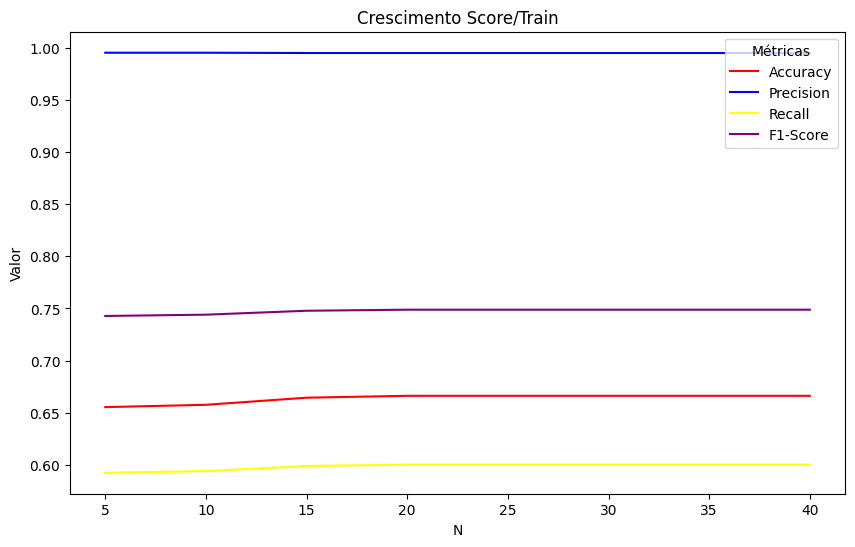

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [5,10,15,20,25,30,35,40]
data_l['accuracy'] = accuracy_PAC
data_l['precision'] = precision_PAC
data_l['recall'] = recall_PAC
data_l['F1-score'] = f1_PAC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_depth = 40')

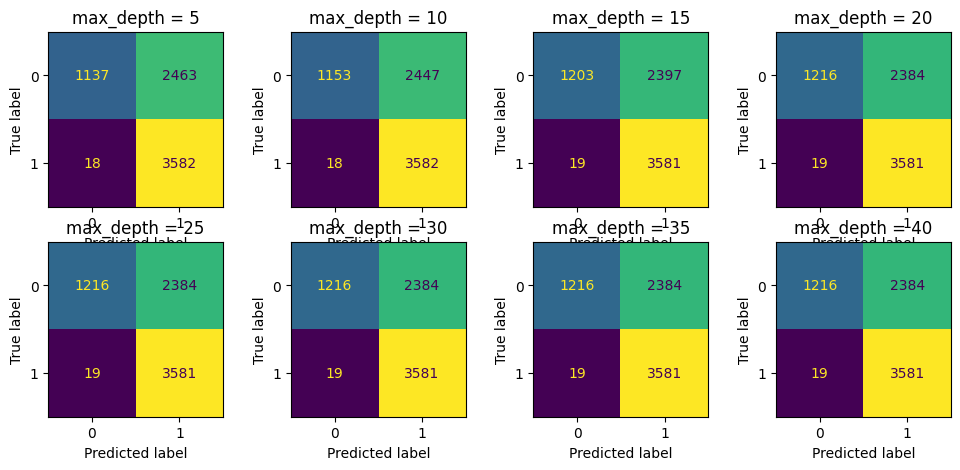

In [ ]:
cm_1 = confusion_matrix(y_test, PAC_pred[0])
cm_2 = confusion_matrix(y_test, PAC_pred[1])
cm_3 = confusion_matrix(y_test, PAC_pred[2])
cm_4 = confusion_matrix(y_test, PAC_pred[3])
cm_5 = confusion_matrix(y_test, PAC_pred[4])
cm_6 = confusion_matrix(y_test, PAC_pred[5])
cm_7 = confusion_matrix(y_test, PAC_pred[6])
cm_8 = confusion_matrix(y_test, PAC_pred[7])

fig, axes = plt.subplots(2, 4, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_depth = 5')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_depth = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_depth = 15')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_depth = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_depth = 25')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_depth = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_depth = 35')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_depth = 40')

###Word2Vec

In [ ]:
# 1. Pré-processamento
fakebr_textos = [str(t).split() for t in df_fakebr_c['texto_corrigido']]
fakerecogna_textos = [str(t).split() for t in df_fakerecogna_c['texto_corrigido']]

# 2. Treinar Word2Vec SOMENTE com fake.br
w2v_model = Word2Vec(sentences=fakebr_textos, vector_size=100, window=5, min_count=1)

# 3. Função para vetorizar texto
def vetor_medio(texto, modelo):
    vetores = [modelo.wv[word] for word in texto if word in modelo.wv]
    return np.mean(vetores, axis=0) if vetores else np.zeros(modelo.vector_size)

# 4. Vetorização
x_train = np.array([vetor_medio(t, w2v_model) for t in fakerecogna_textos])
y_train = df_fakerecogna_c['classificação'].apply(lambda x: 1 if 'true' in x else 0)

x_test = np.array([vetor_medio(t, w2v_model) for t in fakebr_textos])
y_test = df_fakebr_c['classificação'].apply(lambda x: 1 if 'true' in x else 0)

#### RFC

In [ ]:
accuracy_RFC = []
precision_RFC = []
recall_RFC = []
f1_RFC = []
score = []
RFC_pred = []
i = 5
while i<41:
  forest=RandomForestClassifier(max_depth = i,random_state=45)
  forest.fit(x_train,y_train)
  prediction=forest.predict(x_test)
  RFC_pred.append(prediction)
  accuracy_RFC.append(metrics.accuracy_score(prediction,y_test))
  precision_RFC.append(metrics.precision_score(prediction,y_test))
  recall_RFC.append(metrics.recall_score(prediction,y_test))
  f1_RFC.append(metrics.f1_score(prediction,y_test))
  i+= 5

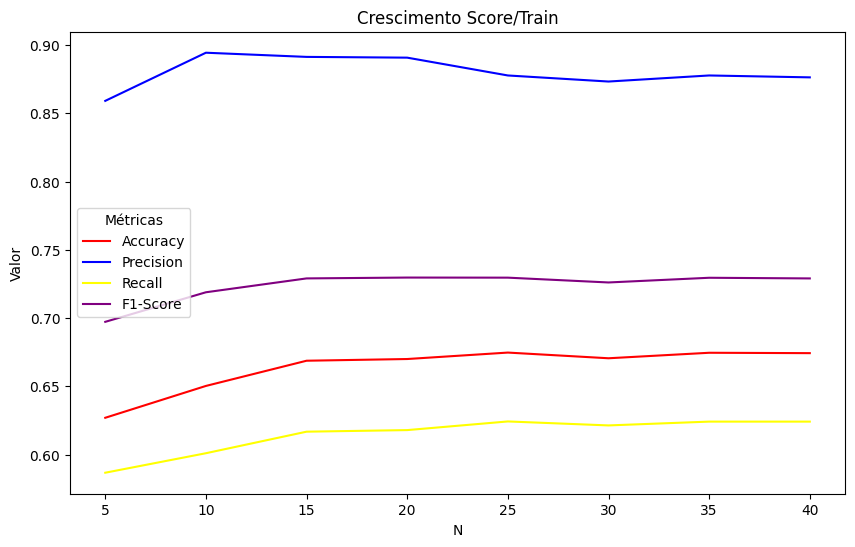

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [5,10,15,20,25,30,35,40]
data_l['accuracy'] = accuracy_RFC
data_l['precision'] = precision_RFC
data_l['recall'] = recall_RFC
data_l['F1-score'] = f1_RFC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_depth = 40')

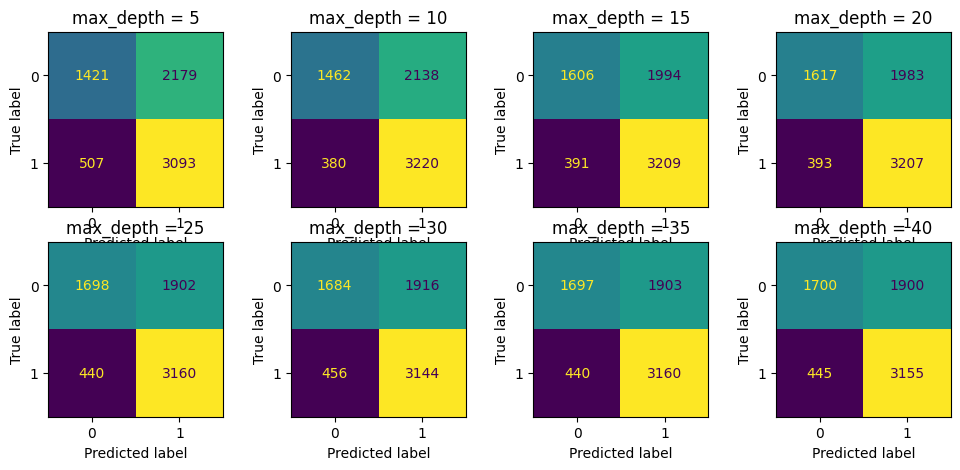

In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

cm_1 = confusion_matrix(y_test, RFC_pred[0])
cm_2 = confusion_matrix(y_test, RFC_pred[1])
cm_3 = confusion_matrix(y_test, RFC_pred[2])
cm_4 = confusion_matrix(y_test, RFC_pred[3])
cm_5 = confusion_matrix(y_test, RFC_pred[4])
cm_6 = confusion_matrix(y_test, RFC_pred[5])
cm_7 = confusion_matrix(y_test, RFC_pred[6])
cm_8 = confusion_matrix(y_test, RFC_pred[7])

fig, axes = plt.subplots(2, 4, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_depth = 5')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_depth = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_depth = 15')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_depth = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_depth = 25')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_depth = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_depth = 35')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_depth = 40')

#### DTC

In [ ]:
accuracy_DTC = []
precision_DTC = []
recall_DTC = []
f1_DTC = []
DTC_pred = []
i = 5
while i<41:
  mod_dt = DecisionTreeClassifier(max_depth = i, random_state = 1)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  DTC_pred.append(prediction)
  accuracy_DTC.append(metrics.accuracy_score(prediction,y_test))
  precision_DTC.append(metrics.precision_score(prediction,y_test))
  recall_DTC.append(metrics.recall_score(prediction,y_test))
  f1_DTC.append(metrics.f1_score(prediction,y_test))
  i+= 5

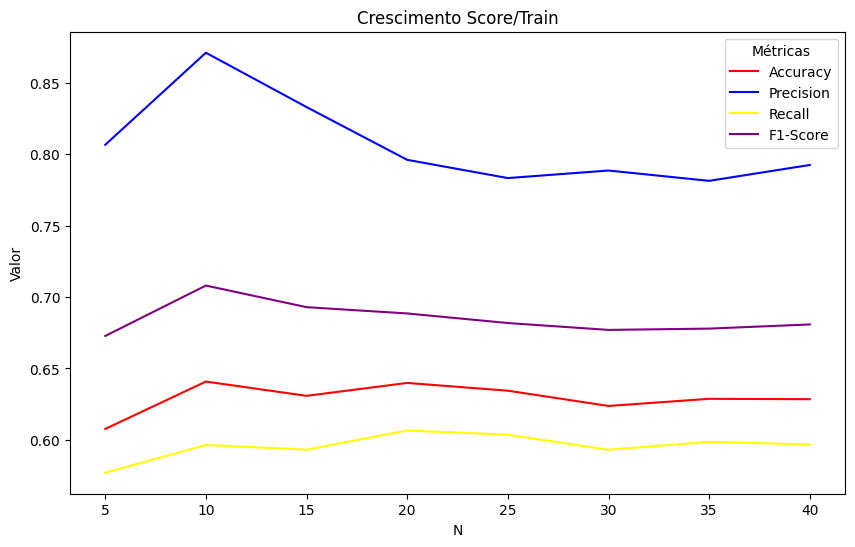

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [5,10,15,20,25,30,35,40]
data_l['accuracy'] = accuracy_DTC
data_l['precision'] = precision_DTC
data_l['recall'] = recall_DTC
data_l['F1-score'] = f1_DTC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_depth = 40')

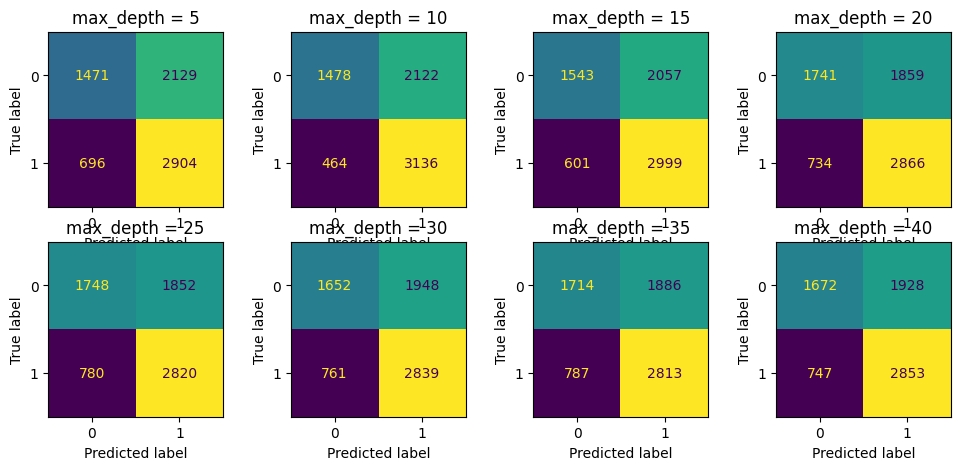

In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

cm_1 = confusion_matrix(y_test, DTC_pred[0])
cm_2 = confusion_matrix(y_test, DTC_pred[1])
cm_3 = confusion_matrix(y_test, DTC_pred[2])
cm_4 = confusion_matrix(y_test, DTC_pred[3])
cm_5 = confusion_matrix(y_test, DTC_pred[4])
cm_6 = confusion_matrix(y_test, DTC_pred[5])
cm_7 = confusion_matrix(y_test, DTC_pred[6])
cm_8 = confusion_matrix(y_test, DTC_pred[7])

fig, axes = plt.subplots(2, 4, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_depth = 5')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_depth = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_depth = 15')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_depth = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_depth = 25')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_depth = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_depth = 35')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_depth = 40')

#### Logistic Regression


In [ ]:
accuracy_LR = []
precision_LR = []
recall_LR = []
f1_LR = []
LR_pred = []
i = 10
while i<151:
  mod_dt = LogisticRegression(max_iter = i, random_state = 1)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  LR_pred.append(prediction)
  accuracy_LR.append(metrics.accuracy_score(prediction,y_test))
  precision_LR.append(metrics.precision_score(prediction,y_test))
  recall_LR.append(metrics.recall_score(prediction,y_test))
  f1_LR.append(metrics.f1_score(prediction,y_test))
  i+= 10

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _c

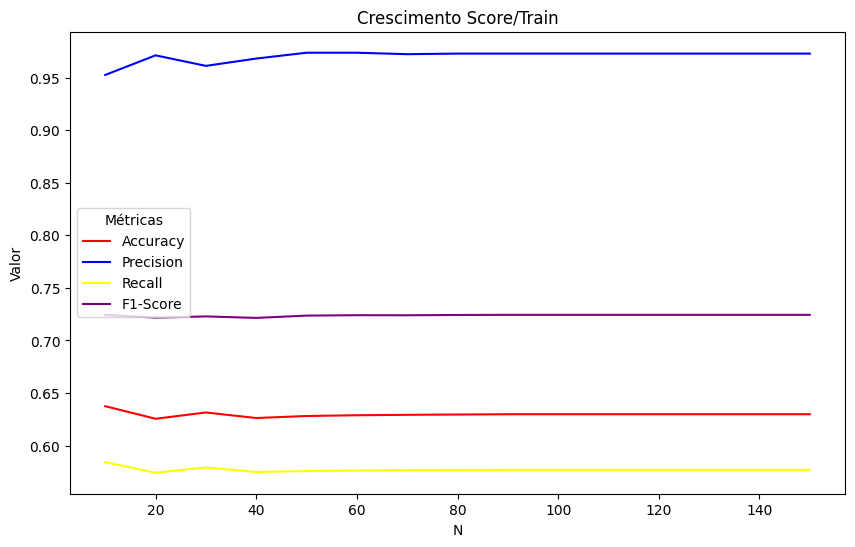

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [10,20,30,40,50,60,70,80,90,100,110,120,130,140,150]
data_l['accuracy'] = accuracy_LR
data_l['precision'] = precision_LR
data_l['recall'] = recall_LR
data_l['F1-score'] = f1_LR
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_iter = 150')

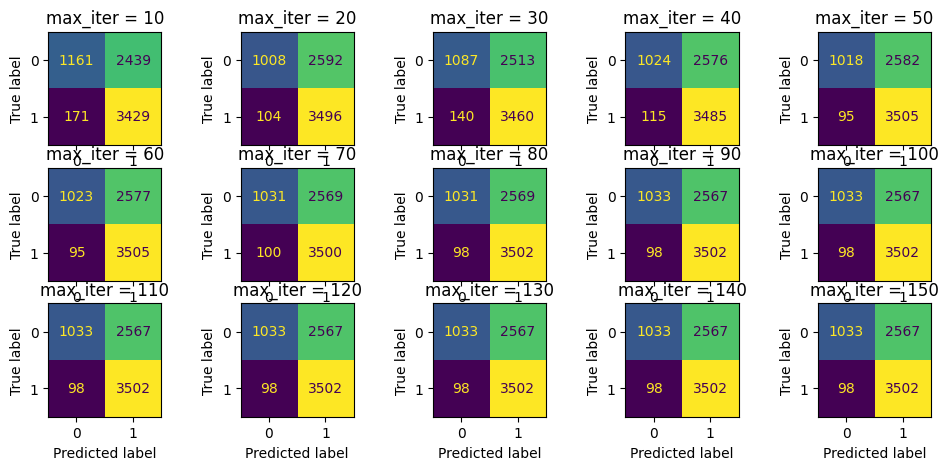

In [ ]:
cm_1 = confusion_matrix(y_test, LR_pred[0])
cm_2 = confusion_matrix(y_test, LR_pred[1])
cm_3 = confusion_matrix(y_test, LR_pred[2])
cm_4 = confusion_matrix(y_test, LR_pred[3])
cm_5 = confusion_matrix(y_test, LR_pred[4])
cm_6 = confusion_matrix(y_test, LR_pred[5])
cm_7 = confusion_matrix(y_test, LR_pred[6])
cm_8 = confusion_matrix(y_test, LR_pred[7])
cm_9 = confusion_matrix(y_test, LR_pred[8])
cm_10 = confusion_matrix(y_test, LR_pred[9])
cm_11 = confusion_matrix(y_test, LR_pred[10])
cm_12 = confusion_matrix(y_test, LR_pred[11])
cm_13 = confusion_matrix(y_test, LR_pred[12])
cm_14 = confusion_matrix(y_test, LR_pred[13])
cm_15 = confusion_matrix(y_test, LR_pred[14])

fig, axes = plt.subplots(3, 5, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_iter = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_iter = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_iter = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_iter = 40')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[0,4], colorbar=False)
axes[0,4].set_title('max_iter = 50')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_iter = 60')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_iter = 70')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_iter = 80')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_9)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_iter = 90')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_10)
disp_rfc.plot(ax=axes[1,4], colorbar=False)
axes[1,4].set_title('max_iter = 100')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_11)
disp_rfc.plot(ax=axes[2,0], colorbar=False)
axes[2,0].set_title('max_iter = 110')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_12)
disp_rfc.plot(ax=axes[2,1], colorbar=False)
axes[2,1].set_title('max_iter = 120')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_13)
disp_rfc.plot(ax=axes[2,2], colorbar=False)
axes[2,2].set_title('max_iter = 130')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_14)
disp_rfc.plot(ax=axes[2,3], colorbar=False)
axes[2,3].set_title('max_iter = 140')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_15)
disp_rfc.plot(ax=axes[2,4], colorbar=False)
axes[2,4].set_title('max_iter = 150')

#### Linear Support Vector Classifier


In [ ]:
accuracy_LSVC = []
precision_LSVC = []
recall_LSVC = []
f1_LSVC = []
LSVC_pred = []
i = 10
while i<151:
  mod_dt = LinearSVC(max_iter = i, random_state = 42)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  LSVC_pred.append(prediction)
  accuracy_LSVC.append(metrics.accuracy_score(prediction,y_test))
  precision_LSVC.append(metrics.precision_score(prediction,y_test))
  recall_LSVC.append(metrics.recall_score(prediction,y_test))
  f1_LSVC.append(metrics.f1_score(prediction,y_test))
  i+= 10

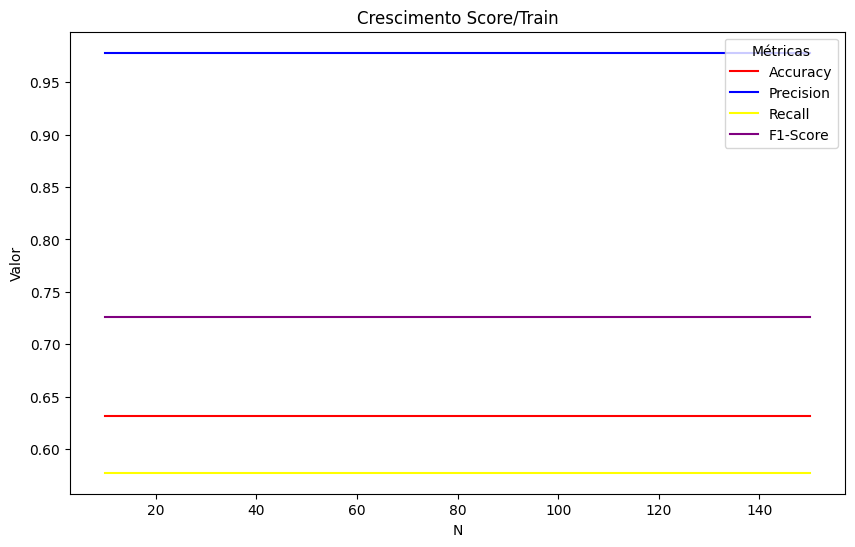

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [10,20,30,40,50,60,70,80,90,100,110,120,130,140,150]
data_l['accuracy'] = accuracy_LSVC
data_l['precision'] = precision_LSVC
data_l['recall'] = recall_LSVC
data_l['F1-score'] = f1_LSVC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_iter = 150')

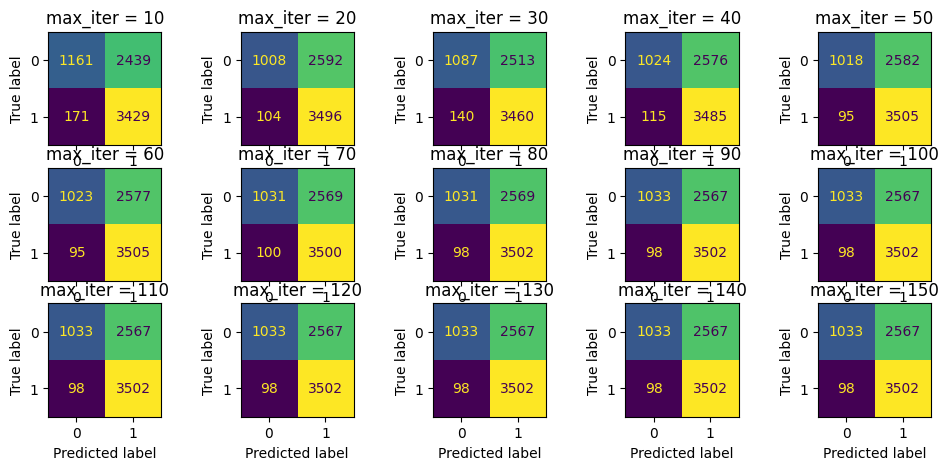

In [ ]:
cm_1 = confusion_matrix(y_test, LR_pred[0])
cm_2 = confusion_matrix(y_test, LR_pred[1])
cm_3 = confusion_matrix(y_test, LR_pred[2])
cm_4 = confusion_matrix(y_test, LR_pred[3])
cm_5 = confusion_matrix(y_test, LR_pred[4])
cm_6 = confusion_matrix(y_test, LR_pred[5])
cm_7 = confusion_matrix(y_test, LR_pred[6])
cm_8 = confusion_matrix(y_test, LR_pred[7])
cm_9 = confusion_matrix(y_test, LR_pred[8])
cm_10 = confusion_matrix(y_test, LR_pred[9])
cm_11 = confusion_matrix(y_test, LR_pred[10])
cm_12 = confusion_matrix(y_test, LR_pred[11])
cm_13 = confusion_matrix(y_test, LR_pred[12])
cm_14 = confusion_matrix(y_test, LR_pred[13])
cm_15 = confusion_matrix(y_test, LR_pred[14])

fig, axes = plt.subplots(3, 5, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_iter = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_iter = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_iter = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_iter = 40')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[0,4], colorbar=False)
axes[0,4].set_title('max_iter = 50')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_iter = 60')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_iter = 70')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_iter = 80')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_9)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_iter = 90')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_10)
disp_rfc.plot(ax=axes[1,4], colorbar=False)
axes[1,4].set_title('max_iter = 100')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_11)
disp_rfc.plot(ax=axes[2,0], colorbar=False)
axes[2,0].set_title('max_iter = 110')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_12)
disp_rfc.plot(ax=axes[2,1], colorbar=False)
axes[2,1].set_title('max_iter = 120')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_13)
disp_rfc.plot(ax=axes[2,2], colorbar=False)
axes[2,2].set_title('max_iter = 130')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_14)
disp_rfc.plot(ax=axes[2,3], colorbar=False)
axes[2,3].set_title('max_iter = 140')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_15)
disp_rfc.plot(ax=axes[2,4], colorbar=False)
axes[2,4].set_title('max_iter = 150')

#### Passive Aggressive Classifier


In [ ]:
accuracy_PAC = []
precision_PAC = []
recall_PAC = []
f1_PAC = []
PAC_pred = []
i = 5
while i<41:
  mod_dt = PassiveAggressiveClassifier(max_iter=i, random_state=42)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  PAC_pred.append(prediction)
  accuracy_PAC.append(metrics.accuracy_score(prediction,y_test))
  precision_PAC.append(metrics.precision_score(prediction,y_test))
  recall_PAC.append(metrics.recall_score(prediction,y_test))
  f1_PAC.append(metrics.f1_score(prediction,y_test))
  i+= 5

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:738: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(


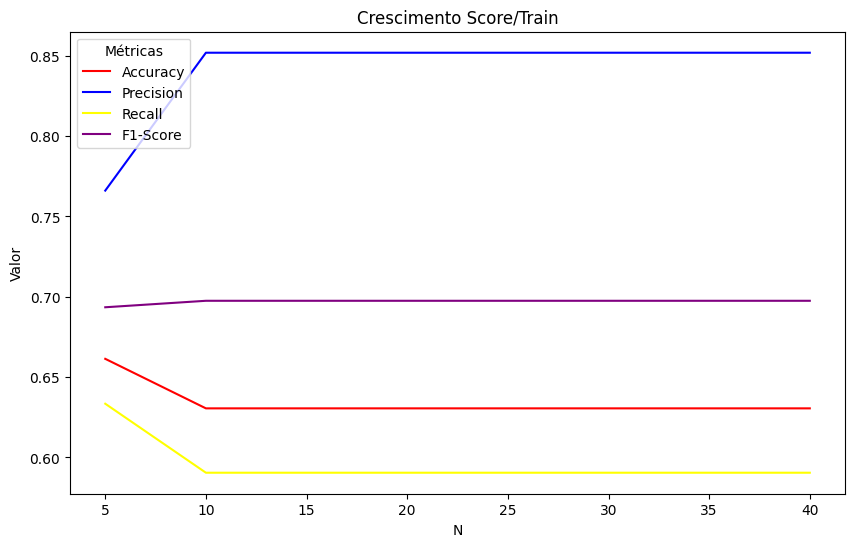

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [5,10,15,20,25,30,35,40]
data_l['accuracy'] = accuracy_PAC
data_l['precision'] = precision_PAC
data_l['recall'] = recall_PAC
data_l['F1-score'] = f1_PAC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_depth = 40')

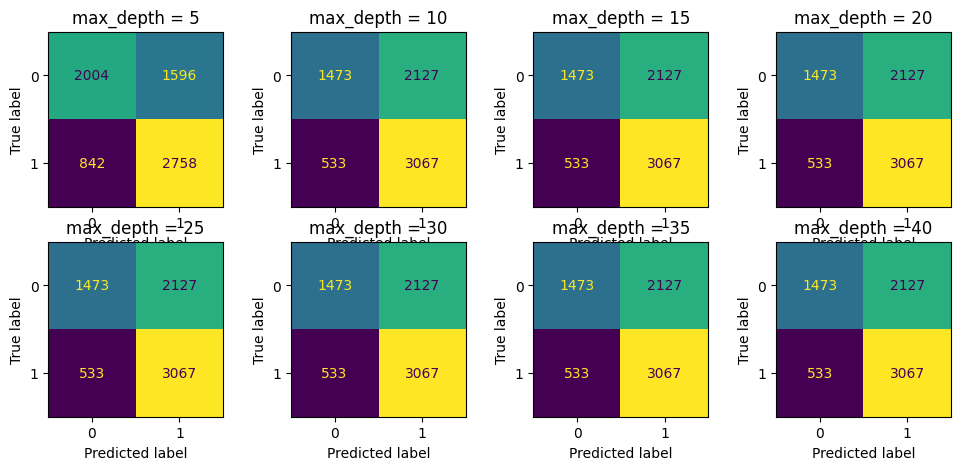

In [ ]:
cm_1 = confusion_matrix(y_test, PAC_pred[0])
cm_2 = confusion_matrix(y_test, PAC_pred[1])
cm_3 = confusion_matrix(y_test, PAC_pred[2])
cm_4 = confusion_matrix(y_test, PAC_pred[3])
cm_5 = confusion_matrix(y_test, PAC_pred[4])
cm_6 = confusion_matrix(y_test, PAC_pred[5])
cm_7 = confusion_matrix(y_test, PAC_pred[6])
cm_8 = confusion_matrix(y_test, PAC_pred[7])

fig, axes = plt.subplots(2, 4, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_depth = 5')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_depth = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_depth = 15')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_depth = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_depth = 25')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_depth = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_depth = 35')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_depth = 40')

###BERT

In [ ]:
# 1. Carregar BERT
tokenizer = BertTokenizer.from_pretrained('neuralmind/bert-base-portuguese-cased')
model = BertModel.from_pretrained('neuralmind/bert-base-portuguese-cased')
model.eval()

# 2. Função para extrair vetor da [CLS]
def get_bert_vector(texto):
    inputs = tokenizer(texto, return_tensors="pt", truncation=True, padding='max_length', max_length=128)
    with torch.no_grad():
        outputs = model(**inputs)
    return outputs.last_hidden_state[:, 0, :].squeeze().numpy()

# 3. Aplicar aos dados
textos_train = df_fakerecogna_c['texto_corrigido'].astype(str)
textos_test = df_fakebr_c['texto_corrigido'].astype(str)

x_train = np.array([get_bert_vector(t) for t in textos_train])
y_train = df_fakerecogna_c['classificação'].apply(lambda x: 1 if 'true' in x else 0)

x_test = np.array([get_bert_vector(t) for t in textos_test])
y_test = df_fakebr_c['classificação'].apply(lambda x: 1 if 'true' in x else 0)

#### RFC

In [ ]:
accuracy_RFC = []
precision_RFC = []
recall_RFC = []
f1_RFC = []
score = []
RFC_pred = []
i = 5
while i<41:
  forest=RandomForestClassifier(max_depth = i,random_state=45)
  forest.fit(x_train,y_train)
  prediction=forest.predict(x_test)
  RFC_pred.append(prediction)
  accuracy_RFC.append(metrics.accuracy_score(prediction,y_test))
  precision_RFC.append(metrics.precision_score(prediction,y_test))
  recall_RFC.append(metrics.recall_score(prediction,y_test))
  f1_RFC.append(metrics.f1_score(prediction,y_test))
  i+= 5

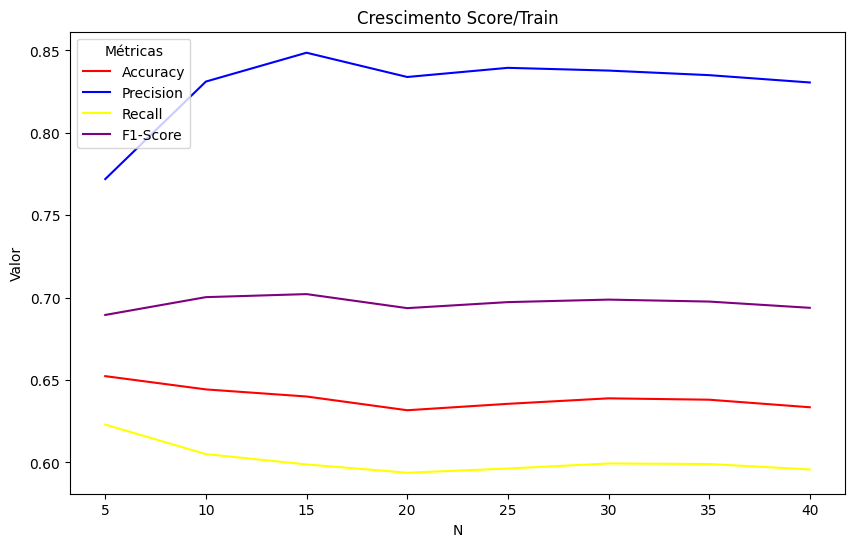

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [5,10,15,20,25,30,35,40]
data_l['accuracy'] = accuracy_RFC
data_l['precision'] = precision_RFC
data_l['recall'] = recall_RFC
data_l['F1-score'] = f1_RFC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_depth = 40')

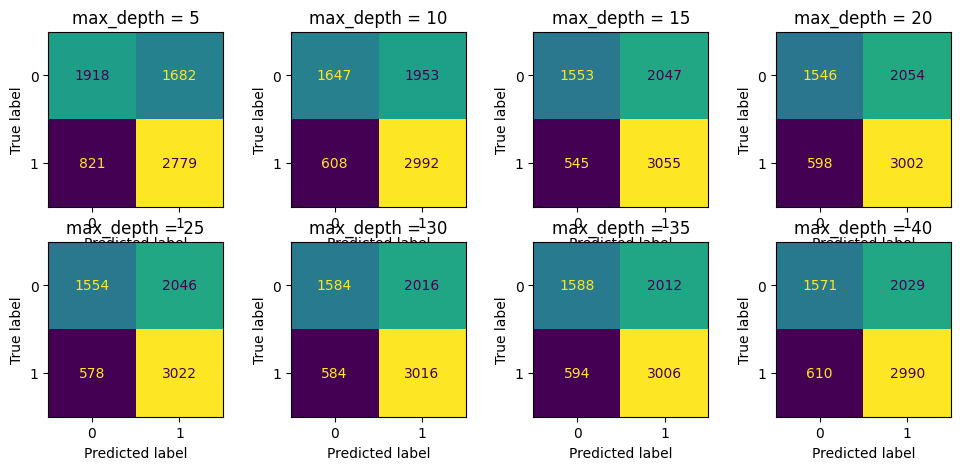

In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

cm_1 = confusion_matrix(y_test, RFC_pred[0])
cm_2 = confusion_matrix(y_test, RFC_pred[1])
cm_3 = confusion_matrix(y_test, RFC_pred[2])
cm_4 = confusion_matrix(y_test, RFC_pred[3])
cm_5 = confusion_matrix(y_test, RFC_pred[4])
cm_6 = confusion_matrix(y_test, RFC_pred[5])
cm_7 = confusion_matrix(y_test, RFC_pred[6])
cm_8 = confusion_matrix(y_test, RFC_pred[7])

fig, axes = plt.subplots(2, 4, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_depth = 5')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_depth = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_depth = 15')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_depth = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_depth = 25')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_depth = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_depth = 35')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_depth = 40')

#### DTC

In [ ]:
accuracy_DTC = []
precision_DTC = []
recall_DTC = []
f1_DTC = []
DTC_pred = []
i = 5
while i<41:
  mod_dt = DecisionTreeClassifier(max_depth = i, random_state = 1)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  DTC_pred.append(prediction)
  accuracy_DTC.append(metrics.accuracy_score(prediction,y_test))
  precision_DTC.append(metrics.precision_score(prediction,y_test))
  recall_DTC.append(metrics.recall_score(prediction,y_test))
  f1_DTC.append(metrics.f1_score(prediction,y_test))
  i+= 5

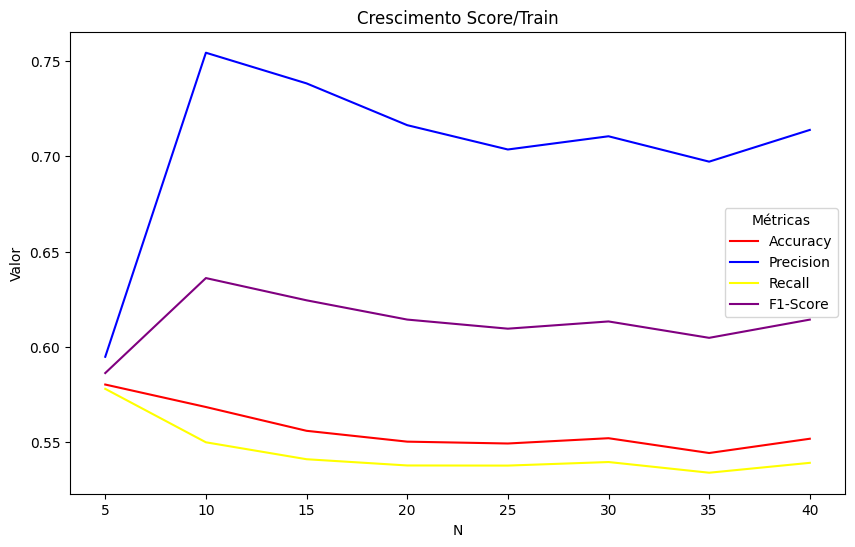

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [5,10,15,20,25,30,35,40]
data_l['accuracy'] = accuracy_DTC
data_l['precision'] = precision_DTC
data_l['recall'] = recall_DTC
data_l['F1-score'] = f1_DTC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_depth = 40')

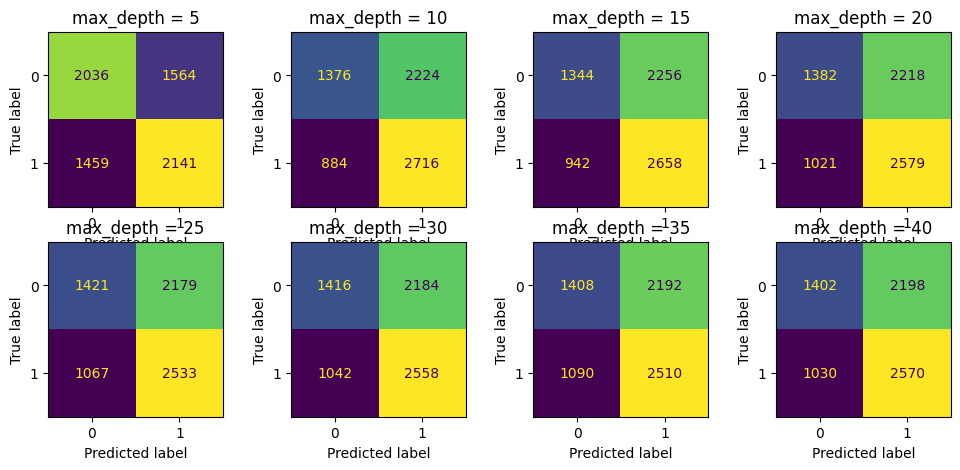

In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

cm_1 = confusion_matrix(y_test, DTC_pred[0])
cm_2 = confusion_matrix(y_test, DTC_pred[1])
cm_3 = confusion_matrix(y_test, DTC_pred[2])
cm_4 = confusion_matrix(y_test, DTC_pred[3])
cm_5 = confusion_matrix(y_test, DTC_pred[4])
cm_6 = confusion_matrix(y_test, DTC_pred[5])
cm_7 = confusion_matrix(y_test, DTC_pred[6])
cm_8 = confusion_matrix(y_test, DTC_pred[7])

fig, axes = plt.subplots(2, 4, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_depth = 5')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_depth = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_depth = 15')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_depth = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_depth = 25')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_depth = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_depth = 35')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_depth = 40')

#### Logistic Regression


In [ ]:
accuracy_LR = []
precision_LR = []
recall_LR = []
f1_LR = []
LR_pred = []
i = 10
while i<151:
  mod_dt = LogisticRegression(max_iter = i, random_state = 1)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  LR_pred.append(prediction)
  accuracy_LR.append(metrics.accuracy_score(prediction,y_test))
  precision_LR.append(metrics.precision_score(prediction,y_test))
  recall_LR.append(metrics.recall_score(prediction,y_test))
  f1_LR.append(metrics.f1_score(prediction,y_test))
  i+= 10

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _c

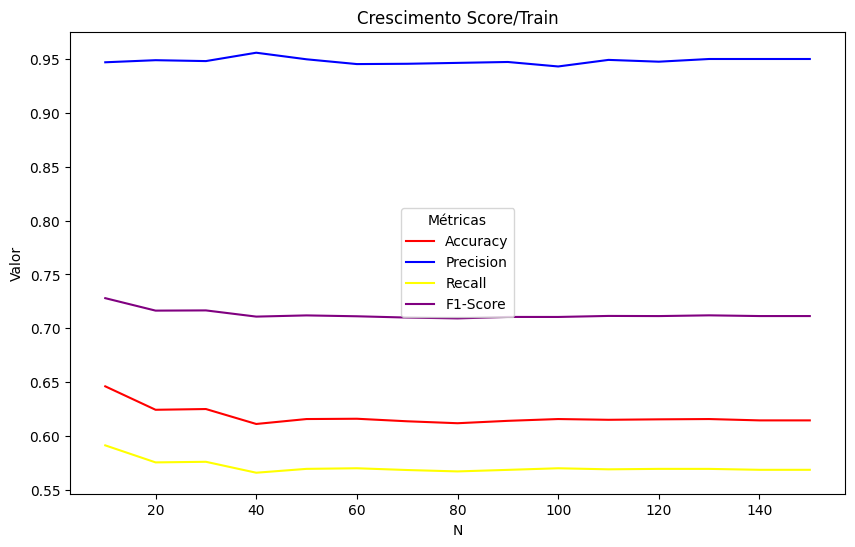

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [10,20,30,40,50,60,70,80,90,100,110,120,130,140,150]
data_l['accuracy'] = accuracy_LR
data_l['precision'] = precision_LR
data_l['recall'] = recall_LR
data_l['F1-score'] = f1_LR
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_iter = 150')

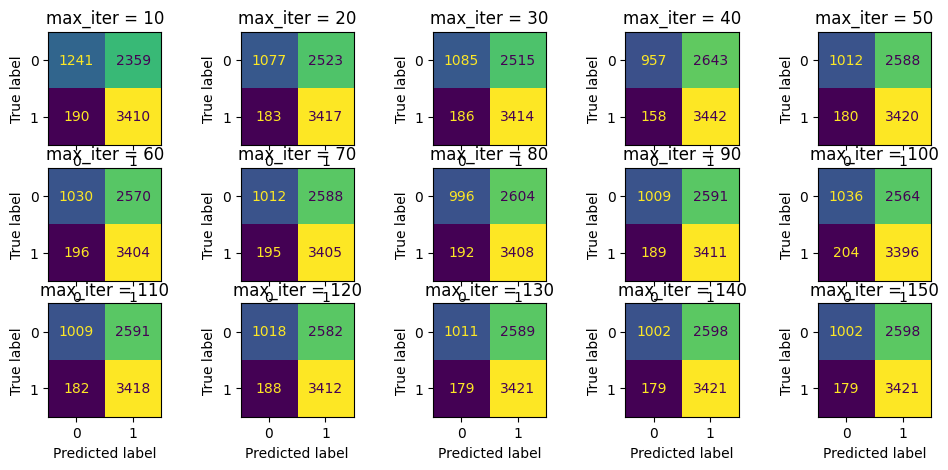

In [ ]:
cm_1 = confusion_matrix(y_test, LR_pred[0])
cm_2 = confusion_matrix(y_test, LR_pred[1])
cm_3 = confusion_matrix(y_test, LR_pred[2])
cm_4 = confusion_matrix(y_test, LR_pred[3])
cm_5 = confusion_matrix(y_test, LR_pred[4])
cm_6 = confusion_matrix(y_test, LR_pred[5])
cm_7 = confusion_matrix(y_test, LR_pred[6])
cm_8 = confusion_matrix(y_test, LR_pred[7])
cm_9 = confusion_matrix(y_test, LR_pred[8])
cm_10 = confusion_matrix(y_test, LR_pred[9])
cm_11 = confusion_matrix(y_test, LR_pred[10])
cm_12 = confusion_matrix(y_test, LR_pred[11])
cm_13 = confusion_matrix(y_test, LR_pred[12])
cm_14 = confusion_matrix(y_test, LR_pred[13])
cm_15 = confusion_matrix(y_test, LR_pred[14])

fig, axes = plt.subplots(3, 5, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_iter = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_iter = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_iter = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_iter = 40')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[0,4], colorbar=False)
axes[0,4].set_title('max_iter = 50')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_iter = 60')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_iter = 70')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_iter = 80')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_9)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_iter = 90')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_10)
disp_rfc.plot(ax=axes[1,4], colorbar=False)
axes[1,4].set_title('max_iter = 100')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_11)
disp_rfc.plot(ax=axes[2,0], colorbar=False)
axes[2,0].set_title('max_iter = 110')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_12)
disp_rfc.plot(ax=axes[2,1], colorbar=False)
axes[2,1].set_title('max_iter = 120')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_13)
disp_rfc.plot(ax=axes[2,2], colorbar=False)
axes[2,2].set_title('max_iter = 130')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_14)
disp_rfc.plot(ax=axes[2,3], colorbar=False)
axes[2,3].set_title('max_iter = 140')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_15)
disp_rfc.plot(ax=axes[2,4], colorbar=False)
axes[2,4].set_title('max_iter = 150')

#### Linear Support Vector Classifier


In [ ]:
accuracy_LSVC = []
precision_LSVC = []
recall_LSVC = []
f1_LSVC = []
LSVC_pred = []
i = 10
while i<151:
  mod_dt = LinearSVC(max_iter = i, random_state = 42)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  LSVC_pred.append(prediction)
  accuracy_LSVC.append(metrics.accuracy_score(prediction,y_test))
  precision_LSVC.append(metrics.precision_score(prediction,y_test))
  recall_LSVC.append(metrics.recall_score(prediction,y_test))
  f1_LSVC.append(metrics.f1_score(prediction,y_test))
  i+= 10

/usr/local/lib/python3.11/dist-packages/sklearn/svm/_base.py:1249: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


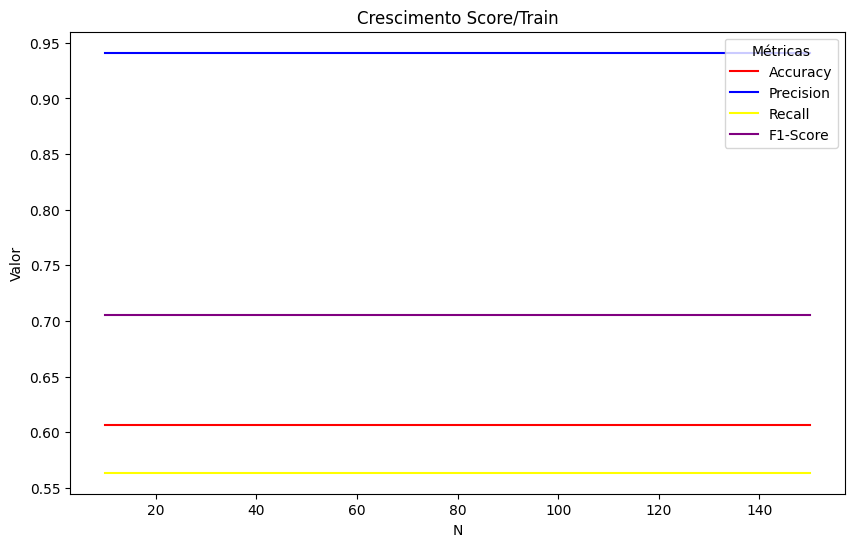

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [10,20,30,40,50,60,70,80,90,100,110,120,130,140,150]
data_l['accuracy'] = accuracy_LSVC
data_l['precision'] = precision_LSVC
data_l['recall'] = recall_LSVC
data_l['F1-score'] = f1_LSVC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_iter = 150')

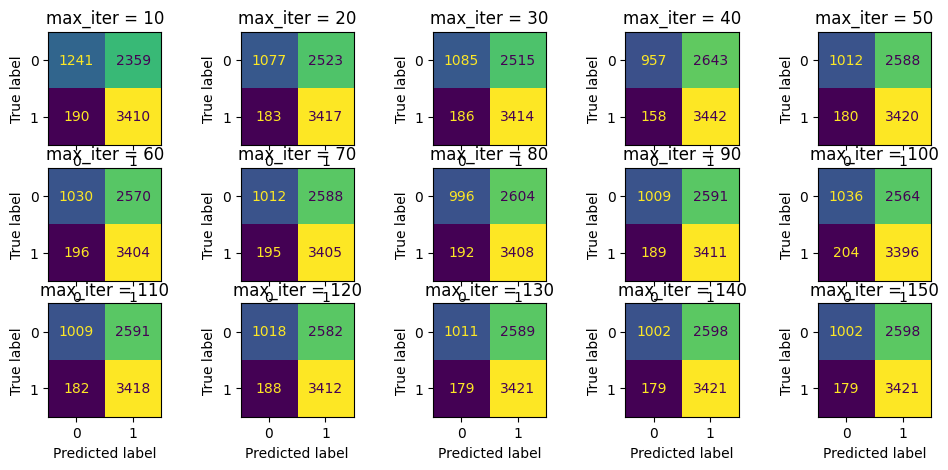

In [ ]:
cm_1 = confusion_matrix(y_test, LR_pred[0])
cm_2 = confusion_matrix(y_test, LR_pred[1])
cm_3 = confusion_matrix(y_test, LR_pred[2])
cm_4 = confusion_matrix(y_test, LR_pred[3])
cm_5 = confusion_matrix(y_test, LR_pred[4])
cm_6 = confusion_matrix(y_test, LR_pred[5])
cm_7 = confusion_matrix(y_test, LR_pred[6])
cm_8 = confusion_matrix(y_test, LR_pred[7])
cm_9 = confusion_matrix(y_test, LR_pred[8])
cm_10 = confusion_matrix(y_test, LR_pred[9])
cm_11 = confusion_matrix(y_test, LR_pred[10])
cm_12 = confusion_matrix(y_test, LR_pred[11])
cm_13 = confusion_matrix(y_test, LR_pred[12])
cm_14 = confusion_matrix(y_test, LR_pred[13])
cm_15 = confusion_matrix(y_test, LR_pred[14])

fig, axes = plt.subplots(3, 5, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_iter = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_iter = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_iter = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_iter = 40')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[0,4], colorbar=False)
axes[0,4].set_title('max_iter = 50')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_iter = 60')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_iter = 70')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_iter = 80')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_9)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_iter = 90')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_10)
disp_rfc.plot(ax=axes[1,4], colorbar=False)
axes[1,4].set_title('max_iter = 100')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_11)
disp_rfc.plot(ax=axes[2,0], colorbar=False)
axes[2,0].set_title('max_iter = 110')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_12)
disp_rfc.plot(ax=axes[2,1], colorbar=False)
axes[2,1].set_title('max_iter = 120')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_13)
disp_rfc.plot(ax=axes[2,2], colorbar=False)
axes[2,2].set_title('max_iter = 130')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_14)
disp_rfc.plot(ax=axes[2,3], colorbar=False)
axes[2,3].set_title('max_iter = 140')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_15)
disp_rfc.plot(ax=axes[2,4], colorbar=False)
axes[2,4].set_title('max_iter = 150')

#### Passive Aggressive Classifier


In [ ]:
accuracy_PAC = []
precision_PAC = []
recall_PAC = []
f1_PAC = []
PAC_pred = []
i = 5
while i<41:
  mod_dt = PassiveAggressiveClassifier(max_iter=i, random_state=42)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  PAC_pred.append(prediction)
  accuracy_PAC.append(metrics.accuracy_score(prediction,y_test))
  precision_PAC.append(metrics.precision_score(prediction,y_test))
  recall_PAC.append(metrics.recall_score(prediction,y_test))
  f1_PAC.append(metrics.f1_score(prediction,y_test))
  i+= 5

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:738: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:738: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:738: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:738: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic

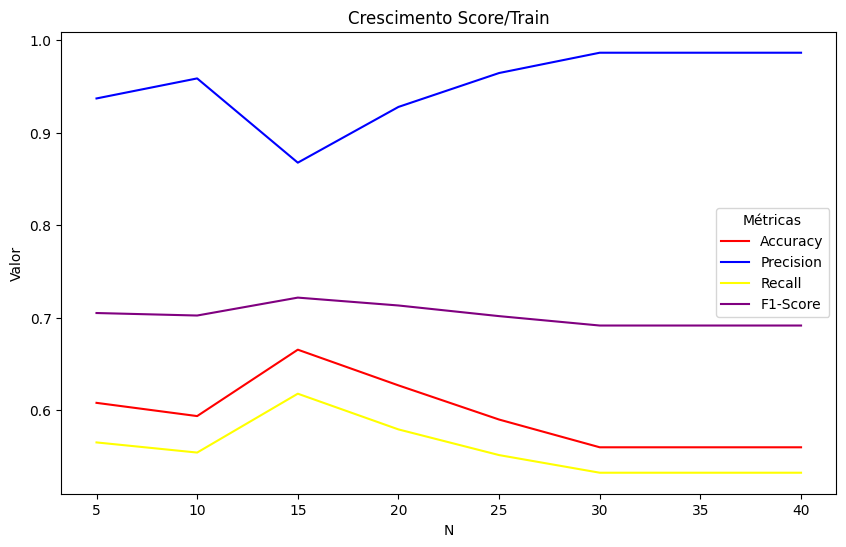

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [5,10,15,20,25,30,35,40]
data_l['accuracy'] = accuracy_PAC
data_l['precision'] = precision_PAC
data_l['recall'] = recall_PAC
data_l['F1-score'] = f1_PAC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_depth = 40')

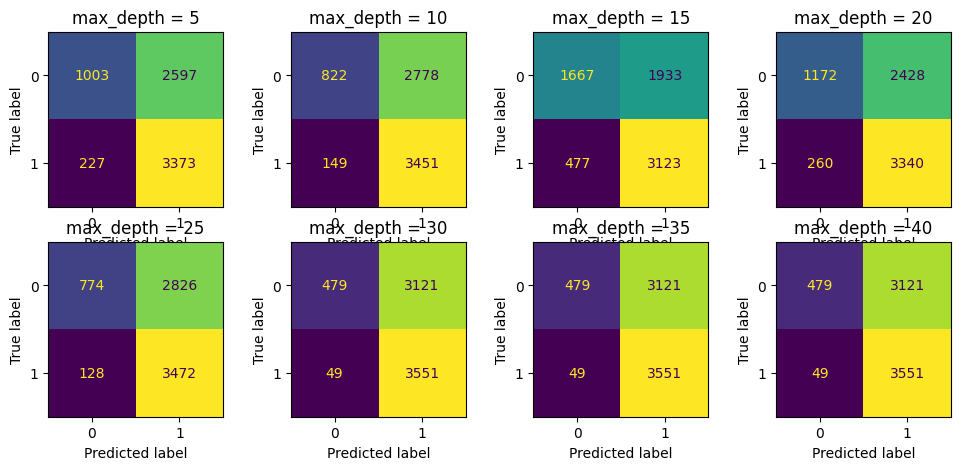

In [ ]:
cm_1 = confusion_matrix(y_test, PAC_pred[0])
cm_2 = confusion_matrix(y_test, PAC_pred[1])
cm_3 = confusion_matrix(y_test, PAC_pred[2])
cm_4 = confusion_matrix(y_test, PAC_pred[3])
cm_5 = confusion_matrix(y_test, PAC_pred[4])
cm_6 = confusion_matrix(y_test, PAC_pred[5])
cm_7 = confusion_matrix(y_test, PAC_pred[6])
cm_8 = confusion_matrix(y_test, PAC_pred[7])

fig, axes = plt.subplots(2, 4, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_depth = 5')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_depth = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_depth = 15')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_depth = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_depth = 25')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_depth = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_depth = 35')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_depth = 40')

## União dos Datasets Corrigidos:

In [ ]:
df_uniao_c.head()

,texto_corrigido,classificação
0,ministro celso melão manda recado políticos ma...,fake
1,e divulga vídeo ameaça frança eua vamos vingar...,fake
2,áudio estranho vaza youtube parte financeira n...,fake
3,francês de figuro faz matéria sobre dilema exg...,fake
4,planalto pânico sef pode devolver ações envolv...,fake


In [ ]:
df_uniao_c['num_palavras'] = df_uniao_c['texto_corrigido'].astype(str).apply(lambda x: len(x.split()))
print(df_uniao_c['num_palavras'].describe())

count    19103.000000
mean       176.381668
std        269.467479
min          1.000000
25%         52.000000
50%         75.000000
75%        136.500000
max       4112.000000
Name: num_palavras, dtype: float64


In [ ]:
palavras = " ".join(df_uniao_c['texto_corrigido'].astype(str)).split()
frequencia = Counter(palavras)
print(frequencia.most_common(10))  # Top 10 palavras mais frequentes

[('a', 22545), ('presidente', 21049), ('lula', 12848), ('federal', 11520), ('brasil', 11059), ('disse', 10619), ('dia', 10440), ('sobre', 9650), ('anos', 9486), ('país', 9401)]


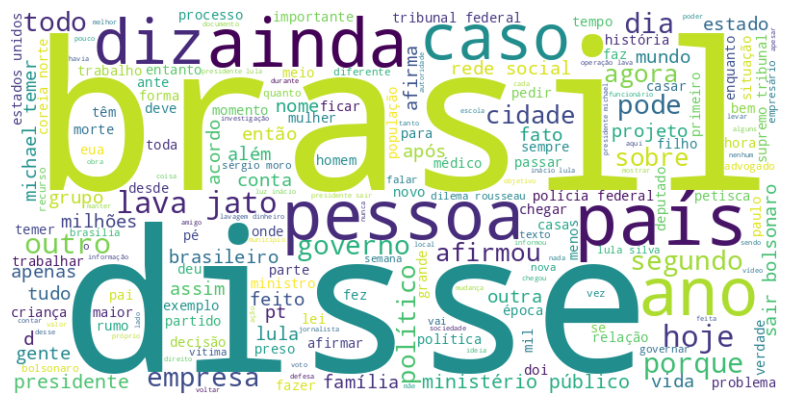

In [ ]:
texto = " ".join(df_uniao_c['texto_corrigido'].astype(str))
wordcloud = WordCloud(width=800, height=400, background_color="white").generate(texto)

plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()

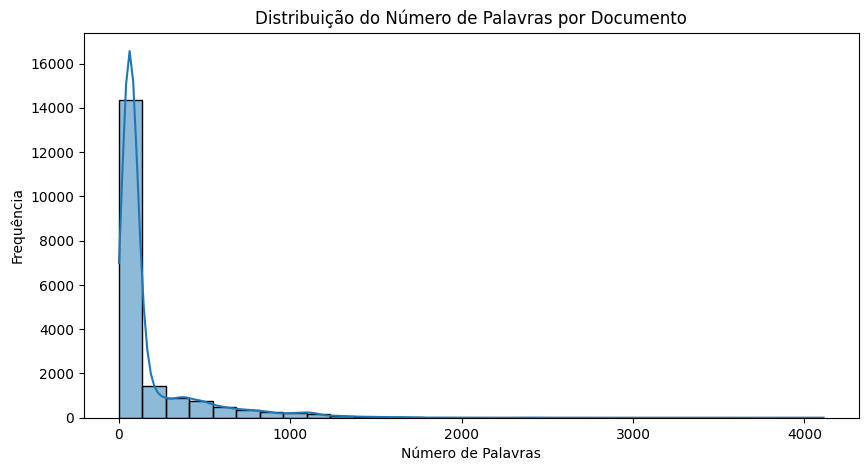

In [ ]:
plt.figure(figsize=(10,5))
sns.histplot(df_uniao_c['num_palavras'], bins=30, kde=True)
plt.xlabel("Número de Palavras")
plt.ylabel("Frequência")
plt.title("Distribuição do Número de Palavras por Documento")
plt.show()

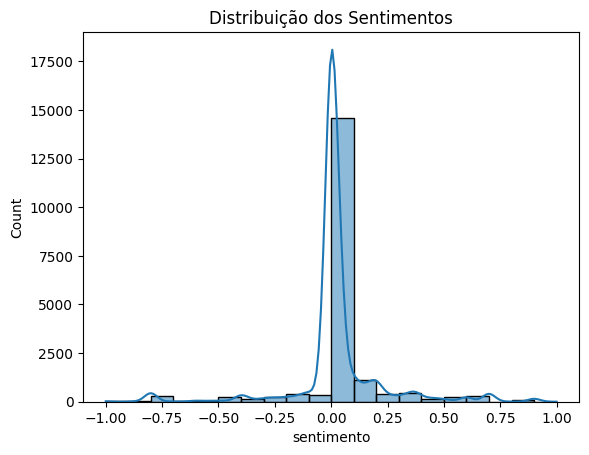

In [ ]:
from textblob import TextBlob

df_uniao_c['texto_corrigido'] = df_uniao_c['texto_corrigido'].astype(str)
df_uniao_c['sentimento'] = df_uniao_c['texto_corrigido'].apply(lambda x: TextBlob(x).sentiment.polarity)
sns.histplot(df_uniao_c['sentimento'], bins=20, kde=True)
plt.title("Distribuição dos Sentimentos")
plt.show()

## TF-IDF

In [ ]:
vetorizador = TfidfVectorizer()

x = vetorizador.fit_transform(df_uniao_c['texto_corrigido'].astype(str))
y = df_uniao_c['classificação'].apply(lambda x: 1 if 'true' in x else 0)

In [ ]:
x_train,x_test,y_train,y_test=train_test_split(x,y,random_state=9856,test_size=0.5)

### Random Forest Classifier

In [ ]:
accuracy_RFC = []
precision_RFC = []
recall_RFC = []
f1_RFC = []
score = []
RFC_pred = []
i = 5
while i<41:
  forest=RandomForestClassifier(max_depth = i,random_state=45)
  forest.fit(x_train,y_train)
  prediction=forest.predict(x_test)
  RFC_pred.append(prediction)
  accuracy_RFC.append(metrics.accuracy_score(prediction,y_test))
  precision_RFC.append(metrics.precision_score(prediction,y_test))
  recall_RFC.append(metrics.recall_score(prediction,y_test))
  f1_RFC.append(metrics.f1_score(prediction,y_test))
  i+= 5

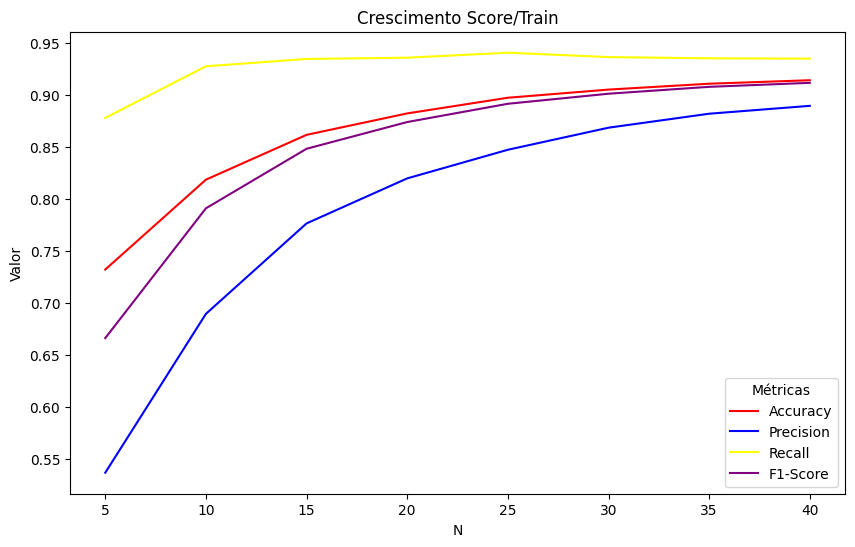

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [5,10,15,20,25,30,35,40]
data_l['accuracy'] = accuracy_RFC
data_l['precision'] = precision_RFC
data_l['recall'] = recall_RFC
data_l['F1-score'] = f1_RFC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_depth = 40')

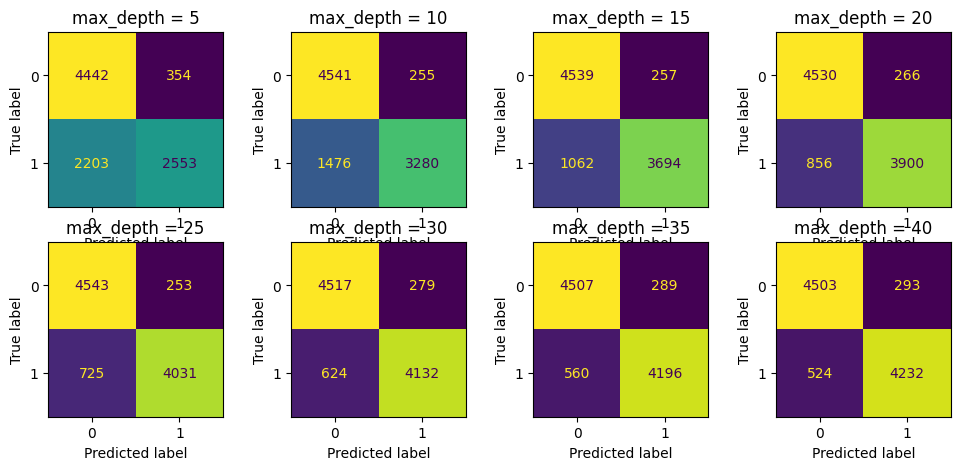

In [ ]:
cm_1 = confusion_matrix(y_test, RFC_pred[0])
cm_2 = confusion_matrix(y_test, RFC_pred[1])
cm_3 = confusion_matrix(y_test, RFC_pred[2])
cm_4 = confusion_matrix(y_test, RFC_pred[3])
cm_5 = confusion_matrix(y_test, RFC_pred[4])
cm_6 = confusion_matrix(y_test, RFC_pred[5])
cm_7 = confusion_matrix(y_test, RFC_pred[6])
cm_8 = confusion_matrix(y_test, RFC_pred[7])

fig, axes = plt.subplots(2, 4, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_depth = 5')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_depth = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_depth = 15')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_depth = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_depth = 25')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_depth = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_depth = 35')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_depth = 40')

### Decision Tree Classifier

In [ ]:
accuracy_DTC = []
precision_DTC = []
recall_DTC = []
f1_DTC = []
DTC_pred = []
i = 5
while i<41:
  mod_dt = DecisionTreeClassifier(max_depth = i, random_state = 1)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  DTC_pred.append(prediction)
  accuracy_DTC.append(metrics.accuracy_score(prediction,y_test))
  precision_DTC.append(metrics.precision_score(prediction,y_test))
  recall_DTC.append(metrics.recall_score(prediction,y_test))
  f1_DTC.append(metrics.f1_score(prediction,y_test))
  i+= 5

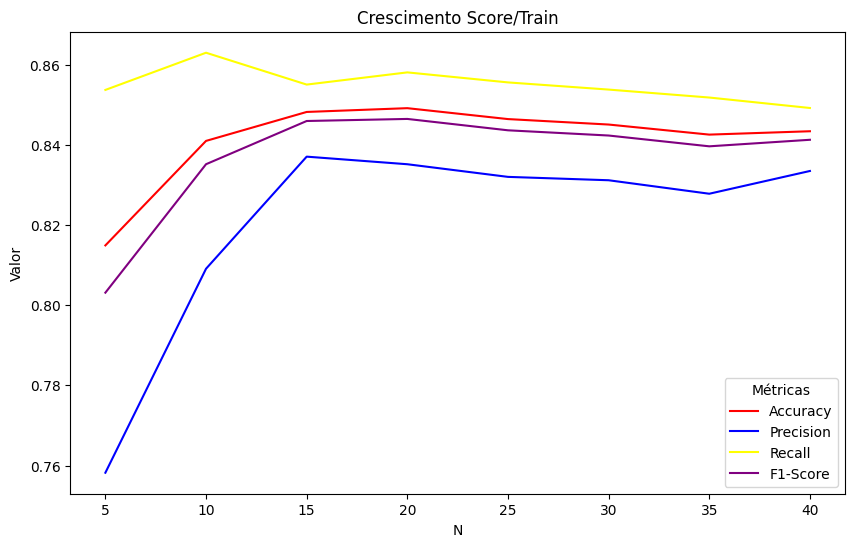

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [5,10,15,20,25,30,35,40]
data_l['accuracy'] = accuracy_DTC
data_l['precision'] = precision_DTC
data_l['recall'] = recall_DTC
data_l['F1-score'] = f1_DTC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_depth = 40')

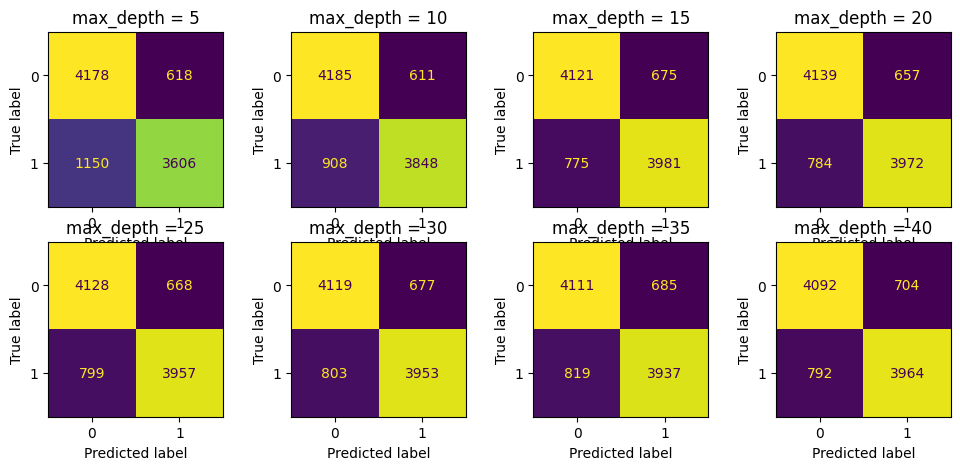

In [ ]:
cm_1 = confusion_matrix(y_test, DTC_pred[0])
cm_2 = confusion_matrix(y_test, DTC_pred[1])
cm_3 = confusion_matrix(y_test, DTC_pred[2])
cm_4 = confusion_matrix(y_test, DTC_pred[3])
cm_5 = confusion_matrix(y_test, DTC_pred[4])
cm_6 = confusion_matrix(y_test, DTC_pred[5])
cm_7 = confusion_matrix(y_test, DTC_pred[6])
cm_8 = confusion_matrix(y_test, DTC_pred[7])

fig, axes = plt.subplots(2, 4, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_depth = 5')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_depth = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_depth = 15')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_depth = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_depth = 25')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_depth = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_depth = 35')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_depth = 40')

### Logistic Regression


In [ ]:
accuracy_LR = []
precision_LR = []
recall_LR = []
f1_LR = []
LR_pred = []
i = 10
while i<151:
  mod_dt = LogisticRegression(max_iter = i, random_state = 1)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  LR_pred.append(prediction)
  accuracy_LR.append(metrics.accuracy_score(prediction,y_test))
  precision_LR.append(metrics.precision_score(prediction,y_test))
  recall_LR.append(metrics.recall_score(prediction,y_test))
  f1_LR.append(metrics.f1_score(prediction,y_test))
  i+= 10

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. OF ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. OF ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _c

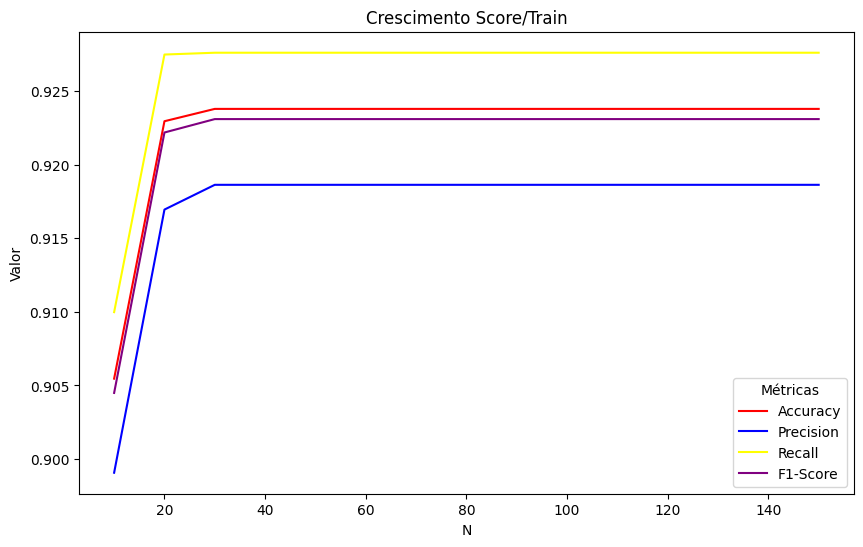

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [10,20,30,40,50,60,70,80,90,100,110,120,130,140,150]
data_l['accuracy'] = accuracy_LR
data_l['precision'] = precision_LR
data_l['recall'] = recall_LR
data_l['F1-score'] = f1_LR
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_iter = 150')

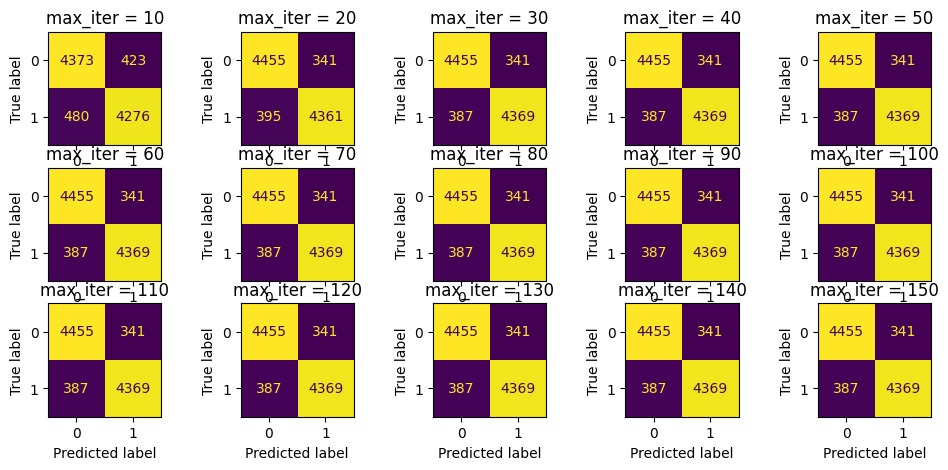

In [ ]:
cm_1 = confusion_matrix(y_test, LR_pred[0])
cm_2 = confusion_matrix(y_test, LR_pred[1])
cm_3 = confusion_matrix(y_test, LR_pred[2])
cm_4 = confusion_matrix(y_test, LR_pred[3])
cm_5 = confusion_matrix(y_test, LR_pred[4])
cm_6 = confusion_matrix(y_test, LR_pred[5])
cm_7 = confusion_matrix(y_test, LR_pred[6])
cm_8 = confusion_matrix(y_test, LR_pred[7])
cm_9 = confusion_matrix(y_test, LR_pred[8])
cm_10 = confusion_matrix(y_test, LR_pred[9])
cm_11 = confusion_matrix(y_test, LR_pred[10])
cm_12 = confusion_matrix(y_test, LR_pred[11])
cm_13 = confusion_matrix(y_test, LR_pred[12])
cm_14 = confusion_matrix(y_test, LR_pred[13])
cm_15 = confusion_matrix(y_test, LR_pred[14])

fig, axes = plt.subplots(3, 5, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_iter = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_iter = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_iter = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_iter = 40')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[0,4], colorbar=False)
axes[0,4].set_title('max_iter = 50')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_iter = 60')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_iter = 70')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_iter = 80')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_9)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_iter = 90')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_10)
disp_rfc.plot(ax=axes[1,4], colorbar=False)
axes[1,4].set_title('max_iter = 100')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_11)
disp_rfc.plot(ax=axes[2,0], colorbar=False)
axes[2,0].set_title('max_iter = 110')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_12)
disp_rfc.plot(ax=axes[2,1], colorbar=False)
axes[2,1].set_title('max_iter = 120')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_13)
disp_rfc.plot(ax=axes[2,2], colorbar=False)
axes[2,2].set_title('max_iter = 130')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_14)
disp_rfc.plot(ax=axes[2,3], colorbar=False)
axes[2,3].set_title('max_iter = 140')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_15)
disp_rfc.plot(ax=axes[2,4], colorbar=False)
axes[2,4].set_title('max_iter = 150')

### Linear Support Vector Classifier


In [ ]:
accuracy_LSVC = []
precision_LSVC = []
recall_LSVC = []
f1_LSVC = []
LSVC_pred = []
i = 10
while i<151:
  mod_dt = LinearSVC(max_iter = i, random_state = 42)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  LSVC_pred.append(prediction)
  accuracy_LSVC.append(metrics.accuracy_score(prediction,y_test))
  precision_LSVC.append(metrics.precision_score(prediction,y_test))
  recall_LSVC.append(metrics.recall_score(prediction,y_test))
  f1_LSVC.append(metrics.f1_score(prediction,y_test))
  i+= 10

/usr/local/lib/python3.11/dist-packages/sklearn/svm/_base.py:1249: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/svm/_base.py:1249: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/svm/_base.py:1249: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


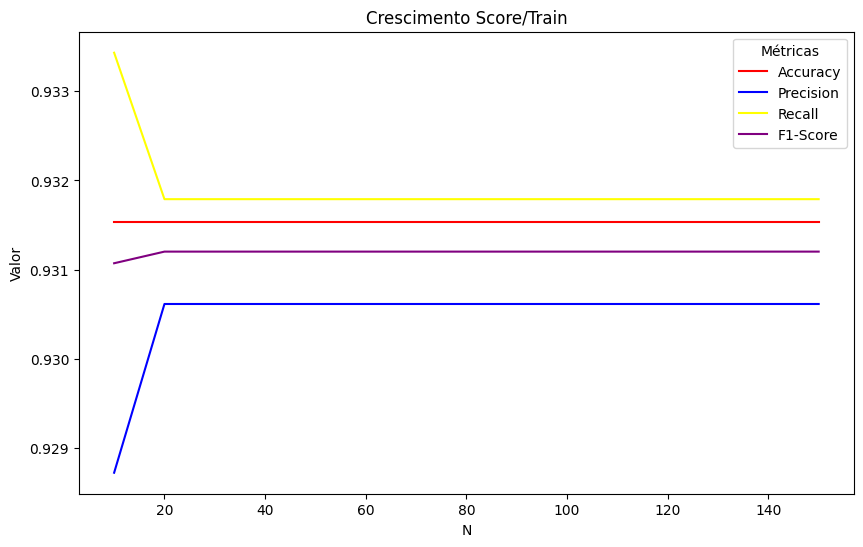

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [10,20,30,40,50,60,70,80,90,100,110,120,130,140,150]
data_l['accuracy'] = accuracy_LSVC
data_l['precision'] = precision_LSVC
data_l['recall'] = recall_LSVC
data_l['F1-score'] = f1_LSVC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_iter = 150')

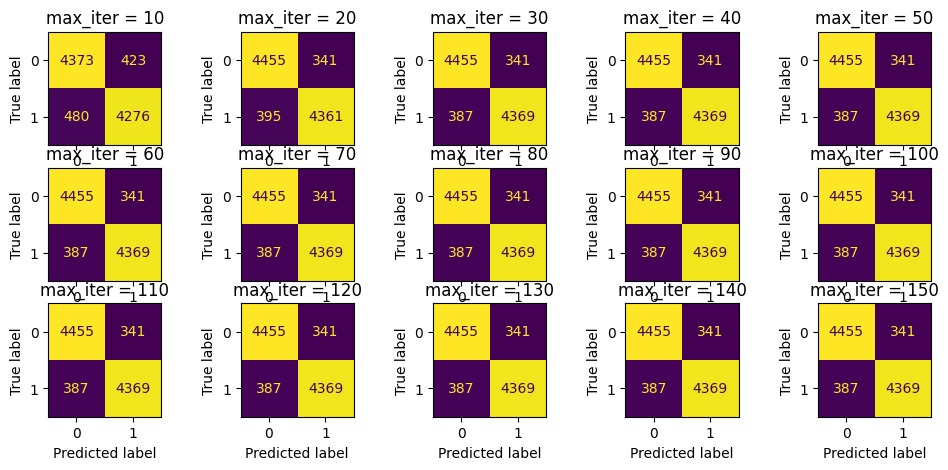

In [ ]:
cm_1 = confusion_matrix(y_test, LR_pred[0])
cm_2 = confusion_matrix(y_test, LR_pred[1])
cm_3 = confusion_matrix(y_test, LR_pred[2])
cm_4 = confusion_matrix(y_test, LR_pred[3])
cm_5 = confusion_matrix(y_test, LR_pred[4])
cm_6 = confusion_matrix(y_test, LR_pred[5])
cm_7 = confusion_matrix(y_test, LR_pred[6])
cm_8 = confusion_matrix(y_test, LR_pred[7])
cm_9 = confusion_matrix(y_test, LR_pred[8])
cm_10 = confusion_matrix(y_test, LR_pred[9])
cm_11 = confusion_matrix(y_test, LR_pred[10])
cm_12 = confusion_matrix(y_test, LR_pred[11])
cm_13 = confusion_matrix(y_test, LR_pred[12])
cm_14 = confusion_matrix(y_test, LR_pred[13])
cm_15 = confusion_matrix(y_test, LR_pred[14])

fig, axes = plt.subplots(3, 5, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_iter = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_iter = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_iter = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_iter = 40')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[0,4], colorbar=False)
axes[0,4].set_title('max_iter = 50')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_iter = 60')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_iter = 70')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_iter = 80')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_9)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_iter = 90')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_10)
disp_rfc.plot(ax=axes[1,4], colorbar=False)
axes[1,4].set_title('max_iter = 100')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_11)
disp_rfc.plot(ax=axes[2,0], colorbar=False)
axes[2,0].set_title('max_iter = 110')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_12)
disp_rfc.plot(ax=axes[2,1], colorbar=False)
axes[2,1].set_title('max_iter = 120')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_13)
disp_rfc.plot(ax=axes[2,2], colorbar=False)
axes[2,2].set_title('max_iter = 130')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_14)
disp_rfc.plot(ax=axes[2,3], colorbar=False)
axes[2,3].set_title('max_iter = 140')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_15)
disp_rfc.plot(ax=axes[2,4], colorbar=False)
axes[2,4].set_title('max_iter = 150')

### Passive Aggressive Classifier


In [ ]:
accuracy_PAC = []
precision_PAC = []
recall_PAC = []
f1_PAC = []
PAC_pred = []
i = 5
while i<41:
  mod_dt = PassiveAggressiveClassifier(max_iter=i, random_state=42)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  PAC_pred.append(prediction)
  accuracy_PAC.append(metrics.accuracy_score(prediction,y_test))
  precision_PAC.append(metrics.precision_score(prediction,y_test))
  recall_PAC.append(metrics.recall_score(prediction,y_test))
  f1_PAC.append(metrics.f1_score(prediction,y_test))
  i+= 5

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:738: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:738: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(


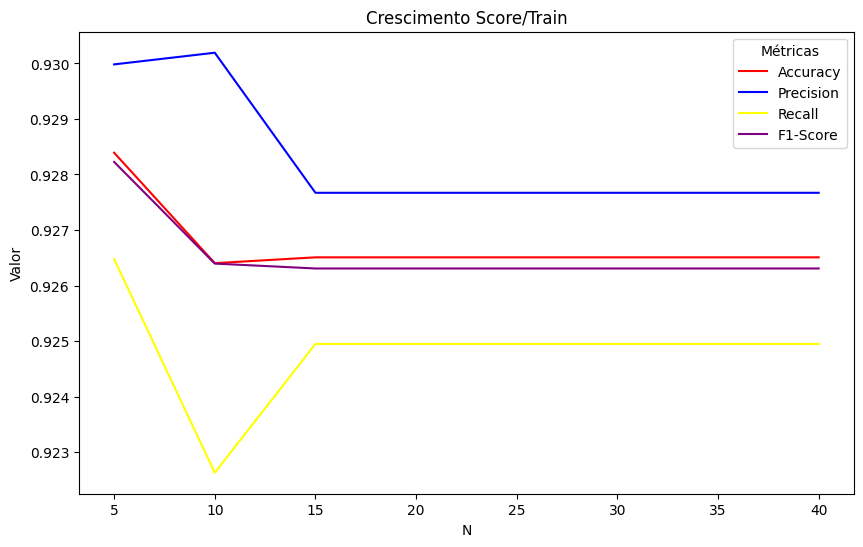

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [5,10,15,20,25,30,35,40]
data_l['accuracy'] = accuracy_PAC
data_l['precision'] = precision_PAC
data_l['recall'] = recall_PAC
data_l['F1-score'] = f1_PAC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_depth = 40')

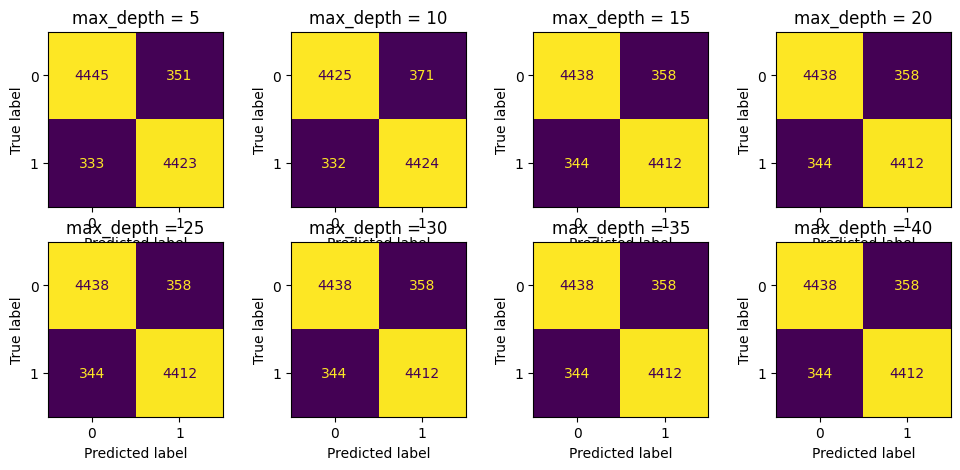

In [ ]:
cm_1 = confusion_matrix(y_test, PAC_pred[0])
cm_2 = confusion_matrix(y_test, PAC_pred[1])
cm_3 = confusion_matrix(y_test, PAC_pred[2])
cm_4 = confusion_matrix(y_test, PAC_pred[3])
cm_5 = confusion_matrix(y_test, PAC_pred[4])
cm_6 = confusion_matrix(y_test, PAC_pred[5])
cm_7 = confusion_matrix(y_test, PAC_pred[6])
cm_8 = confusion_matrix(y_test, PAC_pred[7])

fig, axes = plt.subplots(2, 4, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_depth = 5')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_depth = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_depth = 15')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_depth = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_depth = 25')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_depth = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_depth = 35')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_depth = 40')

## Word2Vec


In [ ]:
# 1. Tokenize os textos
textos_tokenizados = [str(texto).split() for texto in df_uniao_c['texto_corrigido']]

# 2. Treine o modelo Word2Vec (ou carregue um pronto)
w2v_model = Word2Vec(sentences=textos_tokenizados, vector_size=100, window=5, min_count=1)

# 3. Função que transforma um texto em vetor médio
def vetor_medio(texto, modelo):
    vetores = [modelo.wv[word] for word in texto if word in modelo.wv]
    return np.mean(vetores, axis=0) if vetores else np.zeros(modelo.vector_size)

# 4. Criar o conjunto de vetores
X_w2v = np.array([vetor_medio(texto, w2v_model) for texto in textos_tokenizados])
y = df_uniao_c['classificação'].apply(lambda x: 1 if 'true' in x else 0)  # Rótulo

In [ ]:
x_train, x_test, y_train, y_test = train_test_split(X_w2v, y, test_size=0.5, random_state=42)

### Random Forest Classifier

In [ ]:
accuracy_RFC = []
precision_RFC = []
recall_RFC = []
f1_RFC = []
score = []
RFC_pred = []
i = 5
while i<41:
  forest=RandomForestClassifier(max_depth = i,random_state=45)
  forest.fit(x_train,y_train)
  prediction=forest.predict(x_test)
  RFC_pred.append(prediction)
  accuracy_RFC.append(metrics.accuracy_score(prediction,y_test))
  precision_RFC.append(metrics.precision_score(prediction,y_test))
  recall_RFC.append(metrics.recall_score(prediction,y_test))
  f1_RFC.append(metrics.f1_score(prediction,y_test))
  i+= 5

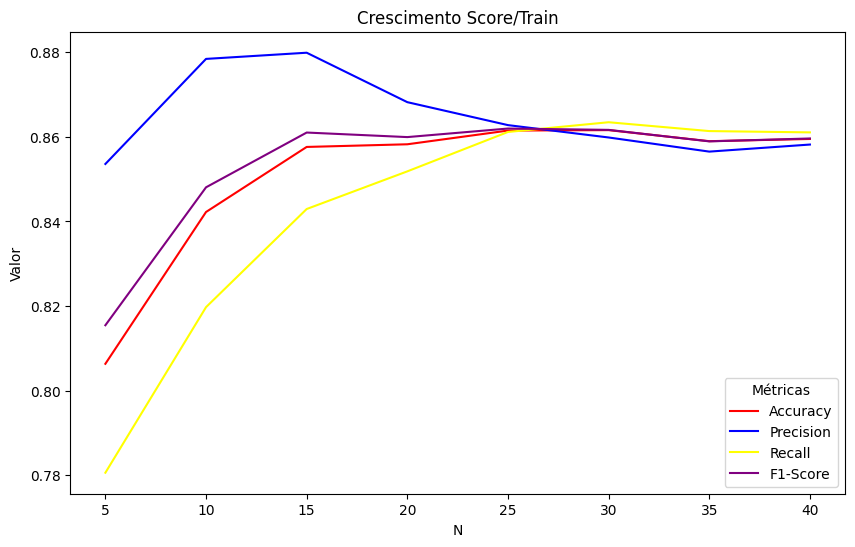

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [5,10,15,20,25,30,35,40]
data_l['accuracy'] = accuracy_RFC
data_l['precision'] = precision_RFC
data_l['recall'] = recall_RFC
data_l['F1-score'] = f1_RFC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_depth = 40')

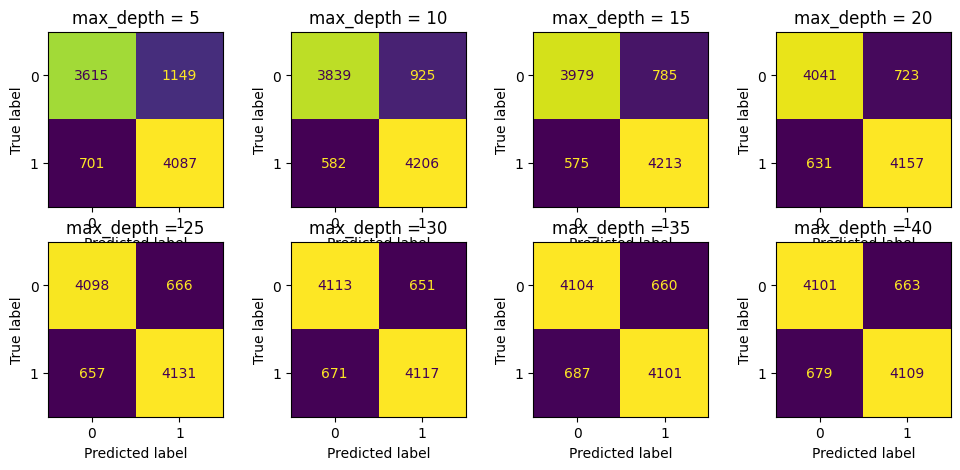

In [ ]:
cm_1 = confusion_matrix(y_test, RFC_pred[0])
cm_2 = confusion_matrix(y_test, RFC_pred[1])
cm_3 = confusion_matrix(y_test, RFC_pred[2])
cm_4 = confusion_matrix(y_test, RFC_pred[3])
cm_5 = confusion_matrix(y_test, RFC_pred[4])
cm_6 = confusion_matrix(y_test, RFC_pred[5])
cm_7 = confusion_matrix(y_test, RFC_pred[6])
cm_8 = confusion_matrix(y_test, RFC_pred[7])

fig, axes = plt.subplots(2, 4, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_depth = 5')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_depth = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_depth = 15')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_depth = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_depth = 25')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_depth = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_depth = 35')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_depth = 40')

### Decision Tree Classifier

In [ ]:
accuracy_DTC = []
precision_DTC = []
recall_DTC = []
f1_DTC = []
DTC_pred = []
i = 5
while i<41:
  mod_dt = DecisionTreeClassifier(max_depth = i, random_state = 1)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  DTC_pred.append(prediction)
  accuracy_DTC.append(metrics.accuracy_score(prediction,y_test))
  precision_DTC.append(metrics.precision_score(prediction,y_test))
  recall_DTC.append(metrics.recall_score(prediction,y_test))
  f1_DTC.append(metrics.f1_score(prediction,y_test))
  i+= 5

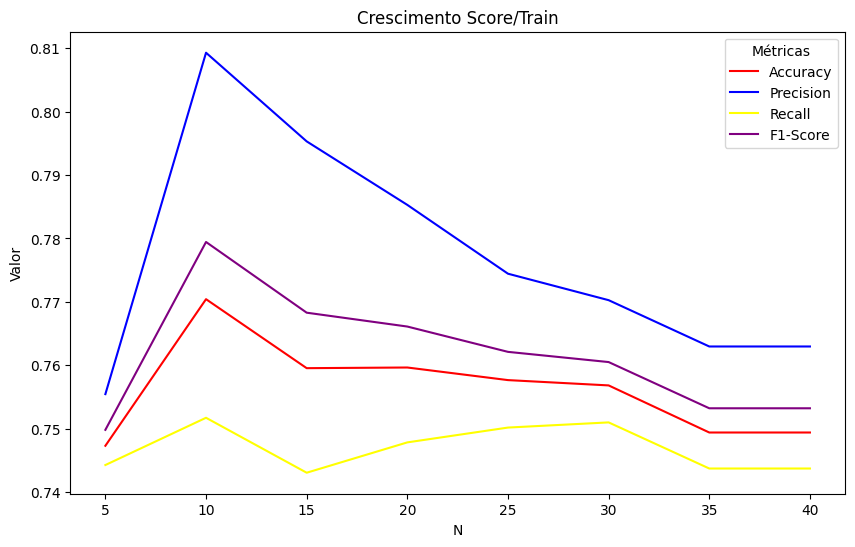

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [5,10,15,20,25,30,35,40]
data_l['accuracy'] = accuracy_DTC
data_l['precision'] = precision_DTC
data_l['recall'] = recall_DTC
data_l['F1-score'] = f1_DTC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_depth = 40')

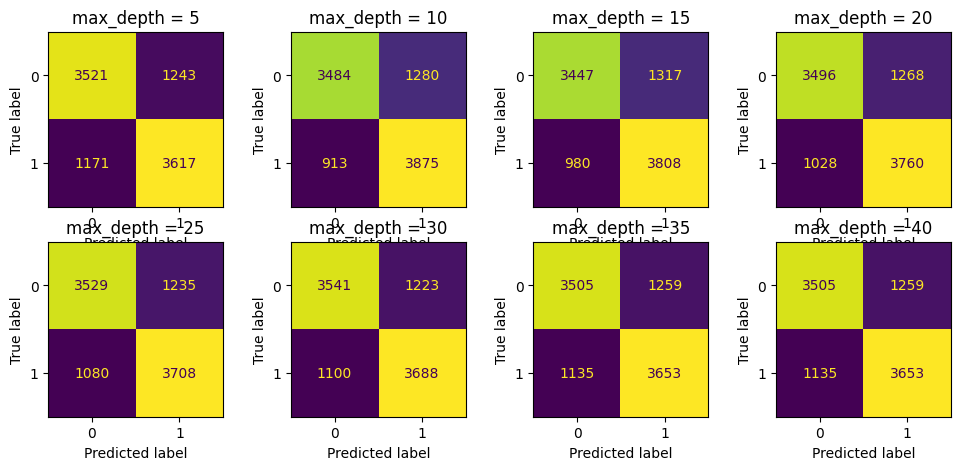

In [ ]:
cm_1 = confusion_matrix(y_test, DTC_pred[0])
cm_2 = confusion_matrix(y_test, DTC_pred[1])
cm_3 = confusion_matrix(y_test, DTC_pred[2])
cm_4 = confusion_matrix(y_test, DTC_pred[3])
cm_5 = confusion_matrix(y_test, DTC_pred[4])
cm_6 = confusion_matrix(y_test, DTC_pred[5])
cm_7 = confusion_matrix(y_test, DTC_pred[6])
cm_8 = confusion_matrix(y_test, DTC_pred[7])

fig, axes = plt.subplots(2, 4, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_depth = 5')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_depth = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_depth = 15')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_depth = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_depth = 25')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_depth = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_depth = 35')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_depth = 40')

### Logistic Regression


In [ ]:
accuracy_LR = []
precision_LR = []
recall_LR = []
f1_LR = []
LR_pred = []
i = 10
while i<151:
  mod_dt = LogisticRegression(max_iter = i, random_state = 1)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  LR_pred.append(prediction)
  accuracy_LR.append(metrics.accuracy_score(prediction,y_test))
  precision_LR.append(metrics.precision_score(prediction,y_test))
  recall_LR.append(metrics.recall_score(prediction,y_test))
  f1_LR.append(metrics.f1_score(prediction,y_test))
  i+= 10

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _c

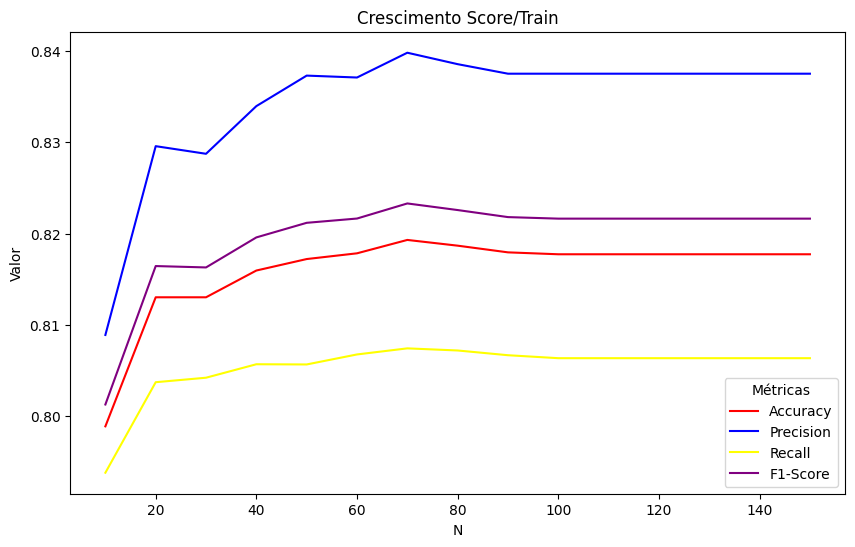

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [10,20,30,40,50,60,70,80,90,100,110,120,130,140,150]
data_l['accuracy'] = accuracy_LR
data_l['precision'] = precision_LR
data_l['recall'] = recall_LR
data_l['F1-score'] = f1_LR
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_iter = 150')

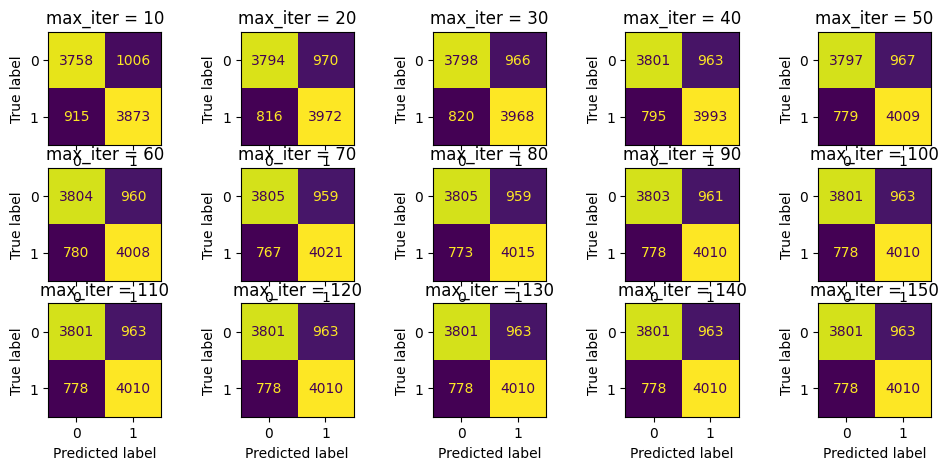

In [ ]:
cm_1 = confusion_matrix(y_test, LR_pred[0])
cm_2 = confusion_matrix(y_test, LR_pred[1])
cm_3 = confusion_matrix(y_test, LR_pred[2])
cm_4 = confusion_matrix(y_test, LR_pred[3])
cm_5 = confusion_matrix(y_test, LR_pred[4])
cm_6 = confusion_matrix(y_test, LR_pred[5])
cm_7 = confusion_matrix(y_test, LR_pred[6])
cm_8 = confusion_matrix(y_test, LR_pred[7])
cm_9 = confusion_matrix(y_test, LR_pred[8])
cm_10 = confusion_matrix(y_test, LR_pred[9])
cm_11 = confusion_matrix(y_test, LR_pred[10])
cm_12 = confusion_matrix(y_test, LR_pred[11])
cm_13 = confusion_matrix(y_test, LR_pred[12])
cm_14 = confusion_matrix(y_test, LR_pred[13])
cm_15 = confusion_matrix(y_test, LR_pred[14])

fig, axes = plt.subplots(3, 5, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_iter = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_iter = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_iter = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_iter = 40')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[0,4], colorbar=False)
axes[0,4].set_title('max_iter = 50')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_iter = 60')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_iter = 70')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_iter = 80')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_9)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_iter = 90')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_10)
disp_rfc.plot(ax=axes[1,4], colorbar=False)
axes[1,4].set_title('max_iter = 100')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_11)
disp_rfc.plot(ax=axes[2,0], colorbar=False)
axes[2,0].set_title('max_iter = 110')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_12)
disp_rfc.plot(ax=axes[2,1], colorbar=False)
axes[2,1].set_title('max_iter = 120')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_13)
disp_rfc.plot(ax=axes[2,2], colorbar=False)
axes[2,2].set_title('max_iter = 130')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_14)
disp_rfc.plot(ax=axes[2,3], colorbar=False)
axes[2,3].set_title('max_iter = 140')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_15)
disp_rfc.plot(ax=axes[2,4], colorbar=False)
axes[2,4].set_title('max_iter = 150')

### Linear Support Vector Classifier


In [ ]:
accuracy_LSVC = []
precision_LSVC = []
recall_LSVC = []
f1_LSVC = []
LSVC_pred = []
i = 10
while i<151:
  mod_dt = LinearSVC(max_iter = i, random_state = 42)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  LSVC_pred.append(prediction)
  accuracy_LSVC.append(metrics.accuracy_score(prediction,y_test))
  precision_LSVC.append(metrics.precision_score(prediction,y_test))
  recall_LSVC.append(metrics.recall_score(prediction,y_test))
  f1_LSVC.append(metrics.f1_score(prediction,y_test))
  i+= 10

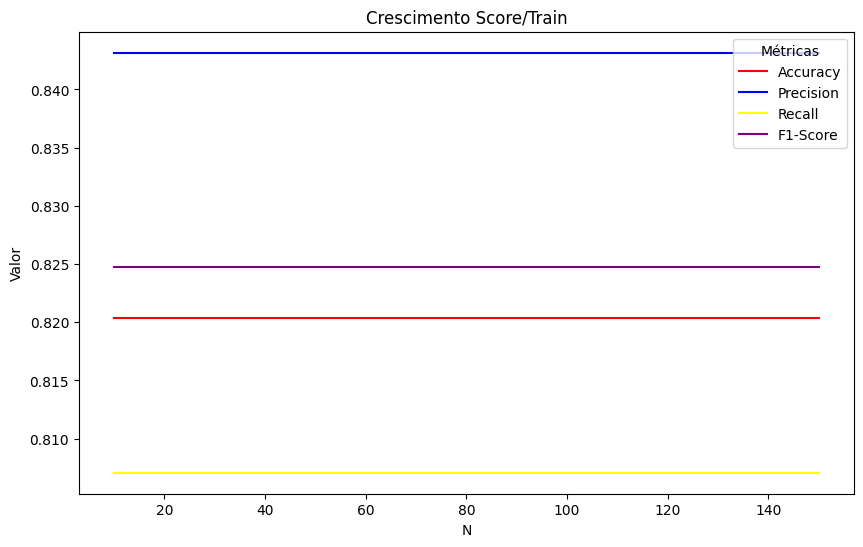

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [10,20,30,40,50,60,70,80,90,100,110,120,130,140,150]
data_l['accuracy'] = accuracy_LSVC
data_l['precision'] = precision_LSVC
data_l['recall'] = recall_LSVC
data_l['F1-score'] = f1_LSVC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_iter = 150')

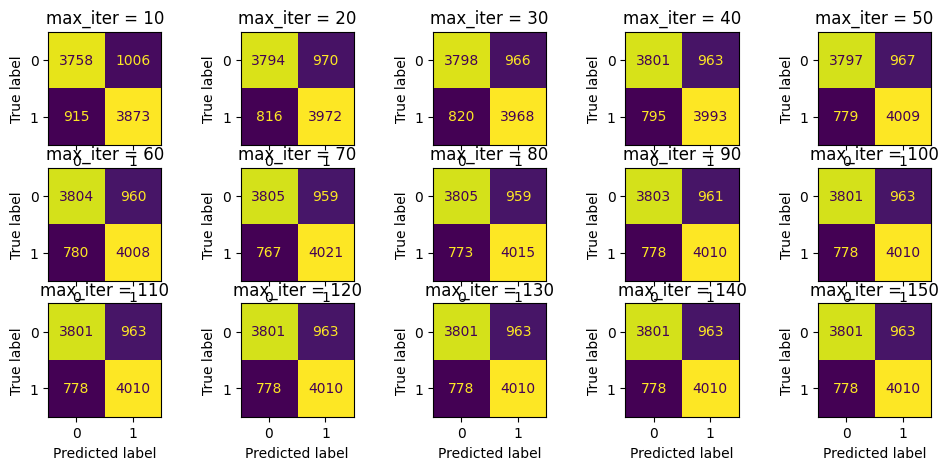

In [ ]:
cm_1 = confusion_matrix(y_test, LR_pred[0])
cm_2 = confusion_matrix(y_test, LR_pred[1])
cm_3 = confusion_matrix(y_test, LR_pred[2])
cm_4 = confusion_matrix(y_test, LR_pred[3])
cm_5 = confusion_matrix(y_test, LR_pred[4])
cm_6 = confusion_matrix(y_test, LR_pred[5])
cm_7 = confusion_matrix(y_test, LR_pred[6])
cm_8 = confusion_matrix(y_test, LR_pred[7])
cm_9 = confusion_matrix(y_test, LR_pred[8])
cm_10 = confusion_matrix(y_test, LR_pred[9])
cm_11 = confusion_matrix(y_test, LR_pred[10])
cm_12 = confusion_matrix(y_test, LR_pred[11])
cm_13 = confusion_matrix(y_test, LR_pred[12])
cm_14 = confusion_matrix(y_test, LR_pred[13])
cm_15 = confusion_matrix(y_test, LR_pred[14])

fig, axes = plt.subplots(3, 5, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_iter = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_iter = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_iter = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_iter = 40')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[0,4], colorbar=False)
axes[0,4].set_title('max_iter = 50')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_iter = 60')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_iter = 70')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_iter = 80')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_9)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_iter = 90')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_10)
disp_rfc.plot(ax=axes[1,4], colorbar=False)
axes[1,4].set_title('max_iter = 100')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_11)
disp_rfc.plot(ax=axes[2,0], colorbar=False)
axes[2,0].set_title('max_iter = 110')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_12)
disp_rfc.plot(ax=axes[2,1], colorbar=False)
axes[2,1].set_title('max_iter = 120')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_13)
disp_rfc.plot(ax=axes[2,2], colorbar=False)
axes[2,2].set_title('max_iter = 130')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_14)
disp_rfc.plot(ax=axes[2,3], colorbar=False)
axes[2,3].set_title('max_iter = 140')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_15)
disp_rfc.plot(ax=axes[2,4], colorbar=False)
axes[2,4].set_title('max_iter = 150')

### Passive Aggressive Classifier


In [ ]:
accuracy_PAC = []
precision_PAC = []
recall_PAC = []
f1_PAC = []
PAC_pred = []
i = 5
while i<41:
  mod_dt = PassiveAggressiveClassifier(max_iter=i, random_state=42)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  PAC_pred.append(prediction)
  accuracy_PAC.append(metrics.accuracy_score(prediction,y_test))
  precision_PAC.append(metrics.precision_score(prediction,y_test))
  recall_PAC.append(metrics.recall_score(prediction,y_test))
  f1_PAC.append(metrics.f1_score(prediction,y_test))
  i+= 5

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:738: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:738: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(


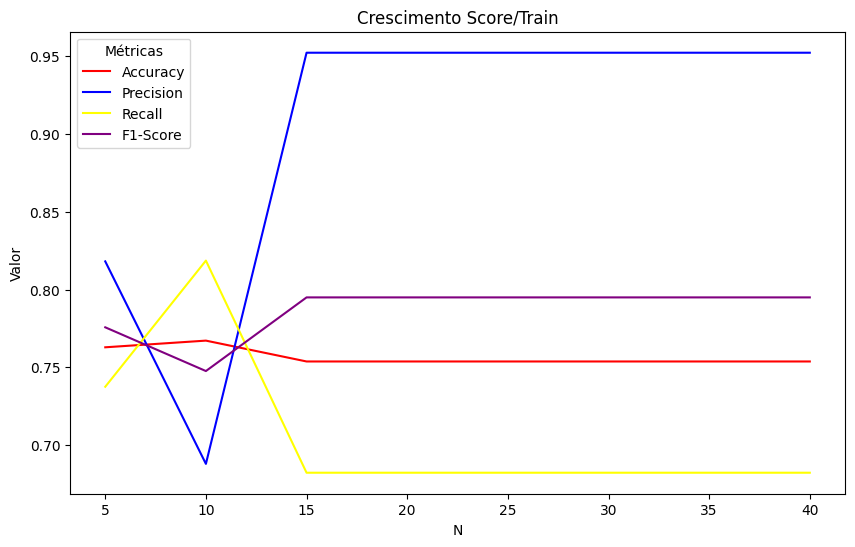

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [5,10,15,20,25,30,35,40]
data_l['accuracy'] = accuracy_PAC
data_l['precision'] = precision_PAC
data_l['recall'] = recall_PAC
data_l['F1-score'] = f1_PAC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_depth = 40')

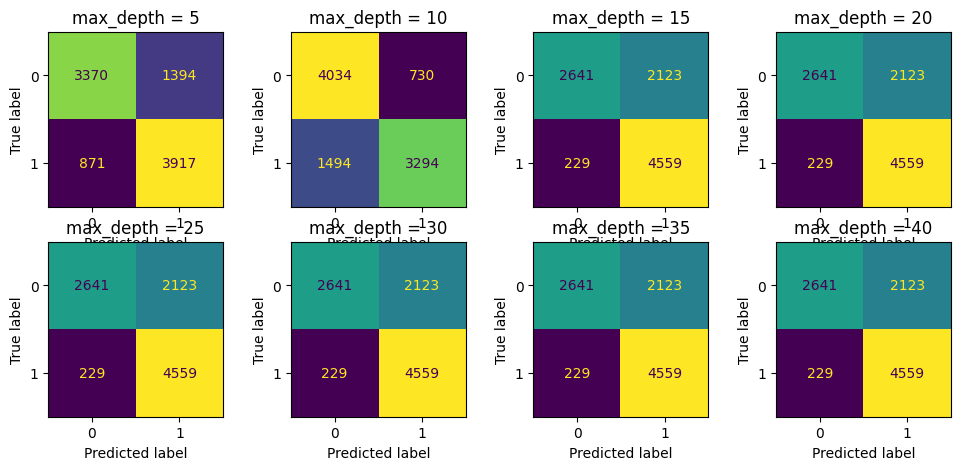

In [ ]:
cm_1 = confusion_matrix(y_test, PAC_pred[0])
cm_2 = confusion_matrix(y_test, PAC_pred[1])
cm_3 = confusion_matrix(y_test, PAC_pred[2])
cm_4 = confusion_matrix(y_test, PAC_pred[3])
cm_5 = confusion_matrix(y_test, PAC_pred[4])
cm_6 = confusion_matrix(y_test, PAC_pred[5])
cm_7 = confusion_matrix(y_test, PAC_pred[6])
cm_8 = confusion_matrix(y_test, PAC_pred[7])

fig, axes = plt.subplots(2, 4, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_depth = 5')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_depth = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_depth = 15')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_depth = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_depth = 25')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_depth = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_depth = 35')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_depth = 40')

## BERT

In [ ]:
# 1. Carregar BERT pré-treinado para português
tokenizer = BertTokenizer.from_pretrained('neuralmind/bert-base-portuguese-cased')
bert_model = BertModel.from_pretrained('neuralmind/bert-base-portuguese-cased')
bert_model.eval()

# 2. Função para vetorizar um texto
def get_bert_vector(texto):
    inputs = tokenizer(texto, return_tensors="pt", truncation=True, padding='max_length', max_length=128)
    with torch.no_grad():
        outputs = bert_model(**inputs)
    return outputs.last_hidden_state[:, 0, :].squeeze().numpy()  # vetor da token [CLS]

# 3. Aplicar a função para todos os textos
textos = df_uniao_c['texto_corrigido'].astype(str)
X_bert = np.array([get_bert_vector(t) for t in textos])
y = df_uniao_c['classificação'].apply(lambda x: 1 if 'true' in x else 0)


In [ ]:
x_train, x_test, y_train, y_test = train_test_split(X_bert, y, test_size=0.5, random_state=42)

### Random Forest Classifier

In [ ]:
accuracy_RFC = []
precision_RFC = []
recall_RFC = []
f1_RFC = []
score = []
RFC_pred = []
i = 5
while i<41:
  forest=RandomForestClassifier(max_depth = i,random_state=45)
  forest.fit(x_train,y_train)
  prediction=forest.predict(x_test)
  RFC_pred.append(prediction)
  accuracy_RFC.append(metrics.accuracy_score(prediction,y_test))
  precision_RFC.append(metrics.precision_score(prediction,y_test))
  recall_RFC.append(metrics.recall_score(prediction,y_test))
  f1_RFC.append(metrics.f1_score(prediction,y_test))
  i+= 5

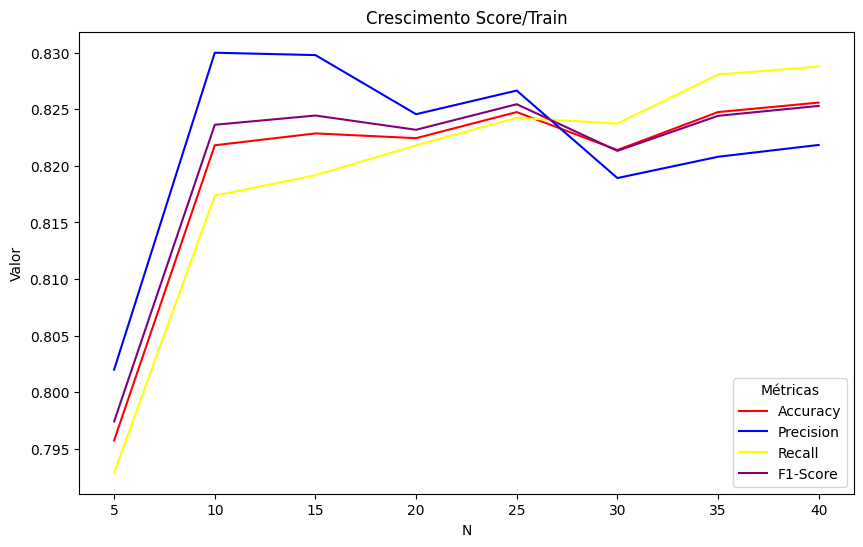

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [5,10,15,20,25,30,35,40]
data_l['accuracy'] = accuracy_RFC
data_l['precision'] = precision_RFC
data_l['recall'] = recall_RFC
data_l['F1-score'] = f1_RFC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_depth = 40')

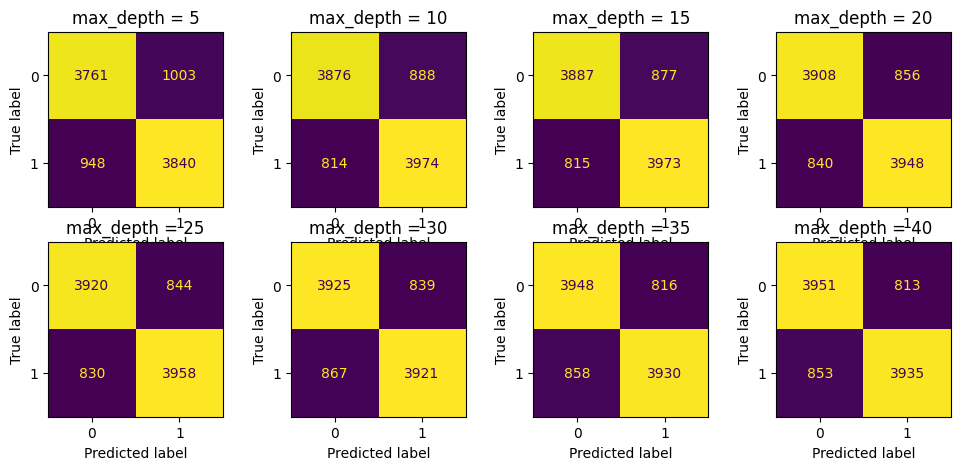

In [ ]:
cm_1 = confusion_matrix(y_test, RFC_pred[0])
cm_2 = confusion_matrix(y_test, RFC_pred[1])
cm_3 = confusion_matrix(y_test, RFC_pred[2])
cm_4 = confusion_matrix(y_test, RFC_pred[3])
cm_5 = confusion_matrix(y_test, RFC_pred[4])
cm_6 = confusion_matrix(y_test, RFC_pred[5])
cm_7 = confusion_matrix(y_test, RFC_pred[6])
cm_8 = confusion_matrix(y_test, RFC_pred[7])

fig, axes = plt.subplots(2, 4, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_depth = 5')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_depth = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_depth = 15')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_depth = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_depth = 25')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_depth = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_depth = 35')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_depth = 40')

### Decision Tree Classifier

In [ ]:
accuracy_DTC = []
precision_DTC = []
recall_DTC = []
f1_DTC = []
DTC_pred = []
i = 5
while i<41:
  mod_dt = DecisionTreeClassifier(max_depth = i, random_state = 1)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  DTC_pred.append(prediction)
  accuracy_DTC.append(metrics.accuracy_score(prediction,y_test))
  precision_DTC.append(metrics.precision_score(prediction,y_test))
  recall_DTC.append(metrics.recall_score(prediction,y_test))
  f1_DTC.append(metrics.f1_score(prediction,y_test))
  i+= 5

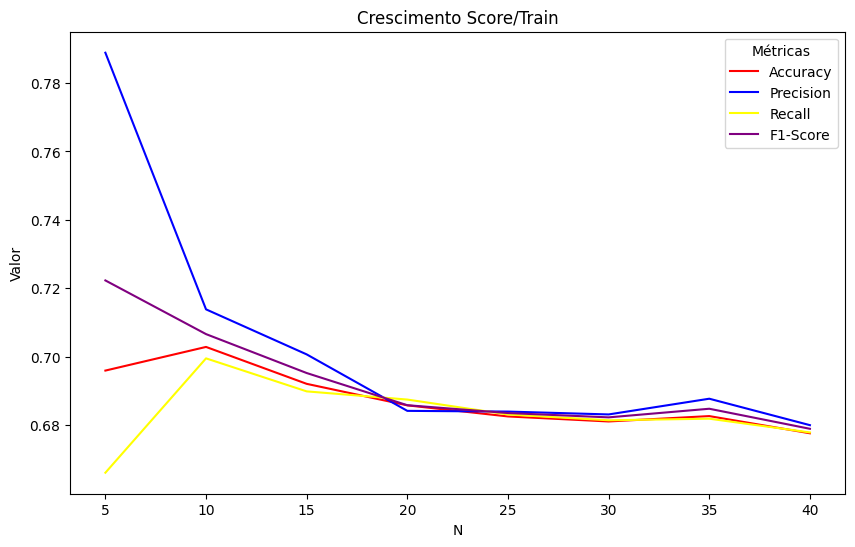

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [5,10,15,20,25,30,35,40]
data_l['accuracy'] = accuracy_DTC
data_l['precision'] = precision_DTC
data_l['recall'] = recall_DTC
data_l['F1-score'] = f1_DTC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_depth = 40')

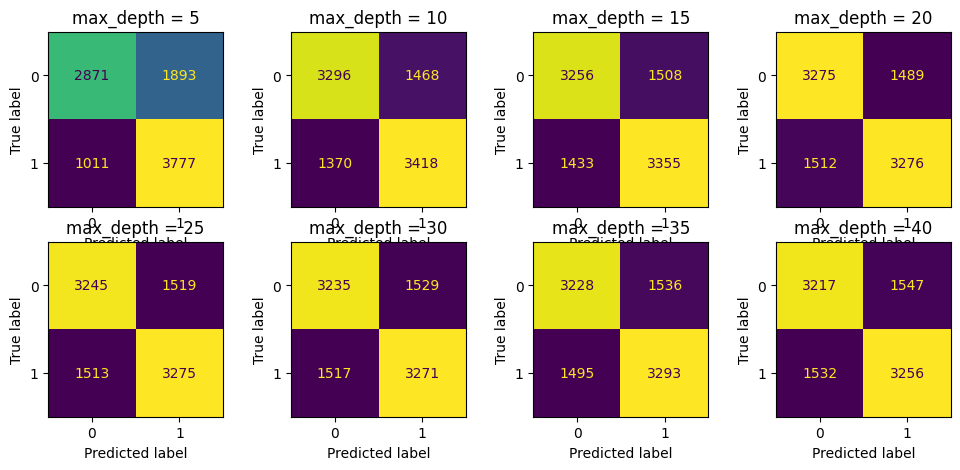

In [ ]:
cm_1 = confusion_matrix(y_test, DTC_pred[0])
cm_2 = confusion_matrix(y_test, DTC_pred[1])
cm_3 = confusion_matrix(y_test, DTC_pred[2])
cm_4 = confusion_matrix(y_test, DTC_pred[3])
cm_5 = confusion_matrix(y_test, DTC_pred[4])
cm_6 = confusion_matrix(y_test, DTC_pred[5])
cm_7 = confusion_matrix(y_test, DTC_pred[6])
cm_8 = confusion_matrix(y_test, DTC_pred[7])

fig, axes = plt.subplots(2, 4, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_depth = 5')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_depth = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_depth = 15')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_depth = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_depth = 25')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_depth = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_depth = 35')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_depth = 40')

### Logistic Regression


In [ ]:
accuracy_LR = []
precision_LR = []
recall_LR = []
f1_LR = []
LR_pred = []
i = 10
while i<151:
  mod_dt = LogisticRegression(max_iter = i, random_state = 1)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  LR_pred.append(prediction)
  accuracy_LR.append(metrics.accuracy_score(prediction,y_test))
  precision_LR.append(metrics.precision_score(prediction,y_test))
  recall_LR.append(metrics.recall_score(prediction,y_test))
  f1_LR.append(metrics.f1_score(prediction,y_test))
  i+= 10

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _c

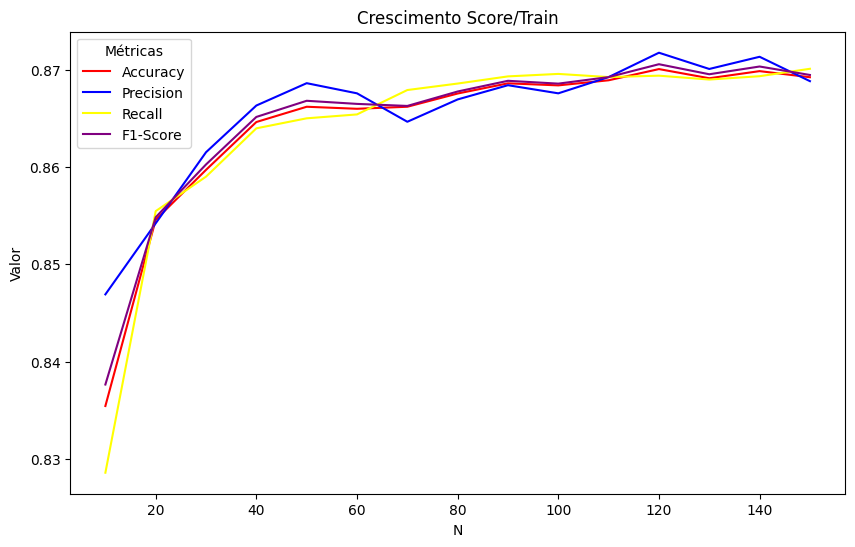

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [10,20,30,40,50,60,70,80,90,100,110,120,130,140,150]
data_l['accuracy'] = accuracy_LR
data_l['precision'] = precision_LR
data_l['recall'] = recall_LR
data_l['F1-score'] = f1_LR
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_iter = 150')

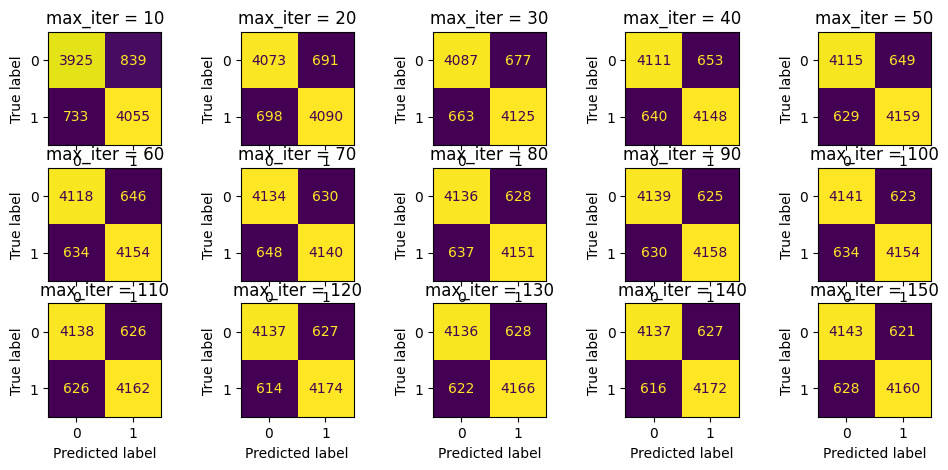

In [ ]:
cm_1 = confusion_matrix(y_test, LR_pred[0])
cm_2 = confusion_matrix(y_test, LR_pred[1])
cm_3 = confusion_matrix(y_test, LR_pred[2])
cm_4 = confusion_matrix(y_test, LR_pred[3])
cm_5 = confusion_matrix(y_test, LR_pred[4])
cm_6 = confusion_matrix(y_test, LR_pred[5])
cm_7 = confusion_matrix(y_test, LR_pred[6])
cm_8 = confusion_matrix(y_test, LR_pred[7])
cm_9 = confusion_matrix(y_test, LR_pred[8])
cm_10 = confusion_matrix(y_test, LR_pred[9])
cm_11 = confusion_matrix(y_test, LR_pred[10])
cm_12 = confusion_matrix(y_test, LR_pred[11])
cm_13 = confusion_matrix(y_test, LR_pred[12])
cm_14 = confusion_matrix(y_test, LR_pred[13])
cm_15 = confusion_matrix(y_test, LR_pred[14])

fig, axes = plt.subplots(3, 5, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_iter = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_iter = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_iter = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_iter = 40')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[0,4], colorbar=False)
axes[0,4].set_title('max_iter = 50')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_iter = 60')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_iter = 70')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_iter = 80')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_9)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_iter = 90')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_10)
disp_rfc.plot(ax=axes[1,4], colorbar=False)
axes[1,4].set_title('max_iter = 100')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_11)
disp_rfc.plot(ax=axes[2,0], colorbar=False)
axes[2,0].set_title('max_iter = 110')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_12)
disp_rfc.plot(ax=axes[2,1], colorbar=False)
axes[2,1].set_title('max_iter = 120')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_13)
disp_rfc.plot(ax=axes[2,2], colorbar=False)
axes[2,2].set_title('max_iter = 130')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_14)
disp_rfc.plot(ax=axes[2,3], colorbar=False)
axes[2,3].set_title('max_iter = 140')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_15)
disp_rfc.plot(ax=axes[2,4], colorbar=False)
axes[2,4].set_title('max_iter = 150')

### Linear Support Vector Classifier


In [ ]:
accuracy_LSVC = []
precision_LSVC = []
recall_LSVC = []
f1_LSVC = []
LSVC_pred = []
i = 10
while i<151:
  mod_dt = LinearSVC(max_iter = i, random_state = 42)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  LSVC_pred.append(prediction)
  accuracy_LSVC.append(metrics.accuracy_score(prediction,y_test))
  precision_LSVC.append(metrics.precision_score(prediction,y_test))
  recall_LSVC.append(metrics.recall_score(prediction,y_test))
  f1_LSVC.append(metrics.f1_score(prediction,y_test))
  i+= 10

/usr/local/lib/python3.11/dist-packages/sklearn/svm/_base.py:1249: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


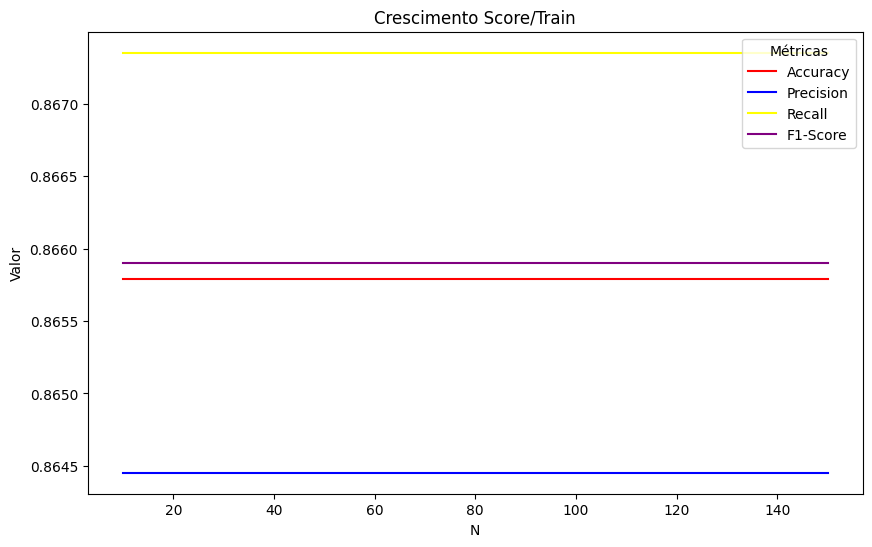

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [10,20,30,40,50,60,70,80,90,100,110,120,130,140,150]
data_l['accuracy'] = accuracy_LSVC
data_l['precision'] = precision_LSVC
data_l['recall'] = recall_LSVC
data_l['F1-score'] = f1_LSVC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_iter = 150')

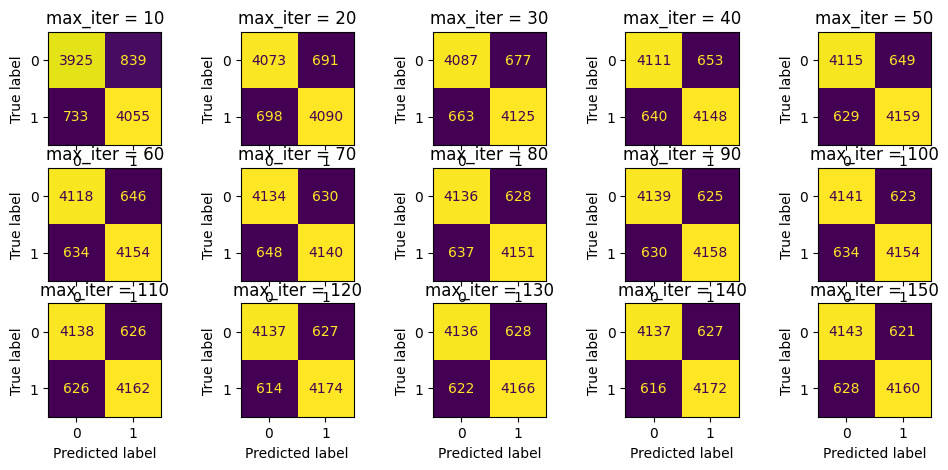

In [ ]:
cm_1 = confusion_matrix(y_test, LR_pred[0])
cm_2 = confusion_matrix(y_test, LR_pred[1])
cm_3 = confusion_matrix(y_test, LR_pred[2])
cm_4 = confusion_matrix(y_test, LR_pred[3])
cm_5 = confusion_matrix(y_test, LR_pred[4])
cm_6 = confusion_matrix(y_test, LR_pred[5])
cm_7 = confusion_matrix(y_test, LR_pred[6])
cm_8 = confusion_matrix(y_test, LR_pred[7])
cm_9 = confusion_matrix(y_test, LR_pred[8])
cm_10 = confusion_matrix(y_test, LR_pred[9])
cm_11 = confusion_matrix(y_test, LR_pred[10])
cm_12 = confusion_matrix(y_test, LR_pred[11])
cm_13 = confusion_matrix(y_test, LR_pred[12])
cm_14 = confusion_matrix(y_test, LR_pred[13])
cm_15 = confusion_matrix(y_test, LR_pred[14])

fig, axes = plt.subplots(3, 5, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_iter = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_iter = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_iter = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_iter = 40')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[0,4], colorbar=False)
axes[0,4].set_title('max_iter = 50')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_iter = 60')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_iter = 70')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_iter = 80')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_9)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_iter = 90')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_10)
disp_rfc.plot(ax=axes[1,4], colorbar=False)
axes[1,4].set_title('max_iter = 100')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_11)
disp_rfc.plot(ax=axes[2,0], colorbar=False)
axes[2,0].set_title('max_iter = 110')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_12)
disp_rfc.plot(ax=axes[2,1], colorbar=False)
axes[2,1].set_title('max_iter = 120')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_13)
disp_rfc.plot(ax=axes[2,2], colorbar=False)
axes[2,2].set_title('max_iter = 130')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_14)
disp_rfc.plot(ax=axes[2,3], colorbar=False)
axes[2,3].set_title('max_iter = 140')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_15)
disp_rfc.plot(ax=axes[2,4], colorbar=False)
axes[2,4].set_title('max_iter = 150')

### Passive Aggressive Classifier


In [ ]:
accuracy_PAC = []
precision_PAC = []
recall_PAC = []
f1_PAC = []
PAC_pred = []
i = 5
while i<41:
  mod_dt = PassiveAggressiveClassifier(max_iter=i, random_state=42)
  mod_dt.fit(x_train,y_train)
  prediction=mod_dt.predict(x_test)
  PAC_pred.append(prediction)
  accuracy_PAC.append(metrics.accuracy_score(prediction,y_test))
  precision_PAC.append(metrics.precision_score(prediction,y_test))
  recall_PAC.append(metrics.recall_score(prediction,y_test))
  f1_PAC.append(metrics.f1_score(prediction,y_test))
  i+= 5

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:738: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:738: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_stochastic_gradient.py:738: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(


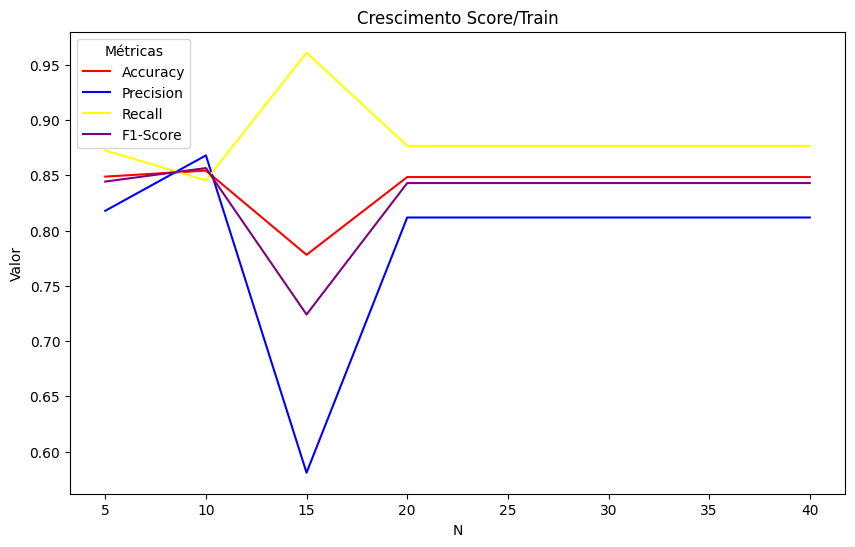

In [ ]:
data_l = pd.DataFrame()
data_l['n'] = [5,10,15,20,25,30,35,40]
data_l['accuracy'] = accuracy_PAC
data_l['precision'] = precision_PAC
data_l['recall'] = recall_PAC
data_l['F1-score'] = f1_PAC
plt.figure(figsize=(10, 6)) #criação do tamanho da figura
sns.lineplot(data = data_l, x="n", y="accuracy", color = "red",label="Accuracy")
sns.lineplot(data = data_l, x="n", y="precision", color = "blue",label="Precision")
sns.lineplot(data = data_l, x="n", y="recall", color = "yellow",label="Recall")
sns.lineplot(data = data_l, x="n", y="F1-score", color = "purple", label="F1-Score")
plt.title("Crescimento Score/Train")  #Alteração do titulo
plt.xlabel("N")                                 #Alteração do indicador do eixo X
plt.legend(title="Métricas")
plt.ylabel("Valor")                           #Alteração do indicador do eixo Y
plt.show()                                         #Mostrar a imagem

Text(0.5, 1.0, 'max_depth = 40')

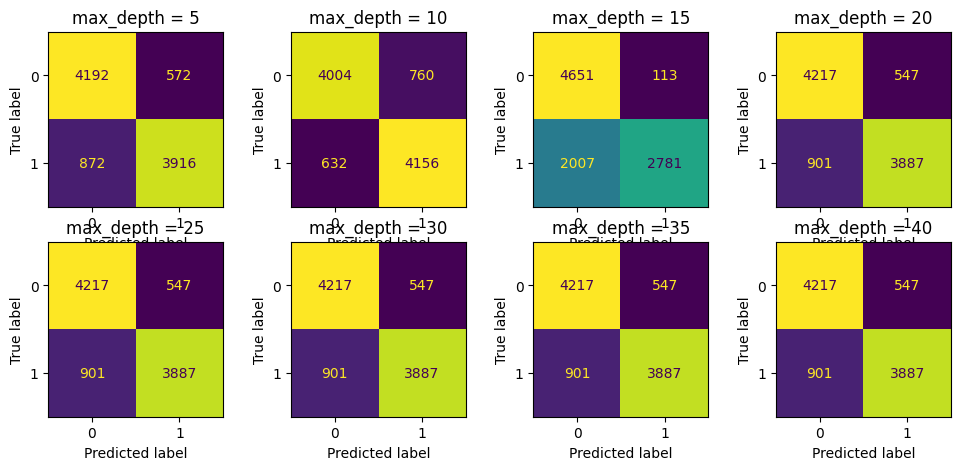

In [ ]:
cm_1 = confusion_matrix(y_test, PAC_pred[0])
cm_2 = confusion_matrix(y_test, PAC_pred[1])
cm_3 = confusion_matrix(y_test, PAC_pred[2])
cm_4 = confusion_matrix(y_test, PAC_pred[3])
cm_5 = confusion_matrix(y_test, PAC_pred[4])
cm_6 = confusion_matrix(y_test, PAC_pred[5])
cm_7 = confusion_matrix(y_test, PAC_pred[6])
cm_8 = confusion_matrix(y_test, PAC_pred[7])

fig, axes = plt.subplots(2, 4, figsize=(12, 5))

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_1)
disp_rfc.plot(ax=axes[0, 0], colorbar=False)
axes[0, 0].set_title('max_depth = 5')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_2)
disp_rfc.plot(ax=axes[0,1], colorbar=False)
axes[0,1].set_title('max_depth = 10')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_3)
disp_rfc.plot(ax=axes[0,2], colorbar=False)
axes[0,2].set_title('max_depth = 15')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_4)
disp_rfc.plot(ax=axes[0,3], colorbar=False)
axes[0,3].set_title('max_depth = 20')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_5)
disp_rfc.plot(ax=axes[1,0], colorbar=False)
axes[1,0].set_title('max_depth = 25')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_6)
disp_rfc.plot(ax=axes[1,1], colorbar=False)
axes[1,1].set_title('max_depth = 30')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_7)
disp_rfc.plot(ax=axes[1,2], colorbar=False)
axes[1,2].set_title('max_depth = 35')

disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_8)
disp_rfc.plot(ax=axes[1,3], colorbar=False)
axes[1,3].set_title('max_depth = 40')

# Resultados após correção

## RFC

###Fake.BR → FakeRecogna

Sem correção:

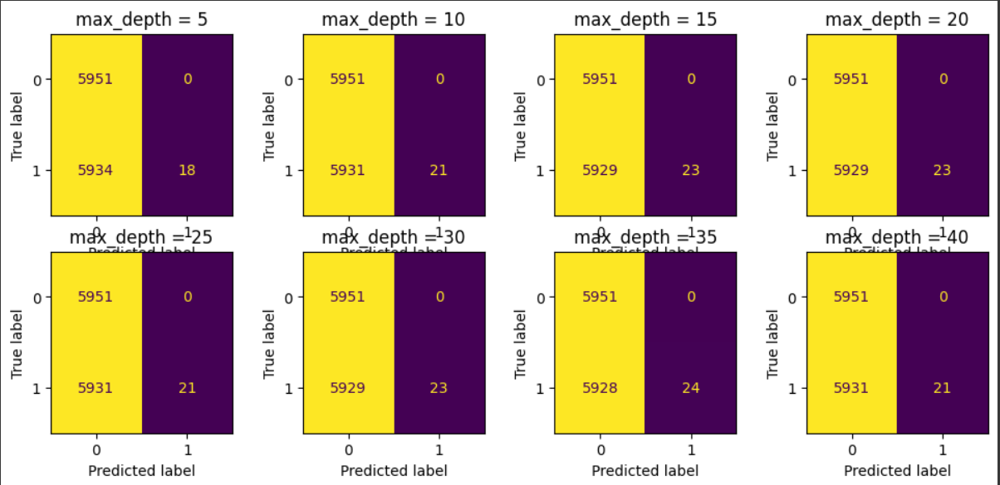

Com correção:

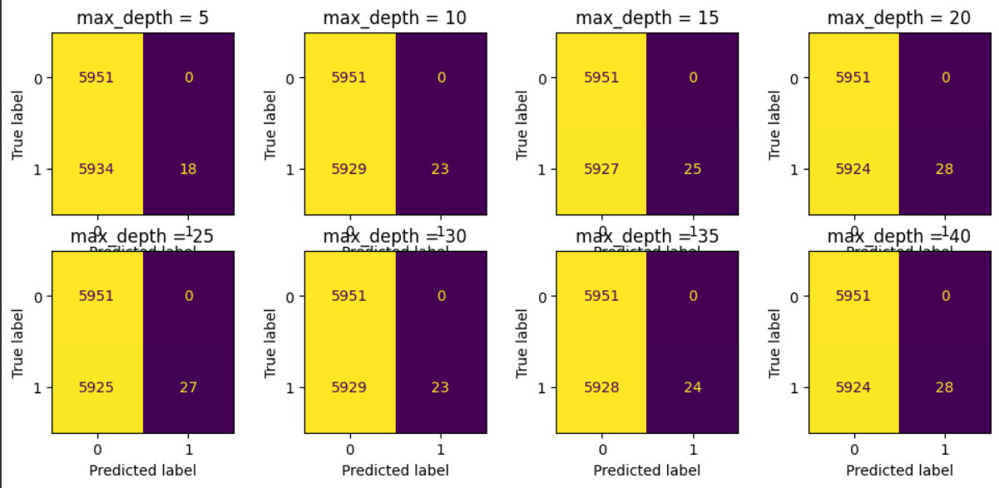

###FakeRecogna → Fake.BR

Sem Correção:

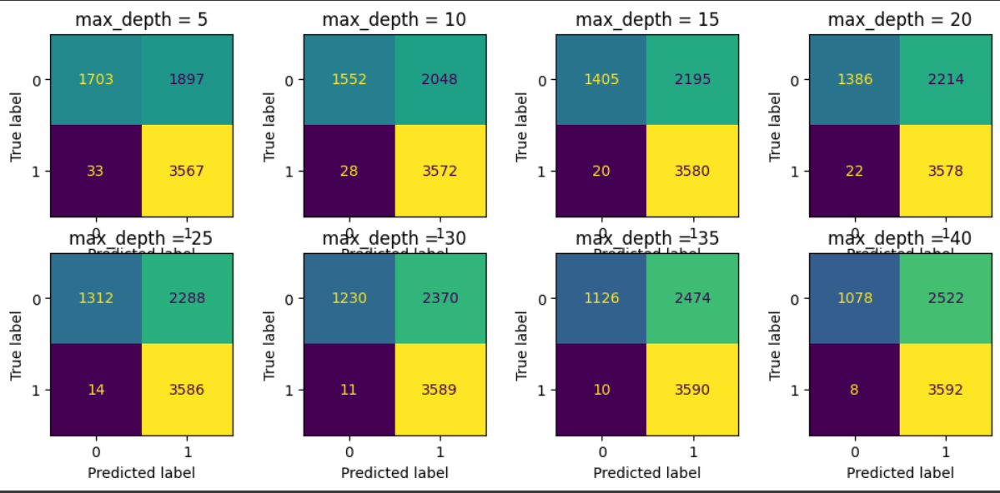

Com Correção:

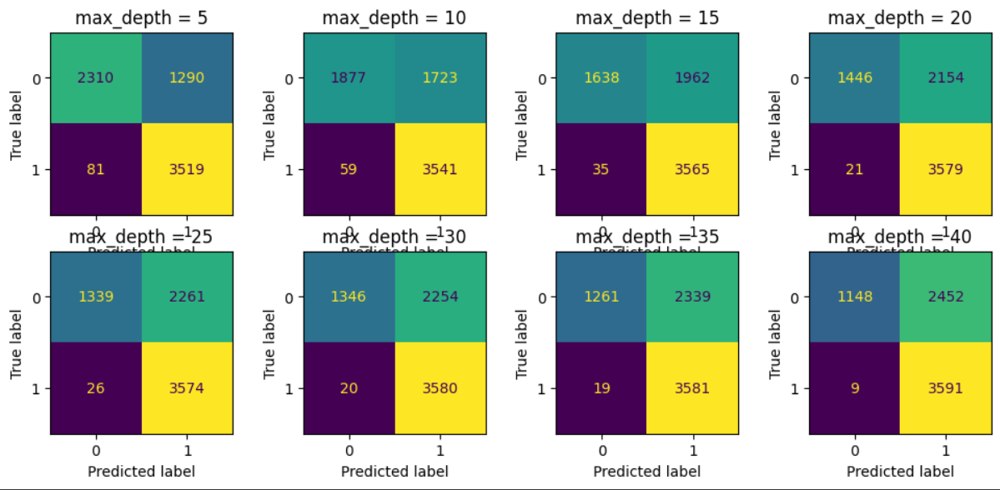

###Junção

Sem Correção:

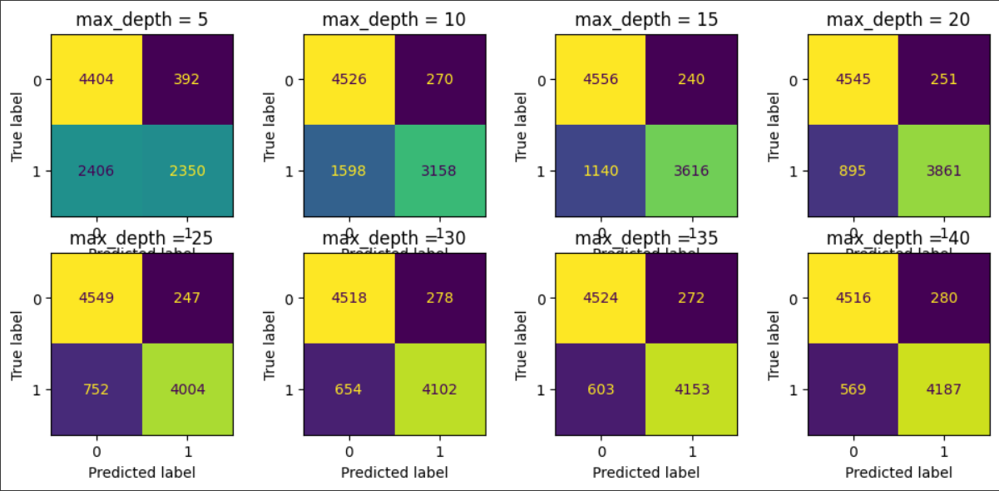

Com Correção:

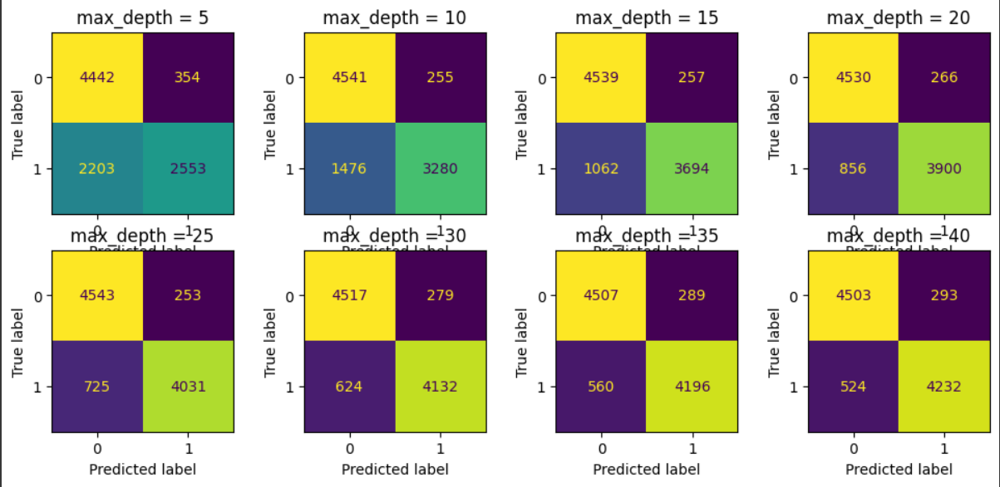

## DTC

###Fake.BR → FakeRecogna

Sem correção:

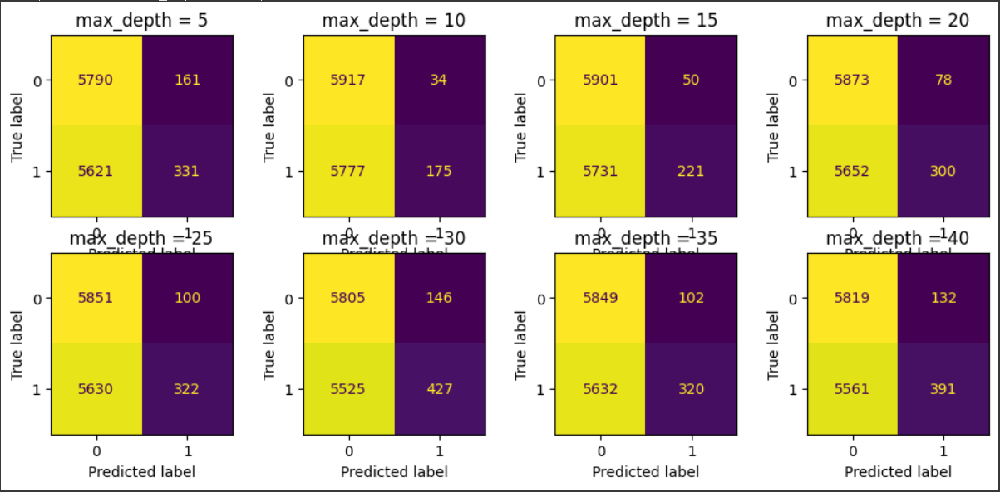

Com correção:

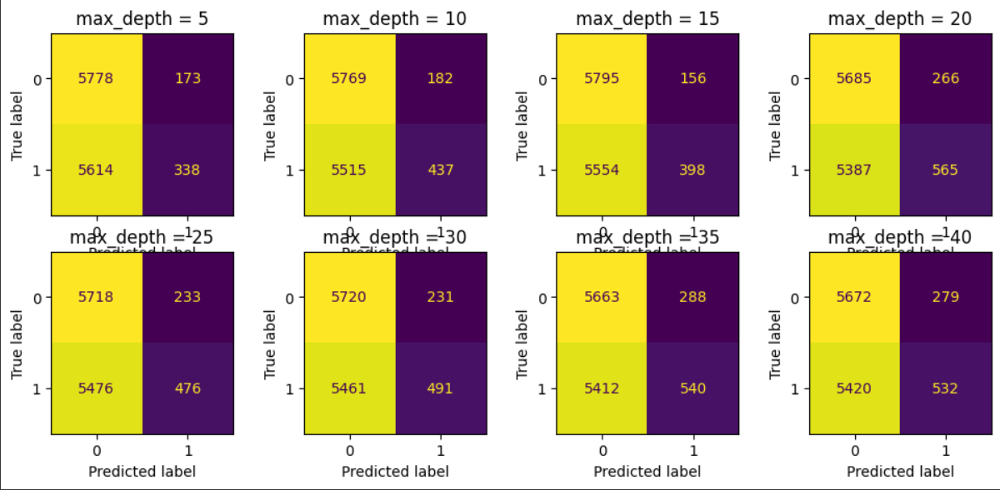

###FakeRecogna → Fake.BR

Sem Correção:

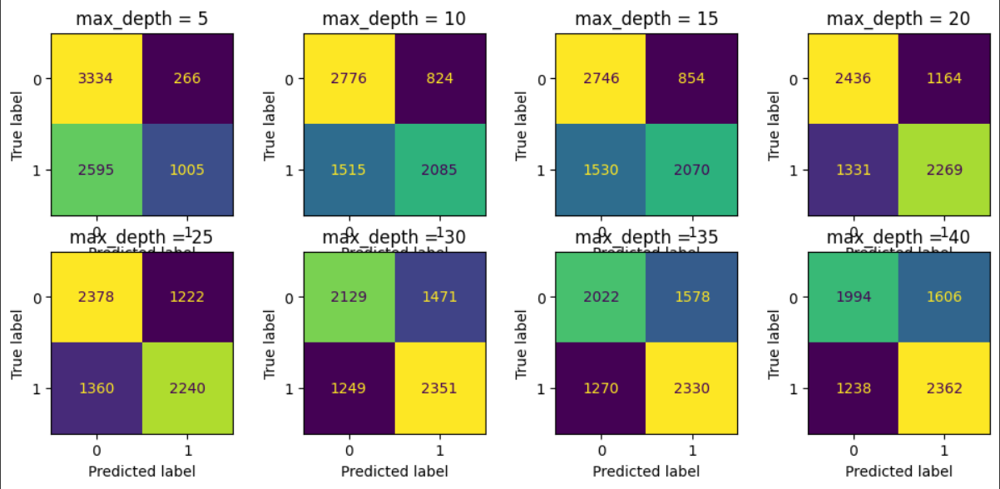

Com Correção:

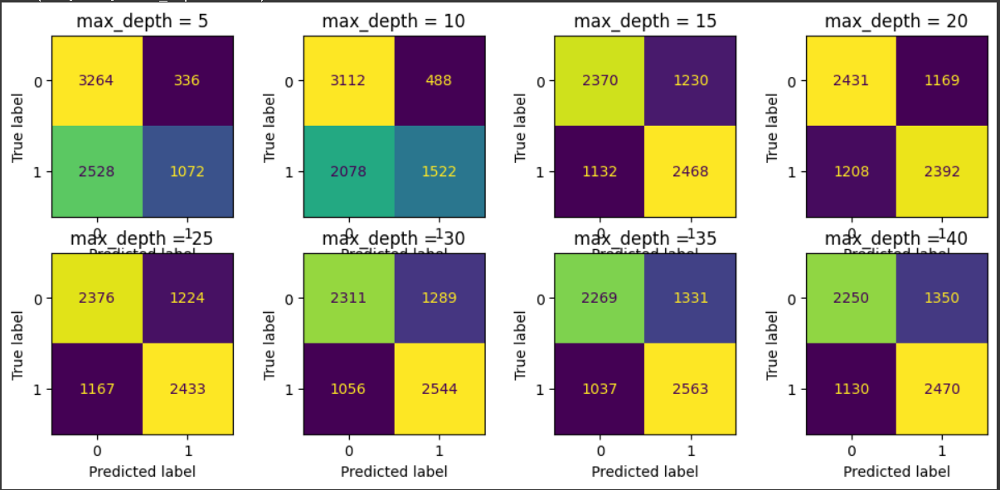

###Junção

Sem Correção:

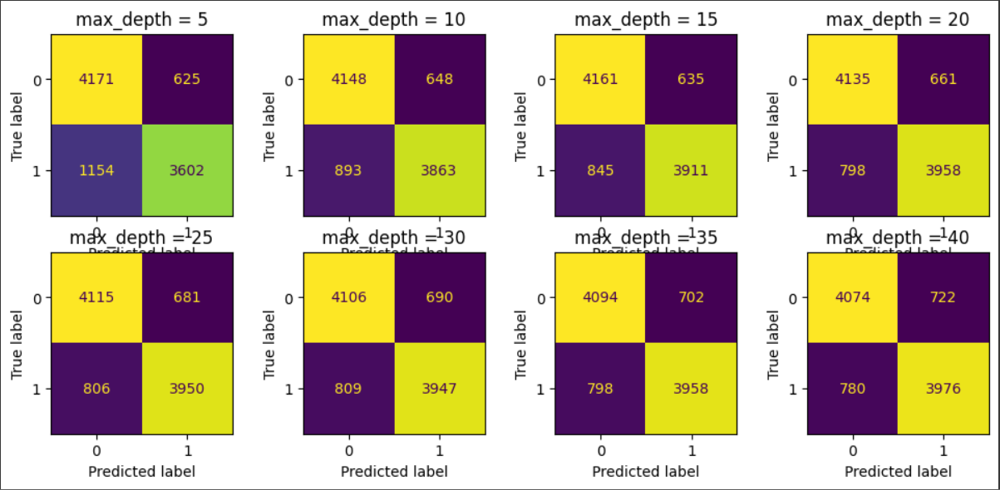

Com Correção:

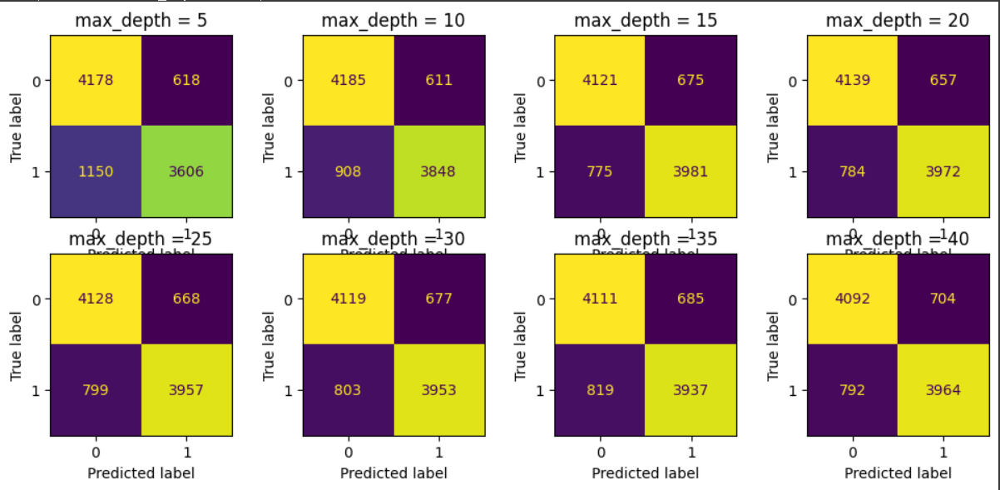

## Logistic Regression

###Fake.BR → FakeRecogna

Sem correção:

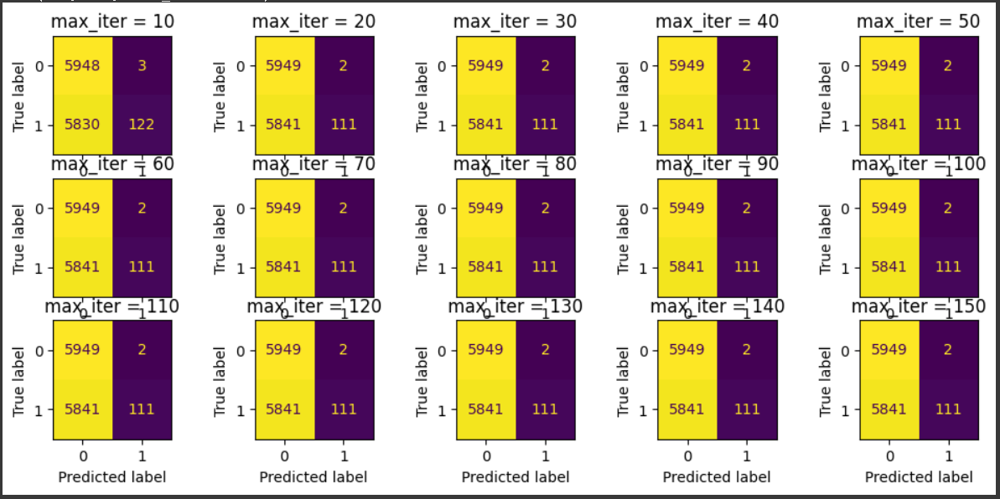

Com correção:

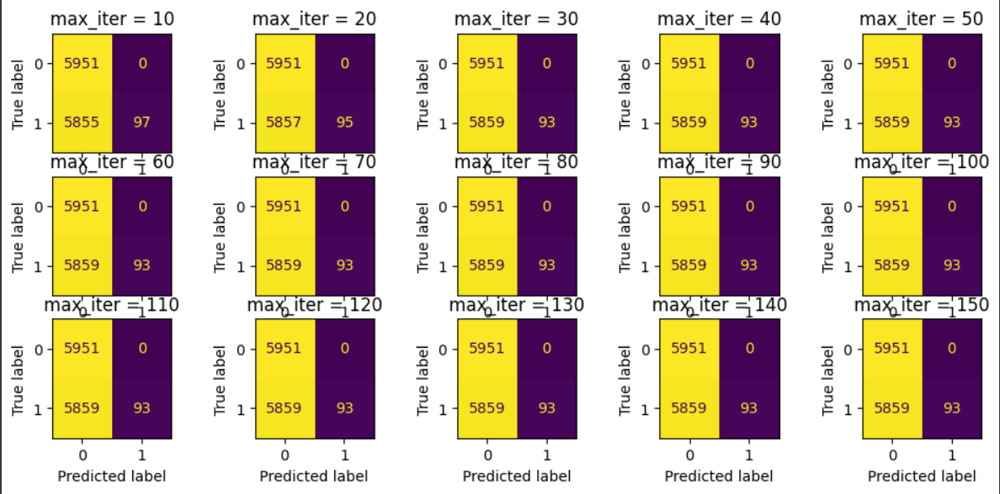


###FakeRecogna → Fake.BR

Sem Correção:

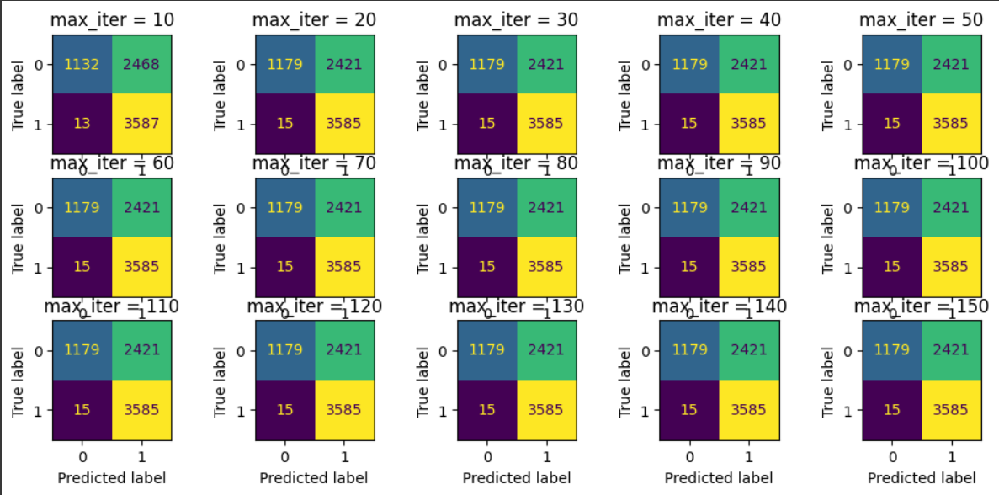

Com Correção:

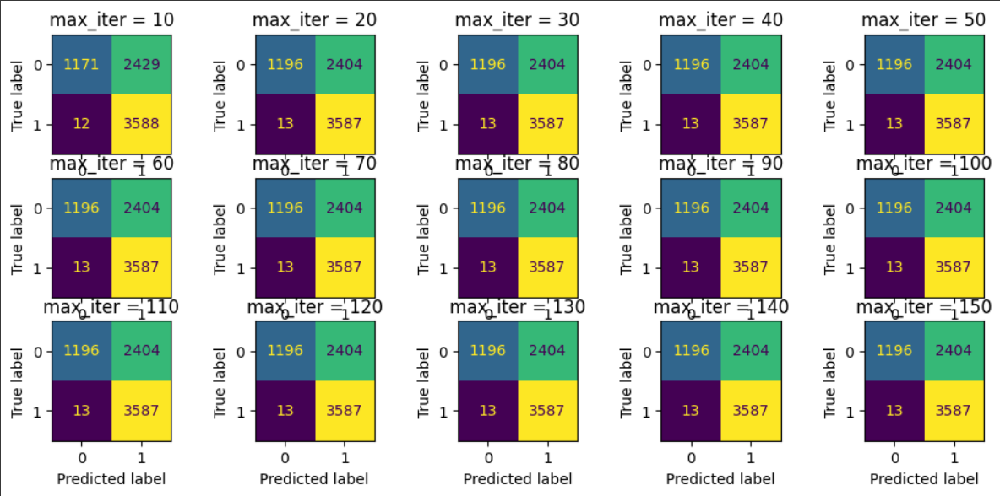

###Junção

Sem Correção:

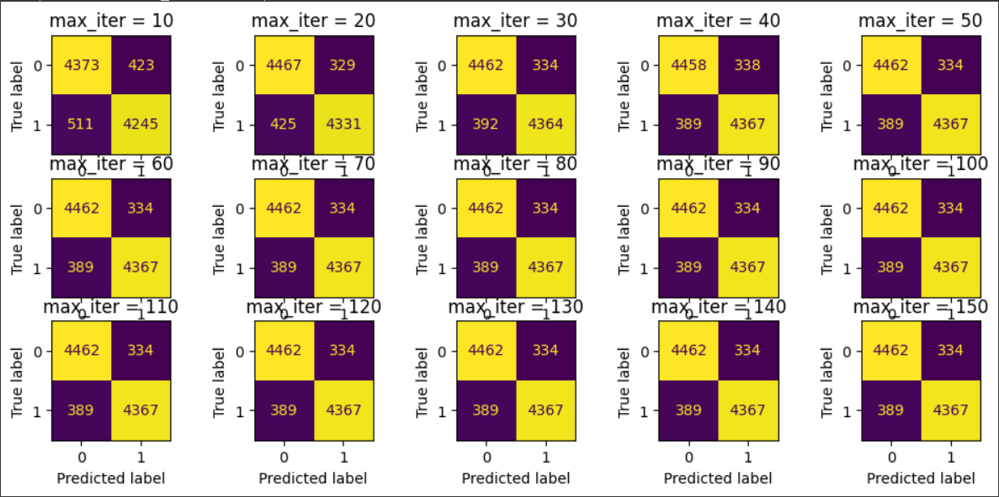

Com Correção:

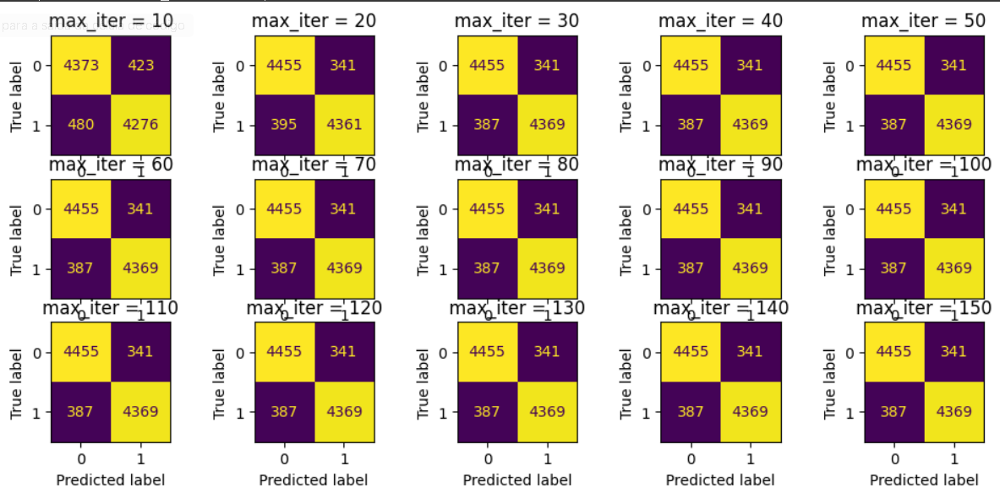

## Linear Support Vector Classifier

###Fake.BR → FakeRecogna

Sem correção:

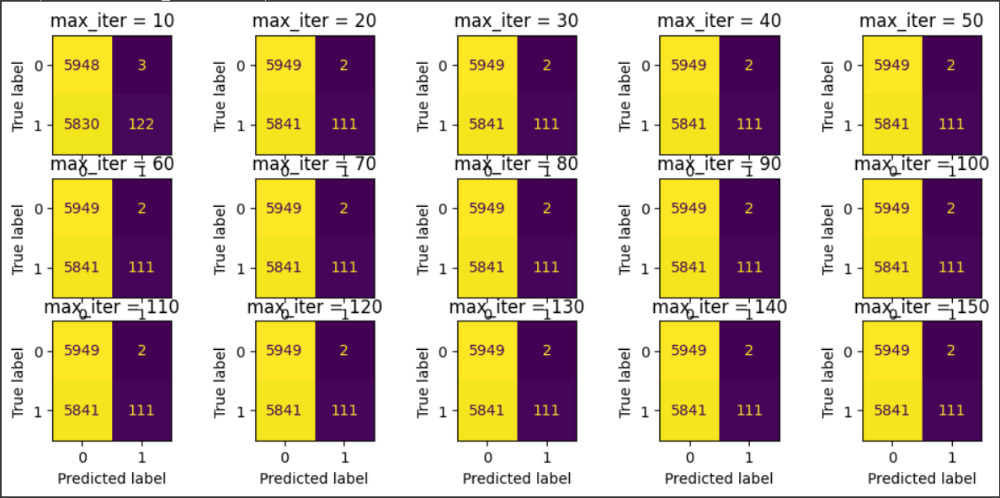

Com correção:

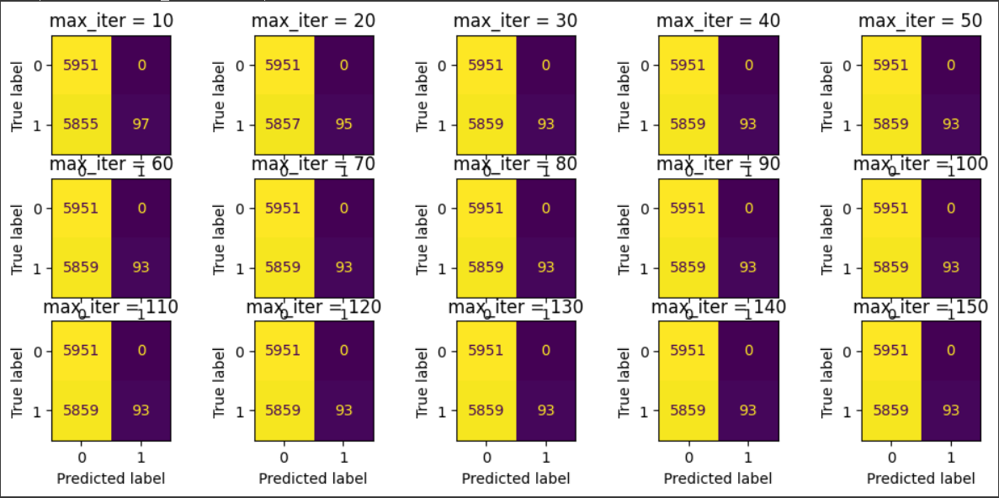

###FakeRecogna → Fake.BR

Sem Correção:

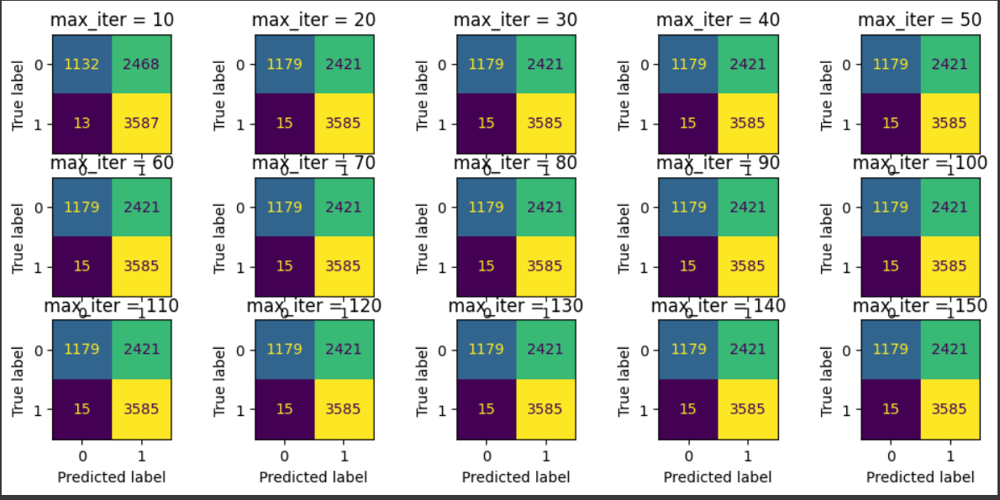

Com Correção:

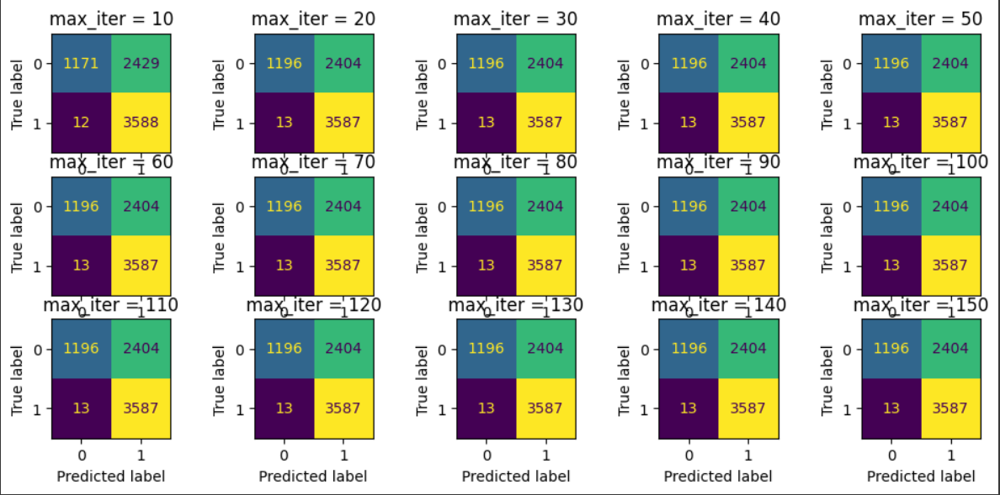

###Junção

Sem Correção:

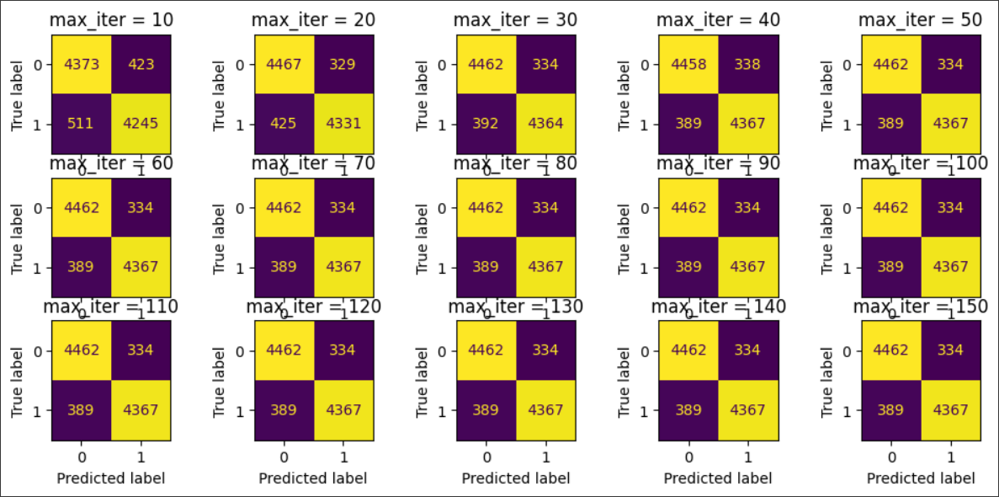

Com Correção:

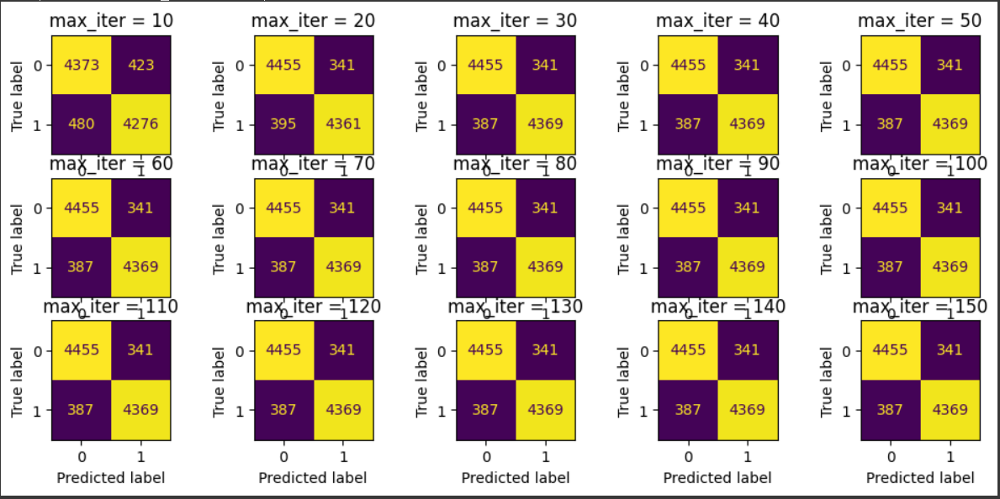

## Passive Agressive Classifier

###Fake.BR → FakeRecogna

Sem correção:

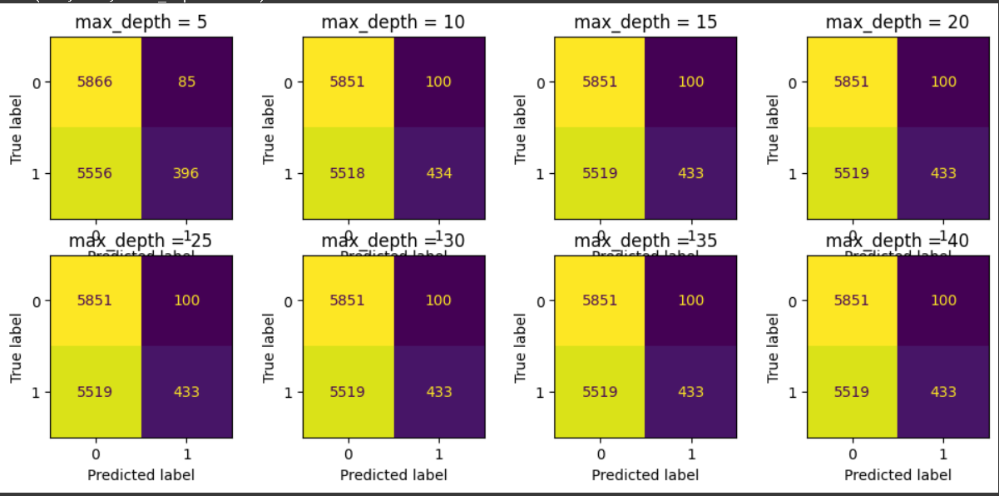

Com correção:

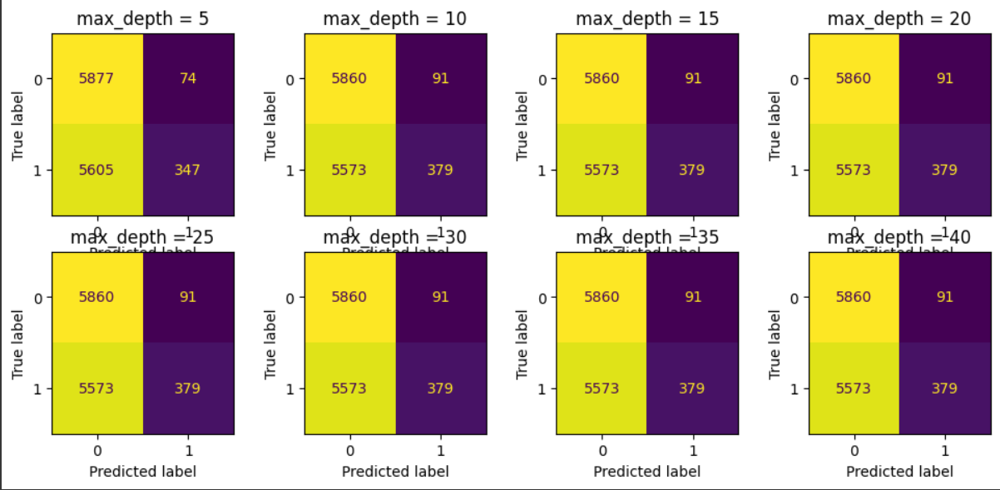

###FakeRecogna → Fake.BR

Sem Correção:

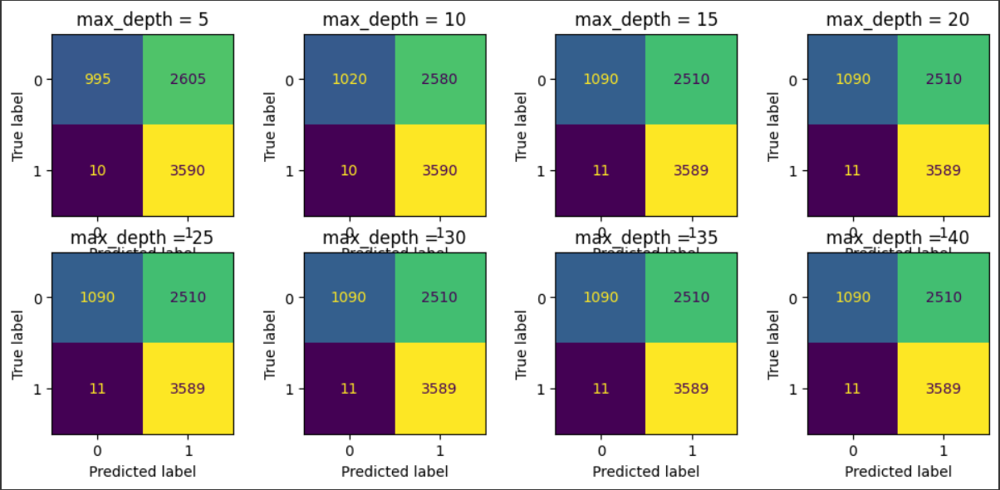

Com Correção:

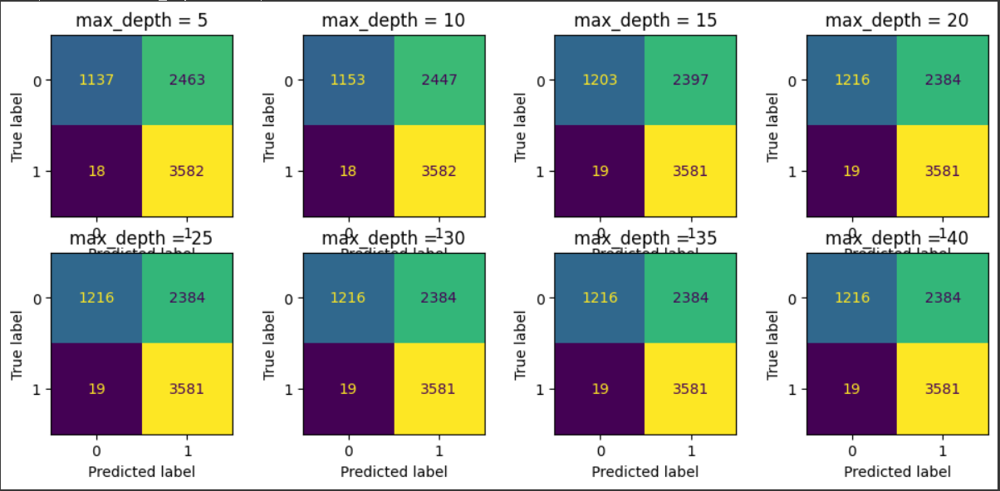

###Junção

Sem Correção:

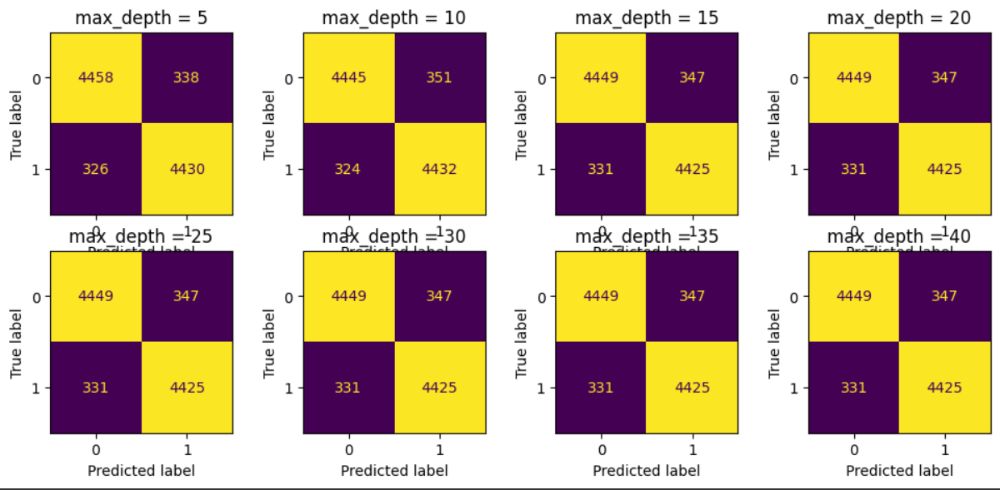

Com Correção:

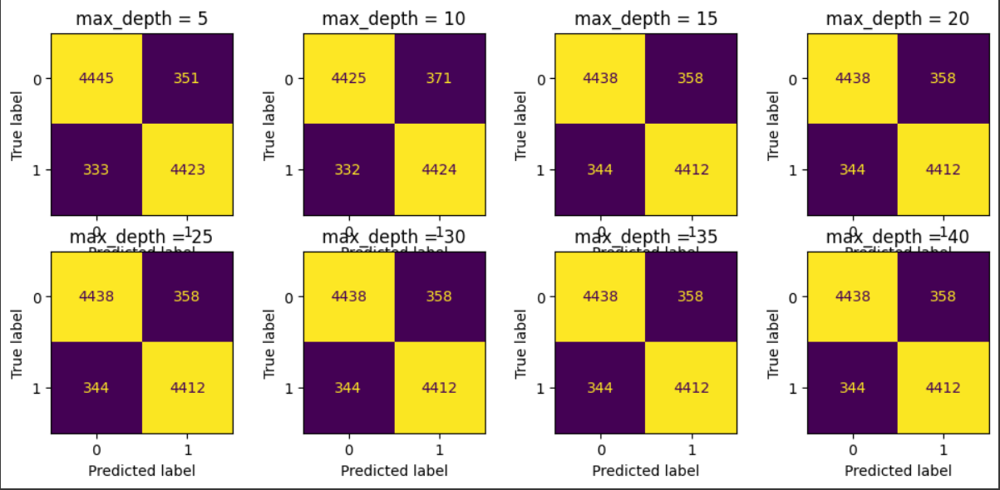

# Obtenção dos melhores resultados dos modelos:

In [6]:
df_juncao = pd.read_csv('/content/drive/MyDrive/DatasetTCC/uniao_dataset.csv')
print(df_juncao.head())
df_juncao_c = pd.read_csv('/content/drive/MyDrive/DatasetTCC/uniao_dataset_corrigido.csv')
print(df_juncao_c.head())

                                    texto_processado classificação
0  ministro celso mello manda recado políticos ma...          fake
1  ei divulga vídeo ameaça frança eua vamos vinga...          fake
2  áudio estranho vaza youtube parte financeira n...          fake
3  francês le figaro faz matéria sobre dilma exgu...          fake
4  planalto pânico stf pode devolver ações envolv...          fake
                                     texto_corrigido classificação
0  ministro celso melão manda recado políticos ma...          fake
1  e divulga vídeo ameaça frança eua vamos vingar...          fake
2  áudio estranho vaza youtube parte financeira n...          fake
3  francês de figuro faz matéria sobre dilema exg...          fake
4  planalto pânico sef pode devolver ações envolv...          fake


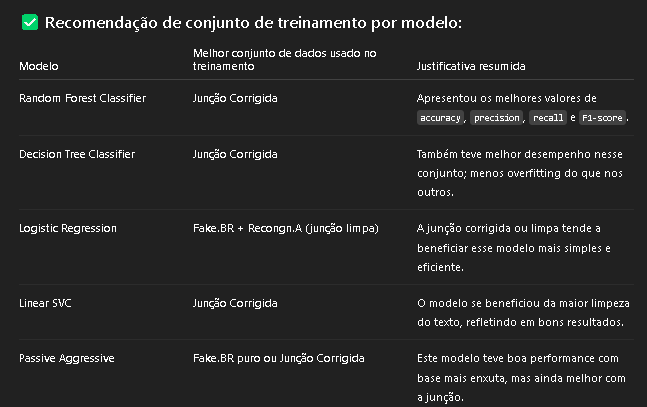

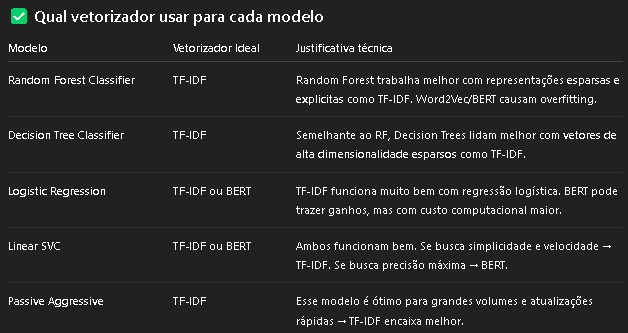

In [7]:
import joblib

In [8]:
vetorizador = TfidfVectorizer()

x = vetorizador.fit_transform(df_juncao_c['texto_corrigido'].astype(str))
y = df_juncao_c['classificação'].apply(lambda x: 1 if 'true' in x else 0)
joblib.dump(vetorizador, 'vetorizador_juncao.pkl')

['vetorizador_juncao.pkl']

In [9]:
x_train,x_test,y_train,y_test=train_test_split(x,y,random_state=9856,test_size=0.5)

## RFC

In [10]:
forest = RandomForestClassifier(
    n_estimators=100,        # número de árvores na floresta
    max_depth=20,            # profundidade ideal (evita overfitting)
    min_samples_split=5,     # mínimo para divisão de nós
    min_samples_leaf=2,      # folhas mínimas
    random_state=42,
    n_jobs=-1                # uso total da CPU
)

forest.fit(x_train,y_train)

joblib.dump(forest, 'rfc.pkl')

['rfc.pkl']

## DTC

In [11]:
dtc = DecisionTreeClassifier(
    max_depth=15,            # mais baixo que RF para evitar overfitting
    min_samples_split=10,
    min_samples_leaf=4,
    criterion="entropy",     # melhor desempenho para texto
    random_state=42
)

dtc.fit(x_train,y_train)

joblib.dump(dtc, 'dtc.pkl')

['dtc.pkl']

## Logistic Regression

In [12]:
# 1. Crie e TREINE o VETORIZADOR
vetorizador2 = TfidfVectorizer()
x2 = vetorizador2.fit_transform(df_juncao['texto_processado'].astype(str))
y2 = df_juncao['classificação'].apply(lambda x: 1 if 'true' in x else 0)

# 2. SALVE o VETORIZADOR IMEDIATAMENTE APÓS O TREINO
# Garanta que o nome do arquivo seja o mesmo que a API usa!
joblib.dump(vetorizador2, 'vetorizador_juncao_n.pkl')
print(f"Vetorizador salvo! Número de features: {x2.shape[1]}") # Linha para verificar o número de features

# 3. Divida os dados JÁ VETORIZADOS
x_train2, x_test2, y_train2, y_test2 = train_test_split(x2, y2, random_state=9856, test_size=0.5)

# 4. Crie e TREINE o MODELO com os dados de treino
lr = LogisticRegression(
    C=1.0,
    penalty='l2',
    solver='liblinear',
    max_iter=500,
    random_state=42
)
lr.fit(x_train2, y_train2)

# 5. SALVE o MODELO que foi treinado com os dados do vetorizador acima
# Garanta que o nome do arquivo seja o mesmo que a API usa!
joblib.dump(lr, 'lr.pkl')

print("Modelo salvo! Treinado para esperar o mesmo número de features.")
print("✅ Processo concluído. Vetorizador e Modelo estão em sincronia.")

Vetorizador salvo! Número de features: 103265
Modelo salvo! Treinado para esperar o mesmo número de features.
✅ Processo concluído. Vetorizador e Modelo estão em sincronia.


## Linear SVC

In [13]:
lsvc = LinearSVC(
    C=1.0,                   # balanceia margem e erro (experimente entre 0.1 a 10)
    penalty='l2',
    dual=False,              # melhor quando n_samples > n_features
    max_iter=1000,
    random_state=42
)

lsvc.fit(x_train,y_train)

joblib.dump(lsvc, 'lsvc.pkl')

['lsvc.pkl']

## Passive Aggressive Classifier

In [14]:
pac = PassiveAggressiveClassifier(
    C=0.5,                   # menor C → mais regularização
    max_iter=1000,
    loss='hinge',            # tipo SVM
    random_state=42
)

pac.fit(x_train,y_train)

joblib.dump(pac, 'pac.pkl')

['pac.pkl']